<a href="https://colab.research.google.com/github/niwayandm/printing-machine/blob/main/Speed%20Printing%20Forecasting%20with%20NBeats-RNN%20V1.4.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Install Libraries**
Restart runtime after installing these libraries

In [ ]:
!pip install darts

     |████████████████████████████████| 359 kB 5.2 MB/s 
     |████████████████████████████████| 43 kB 2.3 MB/s 
     |████████████████████████████████| 65 kB 4.5 MB/s 
     |████████████████████████████████| 9.8 MB 52.6 MB/s 
     |████████████████████████████████| 172 kB 57.6 MB/s 
     |████████████████████████████████| 582 kB 52.9 MB/s 
     |████████████████████████████████| 11.2 MB 46.5 MB/s 
     |████████████████████████████████| 793 kB 47.7 MB/s 
     |████████████████████████████████| 1.4 MB 46.2 MB/s 
     |████████████████████████████████| 380 kB 51.5 MB/s 
     |████████████████████████████████| 899 kB 44.6 MB/s 
     |████████████████████████████████| 49 kB 5.3 MB/s 
     |████████████████████████████████| 43 kB 1.1 MB/s 
     |████████████████████████████████| 596 kB 40.6 MB/s 
     |████████████████████████████████| 136 kB 46.5 MB/s 
     |████████████████████████████████| 398 kB 38.9 MB/s 
     |████████████████████████████████| 1.1 MB 25.2 MB/s 
     |████████████████

In [ ]:
!pip install pyyaml==5.4.1

     |████████████████████████████████| 636 kB 5.2 MB/s 
  Attempting uninstall: pyyaml
    Found existing installation: PyYAML 6.0
    Uninstalling PyYAML-6.0:
      Successfully uninstalled PyYAML-6.0


# **Importing Libraries**

Python code in one module gains access to the code in another module by the process of importing it. The import statement is the most common way of invoking the import machinery, but it is not the only way. 

A Python library is a collection of related modules. It contains bundles of code that can be used repeatedly in different programs. It makes Python Programming simpler and convenient for the programmer.

In [ ]:
import pandas as pd
import numpy as np
import statistics
import datetime
import calendar

import seaborn as sns 
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker
import matplotlib.style
import matplotlib as mpl

from darts import TimeSeries
from darts.dataprocessing.transformers import Scaler
from darts.models import NBEATSModel,RNNModel
from darts.metrics import rmse,mae,mse,smape,ope,mape
from darts.utils.statistics import check_seasonality

from pydrive.auth import GoogleAuth
from pydrive.drive import GoogleDrive
from google.colab import auth
from oauth2client.client import GoogleCredentials

import warnings
warnings.filterwarnings("ignore")

/usr/local/lib/python3.7/dist-packages/distributed/config.py:20: YAMLLoadWarning: calling yaml.load() without Loader=... is deprecated, as the default Loader is unsafe. Please read https://msg.pyyaml.org/load for full details.
  defaults = yaml.load(f)


In [ ]:
# remove the notebook root logger.\n",
import logging
logger = logging.getLogger()
logger.handlers = []

In [ ]:
mpl.style.use('default')

In [ ]:
auth.authenticate_user()
gauth = GoogleAuth()
gauth.credentials = GoogleCredentials.get_application_default()
drive = GoogleDrive(gauth)

In [ ]:
downloaded = drive.CreateFile({'id':"1J08GN19v3F0AaLpP6T8OK8MV84o0gg_e"})
downloaded.GetContentFile('2021_RDD_SPNP_1.csv')

# **Importing Raw Data/Source of Dataset**
In any data analysis project, we seek to discover useful, actionable insights from a given set of data. If we’re lucky, this data may already be packaged for us; if not, we may need to collect it ourselves. Either way, once the data is stored, we will need to read it into a program to perform analysis.
The software package *pandas* is often used for this purpose. It is a powerful library that works with the Python programming language. Within pandas, the tool of choice to read in data files is the ubiquitous `read_csv `or `read_excel` function.

In [ ]:
# import train and test data
df = pd.read_csv('2021_RDD_SPNP_1.csv',index_col=0)

In [ ]:
# print the first eight rows of the dataset
df.head(8)

,Tgl,Weekly,Bulan,Hari,Jam,KodeBD,KdMesin,OrderID,JobName,NoJI,...,FILM,qtyok,target,LCL,Speed,interval,Weight,RunTime,Downtime,GapTime
0,2021-01-01,1- W1,Jan,1,0:00,PF,PR01,NaN,NaN,NaN,...,NaN,0,0,0,0,5,0.2,0,1,1
1,2021-01-01,1- W1,Jan,1,0:01,US,PR01,NaN,NaN,NaN,...,NaN,0,0,0,0,5,0.2,0,1,1
2,2021-01-01,1- W1,Jan,1,0:02,US,PR01,NaN,NaN,NaN,...,NaN,0,0,0,0,5,0.2,0,1,1
3,2021-01-01,1- W1,Jan,1,0:03,US,PR01,NaN,NaN,NaN,...,NaN,0,0,0,0,5,0.2,0,1,1
4,2021-01-01,1- W1,Jan,1,0:04,US,PR01,NaN,NaN,NaN,...,NaN,0,0,0,0,5,0.2,0,1,1
5,2021-01-01,1- W1,Jan,1,0:05,US,PR01,NaN,NaN,NaN,...,NaN,0,0,0,0,5,0.2,0,1,1
6,2021-01-01,1- W1,Jan,1,0:06,US,PR01,NaN,NaN,NaN,...,NaN,0,0,0,0,5,0.2,0,1,1
7,2021-01-01,1- W1,Jan,1,0:07,US,PR01,NaN,NaN,NaN,...,NaN,0,0,0,0,5,0.2,0,1,1


In [ ]:
# print how many rows and columns are in the dataset
print("The data has", len(df), "rows and", len(df.columns), "columns")

The data has 2929156 rows and 25 columns


In [ ]:
# check data types of all columns
df.dtypes

Tgl           object
Weekly        object
Bulan         object
Hari           int64
Jam           object
KodeBD        object
KdMesin       object
OrderID       object
JobName       object
NoJI          object
LebarCyl     float64
Under_lcl      int64
Notif          int64
OTS            int64
Matte          int64
FILM          object
qtyok          int64
target         int64
LCL            int64
Speed          int64
interval       int64
Weight       float64
RunTime        int64
Downtime       int64
GapTime        int64
dtype: object

# **Data Prepraration**

Data preparation is the process of cleaning and transforming raw data prior to processing and analysis. It is an important step prior to processing and often involves reformatting data, making corrections to data and the combining of data sets to enrich data.

Data preparation is often a lengthy undertaking for data professionals or business users, but it is essential as a prerequisite to put data in context in order to turn it into insights and eliminate bias resulting from poor data quality.

For example, the data preparation process usually includes standardizing data formats, enriching source data, and/or removing outliers.

### **1. Changing data formats**

In [ ]:
# change 'Tgl' data type to date
df['Tgl']= pd.to_datetime(df['Tgl'],format='%Y-%m-%d')
df.dtypes

Tgl          datetime64[ns]
Weekly               object
Bulan                object
Hari                  int64
Jam                  object
KodeBD               object
KdMesin              object
OrderID              object
JobName              object
NoJI                 object
LebarCyl            float64
Under_lcl             int64
Notif                 int64
OTS                   int64
Matte                 int64
FILM                 object
qtyok                 int64
target                int64
LCL                   int64
Speed                 int64
interval              int64
Weight              float64
RunTime               int64
Downtime              int64
GapTime               int64
dtype: object

## **2. Dimensionality Reduction**

In [ ]:
# delete unnecessary colums for EDA
df = df.drop(columns= ['JobName','NoJI','LebarCyl','Under_lcl','Matte','LCL','OTS','interval','Weight'], axis=1)

# print the first 5 rows in dataset to check if the above columns have been deleted
df.head(8)

,Tgl,Weekly,Bulan,Hari,Jam,KodeBD,KdMesin,OrderID,Notif,FILM,qtyok,target,Speed,RunTime,Downtime,GapTime
0,2021-01-01,1- W1,Jan,1,0:00,PF,PR01,NaN,0,NaN,0,0,0,0,1,1
1,2021-01-01,1- W1,Jan,1,0:01,US,PR01,NaN,0,NaN,0,0,0,0,1,1
2,2021-01-01,1- W1,Jan,1,0:02,US,PR01,NaN,0,NaN,0,0,0,0,1,1
3,2021-01-01,1- W1,Jan,1,0:03,US,PR01,NaN,0,NaN,0,0,0,0,1,1
4,2021-01-01,1- W1,Jan,1,0:04,US,PR01,NaN,0,NaN,0,0,0,0,1,1
5,2021-01-01,1- W1,Jan,1,0:05,US,PR01,NaN,0,NaN,0,0,0,0,1,1
6,2021-01-01,1- W1,Jan,1,0:06,US,PR01,NaN,0,NaN,0,0,0,0,1,1
7,2021-01-01,1- W1,Jan,1,0:07,US,PR01,NaN,0,NaN,0,0,0,0,1,1


## **3. Handling missing values**

In [ ]:
# check the percentage of missing values
def missing_values(data):
    total = data.isnull().sum()
    percent = data.isnull().mean()*100
    return pd.concat([total, percent], axis=1, keys=['Total', 'Percent'])
missing_values(df)

,Total,Percent
Tgl,0,0.000000
Weekly,0,0.000000
Bulan,0,0.000000
Hari,0,0.000000
Jam,0,0.000000
KodeBD,0,0.000000
KdMesin,0,0.000000
OrderID,217663,7.430912
Notif,0,0.000000
FILM,209651,7.157386


In [ ]:
# replacing missing values in 'FILM' with OTHER
df['FILM'].fillna('OTHER', inplace = True)
df['OrderID'].fillna('NoOrderID', inplace = True)

# check if the missing values have been replaced
missing_values(df)

,Total,Percent
Tgl,0,0.0
Weekly,0,0.0
Bulan,0,0.0
Hari,0,0.0
Jam,0,0.0
KodeBD,0,0.0
KdMesin,0,0.0
OrderID,0,0.0
Notif,0,0.0
FILM,0,0.0


## **4. Removing negative data and duplicates**

In [ ]:
# descriptive stats of the data, negative value on Speed
df.describe().T

,count,mean,std,min,25%,50%,75%,max
Hari,2929156.0,15.818634,8.852648,1.0,8.0,16.0,23.0,31.0
Notif,2929156.0,0.181236,0.385214,0.0,0.0,0.0,0.0,1.0
qtyok,2929156.0,234549.514092,331181.116755,0.0,27000.0,100000.0,290000.0,1908000.0
target,2929156.0,300.374819,131.700381,0.0,220.0,330.0,370.0,480.0
Speed,2929156.0,207.430555,159.770196,-53.0,5.0,221.0,350.0,501.0
RunTime,2929156.0,0.592641,0.491343,0.0,0.0,1.0,1.0,1.0
Downtime,2929156.0,0.407359,0.491343,0.0,0.0,0.0,1.0,1.0
GapTime,2929156.0,1.030263,2.268229,1.0,1.0,1.0,1.0,750.0


In [ ]:
df[df['Speed']<0]

,Tgl,Weekly,Bulan,Hari,Jam,KodeBD,KdMesin,OrderID,Notif,FILM,qtyok,target,Speed,RunTime,Downtime,GapTime
2127696,2021-09-13,9- W3,Sep,13,15:11,MQ,PR07,0344E-20,0,OPP,370000,400,-53,0,1,2
2127697,2021-09-13,9- W3,Sep,13,15:12,MQ,PR07,0344E-20,0,OPP,370000,400,-53,0,1,1


In [ ]:
# removing negative data
df['Speed'] = df['Speed'].mask(df['Speed'] < 0, 0)

df.describe().T

,count,mean,std,min,25%,50%,75%,max
Hari,2929156.0,15.818634,8.852648,1.0,8.0,16.0,23.0,31.0
Notif,2929156.0,0.181236,0.385214,0.0,0.0,0.0,0.0,1.0
qtyok,2929156.0,234549.514092,331181.116755,0.0,27000.0,100000.0,290000.0,1908000.0
target,2929156.0,300.374819,131.700381,0.0,220.0,330.0,370.0,480.0
Speed,2929156.0,207.430591,159.770143,0.0,5.0,221.0,350.0,501.0
RunTime,2929156.0,0.592641,0.491343,0.0,0.0,1.0,1.0,1.0
Downtime,2929156.0,0.407359,0.491343,0.0,0.0,0.0,1.0,1.0
GapTime,2929156.0,1.030263,2.268229,1.0,1.0,1.0,1.0,750.0


In [ ]:
# Selecting duplicate rows except first
# occurrence based on all columns
duplicate = df[df.duplicated(['Tgl','Jam','KdMesin'],keep='last')]
 
# Print the resultant Dataframe
# print how many rows and columns are in the dataset
print("There are", len(duplicate), "duplicated data in the dataset or approx. "+str(round(100*len(duplicate)/len(df),2))+'%')
print("Duplicate Rows :")
 
# Print the resultant Dataframe
duplicate

There are 25750 duplicated data in the dataset or approx. 0.88%
Duplicate Rows :


,Tgl,Weekly,Bulan,Hari,Jam,KodeBD,KdMesin,OrderID,Notif,FILM,qtyok,target,Speed,RunTime,Downtime,GapTime
3484,2021-01-03,1- W1,Jan,3,10:34,CO1,PR01,55968-20,0,PET,48000,230,28,0,1,2
10141,2021-01-08,1- W2,Jan,8,3:00,MQ,PR01,55840-20,0,OPP,16000,180,181,0,1,1
14555,2021-01-11,1- W3,Jan,11,5:59,RUN,PR01,56112-20,1,NYL,560000,200,190,1,0,1
14557,2021-01-11,1- W3,Jan,11,6:00,RUN,PR01,55929-20,0,OPP,12000,180,190,1,0,1
14559,2021-01-11,1- W3,Jan,11,6:01,RUN,PR01,56112-20,1,NYL,560000,200,190,1,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2905957,2021-12-14,12- W3,Dec,14,16:36,RUN,PR07,61603-21,0,NYL,300000,370,410,1,0,2
2905959,2021-12-14,12- W3,Dec,14,16:37,RUN,PR07,61603-21,0,NYL,300000,370,410,1,0,1
2905961,2021-12-14,12- W3,Dec,14,16:38,RUN,PR07,61603-21,0,NYL,300000,370,410,1,0,1
2905963,2021-12-14,12- W3,Dec,14,16:39,RUN,PR07,61603-21,0,NYL,300000,370,410,1,0,1


In [ ]:
# drop duplicates
df.drop_duplicates(['Tgl','Jam','KdMesin'],keep='last',inplace=True)
duplicate = df[df.duplicated(['Tgl','Jam','KdMesin'])]
# Print the resultant Dataframe
# print how many rows and columns are in the dataset
print("There are", len(duplicate), "duplicated data in the dataset")

There are 0 duplicated data in the dataset


In [ ]:
df.to_csv('2021_RDD_SPNP_clean.csv')

## **5. Subsetting Data**

In [ ]:
# slice the BD Code 'RUN' for easy computing
run = df[df['KodeBD']=='RUN'].drop(columns=['Downtime'])
run['Bulan'] = run['Tgl'].dt.month

# print the dataset to check the slice
run.head()

,Tgl,Weekly,Bulan,Hari,Jam,KodeBD,KdMesin,OrderID,Notif,FILM,qtyok,target,Speed,RunTime,GapTime
1987,2021-01-02,1- W1,1,2,9:23,RUN,PR01,55920-20,0,PET,12000,200,180,1,1
1988,2021-01-02,1- W1,1,2,9:24,RUN,PR01,55920-20,0,PET,12000,200,180,1,1
1989,2021-01-02,1- W1,1,2,9:25,RUN,PR01,55920-20,0,PET,12000,200,180,1,1
1990,2021-01-02,1- W1,1,2,9:26,RUN,PR01,55920-20,1,PET,12000,200,181,1,1
1991,2021-01-02,1- W1,1,2,9:27,RUN,PR01,55920-20,1,PET,12000,200,181,1,1


In [ ]:
# slicing monthly runtime data per material
run_monthly = run.pivot_table(values='RunTime', index='Bulan', columns='FILM', fill_value=0, aggfunc=np.sum)
run_monthly = run_monthly.reset_index().rename_axis(None, axis=1)

# remove unnecessary materials
run_monthly = run_monthly.drop(columns=['BOP','CPP','LIT','OTHER'])

run_monthly

,Bulan,NYL,OPP,PET
0,1,19957,18412,100883
1,2,23670,16958,91570
2,3,24599,28536,102749
3,4,18000,27024,92469
4,5,14553,33127,75790
5,6,12693,25586,84628
6,7,17286,30443,88766
7,8,14531,36041,84395
8,9,16414,41389,90020
9,10,19413,33418,97586


In [ ]:
# slicing weekly runtime data per material
run_weekly = run.pivot_table(values='RunTime', index='Tgl', columns='FILM', fill_value=0, aggfunc=np.sum)
run_weekly = run_weekly.resample('W-MON').sum()
run_weekly = run_weekly.reset_index().rename_axis(None, axis=1)

# remove unnecessary materials
run_weekly = run_weekly.drop(columns=['BOP','CPP','LIT','OTHER'])
run_weekly.head()

,Tgl,NYL,OPP,PET
0,2021-01-04,2321,276,10345
1,2021-01-11,3080,4383,23976
2,2021-01-18,6463,7960,21637
3,2021-01-25,3956,3403,26877
4,2021-02-01,4422,2390,21537


In [ ]:
# slicing daily runtime data per material
run_daily = run.pivot_table(values='RunTime', index='Tgl', columns='FILM', fill_value=0, aggfunc=np.sum)
run_daily = run_daily.reset_index().rename_axis(None, axis=1)

# remove unnecessary materials
run_daily = run_daily.drop(columns=['BOP','CPP','LIT','OTHER'])
run_daily

,Tgl,NYL,OPP,PET
0,2021-01-02,65,178,3340
1,2021-01-03,1638,98,2844
2,2021-01-04,618,0,4161
3,2021-01-05,792,230,3188
4,2021-01-06,183,319,4129
...,...,...,...,...
354,2021-12-27,294,2932,1610
355,2021-12-28,384,962,3015
356,2021-12-29,1285,90,3314
357,2021-12-30,315,487,3765


In [ ]:
# output per machine per film
op = run.pivot_table(values='Speed',index=['Tgl','Bulan','KdMesin','FILM'],aggfunc='mean',fill_value=0).reset_index().rename_axis(None, axis=1)
op['Speed'] = op['Speed'].round(0).astype(int)
op['RunTime'] = run.pivot_table(values='RunTime',index=['Tgl','KdMesin','FILM'],aggfunc='sum',fill_value=0).reset_index().drop(columns=['Tgl','KdMesin','FILM'])
op['Output'] = (op['RunTime'] * op['Speed']).astype(int)
op.drop(op[(op['FILM']=='BOP')|(op['FILM']=='CPP')|(op['FILM']=='LIT')|(op['FILM']=='OTHER')].index, inplace=True)

op.head()

,Tgl,Bulan,KdMesin,FILM,Speed,RunTime,Output
1,2021-01-02,1,PR01,PET,212,493,104516
2,2021-01-02,1,PR02,OPP,178,178,31684
4,2021-01-02,1,PR02,PET,213,356,75828
5,2021-01-02,1,PR03,NYL,263,65,17095
7,2021-01-02,1,PR03,PET,308,454,139832


In [ ]:
# slice the BD Code to not 'RUN' for easy computing
down = df[(df['KodeBD']!='RUN') & (df['KodeBD']!='OTS') & (df['KodeBD']!='PF')].drop(columns=['RunTime'])
down['Bulan'] = down['Tgl'].dt.month

# print the dataset to check the slice
down.head()

,Tgl,Weekly,Bulan,Hari,Jam,KodeBD,KdMesin,OrderID,Notif,FILM,qtyok,target,Speed,Downtime,GapTime
1,2021-01-01,1- W1,1,1,0:01,US,PR01,NoOrderID,0,OTHER,0,0,0,1,1
2,2021-01-01,1- W1,1,1,0:02,US,PR01,NoOrderID,0,OTHER,0,0,0,1,1
3,2021-01-01,1- W1,1,1,0:03,US,PR01,NoOrderID,0,OTHER,0,0,0,1,1
4,2021-01-01,1- W1,1,1,0:04,US,PR01,NoOrderID,0,OTHER,0,0,0,1,1
5,2021-01-01,1- W1,1,1,0:05,US,PR01,NoOrderID,0,OTHER,0,0,0,1,1


In [ ]:
# slicing monthly downtime data per material
down_monthly = down.pivot_table(values='Downtime', index='Bulan', columns='FILM', fill_value=0, aggfunc=np.sum)
down_monthly = down_monthly.reset_index().rename_axis(None, axis=1)

# remove unnecessary materials
down_monthly = down_monthly.drop(columns=['BOP','CPP','LIT','OTHER'])
down_monthly.head()

,Bulan,NYL,OPP,PET
0,1,12941,8674,38624
1,2,13651,6512,32431
2,3,11180,10958,36213
3,4,10912,13406,37727
4,5,8281,10142,31051


In [ ]:
# slicing weekly downtime data per material
down_weekly = down.pivot_table(values='Downtime', index='Tgl', columns='FILM', fill_value=0, aggfunc=np.sum)
down_weekly = down_weekly.resample('W-MON').sum()
down_weekly = down_weekly.reset_index().rename_axis(None, axis=1)

# remove unnecessary materials
down_weekly = down_weekly.drop(columns=['BOP','CPP','LIT','OTHER'])
down_weekly.head()

,Tgl,NYL,OPP,PET
0,2021-01-04,1235,395,4572
1,2021-01-11,1908,2120,11329
2,2021-01-18,3463,2756,7773
3,2021-01-25,3555,2096,7212
4,2021-02-01,3384,1307,9454


In [ ]:
# slicing daily downtime data per material
down_daily = down.pivot_table(values='Downtime', index='Tgl', columns='FILM', fill_value=0, aggfunc=np.sum)
down_daily = down_daily.reset_index().rename_axis(None, axis=1)

# remove unnecessary materials
down_daily = down_daily.drop(columns=['BOP','CPP','LIT','OTHER'])
down_daily.head()

,Tgl,NYL,OPP,PET
0,2021-01-01,0,0,0
1,2021-01-02,113,213,1265
2,2021-01-03,632,182,1303
3,2021-01-04,490,0,2004
4,2021-01-05,358,401,1998


In [ ]:
# slicing monthly runtime data per machine
rmc_monthly = run.pivot_table(values='RunTime', index='Bulan', columns='KdMesin', fill_value=0, aggfunc=np.sum)
rmc_monthly = rmc_monthly.reset_index().rename_axis(None, axis=1)

rmc_monthly.head()

,Bulan,PR01,PR02,PR03,PR05,PR06,PR07
0,1,21947,19881,23388,28232,25367,24383
1,2,21673,18711,19290,27800,24547,27721
2,3,26641,19112,23296,32811,26666,34027
3,4,21494,20277,23180,31667,24553,20688
4,5,20798,18124,17273,29626,19389,23102


In [ ]:
# slicing monthly downtime data per machine
dmc_monthly = down.pivot_table(values='Downtime', index='Bulan', columns='KdMesin', fill_value=0, aggfunc=np.sum)
dmc_monthly = dmc_monthly.reset_index().rename_axis(None, axis=1)

dmc_monthly.head()

,Bulan,PR01,PR02,PR03,PR05,PR06,PR07
0,1,14136,16690,16037,10988,14124,7161
1,2,10557,13450,12404,7508,10476,7038
2,3,11792,13821,12844,7938,12086,8141
3,4,14020,16175,13636,8309,13537,5799
4,5,10975,16094,10693,7570,11752,9577


# **Exploratory Data Analysis to get new insights before doing Data Mining with Machine Learning or Deep Learning Methods**

Exploratory Data Analysis, or EDA, is an important step in any Data Analysis or Data Science project. EDA is the process of investigating the dataset to discover patterns, and anomalies (outliers), and form hypotheses based on our understanding of the dataset.

EDA involves generating summary statistics for numerical data in the dataset and creating various graphical representations to understand the data better. 

## **1. Descriptive Statistics**

### **All Data Descriptive Stats**

In [ ]:
# descriptive stats of the data at 2021
df.drop(columns=['Hari','Notif']).describe().T

,count,mean,std,min,25%,50%,75%,max
qtyok,2903406.0,235032.378420,331474.193237,0.0,27000.0,100000.0,294000.0,1908000.0
target,2903406.0,300.735313,131.605006,0.0,220.0,330.0,370.0,480.0
Speed,2903406.0,207.612248,159.789816,0.0,5.0,221.0,350.0,501.0
RunTime,2903406.0,0.594396,0.491009,0.0,0.0,1.0,1.0,1.0
Downtime,2903406.0,0.405604,0.491009,0.0,0.0,0.0,1.0,1.0
GapTime,2903406.0,1.029857,2.232918,1.0,1.0,1.0,1.0,750.0


### **Runtime Data Descriptive Stats**

In [ ]:
# descriptive stats of the data jan - dec 2021
run_mc = run.pivot_table(values='Speed',index=['Tgl','KdMesin'],aggfunc='mean').reset_index().rename_axis(None, axis=1)
run_mc['Speed'] = run_mc['Speed'].round(0).astype(int)
run_mc['RunTime'] = run.groupby(['Tgl','KdMesin'])['RunTime'].sum().reset_index().drop(columns=['Tgl','KdMesin'])
run_mc['Output'] = (run_mc['RunTime'] * run_mc['Speed']).astype(int)

run_mc.describe().T

,count,mean,std,min,25%,50%,75%,max
Speed,2094.0,303.155205,84.648484,124.0,217.0,306.0,371.00,497.0
RunTime,2094.0,824.151862,281.004034,29.0,624.0,842.0,1055.75,1386.0
Output,2094.0,257774.880134,130504.704795,10179.0,154872.5,232102.5,360785.25,633933.0


In [ ]:
# descriptive stats of PR01 data
run_pr01 = run_mc[run_mc['KdMesin']=='PR01']
run_pr01.describe().T

,count,mean,std,min,25%,50%,75%,max
Speed,351.0,212.415954,12.936247,175.0,205.0,213.0,221.0,254.0
RunTime,351.0,801.880342,265.713449,96.0,637.0,806.0,994.0,1353.0
Output,351.0,171335.900285,59691.849535,19104.0,134517.0,175253.0,212550.5,296930.0


In [ ]:
# descriptive stats of PR02 data 
run_pr02 = run_mc[run_mc['KdMesin']=='PR02']
run_pr02.describe().T

,count,mean,std,min,25%,50%,75%,max
Speed,358.0,205.656425,12.726463,177.0,197.00,205.0,215.00,249.0
RunTime,358.0,646.910615,223.821853,118.0,484.75,643.5,806.00,1304.0
Output,358.0,134091.055866,49949.519851,23600.0,96672.75,133604.5,167520.75,324696.0


In [ ]:
# descriptive stats of PR03 data 
run_pr03 = run_mc[run_mc['KdMesin']=='PR03']
run_pr03.describe().T

,count,mean,std,min,25%,50%,75%,max
Speed,332.0,272.611446,29.590298,124.0,255.00,275.0,295.00,337.0
RunTime,332.0,794.816265,226.961193,187.0,645.75,801.5,965.00,1297.0
Output,332.0,219226.165663,75544.141034,51051.0,163725.00,215830.5,268518.75,431360.0


In [ ]:
# descriptive stats of PR05 data 
run_pr05 = run_mc[run_mc['KdMesin']=='PR05']
run_pr05.describe().T

,count,mean,std,min,25%,50%,75%,max
Speed,358.0,342.617318,22.260023,281.0,329.00,341.0,356.00,399.0
RunTime,358.0,1043.857542,219.203484,195.0,935.25,1108.0,1200.75,1382.0
Output,358.0,359457.122905,85473.609443,57330.0,309400.50,378544.0,419622.00,525596.0


In [ ]:
# descriptive stats of PR06 data 
run_pr06 = run_mc[run_mc['KdMesin']=='PR06']
run_pr06.describe().T

,count,mean,std,min,25%,50%,75%,max
Speed,344.0,375.918605,45.662973,188.0,354.00,375.5,405.00,497.0
RunTime,344.0,736.665698,262.122735,30.0,557.25,761.0,925.75,1346.0
Output,344.0,279374.357558,112340.813033,10410.0,198457.50,279004.5,359162.75,633933.0


In [ ]:
# descriptive stats of PR07 data 
run_pr07 = run_mc[run_mc['KdMesin']=='PR07']
run_pr07.describe().T

,count,mean,std,min,25%,50%,75%,max
Speed,351.0,410.666667,43.425207,175.0,390.0,415.0,442.0,485.0
RunTime,351.0,916.601140,294.149768,29.0,758.0,981.0,1142.5,1386.0
Output,351.0,381947.532764,139557.270210,10179.0,287529.0,401051.0,492496.0,622863.0


### **Downtime Data Descriptive Stats**

In [ ]:
# descriptive stats of the data jan - dec 2021
down.drop(columns=['Bulan','Hari','Notif']).describe().T

,count,mean,std,min,25%,50%,75%,max
qtyok,866898.0,137222.100063,251780.833781,0.0,12000.0,40000.0,132000.0,1908000.0
target,866898.0,261.066711,145.503960,0.0,200.0,230.0,350.0,480.0
Speed,866898.0,31.574591,70.422314,0.0,0.0,3.0,26.0,500.0
Downtime,866898.0,1.000000,0.000000,1.0,1.0,1.0,1.0,1.0
GapTime,866898.0,1.024506,1.916538,1.0,1.0,1.0,1.0,750.0


In [ ]:
# breakdown percentage of downtime data
down_all = df[df['KodeBD']!='RUN'].drop(columns=['RunTime'])
down_all['Bulan'] = down_all['Tgl'].dt.month
down_percent = down_all.pivot_table(values='Downtime',index='KodeBD',aggfunc='sum')
down_percent['Percent'] = round(100*down_percent['Downtime']/down_percent['Downtime'].sum(),2)
down_percent

,Downtime,Percent
KodeBD,,
BD,22130,1.88
CO1,378861,32.17
CO2,100370,8.52
CO3,90972,7.72
MC,11551,0.98
MQ,184344,15.65
OTS,172738,14.67
PF,137996,11.72
PM,16517,1.40


In [ ]:
# breakdown percentage of downtime data by machine
pd.set_option('display.max_rows', df.shape[0]+1)
down_percent = down_all.pivot_table(values='Downtime',index=['KdMesin','KodeBD'],aggfunc='sum')
down_percent['Percent'] = down_percent.groupby(level=0).apply(lambda x: round(100 * x / float(x.sum()),2))
down_percent

Downtime  Percent
KdMesin KodeBD                   
PR01    BD          5577     2.82
        CO1        77109    39.01
        CO2        17818     9.01
        CO3        17071     8.64
        MC          1716     0.87
        MQ         13325     6.74
        OTS        38956    19.71
        PF         11529     5.83
        PM          2942     1.49
        US         11607     5.87
PR02    BD          4711     1.82
        CO1        94744    36.55
        CO2        32737    12.63
        CO3        29827    11.51
        MC          3887     1.50
        MQ         18587     7.17
        OTS        50413    19.45
        PF          8648     3.34
        PM           959     0.37
        US         14682     5.66
PR03    BD          3438     1.48
        CO1        64867    27.99
        CO2        22620     9.76
        CO3        14972     6.46
        MC          3463     1.49
        MQ         38922    16.80
        OTS        35087    15.14
        PF         36596    15.79
        PM          4101     1.77
        US          7665     3.31
PR05    BD          5174     4.18
        CO1        31063    25.07
        CO2         6472     5.22
        CO3         5211     4.21
        MC           931     0.75
        MQ         46997    37.93
        OTS        10075     8.13
        PF          9302     7.51
        PM          2764     2.23
        US          5912     4.77
PR06    BD          1497     0.65
        CO1        70807    30.73
        CO2        13157     5.71
        CO3        12602     5.47
        MC          1263     0.55
        MQ         33001    14.32
        OTS        25531    11.08
        PF         56983    24.73
        PM          2273     0.99
        US         13321     5.78
PR07    BD          1733     1.29
        CO1        40271    29.89
        CO2         7566     5.62
        CO3        11289     8.38
        MC           291     0.22
        MQ         33512    24.88
        OTS        12676     9.41
        PF         14938    11.09
        PM          3478     2.58
        US          8966     6.66

### **Investigating Downtime Speed**

In [ ]:
# maximum speed on all breakdown
down_speed_max = down_all.pivot_table(values=['Speed','target'],index='KodeBD',aggfunc='max')
down_speed_max

,Speed,target
KodeBD,,
BD,460,480
CO1,500,480
CO2,460,480
CO3,480,480
MC,483,480
MQ,500,480
OTS,500,480
PF,500,480
PM,444,480


In [ ]:
# avg speed on all breakdown
down_speed_avg = round(down_all.pivot_table(values=['Speed','target'],index='KodeBD',aggfunc='mean'),0).astype(int)
down_speed_avg

,Speed,target
KodeBD,,
BD,25,250
CO1,13,256
CO2,45,246
CO3,77,260
MC,37,246
MQ,50,324
OTS,58,235
PF,186,316
PM,3,252


In [ ]:
# avg speed on all breakdown by Machine
down_speed_avg = round(down_all.pivot_table(values=['Speed','target'],index=['KdMesin','KodeBD'],aggfunc='mean'),0).astype(int)
down_speed_avg

Speed  target
KdMesin KodeBD               
PR01    BD         21     196
        CO1         3     182
        CO2        37     185
        CO3        31     187
        MC         16     203
        MQ         17     200
        OTS        36     186
        PF        102     171
        PM          0     159
        US         11     134
PR02    BD         26     131
        CO1        20     182
        CO2        57     181
        CO3       111     182
        MC         49     158
        MQ         73     193
        OTS        74     184
        PF        106     173
        PM          4     204
        US         21     140
PR03    BD          9     303
        CO1        16     263
        CO2        31     264
        CO3        38     272
        MC         25     293
        MQ         24     291
        OTS        57     264
        PF        198     290
        PM          4     258
        US         14     157
PR05    BD         35     298
        CO1        18     280
        CO2        51     295
        CO3       119     278
        MC         42     282
        MQ         57     316
        OTS        95     293
        PF        211     264
        PM          4     260
        US         13     121
PR06    BD         29     352
        CO1        11     338
        CO2        43     348
        CO3        69     366
        MC         29     371
        MQ         54     377
        OTS        40     281
        PF        212     369
        PM          1     328
        US          3     106
PR07    BD         36     416
        CO1        11     398
        CO2        48     401
        CO3        95     434
        MC        155     460
        MQ         69     442
        OTS        70     372
        PF        153     407
        PM          3     279
        US          4     203

**PF and OTS**

In [ ]:
# monthly avg speed on OTS and PF by Machine
down_speed_avg = round(down_all[(down_all.KodeBD=='PF')|(down_all.KodeBD=='OTS')].pivot_table(values=['Speed','target'],index=['Bulan','KdMesin','KodeBD'],aggfunc='mean'),0).astype(int)
down_speed_avg

Speed  target
Bulan KdMesin KodeBD               
1     PR01    OTS        26     201
              PF        131     177
      PR02    OTS        76     173
              PF        173     176
      PR03    OTS        28     232
              PF        181     264
      PR05    OTS        71     242
              PF        236     243
      PR06    OTS        33     155
              PF        161     310
      PR07    OTS        90     312
              PF        230     385
2     PR01    OTS        30     186
              PF         71     125
      PR02    OTS        71     201
              PF        115     182
      PR03    OTS        60     297
              PF        104     246
      PR05    OTS        69     347
              PF        218     288
      PR06    OTS        48     160
              PF        151     346
      PR07    OTS        36     480
              PF        133     423
3     PR01    OTS        26     196
              PF         77     166
      PR02    OTS        73     185
              PF         92     168
      PR03    OTS       104     225
              PF         69     246
      PR05    OTS        66     338
              PF        147     258
      PR06    OTS        39     252
              PF         79     347
      PR07    OTS       254     480
              PF         99     408
4     PR01    OTS        47     166
              PF         81     133
      PR02    OTS        75     176
              PF         83     176
      PR03    OTS        65     278
              PF         71     264
      PR05    OTS       126     260
              PF        120     253
      PR06    OTS        68     375
              PF         91     305
      PR07    PF         96     396
5     PR01    OTS        36     195
              PF         74     142
      PR02    OTS        75     180
              PF         79     149
      PR03    OTS        45     273
              PF        213     294
      PR05    OTS       117     348
              PF        179     248
      PR06    OTS        34     358
              PF        113     376
      PR07    OTS       111     390
              PF         98     378
6     PR01    OTS        36     199
              PF         92     154
      PR02    OTS        75     180
              PF         86     162
      PR03    OTS        45     294
              PF        261     304
      PR05    OTS       117     323
              PF        125     273
      PR06    OTS        17     177
              PF         53     377
      PR07    OTS        67     413
              PF         78     418
7     PR01    OTS        30     164
              PF         84     149
      PR02    OTS        75     155
              PF         76     138
      PR03    OTS        39     262
              PF        158     294
      PR05    OTS       105     250
              PF        141     238
      PR06    OTS        32     296
              PF         76     323
      PR07    OTS        26     227
              PF         73     393
8     PR01    OTS        34     200
              PF        129     181
      PR02    OTS        71     208
              PF        121     159
      PR03    OTS        40     276
              PF         80     270
      PR05    OTS       114     259
              PF        286     272
      PR06    OTS        50     295
              PF        231     352
      PR07    OTS        45     273
              PF        217     407
9     PR01    OTS        52     164
              PF         69     200
      PR02    OTS        74     179
              PF         29     218
      PR03    OTS        66     261
              PF         41     253
      PR05    OTS        69     277
              PF        304     337
      PR06    OTS        43     411
              PF        233     361
      PR07    OTS       130     428
              PF        109     418
10    PR01    OTS        43     182
              PF        104     198
      PR02    OTS        8

In [ ]:
# percentage of downtime with speed > 50
down_50 = down_all[((down_all.KodeBD!='MQ') & (down_all.KodeBD!='US')) & (down_all.Speed>50)]['Downtime'].sum()
percent = 100*down_50/down_all['Downtime'].sum()
print('Percentage of Downtime with Speed more than 50 MPM (excluding MQ and US):',round(percent,2),'%')

Percentage of Downtime with Speed more than 50 MPM (excluding MQ and US): 19.6 %


In [ ]:
# percentage of downtime with speed > 50
down_50 = down_all[((down_all.KodeBD!='MQ') & (down_all.KodeBD!='US')) & (down_all.Speed>50)]['Downtime'].sum()
percent = 100*down_50/down_all['Downtime'].sum()
print('Percentage of Downtime with Speed more than 50 MPM (excluding MQ and US):',round(percent,2),'%')

Percentage of Downtime with Speed more than 50 MPM (excluding MQ and US): 19.6 %


In [ ]:
# all pf percentage with speed more than 50 MPM in a year
pf = down_all[(down_all.KodeBD=='PF')]['Downtime'].sum()
percent = 100*pf/down_all['Downtime'].sum()
print('PF Percentage Jan to Dec 2021:',round(percent,2),'%')

PF Percentage Jan to Dec 2021: 11.72 %


In [ ]:
# pf percentage per month
for i in range(1,13):
  pf = down_all[(down_all.KodeBD=='PF') & (down_all.Bulan==i)]['Downtime'].sum()
  percent = 100*pf/down_all[down_all.Bulan==1]['Downtime'].sum()
  print('PF Percentage', calendar.month_name[i] ,'2021:',round(percent,2),'%')

PF Percentage January 2021: 12.07 %
PF Percentage February 2021: 7.42 %
PF Percentage March 2021: 5.21 %
PF Percentage April 2021: 5.16 %
PF Percentage May 2021: 7.67 %
PF Percentage June 2021: 24.33 %
PF Percentage July 2021: 6.42 %
PF Percentage August 2021: 14.51 %
PF Percentage September 2021: 11.95 %
PF Percentage October 2021: 22.13 %
PF Percentage November 2021: 9.91 %
PF Percentage December 2021: 9.83 %


In [ ]:
# pf percentage per machine
list = [1, 2, 3, 5,6,7]
length = len(list)
for i in range(length):
  pf = down_all[(down_all.KodeBD=='PF') & (down_all.KdMesin=='PR0'+str(list[i]))]['Downtime'].sum()
  percent = 100*pf/down_all[down_all.KdMesin=='PR0'+str(list[i])]['Downtime'].sum()
  print('PF Percentage PR0'+str(list[i])+':',round(percent,2),'%')

PF Percentage PR01: 5.83 %
PF Percentage PR02: 3.34 %
PF Percentage PR03: 15.79 %
PF Percentage PR05: 7.51 %
PF Percentage PR06: 24.73 %
PF Percentage PR07: 11.09 %


In [ ]:
# pf percentage with speed more than 50 MPM in a year
pf = down_all[(down_all.KodeBD=='PF') & (down_all.Speed>50)]['Downtime'].sum()
percent = 100*pf/down_all['Downtime'].sum()
print('Percentage of PF with Speed more than 50 MPM:',round(percent,2),'%')

Percentage of PF with Speed more than 50 MPM: 6.91 %


In [ ]:
# pf percentage with Speed more than 50 MPM per month
for i in range(1,13):
  pf = down_all[((down_all.KodeBD=='PF') & (down_all['Bulan']==i)) & (down_all.Speed>50)]['Downtime'].sum()
  percent = 100*pf/down_all[down_all['Bulan']==i]['Downtime'].sum()
  print('PF Percentage with Speed more than 50 MPM', calendar.month_name[i] ,'2021:',round(percent,2),'%')

PF Percentage with Speed more than 50 MPM January 2021: 7.6 %
PF Percentage with Speed more than 50 MPM February 2021: 4.07 %
PF Percentage with Speed more than 50 MPM March 2021: 1.86 %
PF Percentage with Speed more than 50 MPM April 2021: 1.96 %
PF Percentage with Speed more than 50 MPM May 2021: 5.27 %
PF Percentage with Speed more than 50 MPM June 2021: 18.07 %
PF Percentage with Speed more than 50 MPM July 2021: 2.65 %
PF Percentage with Speed more than 50 MPM August 2021: 8.42 %
PF Percentage with Speed more than 50 MPM September 2021: 6.47 %
PF Percentage with Speed more than 50 MPM October 2021: 11.55 %
PF Percentage with Speed more than 50 MPM November 2021: 5.77 %
PF Percentage with Speed more than 50 MPM December 2021: 5.44 %


In [ ]:
# pf percentage with Speed more than 50 MPM per machine
list = [1, 2, 3, 5,6,7]
length = len(list)
for i in range(length):
  pf = down_all[((down_all.KodeBD=='PF') & (down_all.KdMesin=='PR0'+str(list[i]))) & (down_all.Speed>50)]['Downtime'].sum()
  percent = 100*pf/down_all[down_all.KdMesin=='PR0'+str(list[i])]['Downtime'].sum()
  print('PF Percentage with Speed more than 50 MPM PR0'+str(list[i])+':',round(percent,2),'%')

PF Percentage with Speed more than 50 MPM PR01: 2.86 %
PF Percentage with Speed more than 50 MPM PR02: 1.82 %
PF Percentage with Speed more than 50 MPM PR03: 11.63 %
PF Percentage with Speed more than 50 MPM PR05: 4.78 %
PF Percentage with Speed more than 50 MPM PR06: 14.08 %
PF Percentage with Speed more than 50 MPM PR07: 4.2 %


In [ ]:
# pf percentage with speed more than 50 MPM in a year
OTS = down_all[(down_all.KodeBD=='OTS') & (down_all.Speed>50)]['Downtime'].sum()
percent = 100*OTS/down_all['Downtime'].sum()
print('Percentage of OTS with Speed more than 50 MPM:',round(percent,2),'%')

Percentage of OTS with Speed more than 50 MPM: 4.6 %


In [ ]:
# pf percentage with speed more than 50 MPM in a year
OTS = down_all[(down_all.KodeBD=='OTS') & (down_all.Speed>50)]['Downtime'].sum()
percent = 100*OTS/down_all['Downtime'].sum()
print('Percentage of OTS with Speed more than 50 MPM:',round(percent,2),'%')

Percentage of OTS with Speed more than 50 MPM: 4.6 %


In [ ]:
# OTS percentage per month
for i in range(1,13):
  OTS = down_all[((down_all.KodeBD=='OTS') & (down_all.Bulan==i)) & (down_all.Speed>50)]['Downtime'].sum()
  percent = 100*OTS/down_all[down_all.Bulan==i]['Downtime'].sum()
  print('OTS Percentage', calendar.month_name[i] ,'2021:',round(percent,2),'%')

OTS Percentage January 2021: 2.61 %
OTS Percentage February 2021: 4.62 %
OTS Percentage March 2021: 7.2 %
OTS Percentage April 2021: 4.21 %
OTS Percentage May 2021: 4.57 %
OTS Percentage June 2021: 3.76 %
OTS Percentage July 2021: 4.68 %
OTS Percentage August 2021: 4.52 %
OTS Percentage September 2021: 5.32 %
OTS Percentage October 2021: 3.83 %
OTS Percentage November 2021: 5.25 %
OTS Percentage December 2021: 5.07 %


In [ ]:
# OTS percentage per machine
list = [1, 2, 3, 5,6,7]
length = len(list)
for i in range(length):
  OTS = down_all[((down_all.KodeBD=='OTS') & (down_all.KdMesin=='PR0'+str(list[i]))) & (down_all.Speed>50)]['Downtime'].sum()
  percent = 100*OTS/down_all[down_all.KdMesin=='PR0'+str(list[i])]['Downtime'].sum()
  print('OTS Percentage PR0'+str(list[i])+':',round(percent,2),'%')

OTS Percentage PR01: 4.0 %
OTS Percentage PR02: 9.36 %
OTS Percentage PR03: 4.18 %
OTS Percentage PR05: 3.71 %
OTS Percentage PR06: 2.03 %
OTS Percentage PR07: 2.3 %


### **Investigating RunTime Speed**

In [ ]:
# maximum speed on all material
run_speed_max = run.pivot_table(values=['Speed','target'],index='FILM',aggfunc='max')
run_speed_max

,Speed,target
FILM,,
BOP,320,0
CPP,221,0
LIT,180,0
NYL,480,370
OPP,430,400
OTHER,500,0
PET,501,480


In [ ]:
# avg speed on all material
run_speed_avg = round(run.pivot_table(values=['Speed','target'],index='FILM',aggfunc='mean'),0).astype(int)
run_speed_avg

,Speed,target
FILM,,
BOP,282,0
CPP,183,0
LIT,106,0
NYL,282,282
OPP,269,279
OTHER,303,0
PET,333,364


In [ ]:
# monthly avg speed on all material
run_speed_avg = round(run.pivot_table(values=['Speed','target'],index=['Bulan','FILM'],aggfunc='mean'),0).astype(int)
run_speed_avg

Speed  target
Bulan FILM                
1     CPP      194       0
      NYL      265     261
      OPP      257     222
      OTHER    306       0
      PET      342     370
2     CPP      214       0
      NYL      282     285
      OPP      264     270
      OTHER    326       0
      PET      342     373
3     CPP      177       0
      NYL      283     272
      OPP      286     284
      OTHER    298       0
      PET      355     377
4     CPP      189       0
      NYL      264     266
      OPP      255     276
      OTHER    291       0
      PET      339     361
5     CPP      175       0
      NYL      309     311
      OPP      281     290
      OTHER    308       0
      PET      333     361
6     CPP      183       0
      NYL      250     257
      OPP      278     287
      OTHER    289       0
      PET      321     360
7     CPP      171       0
      NYL      285     299
      OPP      254     277
      OTHER    304       0
      PET      324     370
8     NYL      302     306
      OPP      256     277
      OTHER    288       0
      PET      320     362
9     CPP      180       0
      NYL      304     306
      OPP      260     278
      OTHER    303       0
      PET      321     355
10    CPP      187       0
      NYL      269     267
      OPP      278     296
      OTHER    200       0
      PET      321     353
11    BOP      287       0
      CPP      173       0
      LIT      118       0
      NYL      271     260
      OPP      273     276
      OTHER    329       0
      PET      344     369
12    BOP      171       0
      LIT       98       0
      NYL      300     296
      OPP      287     291
      OTHER    318       0
      PET      331     355

In [ ]:
# avg speed on all machine
run_speed_avg = round(run.pivot_table(values=['Speed','target'],index='KdMesin',aggfunc='mean'),0).astype(int)
run_speed_avg

,Speed,target
KdMesin,,
PR01,214,209
PR02,207,211
PR03,276,307
PR05,344,336
PR06,379,399
PR07,417,458


In [ ]:
# monthly avg speed on all material per machine
run_speed_avg = round(run.pivot_table(values=['Speed','target'],index=['KdMesin','FILM'],aggfunc='mean'),0).astype(int)
run_speed_avg

Speed  target
KdMesin FILM                
PR01    CPP      183       0
        LIT      100       0
        NYL      210     196
        OPP      209     217
        OTHER    213       0
        PET      221     227
PR02    BOP      169       0
        CPP      180       0
        NYL      209     193
        OPP      192     210
        OTHER    205       0
        PET      211     222
PR03    BOP      296       0
        LIT      106       0
        NYL      267     272
        OPP      262     318
        OTHER    263       0
        PET      281     327
PR05    NYL      305     289
        OPP      331     340
        OTHER    332       0
        PET      352     350
PR06    NYL      356     366
        OPP      280     153
        OTHER    358       0
        PET      408     476
PR07    NYL      344     370
        OPP      350     395
        OTHER    407       0
        PET      427     480

In [ ]:
# monthly avg speed on all machine
run_speed_avg = round(run.pivot_table(values=['Speed','target'],index=['Bulan','KdMesin'],aggfunc='mean'),0).astype(int)
run_speed_avg

Speed  target
Bulan KdMesin               
1     PR01       224     208
      PR02       215     207
      PR03       283     311
      PR05       352     339
      PR06       371     386
      PR07       432     463
2     PR01       223     202
      PR02       212     212
      PR03       283     298
      PR05       349     324
      PR06       380     410
      PR07       420     444
3     PR01       224     202
      PR02       210     205
      PR03       283     298
      PR05       355     336
      PR06       392     398
      PR07       436     461
4     PR01       216     202
      PR02       211     209
      PR03       282     312
      PR05       358     340
      PR06       391     393
      PR07       379     453
5     PR01       212     207
      PR02       208     214
      PR03       276     310
      PR05       359     334
      PR06       393     404
      PR07       403     443
6     PR01       206     203
      PR02       207     210
      PR03       206     315
      PR05       347     338
      PR06       371     412
      PR07       411     449
7     PR01       199     204
      PR02       204     211
      PR03       260     310
      PR05       334     340
      PR06       365     401
      PR07       403     449
8     PR01       209     211
      PR02       194     213
      PR03       264     310
      PR05       331     334
      PR06       362     368
      PR07       403     454
9     PR01       206     218
      PR02       204     208
      PR03       279     309
      PR05       342     332
      PR06       357     377
      PR07       400     455
10    PR01       212     215
      PR02       208     215
      PR03       276     310
      PR05       337     346
      PR06       401     443
      PR07       405     461
11    PR01       214     214
      PR02       207     212
      PR03       278     288
      PR05       336     336
      PR06       392     412
      PR07       450     478
12    PR01       217     218
      PR02       206     213
      PR03       294     312
      PR05       334     336
      PR06       380     399
      PR07       437     471

### **Box Plot**
A Box Plot is also known as Whisker plot is created to display the summary of the set of data values having properties like minimum, first quartile, median, third quartile and maximum. In the box plot, a box is created from the first quartile to the third quartile, a vertical line is also there which goes through the box at the median. The dot in a box plot is an identification mark for an outlier.

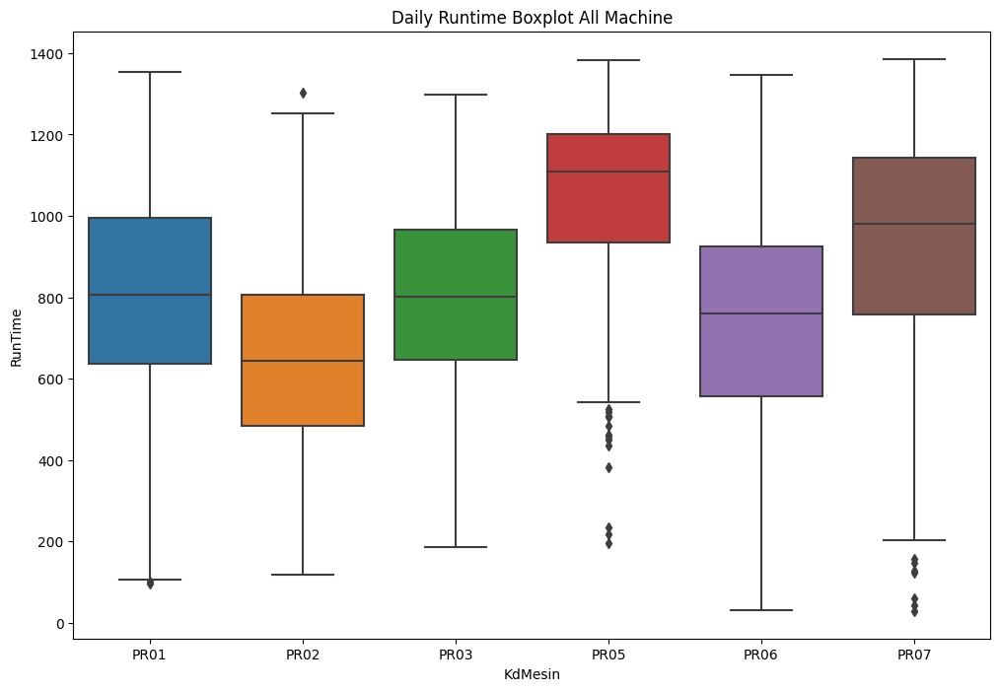

In [ ]:
pd.reset_option("display.max_rows")
# plot daily runtime boxplot per machine
plt.figure(figsize=(12,8))
sns.boxplot(x=run_mc['KdMesin'], y=run_mc['RunTime'], data=run_mc, orient="v")
plt.title('Daily Runtime Boxplot All Machine')
plt.show()

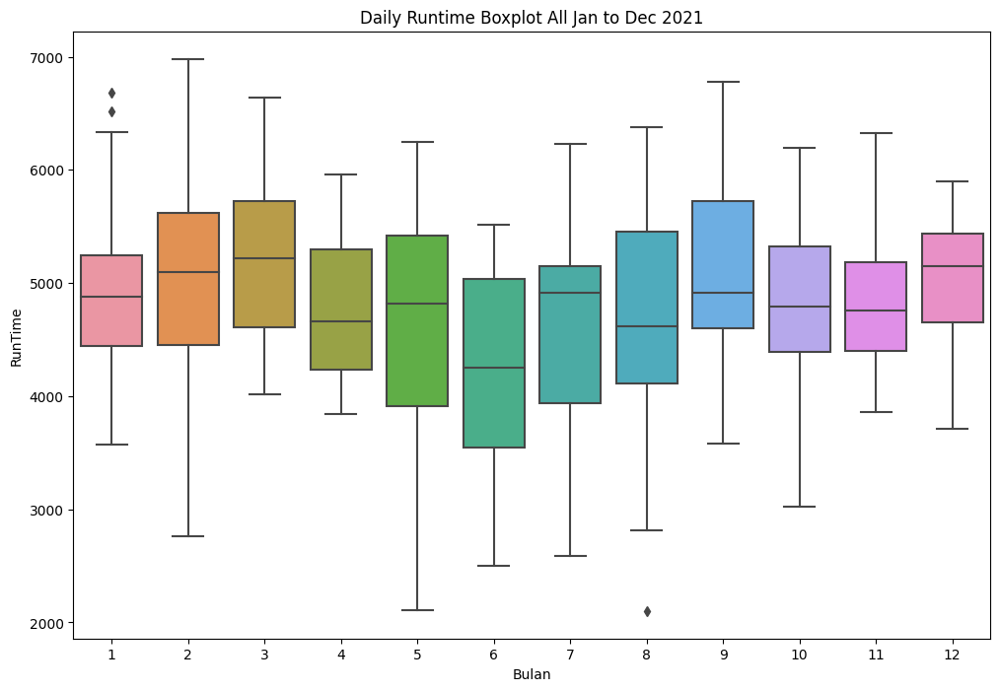

In [ ]:
# plot daily runtime boxplot per Jan to Dec 2021
box_run = run.pivot_table(values='RunTime', index=['Tgl','Bulan'], fill_value=0, aggfunc=np.sum).reset_index()

plt.figure(figsize=(12,8))
sns.boxplot(x=box_run['Bulan'], y=box_run['RunTime'], data=box_run, orient="v")
plt.title('Daily Runtime Boxplot All Jan to Dec 2021')
plt.show()

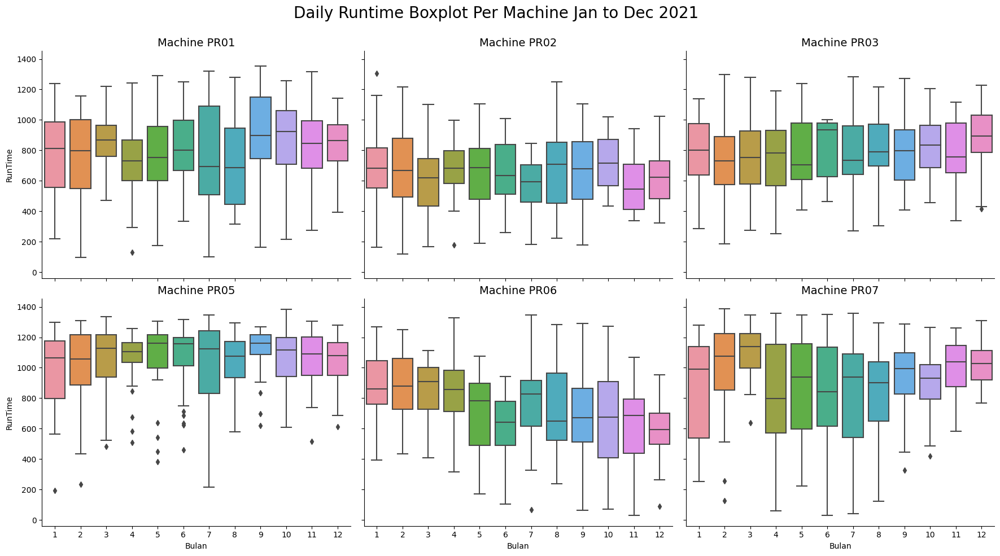

In [ ]:
# plot daily runtime boxplot per Jan to Dec 2021
box_run = run.pivot_table(values='RunTime', index=['Tgl','Bulan','KdMesin'], fill_value=0, aggfunc=np.sum).reset_index()

g = sns.catplot(x= 'Bulan', y='RunTime', data=box_run,kind='box', col='KdMesin', col_wrap=3, orient="v")
g.set_titles('Machine {col_name}', size=14)
g.fig.suptitle('Daily Runtime Boxplot Per Machine Jan to Dec 2021',fontsize=20)
g.fig.set_size_inches(18,10)
g.fig.subplots_adjust(top=.9)
plt.show()

In [ ]:
"""
# Finding the IQR for PR05
percentile25 = run_pr05['RunTime'].quantile(0.25)
percentile75 = run_pr05['RunTime'].quantile(0.75)
iqr = percentile75-percentile25

# Finding upper and lower limit
upper_limit = percentile75 + (1.5 * iqr)
lower_limit = percentile25 - (1.5 * iqr)

# Replacing Outliers with Median Values
run_pr05['RunTime'] = np.where((run_pr05['RunTime'] > upper_limit)|(run_pr05['RunTime'] < lower_limit), run_pr05['RunTime'].mean(), run_pr05['RunTime'])
run_mc.loc[run_mc.KdMesin=='PR05', 'RunTime'] = run_pr05['RunTime']
"""

"\n# Finding the IQR for PR05\npercentile25 = run_pr05['RunTime'].quantile(0.25)\npercentile75 = run_pr05['RunTime'].quantile(0.75)\niqr = percentile75-percentile25\n\n# Finding upper and lower limit\nupper_limit = percentile75 + (1.5 * iqr)\nlower_limit = percentile25 - (1.5 * iqr)\n\n# Replacing Outliers with Median Values\nrun_pr05['RunTime'] = np.where((run_pr05['RunTime'] > upper_limit)|(run_pr05['RunTime'] < lower_limit), run_pr05['RunTime'].mean(), run_pr05['RunTime'])\nrun_mc.loc[run_mc.KdMesin=='PR05', 'RunTime'] = run_pr05['RunTime']\n"

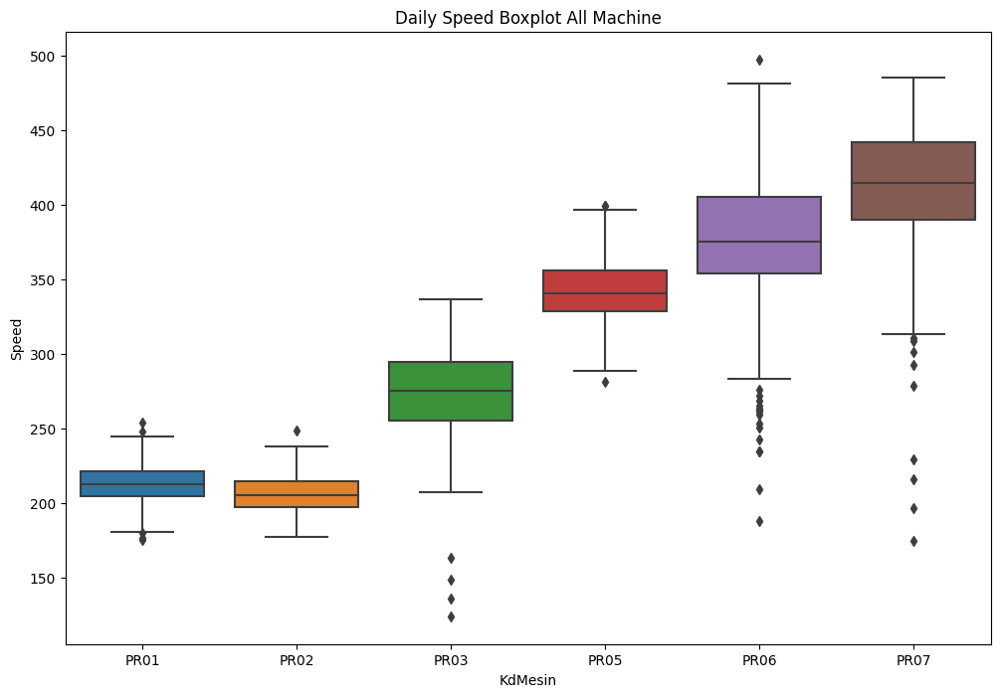

In [ ]:
# plot daily speed boxplot per machine
box_run = run.pivot_table(values='Speed', index=['Tgl','KdMesin'], fill_value=0, aggfunc=np.mean).reset_index()

plt.figure(figsize=(12,8))
sns.boxplot(x=box_run['KdMesin'], y=box_run['Speed'], data=box_run, orient="v")
plt.title('Daily Speed Boxplot All Machine')
plt.show()

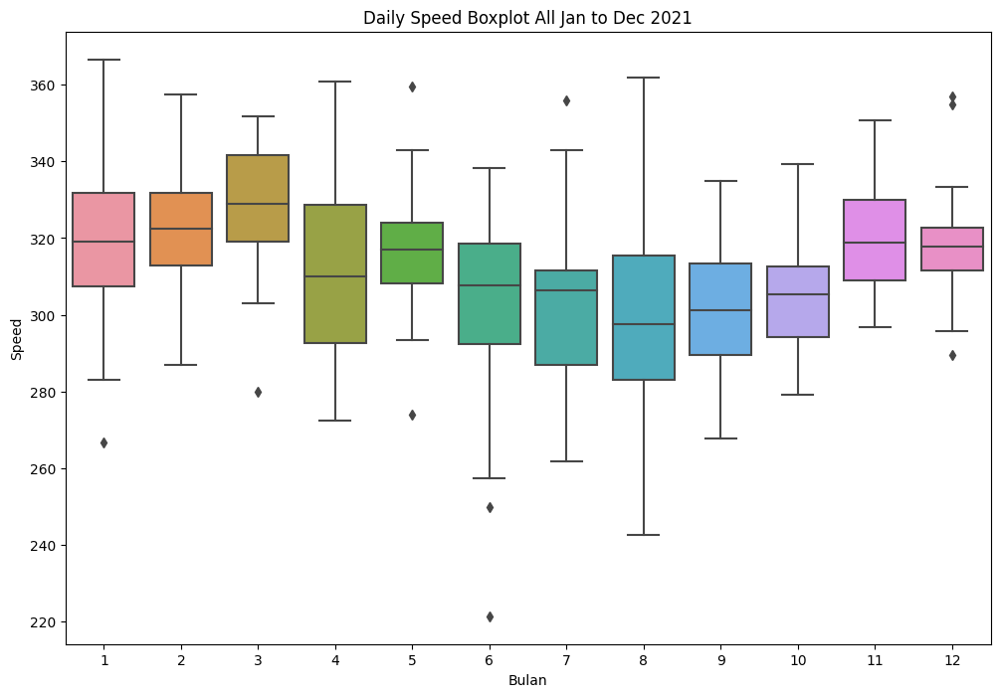

In [ ]:
# plot daily Speed boxplot per Jan to Dec 2021
box_run = run.pivot_table(values='Speed', index=['Tgl','Bulan'], fill_value=0, aggfunc=np.mean).reset_index()

plt.figure(figsize=(12,8))
sns.boxplot(x=box_run['Bulan'], y=box_run['Speed'], data=box_run, orient="v")
plt.title('Daily Speed Boxplot All Jan to Dec 2021')
plt.show()

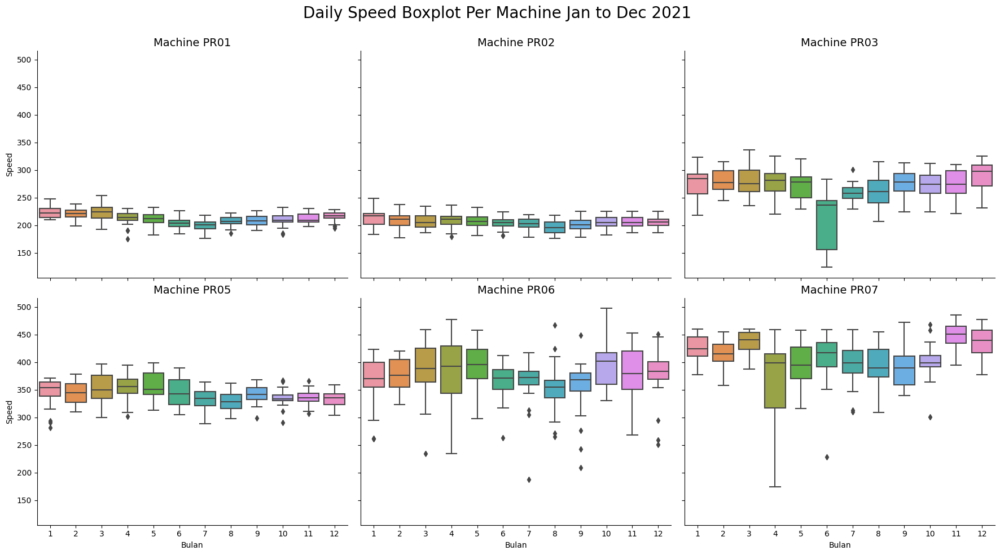

In [ ]:
# plot daily Speed boxplot per Jan to Dec 2021
box_run = run.pivot_table(values='Speed', index=['Tgl','Bulan','KdMesin'], fill_value=0, aggfunc=np.mean).reset_index()

g = sns.catplot(x= 'Bulan', y='Speed', data=box_run,kind='box', col='KdMesin', col_wrap=3, orient="v")
g.set_titles('Machine {col_name}', size=14)
g.fig.suptitle('Daily Speed Boxplot Per Machine Jan to Dec 2021',fontsize=20)
g.fig.set_size_inches(18,10)
g.fig.subplots_adjust(top=.9)
plt.show()

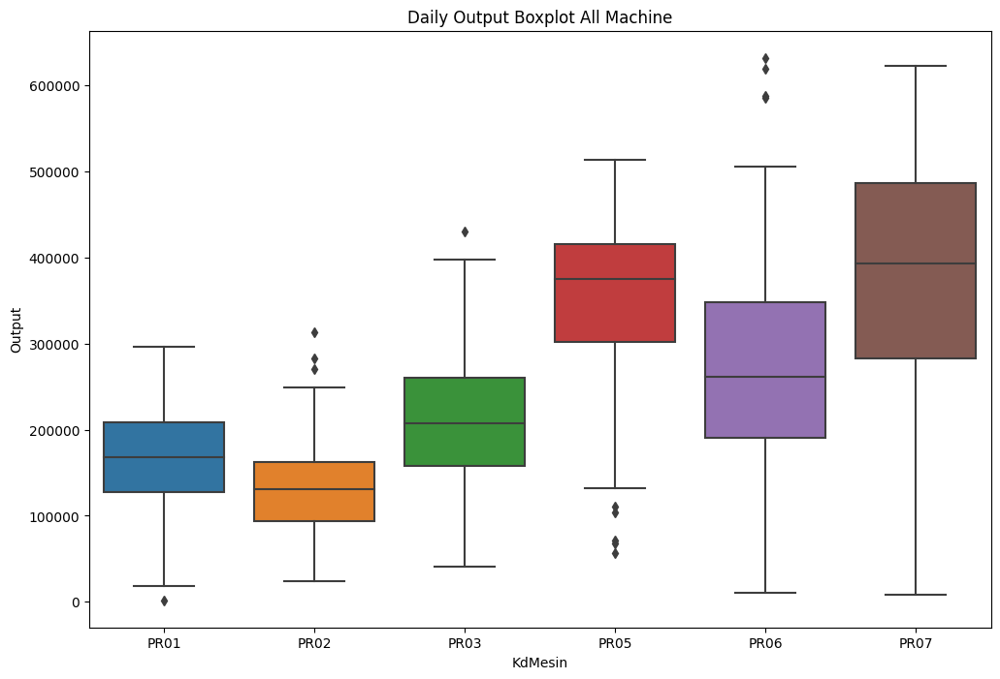

In [ ]:
# plot daily Output boxplot per machine
box_op = op.pivot_table(values='Output', index=['Tgl','KdMesin'], fill_value=0, aggfunc=np.sum).reset_index()

plt.figure(figsize=(12,8))
sns.boxplot(x=box_op['KdMesin'], y=box_op['Output'], data=box_op, orient="v")
plt.title('Daily Output Boxplot All Machine')
plt.show()

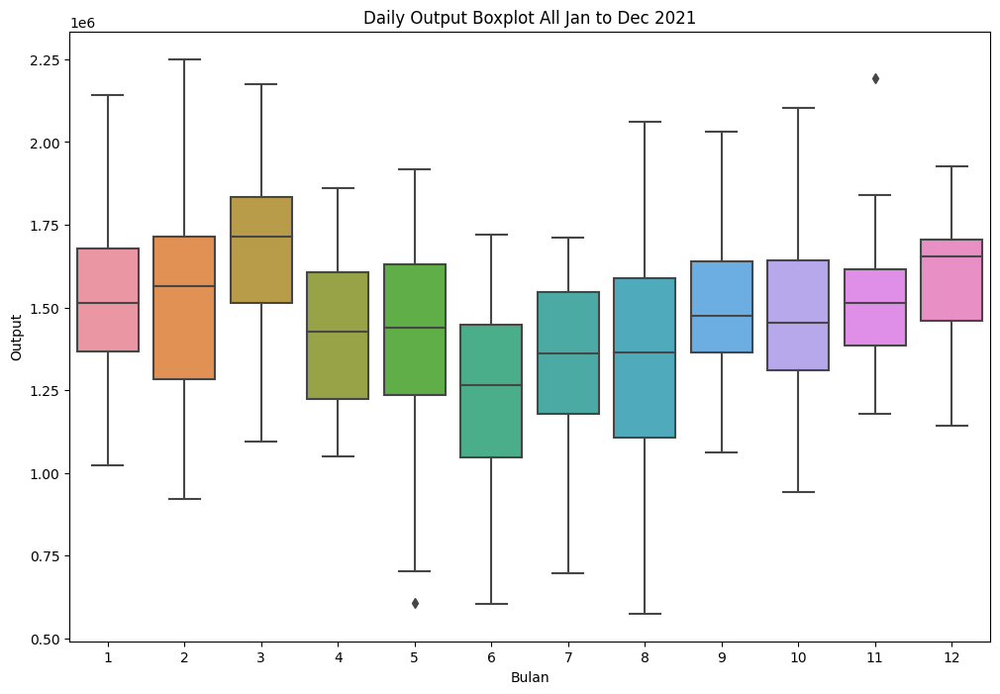

In [ ]:
# plot daily Output boxplot per Jan to Dec 2021
box_op = op.pivot_table(values='Output', index=['Tgl','Bulan'], fill_value=0, aggfunc=np.sum).reset_index()

plt.figure(figsize=(12,8))
sns.boxplot(x=box_op['Bulan'], y=box_op['Output'], data=box_op, orient="v")
plt.title('Daily Output Boxplot All Jan to Dec 2021')
plt.show()

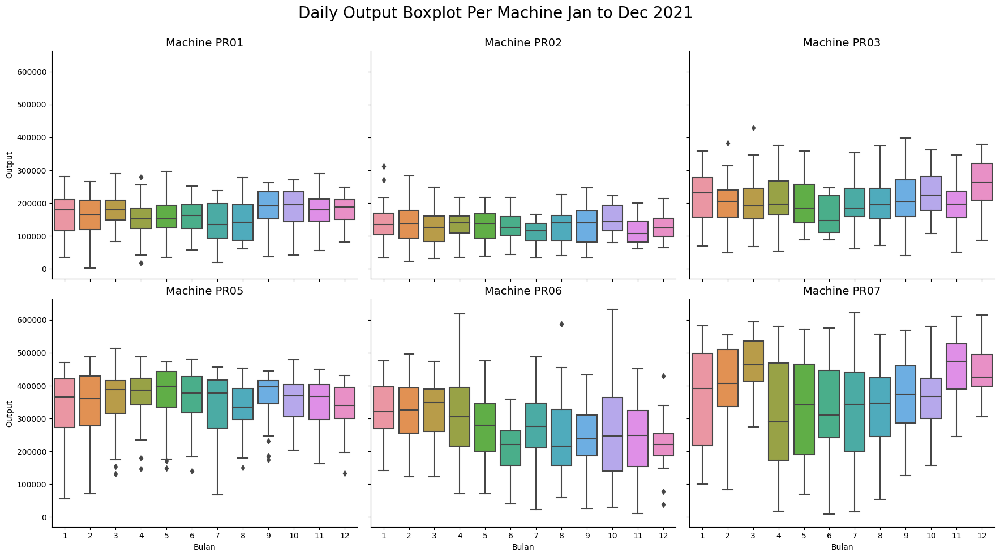

In [ ]:
# plot daily Output boxplot per Jan to Dec 2021
box_op = op.pivot_table(values='Output', index=['Tgl','Bulan','KdMesin'], fill_value=0, aggfunc=np.sum).reset_index()

g = sns.catplot(x= 'Bulan', y='Output', data=box_op,kind='box', col='KdMesin', col_wrap=3, orient="v")
g.set_titles('Machine {col_name}', size=14)
g.fig.suptitle('Daily Output Boxplot Per Machine Jan to Dec 2021',fontsize=20)
g.fig.set_size_inches(18,10)
g.fig.subplots_adjust(top=.9)
plt.show()

### **Distribution**

In [ ]:
dist_PET = op[op['FILM']=='PET'].pivot_table(values='Speed', index='Tgl', fill_value=0, aggfunc=np.mean).reset_index().rename_axis(None, axis=1)
dist_PET['Speed'] = dist_PET['Speed'].round(0).astype(int)
dist_PET['RunTime'] = op[op['FILM']=='PET'].pivot_table(values='RunTime',index='Tgl',fill_value=0, aggfunc='sum').reset_index().drop(columns='Tgl')
dist_PET['Output'] = (dist_PET['RunTime'] * dist_PET['Speed'])

dist_NYL = op[op['FILM']=='NYL'].pivot_table(values='Speed', index='Tgl', fill_value=0, aggfunc=np.mean).reset_index().rename_axis(None, axis=1)
dist_NYL['Speed'] = dist_NYL['Speed'].round(0).astype(int)
dist_NYL['RunTime'] = op[op['FILM']=='NYL'].pivot_table(values='RunTime',index='Tgl',fill_value=0, aggfunc='sum').reset_index().drop(columns='Tgl')
dist_NYL['Output'] = (dist_NYL['RunTime'] * dist_NYL['Speed'])

dist_OPP = op[op['FILM']=='OPP'].pivot_table(values='Speed', index='Tgl', fill_value=0, aggfunc=np.mean).reset_index().rename_axis(None, axis=1)
dist_OPP['Speed'] = dist_OPP['Speed'].round(0).astype(int)
dist_OPP['RunTime'] = op[op['FILM']=='OPP'].pivot_table(values='RunTime',index='Tgl',fill_value=0, aggfunc='sum').reset_index().drop(columns='Tgl')
dist_OPP['Output'] = (dist_OPP['RunTime'] * dist_OPP['Speed'])

dist_PR01 = op[op['KdMesin']=='PR01'].pivot_table(values='Speed', index='Tgl', fill_value=0, aggfunc=np.mean).reset_index().rename_axis(None, axis=1)
dist_PR01['Speed'] = dist_PR01['Speed'].round(0).astype(int)
dist_PR01['RunTime'] = op[op['KdMesin']=='PR01'].pivot_table(values='RunTime',index='Tgl',fill_value=0, aggfunc='sum').reset_index().drop(columns='Tgl')
dist_PR01['Output'] = (dist_PR01['RunTime'] * dist_PR01['Speed'])

dist_PR02 = op[op['KdMesin']=='PR02'].pivot_table(values='Speed', index='Tgl', fill_value=0, aggfunc=np.mean).reset_index().rename_axis(None, axis=1)
dist_PR02['Speed'] = dist_PR02['Speed'].round(0).astype(int)
dist_PR02['RunTime'] = op[op['KdMesin']=='PR02'].pivot_table(values='RunTime',index='Tgl',fill_value=0, aggfunc='sum').reset_index().drop(columns='Tgl')
dist_PR02['Output'] = (dist_PR02['RunTime'] * dist_PR02['Speed'])

dist_PR03 = op[op['KdMesin']=='PR03'].pivot_table(values='Speed', index='Tgl', fill_value=0, aggfunc=np.mean).reset_index().rename_axis(None, axis=1)
dist_PR03['Speed'] = dist_PR03['Speed'].round(0).astype(int)
dist_PR03['RunTime'] = op[op['KdMesin']=='PR03'].pivot_table(values='RunTime',index='Tgl',fill_value=0, aggfunc='sum').reset_index().drop(columns='Tgl')
dist_PR03['Output'] = (dist_PR03['RunTime'] * dist_PR03['Speed'])

dist_PR05 = op[op['KdMesin']=='PR05'].pivot_table(values='Speed', index='Tgl', fill_value=0, aggfunc=np.mean).reset_index().rename_axis(None, axis=1)
dist_PR05['Speed'] = dist_PR05['Speed'].round(0).astype(int)
dist_PR05['RunTime'] = op[op['KdMesin']=='PR05'].pivot_table(values='RunTime',index='Tgl',fill_value=0, aggfunc='sum').reset_index().drop(columns='Tgl')
dist_PR05['Output'] = (dist_PR05['RunTime'] * dist_PR05['Speed'])

dist_PR06 = op[op['KdMesin']=='PR06'].pivot_table(values='Speed', index='Tgl', fill_value=0, aggfunc=np.mean).reset_index().rename_axis(None, axis=1)
dist_PR06['Speed'] = dist_PR06['Speed'].round(0).astype(int)
dist_PR06['RunTime'] = op[op['KdMesin']=='PR06'].pivot_table(values='RunTime',index='Tgl',fill_value=0, aggfunc='sum').reset_index().drop(columns='Tgl')
dist_PR06['Output'] = (dist_PR06['RunTime'] * dist_PR06['Speed'])

dist_PR07 = op[op['KdMesin']=='PR07'].pivot_table(values='Speed', index='Tgl', fill_value=0, aggfunc=np.mean).reset_index().rename_axis(None, axis=1)
dist_PR07['Speed'] = dist_PR07['Speed'].round(0).astype(int)
dist_PR07['RunTime'] = op[op['KdMesin']=='PR07'].pivot_table(values='RunTime',index='Tgl',fill_value=0, aggfunc='sum').reset_index().drop(columns='Tgl')
dist_PR07['Output'] = (dist_PR07['RunTime'] * dist_PR07['Speed'])

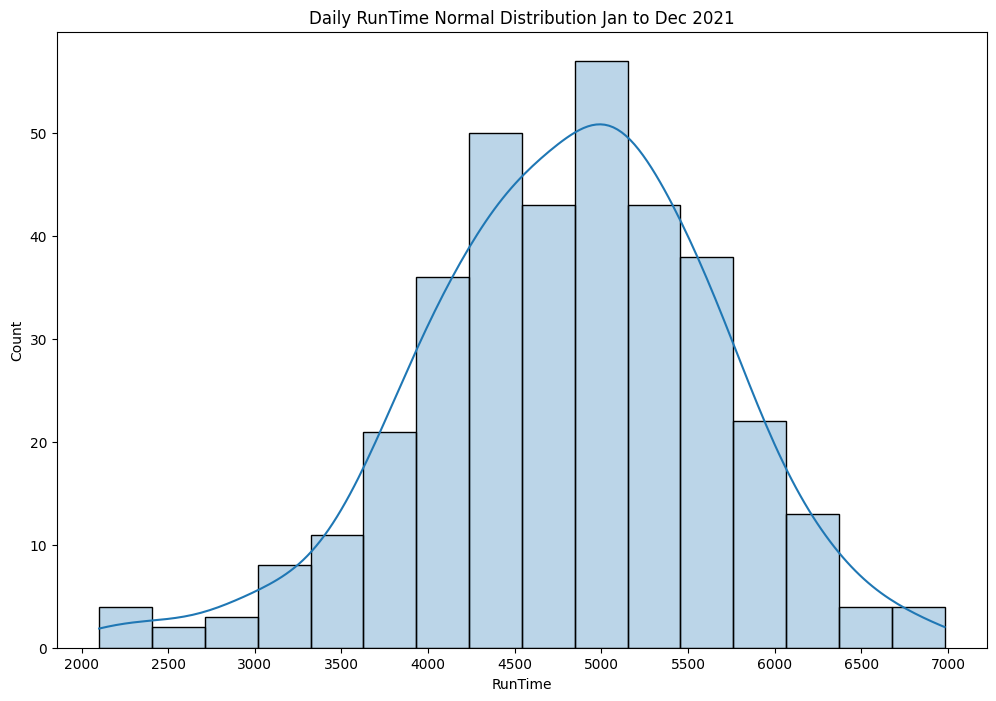

In [ ]:
# plot daily RunTime distribution
dist_run = run.pivot_table(values='RunTime', index='Tgl', fill_value=0, aggfunc=np.sum)

fig, ax = plt.subplots(figsize=(12,8))
sns.histplot(dist_run['RunTime'], ax = ax,kde=True,alpha=0.3)
ax.set_title('Daily RunTime Normal Distribution Jan to Dec 2021')
ax.set_xticks(np.arange(start=2000,stop=7500,step=500))
plt.show()

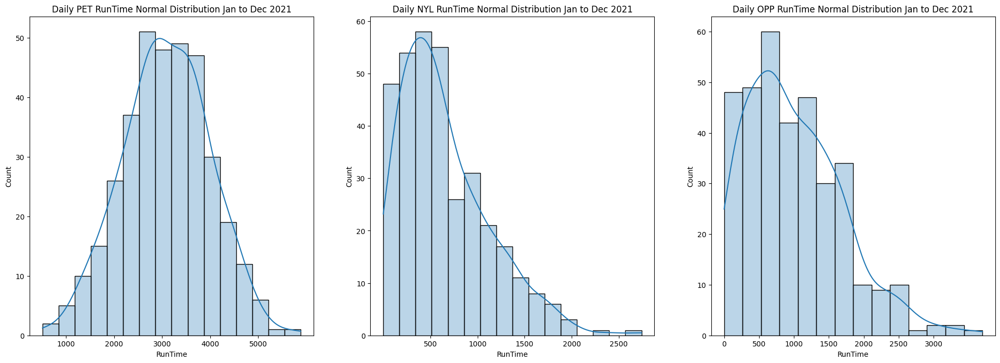

In [ ]:
# plotting runtime normal dist per material

f, axarr = plt.subplots(nrows=1,ncols=3,figsize=(24, 8))
# plot material PET
sns.histplot(dist_PET['RunTime'], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('Daily PET RunTime Normal Distribution Jan to Dec 2021')
axarr[0].set_xticks(np.arange(start=1000,stop=6000,step=1000))

# plot material NYL
sns.histplot(dist_NYL['RunTime'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('Daily NYL RunTime Normal Distribution Jan to Dec 2021')
axarr[1].set_xticks(np.arange(start=2000,stop=2500,step=500))

# plot material OPP
sns.histplot(dist_OPP['RunTime'], ax = axarr[2],kde=True,alpha=0.3)
axarr[2].set_title('Daily OPP RunTime Normal Distribution Jan to Dec 2021')
axarr[2].set_xticks(np.arange(start=0,stop=3500,step=500))

plt.show()

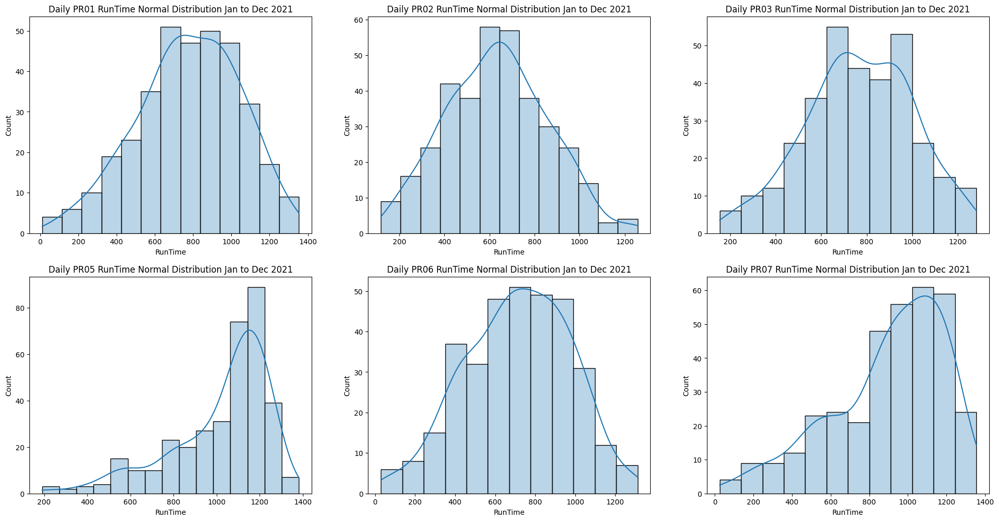

In [ ]:
# plotting runtime normal dist per material

f, axarr = plt.subplots(nrows=2,ncols=3,figsize=(24, 12))
# plot material PR01
sns.histplot(dist_PR01['RunTime'], ax = axarr[0][0],kde=True,alpha=0.3)
axarr[0][0].set_title('Daily PR01 RunTime Normal Distribution Jan to Dec 2021')

# plot material PR02
sns.histplot(dist_PR02['RunTime'], ax = axarr[0][1],kde=True,alpha=0.3)
axarr[0][1].set_title('Daily PR02 RunTime Normal Distribution Jan to Dec 2021')

# plot material PR03
sns.histplot(dist_PR03['RunTime'], ax = axarr[0][2],kde=True,alpha=0.3)
axarr[0][2].set_title('Daily PR03 RunTime Normal Distribution Jan to Dec 2021')

# plot material PR05
sns.histplot(dist_PR05['RunTime'], ax = axarr[1][0],kde=True,alpha=0.3)
axarr[1][0].set_title('Daily PR05 RunTime Normal Distribution Jan to Dec 2021')

# plot material PR06
sns.histplot(dist_PR06['RunTime'], ax = axarr[1][1],kde=True,alpha=0.3)
axarr[1][1].set_title('Daily PR06 RunTime Normal Distribution Jan to Dec 2021')

# plot material PR07
sns.histplot(dist_PR07['RunTime'], ax = axarr[1][2],kde=True,alpha=0.3)
axarr[1][2].set_title('Daily PR07 RunTime Normal Distribution Jan to Dec 2021')

plt.show()

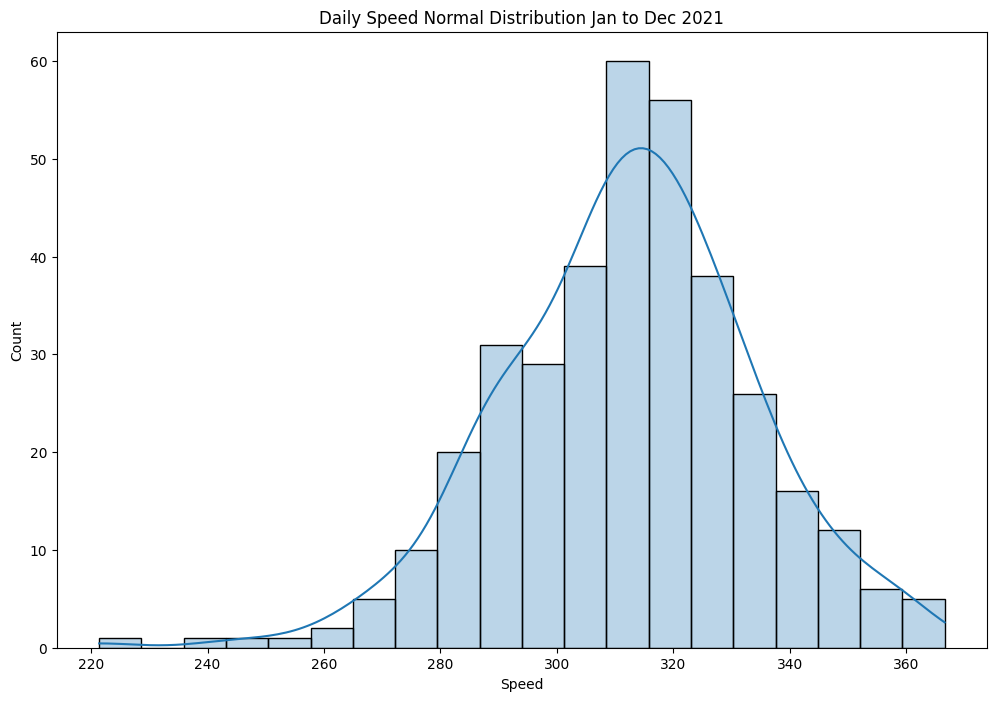

In [ ]:
# plot daily speed distribution
dist_run = run.pivot_table(values='Speed', index='Tgl', fill_value=0, aggfunc=np.mean)

fig, ax = plt.subplots(figsize=(12,8))
sns.histplot(dist_run['Speed'], ax = ax,kde=True,alpha=0.3)
ax.set_title('Daily Speed Normal Distribution Jan to Dec 2021')
plt.show()

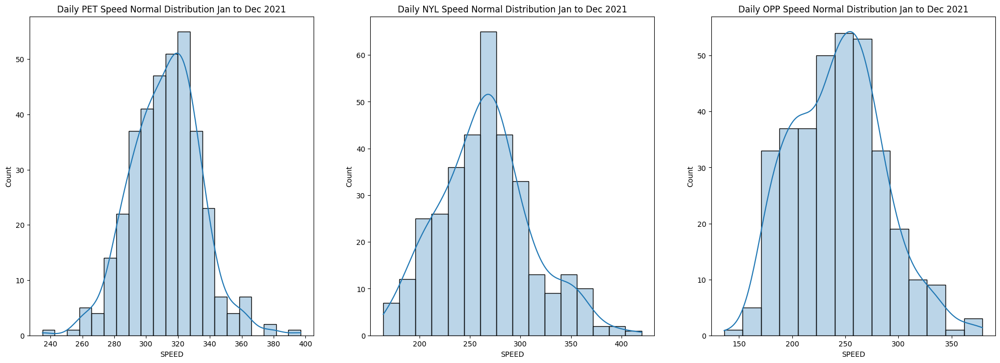

In [ ]:
# plotting Speed normal dist per material
f, axarr = plt.subplots(nrows=1,ncols=3,figsize=(24, 8))
# plot material PET
sns.histplot(dist_PET['Speed'], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('Daily PET Speed Normal Distribution Jan to Dec 2021')

# plot material NYL
sns.histplot(dist_NYL['Speed'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('Daily NYL Speed Normal Distribution Jan to Dec 2021')

# plot material OPP
sns.histplot(dist_OPP['Speed'], ax = axarr[2],kde=True,alpha=0.3)
axarr[2].set_title('Daily OPP Speed Normal Distribution Jan to Dec 2021')

plt.show()

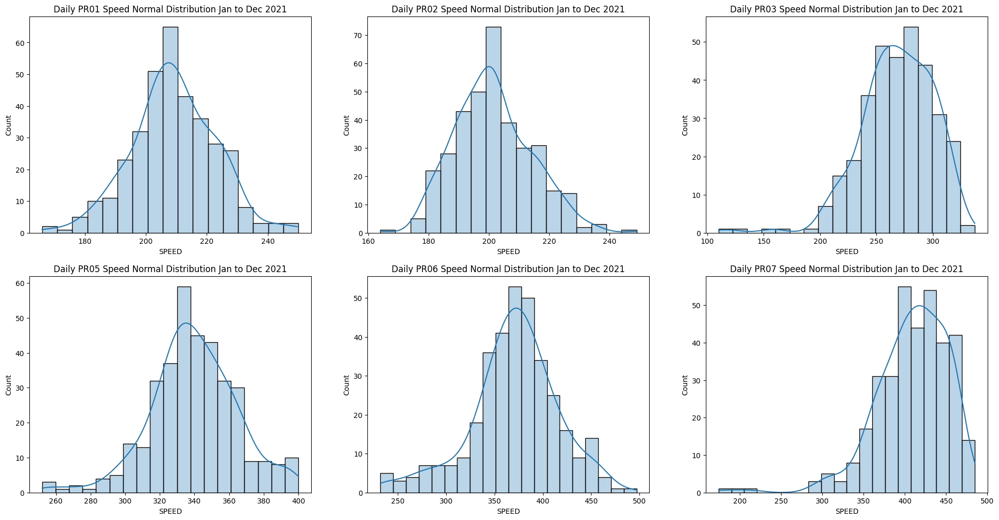

In [ ]:
# plotting Speed normal dist per material
f, axarr = plt.subplots(nrows=2,ncols=3,figsize=(24, 12))
# plot material PR01
sns.histplot(dist_PR01['Speed'], ax = axarr[0][0],kde=True,alpha=0.3)
axarr[0][0].set_title('Daily PR01 Speed Normal Distribution Jan to Dec 2021')

# plot material PR02
sns.histplot(dist_PR02['Speed'], ax = axarr[0][1],kde=True,alpha=0.3)
axarr[0][1].set_title('Daily PR02 Speed Normal Distribution Jan to Dec 2021')

# plot material PR03
sns.histplot(dist_PR03['Speed'], ax = axarr[0][2],kde=True,alpha=0.3)
axarr[0][2].set_title('Daily PR03 Speed Normal Distribution Jan to Dec 2021')

# plot material PR05
sns.histplot(dist_PR05['Speed'], ax = axarr[1][0],kde=True,alpha=0.3)
axarr[1][0].set_title('Daily PR05 Speed Normal Distribution Jan to Dec 2021')

# plot material PR06
sns.histplot(dist_PR06['Speed'], ax = axarr[1][1],kde=True,alpha=0.3)
axarr[1][1].set_title('Daily PR06 Speed Normal Distribution Jan to Dec 2021')

# plot material PR07
sns.histplot(dist_PR07['Speed'], ax = axarr[1][2],kde=True,alpha=0.3)
axarr[1][2].set_title('Daily PR07 Speed Normal Distribution Jan to Dec 2021')

plt.show()

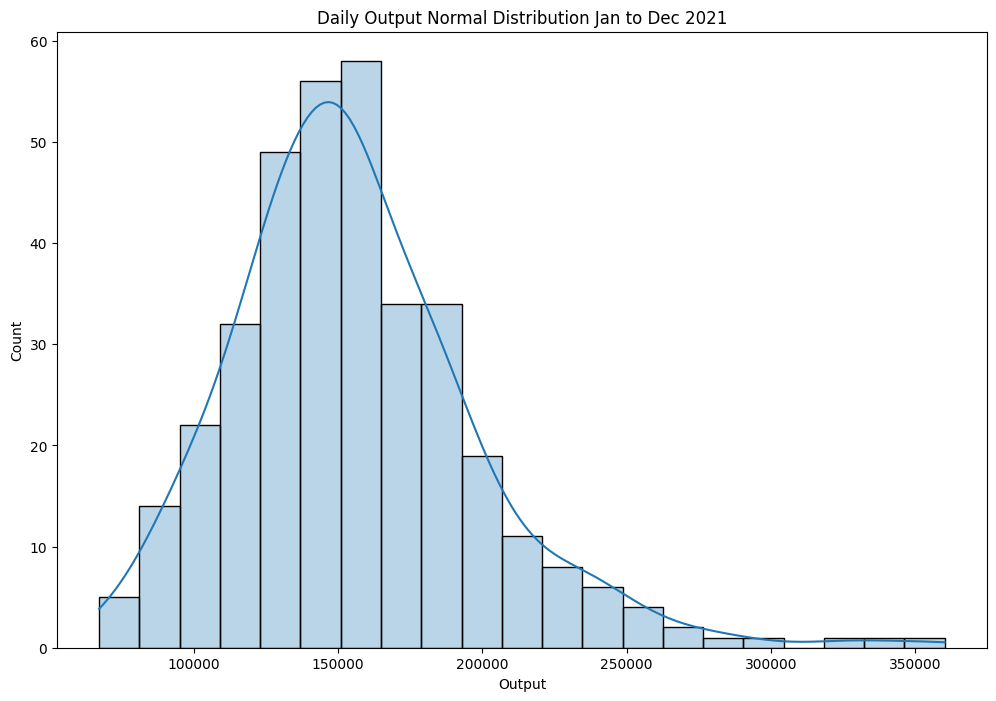

In [ ]:
# plot daily output distribution
dist_op = op.pivot_table(values='Output', index='Tgl', fill_value=0, aggfunc=np.mean)

fig, ax = plt.subplots(figsize=(12,8))
sns.histplot(dist_op['Output'], ax = ax,kde=True,alpha=0.3)
ax.set_title('Daily Output Normal Distribution Jan to Dec 2021')
ax.set_xlabel('Output')
plt.show()

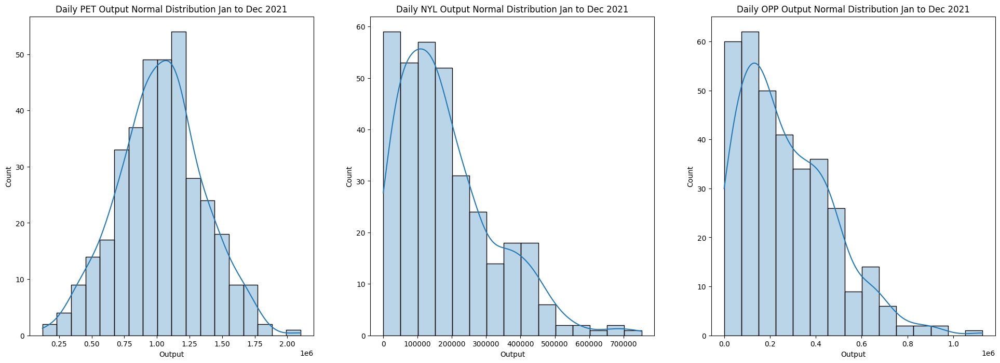

In [ ]:
# plotting output normal dist per material
dist_pet = op[op['FILM']=='PET'].pivot_table(values='Output', index='Tgl', fill_value=0, aggfunc=np.sum)
dist_nyl = op[op['FILM']=='NYL'].pivot_table(values='Output', index='Tgl', fill_value=0, aggfunc=np.sum)
dist_opp = op[op['FILM']=='OPP'].pivot_table(values='Output', index='Tgl', fill_value=0, aggfunc=np.sum)

f, axarr = plt.subplots(nrows=1,ncols=3,figsize=(24, 8))
# plot material PET
sns.histplot(dist_pet['Output'], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('Daily PET Output Normal Distribution Jan to Dec 2021')

# plot material NYL
sns.histplot(dist_nyl['Output'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('Daily NYL Output Normal Distribution Jan to Dec 2021')

# plot material OPP
sns.histplot(dist_opp['Output'], ax = axarr[2],kde=True,alpha=0.3)
axarr[2].set_title('Daily OPP Output Normal Distribution Jan to Dec 2021')

plt.show()

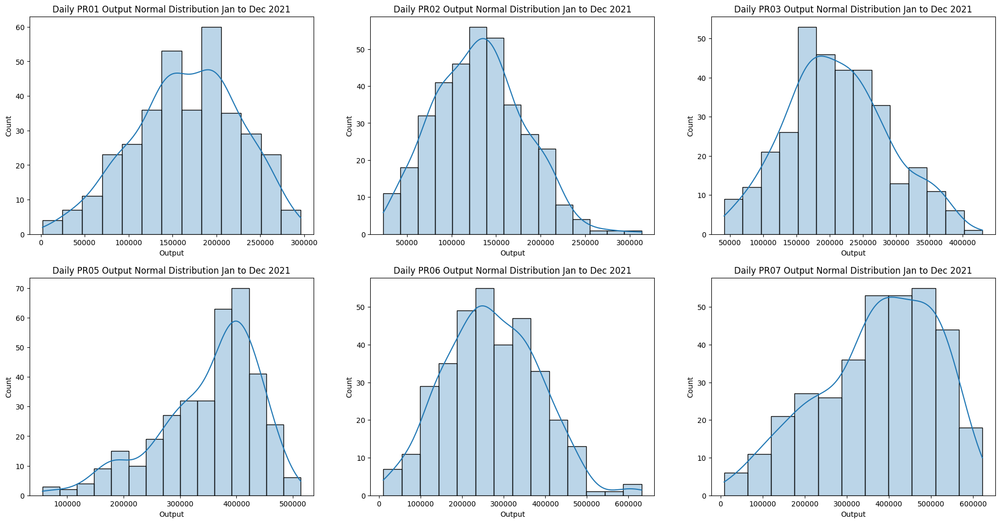

In [ ]:
# plotting Output normal dist per material
dist_PR01 = op[op['KdMesin']=='PR01'].pivot_table(values='Output', index='Tgl', fill_value=0, aggfunc=np.sum)
dist_PR02 = op[op['KdMesin']=='PR02'].pivot_table(values='Output', index='Tgl', fill_value=0, aggfunc=np.sum)
dist_PR03 = op[op['KdMesin']=='PR03'].pivot_table(values='Output', index='Tgl', fill_value=0, aggfunc=np.sum)
dist_PR05 = op[op['KdMesin']=='PR05'].pivot_table(values='Output', index='Tgl', fill_value=0, aggfunc=np.sum)
dist_PR06 = op[op['KdMesin']=='PR06'].pivot_table(values='Output', index='Tgl', fill_value=0, aggfunc=np.sum)
dist_PR07 = op[op['KdMesin']=='PR07'].pivot_table(values='Output', index='Tgl', fill_value=0, aggfunc=np.sum)

f, axarr = plt.subplots(nrows=2,ncols=3,figsize=(24, 12))
# plot material PR01
sns.histplot(dist_PR01['Output'], ax = axarr[0][0],kde=True,alpha=0.3)
axarr[0][0].set_title('Daily PR01 Output Normal Distribution Jan to Dec 2021')

# plot material PR02
sns.histplot(dist_PR02['Output'], ax = axarr[0][1],kde=True,alpha=0.3)
axarr[0][1].set_title('Daily PR02 Output Normal Distribution Jan to Dec 2021')

# plot material PR03
sns.histplot(dist_PR03['Output'], ax = axarr[0][2],kde=True,alpha=0.3)
axarr[0][2].set_title('Daily PR03 Output Normal Distribution Jan to Dec 2021')

# plot material PR05
sns.histplot(dist_PR05['Output'], ax = axarr[1][0],kde=True,alpha=0.3)
axarr[1][0].set_title('Daily PR05 Output Normal Distribution Jan to Dec 2021')

# plot material PR06
sns.histplot(dist_PR06['Output'], ax = axarr[1][1],kde=True,alpha=0.3)
axarr[1][1].set_title('Daily PR06 Output Normal Distribution Jan to Dec 2021')

# plot material PR07
sns.histplot(dist_PR07['Output'], ax = axarr[1][2],kde=True,alpha=0.3)
axarr[1][2].set_title('Daily PR07 Output Normal Distribution Jan to Dec 2021')

plt.show()

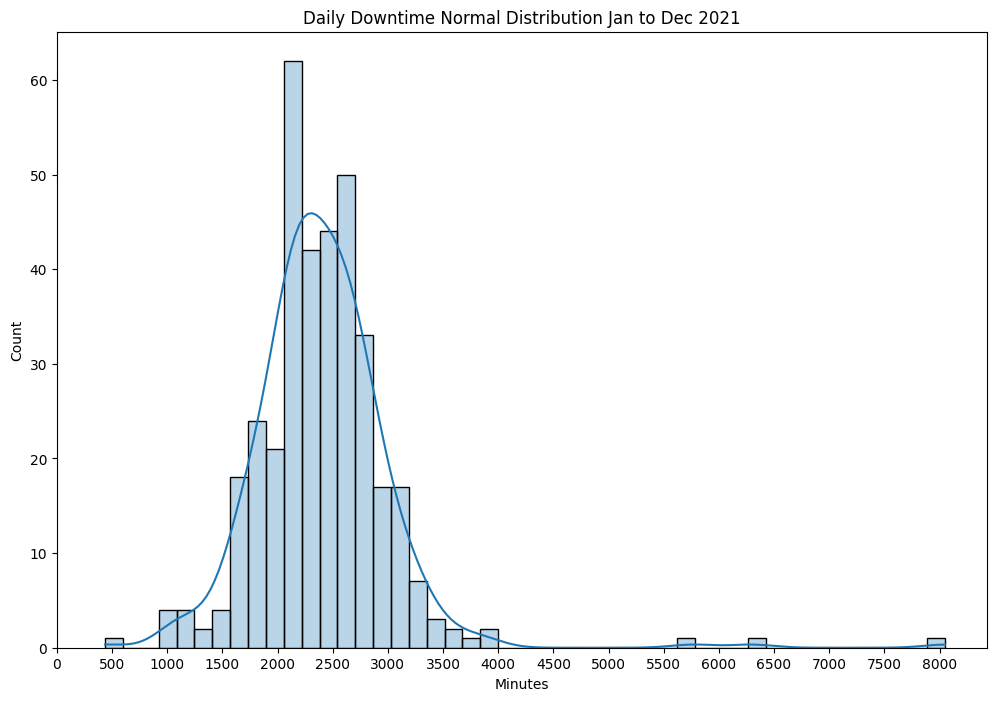

In [ ]:
# plot daily Downtime distribution
dist_down = down.pivot_table(values='Downtime', index='Tgl', fill_value=0, aggfunc=np.sum)

fig, ax = plt.subplots(figsize=(12,8))
sns.histplot(dist_down['Downtime'], ax = ax,kde=True,alpha=0.3)
ax.set_title('Daily Downtime Normal Distribution Jan to Dec 2021')
ax.set_xlabel('Minutes')
ax.set_xticks([0,500,1000,1500,2000,2500,3000,3500,4000,4500,5000,5500,6000,6500,7000,7500,8000])
plt.show()

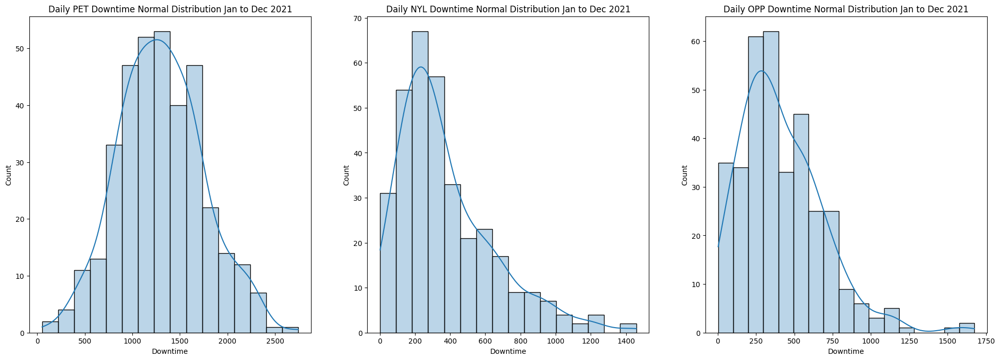

In [ ]:
# plotting Downtime normal dist per material
dist_pet = down[down['FILM']=='PET'].pivot_table(values='Downtime', index='Tgl', fill_value=0, aggfunc=np.sum)
dist_nyl = down[down['FILM']=='NYL'].pivot_table(values='Downtime', index='Tgl', fill_value=0, aggfunc=np.sum)
dist_opp = down[down['FILM']=='OPP'].pivot_table(values='Downtime', index='Tgl', fill_value=0, aggfunc=np.sum)

f, axarr = plt.subplots(nrows=1,ncols=3,figsize=(24, 8))
# plot material PET
sns.histplot(dist_pet['Downtime'], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('Daily PET Downtime Normal Distribution Jan to Dec 2021')

# plot material NYL
sns.histplot(dist_nyl['Downtime'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('Daily NYL Downtime Normal Distribution Jan to Dec 2021')

# plot material OPP
sns.histplot(dist_opp['Downtime'], ax = axarr[2],kde=True,alpha=0.3)
axarr[2].set_title('Daily OPP Downtime Normal Distribution Jan to Dec 2021')

plt.show()

## **2. Runtime, Speed, and TCL by Material**

### **Per Machine**

In [ ]:
# data material PET
mc_pet = run[run['FILM']=='PET'].pivot_table(values=['Speed','target'],index='KdMesin').reset_index()
mc_pet['Speed'] = np.ceil(mc_pet['Speed']).astype(int)
mc_pet['target'] = np.ceil(mc_pet['target']).astype(int)

mc_pet['RunTime'] = run[run['FILM']=='PET'].pivot_table(values='RunTime',index='KdMesin',aggfunc='sum').reset_index().drop(columns=['KdMesin'])
mc_pet['Output'] = mc_pet['Speed'] * mc_pet['RunTime']

# data material NYL
mc_nyl = run[(run['FILM']=='NYL')].pivot_table(values=['Speed','target'],index='KdMesin').reset_index()
mc_nyl['Speed'] = np.ceil(mc_nyl['Speed']).astype(int) #round-up to whole number
mc_nyl['target'] = np.ceil(mc_nyl['target']).astype(int)

mc_nyl['RunTime'] = run[run['FILM']=='NYL'].pivot_table(values='RunTime',index='KdMesin',aggfunc='sum').reset_index().drop(columns=['KdMesin'])
mc_nyl['Output'] = mc_nyl['Speed'] * mc_nyl['RunTime']

# material OPP
mc_opp = run[(run['FILM']=='OPP')].pivot_table(values=['Speed','target'],index='KdMesin').reset_index()
mc_opp['Speed'] = np.ceil(mc_opp['Speed']).astype(int)
mc_opp['target'] = np.ceil(mc_opp['target']).astype(int)

mc_opp['RunTime'] = run[run['FILM']=='OPP'].pivot_table(values='RunTime',index='KdMesin',aggfunc='sum').reset_index().drop(columns=['KdMesin'])
mc_opp['Output'] = mc_opp['Speed'] * mc_opp['RunTime']

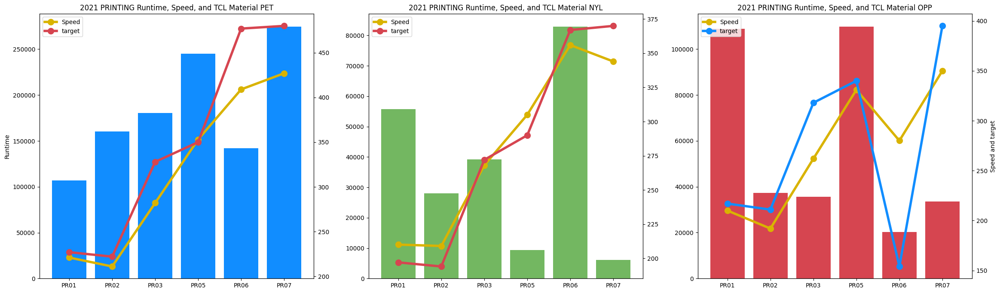

In [ ]:
# plotting RunTime, target, and Speed per material
f, axarr = plt.subplots(nrows=1,ncols=3,figsize=(28, 8))

# plot material PET
plt.sca(axarr[0]);
plt.bar(mc_pet['KdMesin'],mc_pet['RunTime'], color='#118dff')
plt.ylabel('Runtime')

ax2 = axarr[0].twinx()
line1, = ax2.plot(mc_pet['KdMesin'],mc_pet['Speed'],color= "#d9b300",linewidth=4, marker='o', markersize=10, label='Speed')
line2, = ax2.plot(mc_pet['KdMesin'],mc_pet['target'],color= "#d64550",linewidth=4, marker='o', markersize=10, label='target')
ax2.legend()
plt.title('2021 PRINTING Runtime, Speed, and TCL Material PET')

# plot material NYL
plt.sca(axarr[1]);
plt.bar(mc_nyl['KdMesin'],mc_nyl['RunTime'],color='#73b761')

ax2 = axarr[1].twinx()
line1, = ax2.plot(mc_nyl['KdMesin'],mc_nyl['Speed'],color= "#d9b300",linewidth=4, marker='o', markersize=10, label='Speed')
line2, = ax2.plot(mc_nyl['KdMesin'],mc_nyl['target'],color= "#d64550",linewidth=4, marker='o', markersize=10, label='target')
ax2.legend()

plt.title('2021 PRINTING Runtime, Speed, and TCL Material NYL')

# plot material OPP
plt.sca(axarr[2]);
plt.bar(mc_opp['KdMesin'],mc_opp['RunTime'],color='#d64550')

ax2 = axarr[2].twinx()
line1, = ax2.plot(mc_opp['KdMesin'],mc_opp['Speed'],color= "#d9b300",linewidth=4, marker='o', markersize=10, label='Speed')
line2, = ax2.plot(mc_opp['KdMesin'],mc_opp['target'],color= "#118dff",linewidth=4, marker='o', markersize=10, label='target')
ax2.set_ylabel('Speed and target')
ax2.legend()

plt.title('2021 PRINTING Runtime, Speed, and TCL Material OPP')
plt.show()

### **Monthly**

In [ ]:
# data material PET
month_pet = run[run['FILM']=='PET'].pivot_table(values=['Speed','target'],index='Bulan').reset_index()
month_pet['Speed'] = np.ceil(month_pet['Speed']).astype(int)
month_pet['target'] = np.ceil(month_pet['target']).astype(int)
month_pet['RunTime'] = run[run['FILM']=='PET'].pivot_table(values='RunTime',index='Bulan',aggfunc='sum').reset_index().drop(columns=['Bulan'])

# data material NYL
month_nyl = run[(run['FILM']=='NYL')].pivot_table(values=['Speed','target'],index='Bulan').reset_index()
month_nyl['Speed'] = np.ceil(month_nyl['Speed']).astype(int) #round-up to whole number
month_nyl['target'] = np.ceil(month_nyl['target']).astype(int)
month_nyl['RunTime'] = run[run['FILM']=='NYL'].pivot_table(values='RunTime',index='Bulan',aggfunc='sum').reset_index().drop(columns=['Bulan'])

# material OPP
month_opp = run[(run['FILM']=='OPP')].pivot_table(values=['Speed','target'],index='Bulan').reset_index()
month_opp['Speed'] = np.ceil(month_opp['Speed']).astype(int)
month_opp['target'] = np.ceil(month_opp['target']).astype(int)
month_opp['RunTime'] = run[run['FILM']=='OPP'].pivot_table(values='RunTime',index='Bulan',aggfunc='sum').reset_index().drop(columns=['Bulan'])


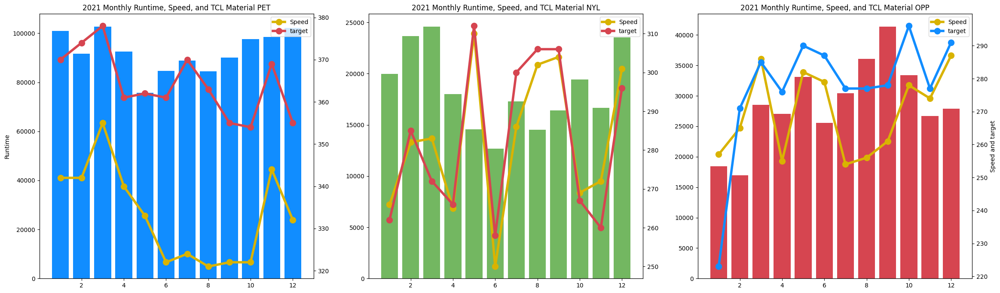

In [ ]:
# plotting RunTime, target, and Speed per material
f, axarr = plt.subplots(nrows=1,ncols=3,figsize=(28, 8))

# plot material PET
plt.sca(axarr[0]);
plt.bar(month_pet['Bulan'],month_pet['RunTime'], color='#118dff')
plt.ylabel('Runtime')

ax2 = axarr[0].twinx()
line1, = ax2.plot(month_pet['Bulan'],month_pet['Speed'],color= "#d9b300",linewidth=4, marker='o', markersize=10, label='Speed')
line2, = ax2.plot(month_pet['Bulan'],month_pet['target'],color= "#d64550",linewidth=4, marker='o', markersize=10, label='target')
ax2.legend()
plt.title('2021 Monthly Runtime, Speed, and TCL Material PET')

# plot material NYL
plt.sca(axarr[1]);
plt.bar(month_nyl['Bulan'],month_nyl['RunTime'],color='#73b761')

ax2 = axarr[1].twinx()
line1, = ax2.plot(month_nyl['Bulan'],month_nyl['Speed'],color= "#d9b300",linewidth=4, marker='o', markersize=10, label='Speed')
line2, = ax2.plot(month_nyl['Bulan'],month_nyl['target'],color= "#d64550",linewidth=4, marker='o', markersize=10, label='target')
ax2.legend()

plt.title('2021 Monthly Runtime, Speed, and TCL Material NYL')

# plot material OPP
plt.sca(axarr[2]);
plt.bar(month_opp['Bulan'],month_opp['RunTime'],color='#d64550')

ax2 = axarr[2].twinx()
line1, = ax2.plot(month_opp['Bulan'],month_opp['Speed'],color= "#d9b300",linewidth=4, marker='o', markersize=10, label='Speed')
line2, = ax2.plot(month_opp['Bulan'],month_opp['target'],color= "#118dff",linewidth=4, marker='o', markersize=10, label='target')
ax2.set_ylabel('Speed and target')
ax2.legend()

plt.title('2021 Monthly Runtime, Speed, and TCL Material OPP')

plt.show()

### **Monthly for PR01**

In [ ]:
# data material PET PR01
month_pet = run[(run['FILM']=='PET')&(run['KdMesin']=='PR01')].pivot_table(values=['Speed','target'],index='Bulan').reset_index()
month_pet['Speed'] = np.ceil(month_pet['Speed']).astype(int)
month_pet['target'] = np.ceil(month_pet['target']).astype(int)
month_pet['RunTime'] = run[(run['FILM']=='PET')&(run['KdMesin']=='PR01')].pivot_table(values='RunTime',index='Bulan',aggfunc='sum').reset_index().drop(columns=['Bulan'])

# data material NYL PR01
month_nyl = run[(run['FILM']=='NYL')&(run['KdMesin']=='PR01')].pivot_table(values=['Speed','target'],index='Bulan').reset_index()
month_nyl['Speed'] = np.ceil(month_nyl['Speed']).astype(int) #round-up to whole number
month_nyl['target'] = np.ceil(month_nyl['target']).astype(int)
month_nyl['RunTime'] = run[(run['FILM']=='NYL')&(run['KdMesin']=='PR01')].pivot_table(values='RunTime',index='Bulan',aggfunc='sum').reset_index().drop(columns=['Bulan'])

# material OPP PR01
month_opp = run[(run['FILM']=='OPP')&(run['KdMesin']=='PR01')].pivot_table(values=['Speed','target'],index='Bulan').reset_index()
month_opp['Speed'] = np.ceil(month_opp['Speed']).astype(int)
month_opp['target'] = np.ceil(month_opp['target']).astype(int)
month_opp['RunTime'] = run[(run['FILM']=='OPP')&(run['KdMesin']=='PR01')].pivot_table(values='RunTime',index='Bulan',aggfunc='sum').reset_index().drop(columns=['Bulan'])

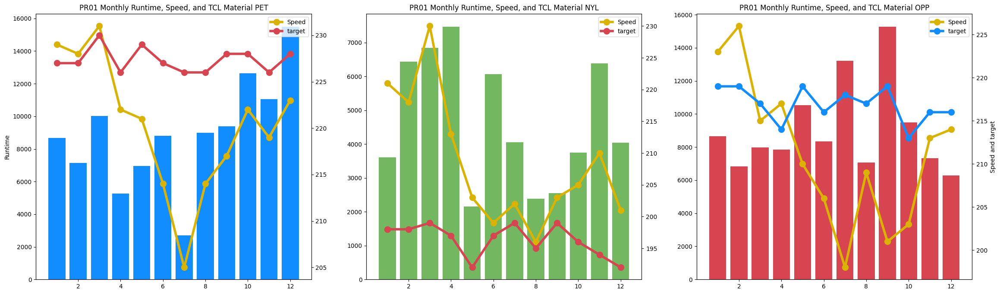

In [ ]:
# plotting RunTime, target, and Speed per material
f, axarr = plt.subplots(nrows=1,ncols=3,figsize=(28, 8))

# plot material PET
plt.sca(axarr[0]);
plt.bar(month_pet['Bulan'],month_pet['RunTime'], color='#118dff')
plt.ylabel('Runtime')

ax2 = axarr[0].twinx()
line1, = ax2.plot(month_pet['Bulan'],month_pet['Speed'],color= "#d9b300",linewidth=4, marker='o', markersize=10, label='Speed')
line2, = ax2.plot(month_pet['Bulan'],month_pet['target'],color= "#d64550",linewidth=4, marker='o', markersize=10, label='target')
ax2.legend()
plt.title('PR01 Monthly Runtime, Speed, and TCL Material PET')

# plot material NYL
plt.sca(axarr[1]);
plt.bar(month_nyl['Bulan'],month_nyl['RunTime'],color='#73b761')

ax2 = axarr[1].twinx()
line1, = ax2.plot(month_nyl['Bulan'],month_nyl['Speed'],color= "#d9b300",linewidth=4, marker='o', markersize=10, label='Speed')
line2, = ax2.plot(month_nyl['Bulan'],month_nyl['target'],color= "#d64550",linewidth=4, marker='o', markersize=10, label='target')
ax2.legend()

plt.title('PR01 Monthly Runtime, Speed, and TCL Material NYL')

# plot material OPP
plt.sca(axarr[2]);
plt.bar(month_opp['Bulan'],month_opp['RunTime'],color='#d64550')

ax2 = axarr[2].twinx()
line1, = ax2.plot(month_opp['Bulan'],month_opp['Speed'],color= "#d9b300",linewidth=4, marker='o', markersize=10, label='Speed')
line2, = ax2.plot(month_opp['Bulan'],month_opp['target'],color= "#118dff",linewidth=4, marker='o', markersize=10, label='target')
ax2.set_ylabel('Speed and target')
ax2.legend()

plt.title('PR01 Monthly Runtime, Speed, and TCL Material OPP')

plt.show()

### **Monthly for PR02**

In [ ]:
# data material PET PR02
month_pet = run[(run['FILM']=='PET')&(run['KdMesin']=='PR02')].pivot_table(values=['Speed','target'],index='Bulan').reset_index()
month_pet['Speed'] = np.ceil(month_pet['Speed']).astype(int)
month_pet['target'] = np.ceil(month_pet['target']).astype(int)
month_pet['RunTime'] = run[(run['FILM']=='PET')&(run['KdMesin']=='PR02')].pivot_table(values='RunTime',index='Bulan',aggfunc='sum').reset_index().drop(columns=['Bulan'])

# data material NYL PR02
month_nyl = run[(run['FILM']=='NYL')&(run['KdMesin']=='PR02')].pivot_table(values=['Speed','target'],index='Bulan').reset_index()
month_nyl['Speed'] = np.ceil(month_nyl['Speed']).astype(int) #round-up to whole number
month_nyl['target'] = np.ceil(month_nyl['target']).astype(int)
month_nyl['RunTime'] = run[(run['FILM']=='NYL')&(run['KdMesin']=='PR02')].pivot_table(values='RunTime',index='Bulan',aggfunc='sum').reset_index().drop(columns=['Bulan'])

# material OPP PR02
month_opp = run[(run['FILM']=='OPP')&(run['KdMesin']=='PR02')].pivot_table(values=['Speed','target'],index='Bulan').reset_index()
month_opp['Speed'] = np.ceil(month_opp['Speed']).astype(int)
month_opp['target'] = np.ceil(month_opp['target']).astype(int)
month_opp['RunTime'] = run[(run['FILM']=='OPP')&(run['KdMesin']=='PR02')].pivot_table(values='RunTime',index='Bulan',aggfunc='sum').reset_index().drop(columns=['Bulan'])

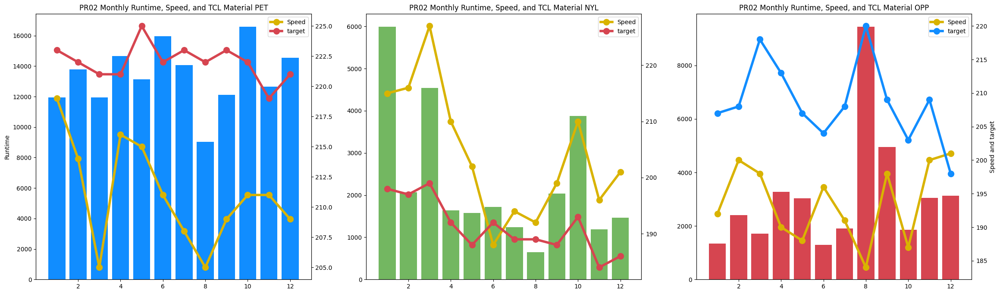

In [ ]:
# plotting RunTime, target, and Speed per material
f, axarr = plt.subplots(nrows=1,ncols=3,figsize=(28, 8))

# plot material PET
plt.sca(axarr[0]);
plt.bar(month_pet['Bulan'],month_pet['RunTime'], color='#118dff')
plt.ylabel('Runtime')

ax2 = axarr[0].twinx()
line1, = ax2.plot(month_pet['Bulan'],month_pet['Speed'],color= "#d9b300",linewidth=4, marker='o', markersize=10, label='Speed')
line2, = ax2.plot(month_pet['Bulan'],month_pet['target'],color= "#d64550",linewidth=4, marker='o', markersize=10, label='target')
ax2.legend()
plt.title('PR02 Monthly Runtime, Speed, and TCL Material PET')

# plot material NYL
plt.sca(axarr[1]);
plt.bar(month_nyl['Bulan'],month_nyl['RunTime'],color='#73b761')

ax2 = axarr[1].twinx()
line1, = ax2.plot(month_nyl['Bulan'],month_nyl['Speed'],color= "#d9b300",linewidth=4, marker='o', markersize=10, label='Speed')
line2, = ax2.plot(month_nyl['Bulan'],month_nyl['target'],color= "#d64550",linewidth=4, marker='o', markersize=10, label='target')
ax2.legend()

plt.title('PR02 Monthly Runtime, Speed, and TCL Material NYL')

# plot material OPP
plt.sca(axarr[2]);
plt.bar(month_opp['Bulan'],month_opp['RunTime'],color='#d64550')

ax2 = axarr[2].twinx()
line1, = ax2.plot(month_opp['Bulan'],month_opp['Speed'],color= "#d9b300",linewidth=4, marker='o', markersize=10, label='Speed')
line2, = ax2.plot(month_opp['Bulan'],month_opp['target'],color= "#118dff",linewidth=4, marker='o', markersize=10, label='target')
ax2.set_ylabel('Speed and target')
ax2.legend()

plt.title('PR02 Monthly Runtime, Speed, and TCL Material OPP')

plt.show()

### **Monthly for PR03**

In [ ]:
# data material PET PR03
month_pet = run[(run['FILM']=='PET')&(run['KdMesin']=='PR03')].pivot_table(values=['Speed','target'],index='Bulan').reset_index()
month_pet['Speed'] = np.ceil(month_pet['Speed']).astype(int)
month_pet['target'] = np.ceil(month_pet['target']).astype(int)
month_pet['RunTime'] = run[(run['FILM']=='PET')&(run['KdMesin']=='PR03')].pivot_table(values='RunTime',index='Bulan',aggfunc='sum').reset_index().drop(columns=['Bulan'])

# data material NYL PR03
month_nyl = run[(run['FILM']=='NYL')&(run['KdMesin']=='PR03')].pivot_table(values=['Speed','target'],index='Bulan').reset_index()
month_nyl['Speed'] = np.ceil(month_nyl['Speed']).astype(int) #round-up to whole number
month_nyl['target'] = np.ceil(month_nyl['target']).astype(int)
month_nyl['RunTime'] = run[(run['FILM']=='NYL')&(run['KdMesin']=='PR03')].pivot_table(values='RunTime',index='Bulan',aggfunc='sum').reset_index().drop(columns=['Bulan'])

# material OPP PR03
month_opp = run[(run['FILM']=='OPP')&(run['KdMesin']=='PR03')].pivot_table(values=['Speed','target'],index='Bulan').reset_index()
month_opp['Speed'] = np.ceil(month_opp['Speed']).astype(int)
month_opp['target'] = np.ceil(month_opp['target']).astype(int)
month_opp['RunTime'] = run[(run['FILM']=='OPP')&(run['KdMesin']=='PR03')].pivot_table(values='RunTime',index='Bulan',aggfunc='sum').reset_index().drop(columns=['Bulan'])

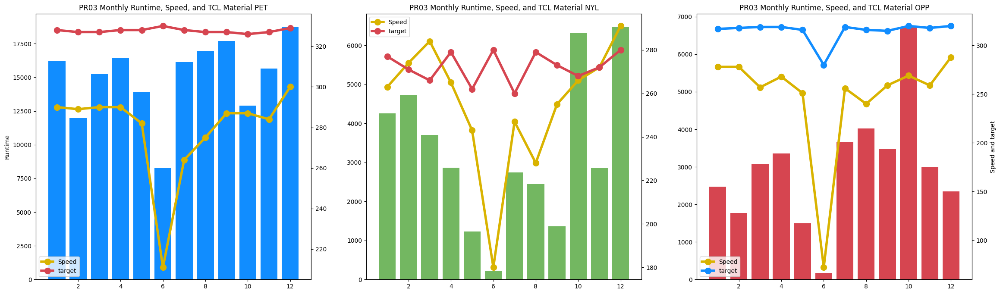

In [ ]:
# plotting RunTime, target, and Speed per material
f, axarr = plt.subplots(nrows=1,ncols=3,figsize=(28, 8))

# plot material PET
plt.sca(axarr[0]);
plt.bar(month_pet['Bulan'],month_pet['RunTime'], color='#118dff')
plt.ylabel('Runtime')

ax2 = axarr[0].twinx()
line1, = ax2.plot(month_pet['Bulan'],month_pet['Speed'],color= "#d9b300",linewidth=4, marker='o', markersize=10, label='Speed')
line2, = ax2.plot(month_pet['Bulan'],month_pet['target'],color= "#d64550",linewidth=4, marker='o', markersize=10, label='target')
ax2.legend()
plt.title('PR03 Monthly Runtime, Speed, and TCL Material PET')

# plot material NYL
plt.sca(axarr[1]);
plt.bar(month_nyl['Bulan'],month_nyl['RunTime'],color='#73b761')

ax2 = axarr[1].twinx()
line1, = ax2.plot(month_nyl['Bulan'],month_nyl['Speed'],color= "#d9b300",linewidth=4, marker='o', markersize=10, label='Speed')
line2, = ax2.plot(month_nyl['Bulan'],month_nyl['target'],color= "#d64550",linewidth=4, marker='o', markersize=10, label='target')
ax2.legend()

plt.title('PR03 Monthly Runtime, Speed, and TCL Material NYL')

# plot material OPP
plt.sca(axarr[2]);
plt.bar(month_opp['Bulan'],month_opp['RunTime'],color='#d64550')

ax2 = axarr[2].twinx()
line1, = ax2.plot(month_opp['Bulan'],month_opp['Speed'],color= "#d9b300",linewidth=4, marker='o', markersize=10, label='Speed')
line2, = ax2.plot(month_opp['Bulan'],month_opp['target'],color= "#118dff",linewidth=4, marker='o', markersize=10, label='target')
ax2.set_ylabel('Speed and target')
ax2.legend()

plt.title('PR03 Monthly Runtime, Speed, and TCL Material OPP')

plt.show()

### **Monthly for PR05**

In [ ]:
# data material PET PR05
month_pet = run[(run['FILM']=='PET')&(run['KdMesin']=='PR05')].pivot_table(values=['Speed','target'],index='Bulan').reset_index()
month_pet['Speed'] = np.ceil(month_pet['Speed']).astype(int)
month_pet['target'] = np.ceil(month_pet['target']).astype(int)
month_pet['RunTime'] = run[(run['FILM']=='PET')&(run['KdMesin']=='PR05')].pivot_table(values='RunTime',index='Bulan',aggfunc='sum').reset_index().drop(columns=['Bulan'])

# data material NYL PR05
month_nyl = run[(run['FILM']=='NYL')&(run['KdMesin']=='PR05')].pivot_table(values=['Speed','target'],index='Bulan').reset_index()
month_nyl['Speed'] = np.ceil(month_nyl['Speed']).astype(int) #round-up to whole number
month_nyl['target'] = np.ceil(month_nyl['target']).astype(int)
month_nyl['RunTime'] = run[(run['FILM']=='NYL')&(run['KdMesin']=='PR05')].pivot_table(values='RunTime',index='Bulan',aggfunc='sum').reset_index().drop(columns=['Bulan'])

# material OPP PR05
month_opp = run[(run['FILM']=='OPP')&(run['KdMesin']=='PR05')].pivot_table(values=['Speed','target'],index='Bulan').reset_index()
month_opp['Speed'] = np.ceil(month_opp['Speed']).astype(int)
month_opp['target'] = np.ceil(month_opp['target']).astype(int)
month_opp['RunTime'] = run[(run['FILM']=='OPP')&(run['KdMesin']=='PR05')].pivot_table(values='RunTime',index='Bulan',aggfunc='sum').reset_index().drop(columns=['Bulan'])

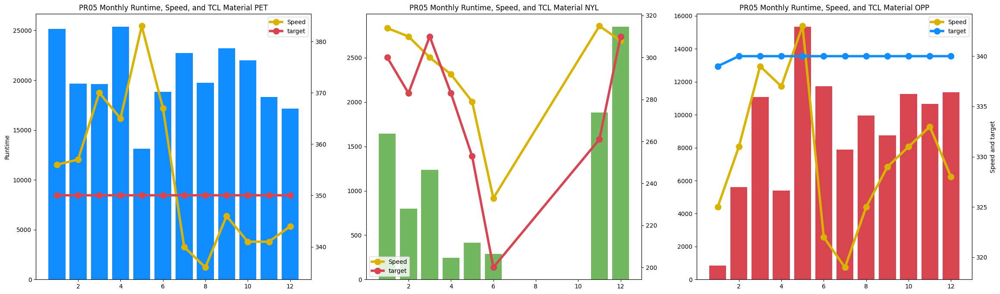

In [ ]:
# plotting RunTime, target, and Speed per material
f, axarr = plt.subplots(nrows=1,ncols=3,figsize=(28, 8))

# plot material PET
plt.sca(axarr[0]);
plt.bar(month_pet['Bulan'],month_pet['RunTime'], color='#118dff')
plt.ylabel('Runtime')

ax2 = axarr[0].twinx()
line1, = ax2.plot(month_pet['Bulan'],month_pet['Speed'],color= "#d9b300",linewidth=4, marker='o', markersize=10, label='Speed')
line2, = ax2.plot(month_pet['Bulan'],month_pet['target'],color= "#d64550",linewidth=4, marker='o', markersize=10, label='target')
ax2.legend()
plt.title('PR05 Monthly Runtime, Speed, and TCL Material PET')

# plot material NYL
plt.sca(axarr[1]);
plt.bar(month_nyl['Bulan'],month_nyl['RunTime'],color='#73b761')

ax2 = axarr[1].twinx()
line1, = ax2.plot(month_nyl['Bulan'],month_nyl['Speed'],color= "#d9b300",linewidth=4, marker='o', markersize=10, label='Speed')
line2, = ax2.plot(month_nyl['Bulan'],month_nyl['target'],color= "#d64550",linewidth=4, marker='o', markersize=10, label='target')
ax2.legend()

plt.title('PR05 Monthly Runtime, Speed, and TCL Material NYL')

# plot material OPP
plt.sca(axarr[2]);
plt.bar(month_opp['Bulan'],month_opp['RunTime'],color='#d64550')

ax2 = axarr[2].twinx()
line1, = ax2.plot(month_opp['Bulan'],month_opp['Speed'],color= "#d9b300",linewidth=4, marker='o', markersize=10, label='Speed')
line2, = ax2.plot(month_opp['Bulan'],month_opp['target'],color= "#118dff",linewidth=4, marker='o', markersize=10, label='target')
ax2.set_ylabel('Speed and target')
ax2.legend()

plt.title('PR05 Monthly Runtime, Speed, and TCL Material OPP')

plt.show()

### **Monthly for PR06**

In [ ]:
# data material PET PR06
month_pet = run[(run['FILM']=='PET')&(run['KdMesin']=='PR06')].pivot_table(values=['Speed','target'],index='Bulan').reset_index()
month_pet['Speed'] = np.ceil(month_pet['Speed']).astype(int)
month_pet['target'] = np.ceil(month_pet['target']).astype(int)
month_pet['RunTime'] = run[(run['FILM']=='PET')&(run['KdMesin']=='PR06')].pivot_table(values='RunTime',index='Bulan',aggfunc='sum').reset_index().drop(columns=['Bulan'])

# data material NYL PR06
month_nyl = run[(run['FILM']=='NYL')&(run['KdMesin']=='PR06')].pivot_table(values=['Speed','target'],index='Bulan').reset_index()
month_nyl['Speed'] = np.ceil(month_nyl['Speed']).astype(int) #round-up to whole number
month_nyl['target'] = np.ceil(month_nyl['target']).astype(int)
month_nyl['RunTime'] = run[(run['FILM']=='NYL')&(run['KdMesin']=='PR06')].pivot_table(values='RunTime',index='Bulan',aggfunc='sum').reset_index().drop(columns=['Bulan'])

# material OPP PR06
month_opp = run[(run['FILM']=='OPP')&(run['KdMesin']=='PR06')].pivot_table(values=['Speed','target'],index='Bulan').reset_index()
month_opp['Speed'] = np.ceil(month_opp['Speed']).astype(int)
month_opp['target'] = np.ceil(month_opp['target']).astype(int)
month_opp['RunTime'] = run[(run['FILM']=='OPP')&(run['KdMesin']=='PR06')].pivot_table(values='RunTime',index='Bulan',aggfunc='sum').reset_index().drop(columns=['Bulan'])

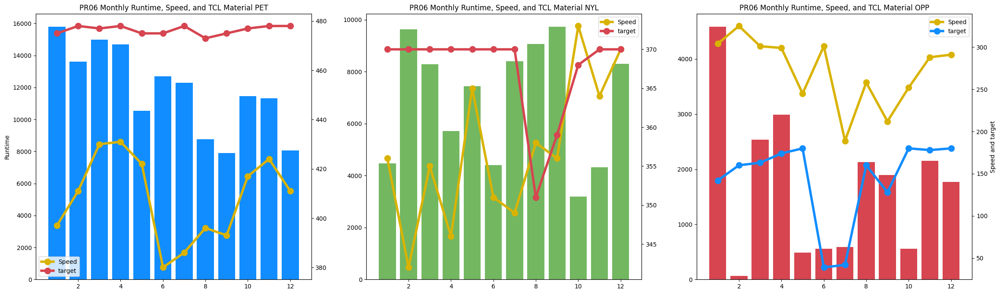

In [ ]:
# plotting RunTime, target, and Speed per material
f, axarr = plt.subplots(nrows=1,ncols=3,figsize=(28, 8))

# plot material PET
plt.sca(axarr[0]);
plt.bar(month_pet['Bulan'],month_pet['RunTime'], color='#118dff')
plt.ylabel('Runtime')

ax2 = axarr[0].twinx()
line1, = ax2.plot(month_pet['Bulan'],month_pet['Speed'],color= "#d9b300",linewidth=4, marker='o', markersize=10, label='Speed')
line2, = ax2.plot(month_pet['Bulan'],month_pet['target'],color= "#d64550",linewidth=4, marker='o', markersize=10, label='target')
ax2.legend()
plt.title('PR06 Monthly Runtime, Speed, and TCL Material PET')

# plot material NYL
plt.sca(axarr[1]);
plt.bar(month_nyl['Bulan'],month_nyl['RunTime'],color='#73b761')

ax2 = axarr[1].twinx()
line1, = ax2.plot(month_nyl['Bulan'],month_nyl['Speed'],color= "#d9b300",linewidth=4, marker='o', markersize=10, label='Speed')
line2, = ax2.plot(month_nyl['Bulan'],month_nyl['target'],color= "#d64550",linewidth=4, marker='o', markersize=10, label='target')
ax2.legend()

plt.title('PR06 Monthly Runtime, Speed, and TCL Material NYL')

# plot material OPP
plt.sca(axarr[2]);
plt.bar(month_opp['Bulan'],month_opp['RunTime'],color='#d64550')

ax2 = axarr[2].twinx()
line1, = ax2.plot(month_opp['Bulan'],month_opp['Speed'],color= "#d9b300",linewidth=4, marker='o', markersize=10, label='Speed')
line2, = ax2.plot(month_opp['Bulan'],month_opp['target'],color= "#118dff",linewidth=4, marker='o', markersize=10, label='target')
ax2.set_ylabel('Speed and target')
ax2.legend()

plt.title('PR06 Monthly Runtime, Speed, and TCL Material OPP')

plt.show()

### **Monthly for PR07**

In [ ]:
# data material PET PR07
month_pet = run[(run['FILM']=='PET')&(run['KdMesin']=='PR07')].pivot_table(values=['Speed','target'],index='Bulan').reset_index()
month_pet['Speed'] = np.ceil(month_pet['Speed']).astype(int)
month_pet['target'] = np.ceil(month_pet['target']).astype(int)
month_pet['RunTime'] = run[(run['FILM']=='PET')&(run['KdMesin']=='PR07')].pivot_table(values='RunTime',index='Bulan',aggfunc='sum').reset_index().drop(columns=['Bulan'])

# data material NYL PR07
month_nyl = run[(run['FILM']=='NYL')&(run['KdMesin']=='PR07')].pivot_table(values=['Speed','target'],index='Bulan').reset_index()
month_nyl['Speed'] = np.ceil(month_nyl['Speed']).astype(int) #round-up to whole number
month_nyl['target'] = np.ceil(month_nyl['target']).astype(int)
month_nyl['RunTime'] = run[(run['FILM']=='NYL')&(run['KdMesin']=='PR07')].pivot_table(values='RunTime',index='Bulan',aggfunc='sum').reset_index().drop(columns=['Bulan'])

# material OPP PR07
month_opp = run[(run['FILM']=='OPP')&(run['KdMesin']=='PR07')].pivot_table(values=['Speed','target'],index='Bulan').reset_index()
month_opp['Speed'] = np.ceil(month_opp['Speed']).astype(int)
month_opp['target'] = np.ceil(month_opp['target']).astype(int)
month_opp['RunTime'] = run[(run['FILM']=='OPP')&(run['KdMesin']=='PR07')].pivot_table(values='RunTime',index='Bulan',aggfunc='sum').reset_index().drop(columns=['Bulan'])

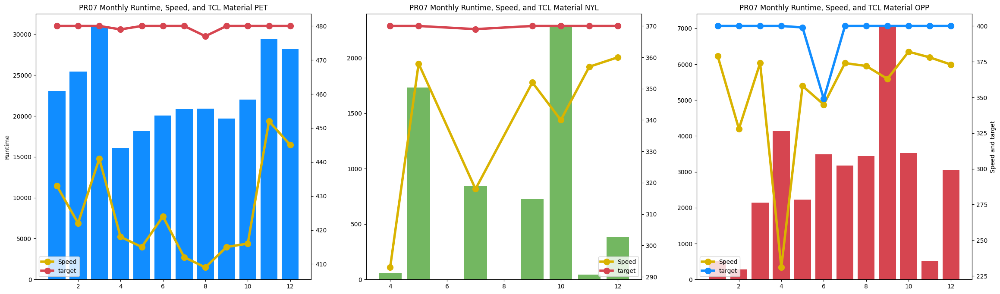

In [ ]:
# plotting RunTime, target, and Speed per material
f, axarr = plt.subplots(nrows=1,ncols=3,figsize=(28, 8))

# plot material PET
plt.sca(axarr[0]);
plt.bar(month_pet['Bulan'],month_pet['RunTime'], color='#118dff')
plt.ylabel('Runtime')

ax2 = axarr[0].twinx()
line1, = ax2.plot(month_pet['Bulan'],month_pet['Speed'],color= "#d9b300",linewidth=4, marker='o', markersize=10, label='Speed')
line2, = ax2.plot(month_pet['Bulan'],month_pet['target'],color= "#d64550",linewidth=4, marker='o', markersize=10, label='target')
ax2.legend()
plt.title('PR07 Monthly Runtime, Speed, and TCL Material PET')

# plot material NYL
plt.sca(axarr[1]);
plt.bar(month_nyl['Bulan'],month_nyl['RunTime'],color='#73b761')

ax2 = axarr[1].twinx()
line1, = ax2.plot(month_nyl['Bulan'],month_nyl['Speed'],color= "#d9b300",linewidth=4, marker='o', markersize=10, label='Speed')
line2, = ax2.plot(month_nyl['Bulan'],month_nyl['target'],color= "#d64550",linewidth=4, marker='o', markersize=10, label='target')
ax2.legend()

plt.title('PR07 Monthly Runtime, Speed, and TCL Material NYL')

# plot material OPP
plt.sca(axarr[2]);
plt.bar(month_opp['Bulan'],month_opp['RunTime'],color='#d64550')

ax2 = axarr[2].twinx()
line1, = ax2.plot(month_opp['Bulan'],month_opp['Speed'],color= "#d9b300",linewidth=4, marker='o', markersize=10, label='Speed')
line2, = ax2.plot(month_opp['Bulan'],month_opp['target'],color= "#118dff",linewidth=4, marker='o', markersize=10, label='target')
ax2.set_ylabel('Speed and target')
ax2.legend()

plt.title('PR07 Monthly Runtime, Speed, and TCL Material OPP')

plt.show()

### **Line Plot**

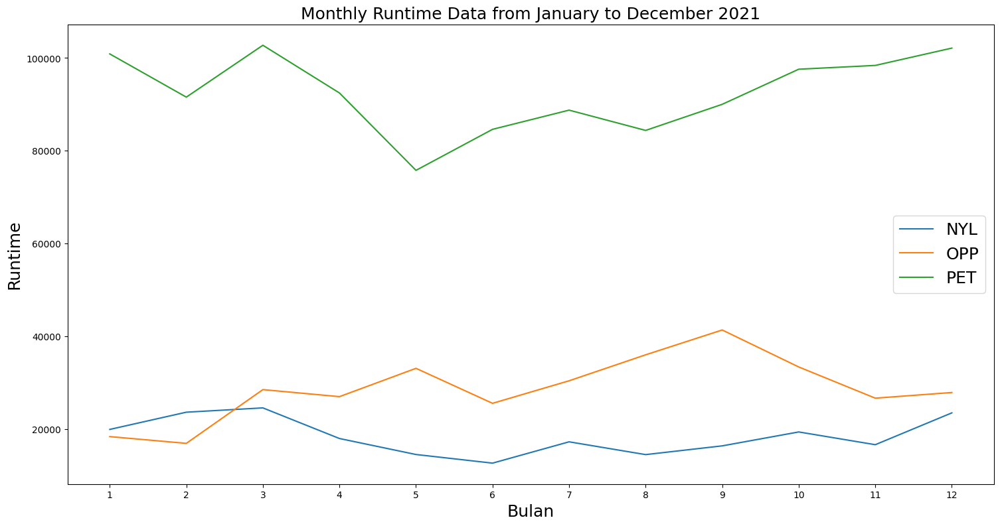

In [ ]:
# plotting daily runtime per material
run_monthly.plot('Bulan',['NYL','OPP','PET'],figsize=(18 , 9)).legend(loc='best', fontsize=18)
plt.xlabel('Bulan', fontsize=18)
plt.ylabel('Runtime', fontsize=18)
plt.title('Monthly Runtime Data from January to December 2021', fontsize=18)
plt.xticks(run_monthly['Bulan'])
plt.show()

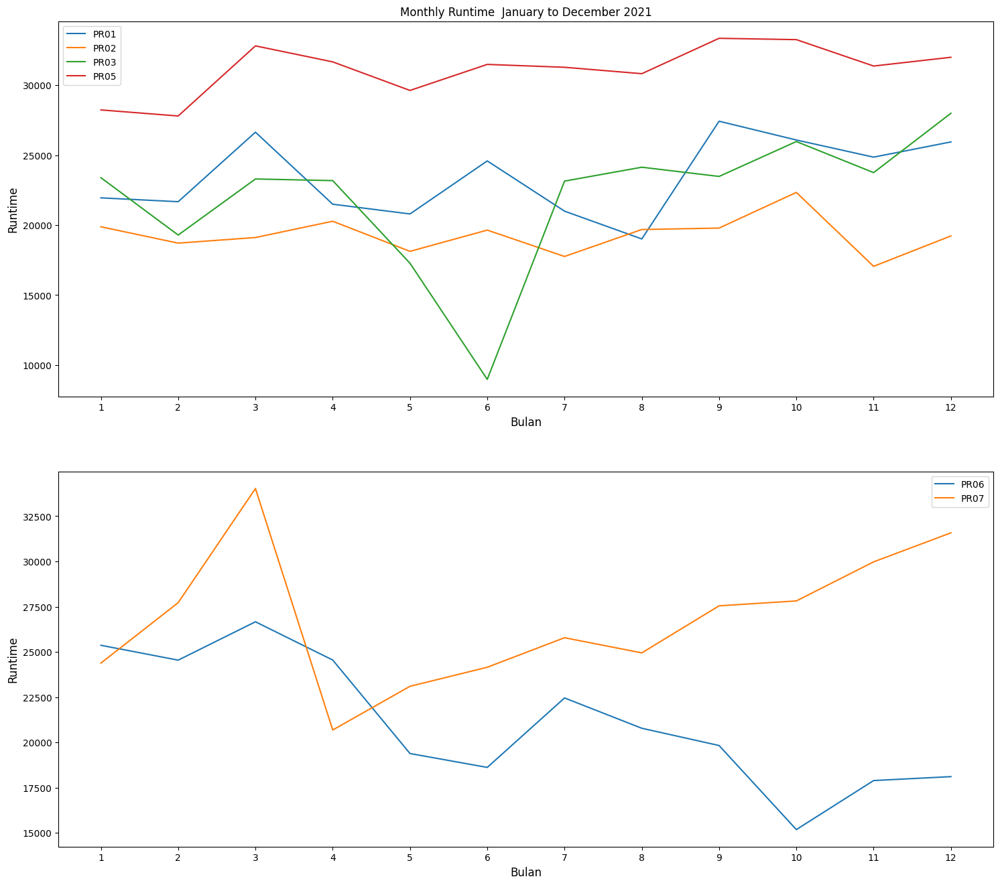

In [ ]:
# plotting daily runtime by machine
f, ax = plt.subplots(nrows=2,ncols=1,figsize=(18, 16))
line1, = ax[0].plot(rmc_monthly['Bulan'],rmc_monthly['PR01'],label='PR01')
line2, = ax[0].plot(rmc_monthly['Bulan'],rmc_monthly['PR02'],label='PR02')
line3, = ax[0].plot(rmc_monthly['Bulan'],rmc_monthly['PR03'],label='PR03')
line5, = ax[0].plot(rmc_monthly['Bulan'],rmc_monthly['PR05'],label='PR05')
ax[0].legend()
ax[0].set_xlabel('Bulan', fontsize=12)
ax[0].set_ylabel('Runtime', fontsize=12)
ax[0].set_title('Monthly Runtime  January to December 2021', fontsize=12)
ax[0].set_xticks(rmc_monthly['Bulan'])

line1, = ax[1].plot(rmc_monthly['Bulan'],rmc_monthly['PR06'],label='PR06')
line2, = ax[1].plot(rmc_monthly['Bulan'],rmc_monthly['PR07'],label='PR07')
ax[1].legend()
ax[1].set_xlabel('Bulan', fontsize=12)
ax[1].set_ylabel('Runtime', fontsize=12)
ax[1].set_xticks(rmc_monthly['Bulan'])

plt.xticks(run_monthly['Bulan'])
plt.show()

## **3. Output by Material**

In [ ]:
op_films = op.pivot_table(values='Output',index=['KdMesin'],columns='FILM',aggfunc='sum').reset_index().rename_axis(None, axis=1)
op_films

,KdMesin,NYL,OPP,PET
0,PR01,11704891,22761432,23650404
1,PR02,5847204,7166236,33817265
2,PR03,10473558,9322436,50690800
3,PR05,2854057,36327346,86311408
4,PR06,29496510,5686715,58013533
5,PR07,2089210,11726848,117228383


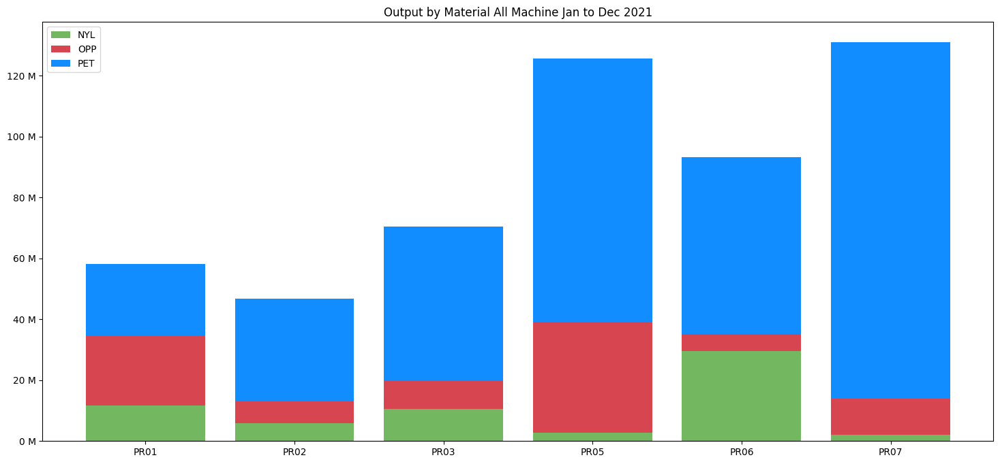

In [ ]:
# function for y-axis format in millions
@ticker.FuncFormatter
def million_formatter(x, pos):
    return "%.0f M" % (x/1E6)
    
# plotting output per film per machine
fig, ax = plt.subplots(figsize=(18, 8))
ax.bar(op_films['KdMesin'], op_films['NYL'], label='NYL',color='#73b761')
ax.bar(op_films['KdMesin'], op_films['OPP'], bottom=op_films['NYL'],label='OPP',color='#d64550')
ax.bar(op_films['KdMesin'], op_films['PET'], 
       bottom=op_films['NYL']+np.array(op_films['OPP']),
       label='PET',color='#118dff')
ax.set_title('Output by Material All Machine Jan to Dec 2021')
ax.yaxis.set_major_formatter(million_formatter)
ax.legend(loc='upper left')
plt.show()

In [ ]:
# output monthly per film
op_order = op.pivot_table(values='Output',index=['Bulan'],columns='FILM',aggfunc='sum').reset_index().rename_axis(None, axis=1)
op_order

,Bulan,NYL,OPP,PET
0,1,5295750,4728623,34478729
1,2,6673235,4482156,31304835
2,3,6959086,8154028,36470796
3,4,4757298,6883186,31345912
4,5,4499931,9313111,25225076
5,6,3172105,7127125,27189112
6,7,4931477,7728238,28740114
7,8,4384153,9216295,27039649
8,9,4988521,10771505,28927404
9,10,5216090,9283590,31369468


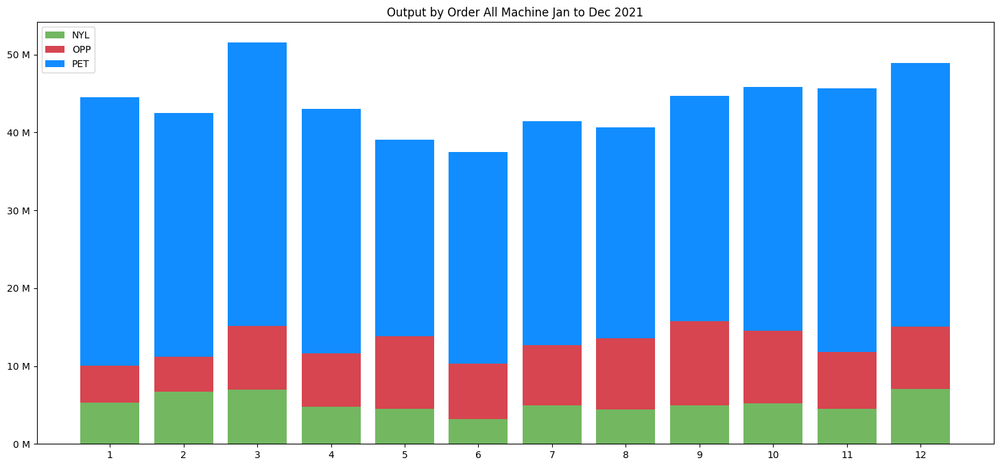

In [ ]:
# plotting output per film per month
fig, ax = plt.subplots(figsize=(18, 8))
ax.bar(op_order['Bulan'], op_order['NYL'], label='NYL',color='#73b761')
ax.bar(op_order['Bulan'], op_order['OPP'], bottom=op_order['NYL'],label='OPP',color='#d64550')
ax.bar(op_order['Bulan'], op_order['PET'], bottom=op_order['NYL']+np.array(op_order['OPP']),
       label='PET',color='#118dff')
ax.set_title('Output by Order All Machine Jan to Dec 2021')
ax.yaxis.set_major_formatter(million_formatter)
ax.legend(loc='upper left')
ax.set_xticks(op_order['Bulan'])
plt.show()

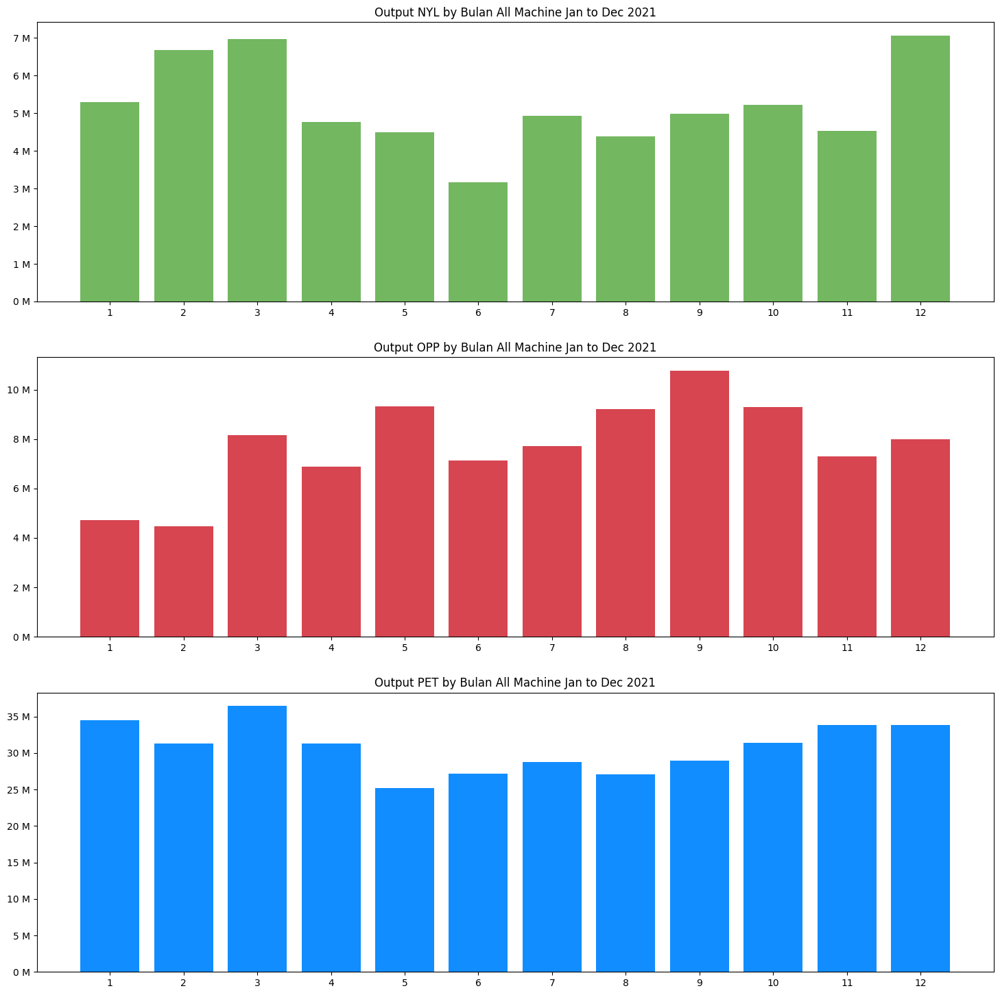

In [ ]:
# plotting output nyl per month
fig, ax = plt.subplots(nrows=3,ncols=1,figsize=(18, 18))
ax[0].bar(op_order['Bulan'], op_order['NYL'], label='NYL',color='#73b761')
ax[0].set_title('Output NYL by Bulan All Machine Jan to Dec 2021')
ax[0].yaxis.set_major_formatter(million_formatter)
ax[0].set_xticks(op_order['Bulan'])

ax[1].bar(op_order['Bulan'], op_order['OPP'], label='OPP',color='#d64550')
ax[1].set_title('Output OPP by Bulan All Machine Jan to Dec 2021')
ax[1].yaxis.set_major_formatter(million_formatter)
ax[1].set_xticks(op_order['Bulan'])

ax[2].bar(op_order['Bulan'], op_order['PET'], label='PET',color='#118dff')
ax[2].set_title('Output PET by Bulan All Machine Jan to Dec 2021')
ax[2].yaxis.set_major_formatter(million_formatter)
ax[2].set_xticks(op_order['Bulan'])

plt.show()

## **4. Monthly Output by Material All Machine**

### **January**

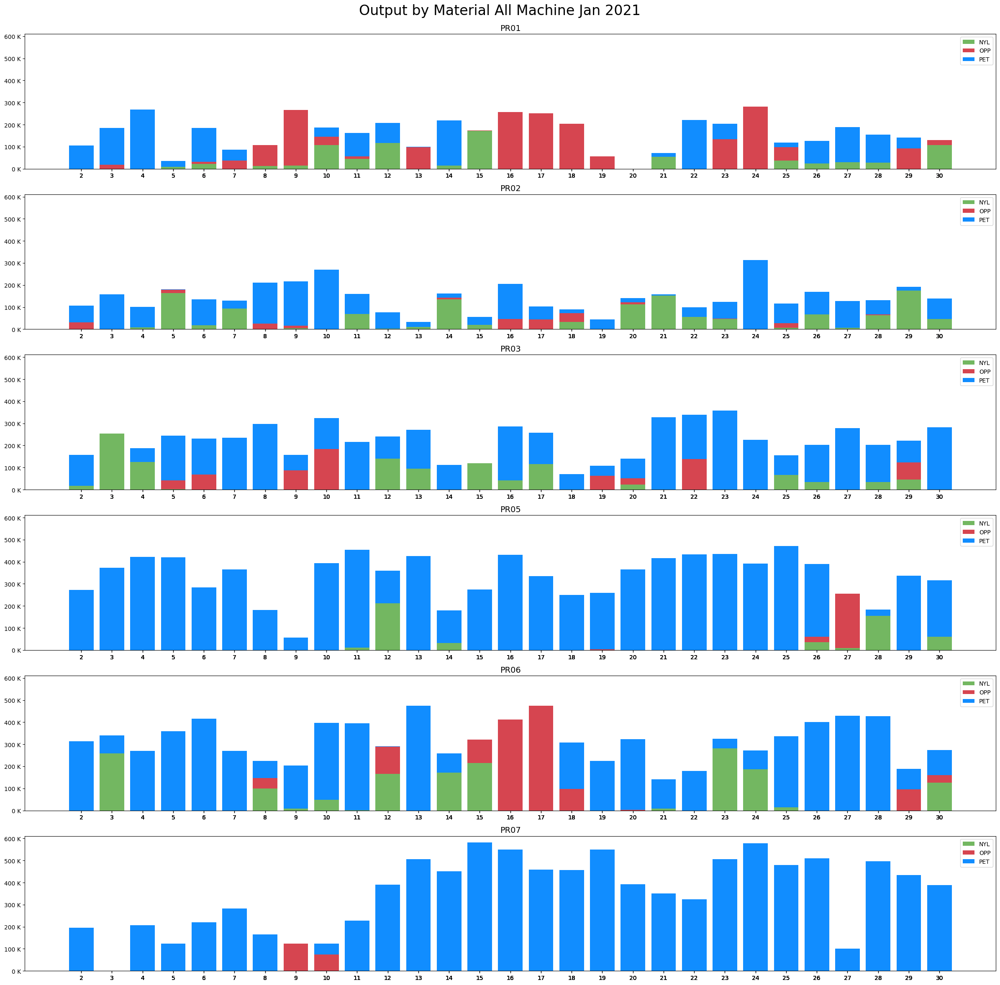

In [ ]:
# function for y-axis format in thousands
@ticker.FuncFormatter
def thousand_formatter(x, pos):
    return "%.0f K" % (x/1E3)

op_month = op[op['Bulan']==1].pivot_table(values='Output',index=['Tgl','KdMesin'],columns='FILM',aggfunc='sum',fill_value=0).reset_index().rename_axis(None, axis=1)
op_month['Tgl'] = op_month['Tgl'].dt.day

fig, ax = plt.subplots(nrows=6,ncols=1,figsize=(24, 24),sharex=True,sharey=True)
list = [1, 2, 3, 5,6,7]
length = len(list)
for i in range(length):
  ax[i].bar(op_month[op_month['KdMesin']=='PR0'+str(list[i])]['Tgl'], op_month[op_month['KdMesin']=='PR0'+str(list[i])]['NYL'], label='NYL',color='#73b761')
  ax[i].bar(op_month[op_month['KdMesin']=='PR0'+str(list[i])]['Tgl'], op_month[op_month['KdMesin']=='PR0'+str(list[i])]['OPP'], 
          bottom=op_month[op_month['KdMesin']=='PR0'+str(list[i])]['NYL'],label='OPP',color='#d64550')
  ax[i].bar(op_month[op_month['KdMesin']=='PR0'+str(list[i])]['Tgl'], op_month[op_month['KdMesin']=='PR0'+str(list[i])]['PET'], 
          bottom=op_month[op_month['KdMesin']=='PR0'+str(list[i])]['NYL']+np.array(op_month[op_month['KdMesin']=='PR0'+str(list[i])]['OPP']),label='PET',color='#118dff')
  ax[i].yaxis.set_major_formatter(thousand_formatter)
  ax[i].set_xticks(op_month['Tgl'])
  ax[i].legend()
  ax[i].set_title('PR0'+str(list[i]),fontsize=14)
  ax[i].xaxis.set_tick_params(labelbottom=True)

fig.suptitle('Output by Material All Machine Jan 2021',fontsize=24)
# Tight layout often produces nice results
# but requires the title to be spaced accordingly
fig.tight_layout()
fig.subplots_adjust(top=0.95)
plt.show()

### **February**

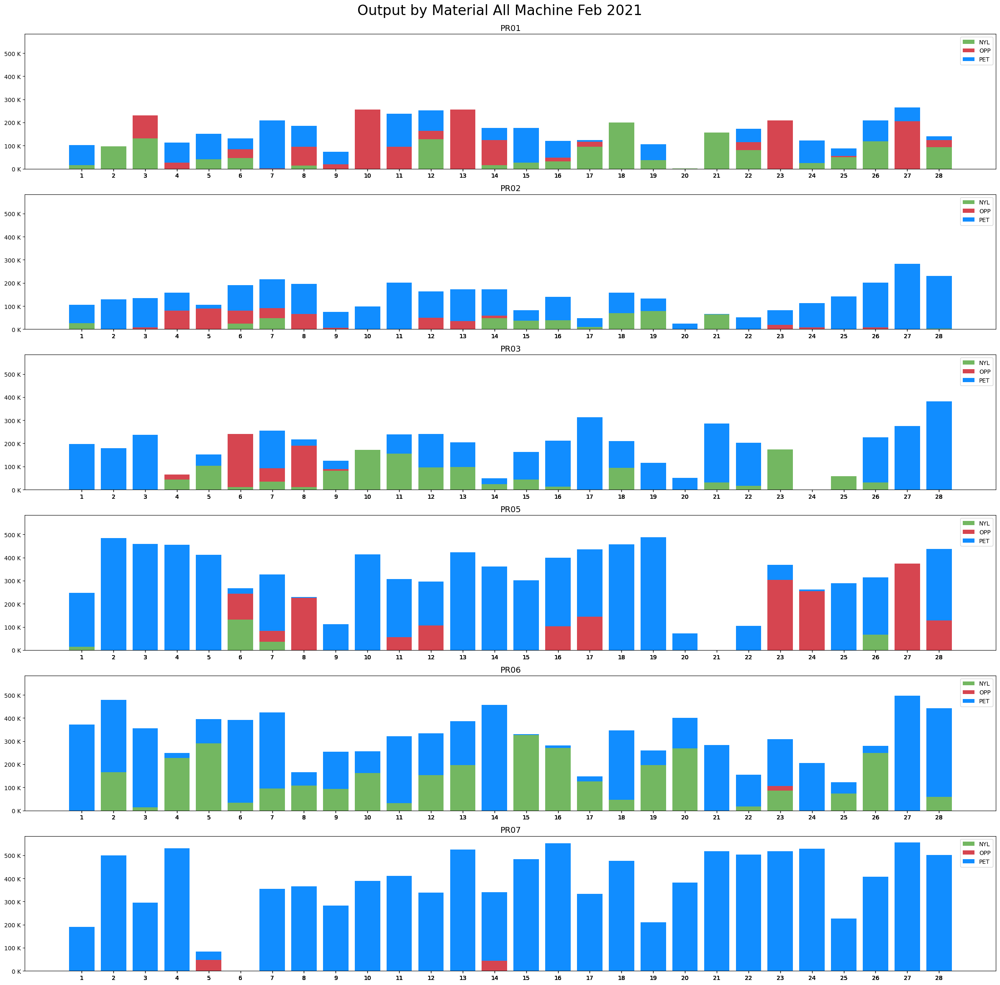

In [ ]:
op_month = op[op['Bulan']==2].pivot_table(values='Output',index=['Tgl','KdMesin'],columns='FILM',aggfunc='sum',fill_value=0).reset_index().rename_axis(None, axis=1)
op_month['Tgl'] = op_month['Tgl'].dt.day

fig, ax = plt.subplots(nrows=6,ncols=1,figsize=(24, 24), sharex=True,sharey=True)
for i in range(length):
  ax[i].bar(op_month[op_month['KdMesin']=='PR0'+str(list[i])]['Tgl'], op_month[op_month['KdMesin']=='PR0'+str(list[i])]['NYL'], label='NYL',color='#73b761')
  ax[i].bar(op_month[op_month['KdMesin']=='PR0'+str(list[i])]['Tgl'], op_month[op_month['KdMesin']=='PR0'+str(list[i])]['OPP'], 
          bottom=op_month[op_month['KdMesin']=='PR0'+str(list[i])]['NYL'],label='OPP',color='#d64550')
  ax[i].bar(op_month[op_month['KdMesin']=='PR0'+str(list[i])]['Tgl'], op_month[op_month['KdMesin']=='PR0'+str(list[i])]['PET'], 
          bottom=op_month[op_month['KdMesin']=='PR0'+str(list[i])]['NYL']+np.array(op_month[op_month['KdMesin']=='PR0'+str(list[i])]['OPP']),label='PET',color='#118dff')
  ax[i].yaxis.set_major_formatter(thousand_formatter)
  ax[i].set_xticks(op_month['Tgl'])
  ax[i].legend()
  ax[i].set_title('PR0'+str(list[i]),fontsize=14)
  ax[i].xaxis.set_tick_params(labelbottom=True)

fig.suptitle('Output by Material All Machine Feb 2021',fontsize=24)
# Tight layout often produces nice results
# but requires the title to be spaced accordingly
fig.tight_layout()
fig.subplots_adjust(top=0.95)
plt.show()

### **March**

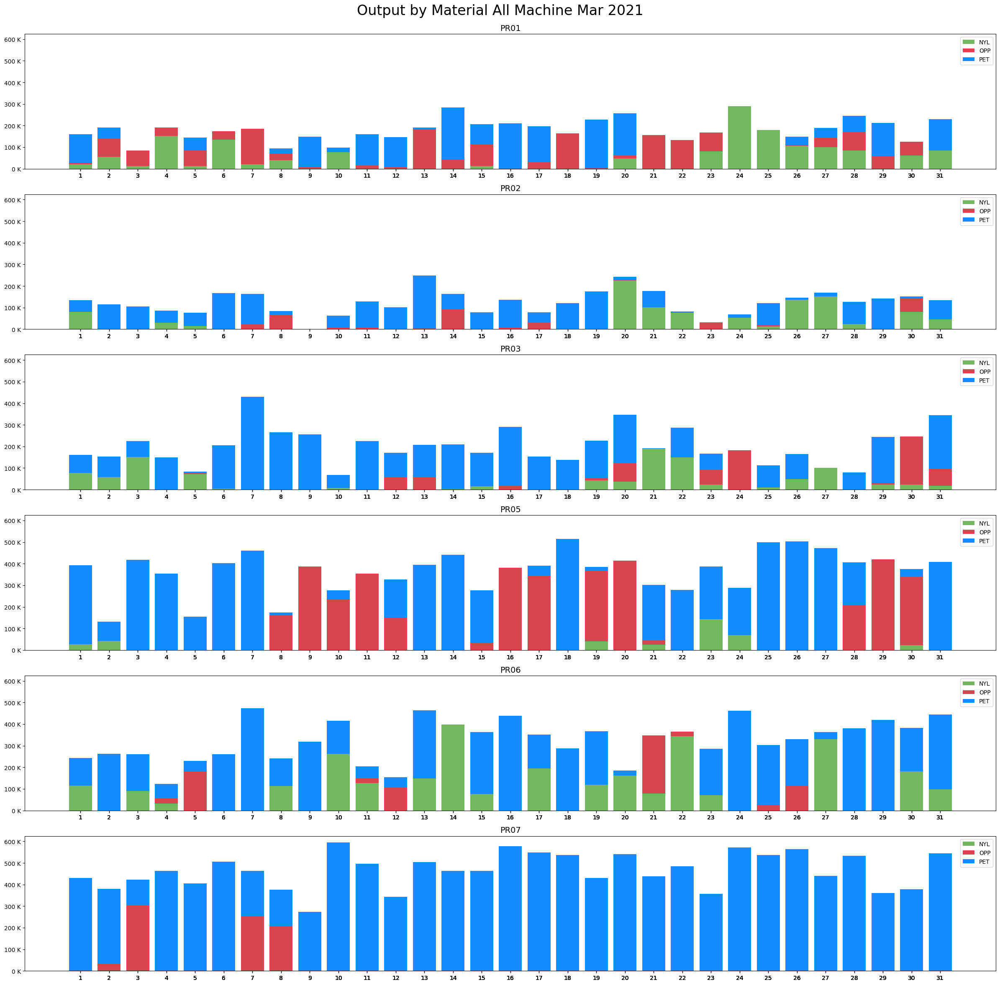

In [ ]:
op_month = op[op['Bulan']==3].pivot_table(values='Output',index=['Tgl','KdMesin'],columns='FILM',aggfunc='sum',fill_value=0).reset_index().rename_axis(None, axis=1)
op_month['Tgl'] = op_month['Tgl'].dt.day

fig, ax = plt.subplots(nrows=6,ncols=1,figsize=(24, 24),sharex=True, sharey=True)
for i in range(length):
  ax[i].bar(op_month[op_month['KdMesin']=='PR0'+str(list[i])]['Tgl'], op_month[op_month['KdMesin']=='PR0'+str(list[i])]['NYL'], label='NYL',color='#73b761')
  ax[i].bar(op_month[op_month['KdMesin']=='PR0'+str(list[i])]['Tgl'], op_month[op_month['KdMesin']=='PR0'+str(list[i])]['OPP'], 
          bottom=op_month[op_month['KdMesin']=='PR0'+str(list[i])]['NYL'],label='OPP',color='#d64550')
  ax[i].bar(op_month[op_month['KdMesin']=='PR0'+str(list[i])]['Tgl'], op_month[op_month['KdMesin']=='PR0'+str(list[i])]['PET'], 
          bottom=op_month[op_month['KdMesin']=='PR0'+str(list[i])]['NYL']+np.array(op_month[op_month['KdMesin']=='PR0'+str(list[i])]['OPP']),label='PET',color='#118dff')
  ax[i].yaxis.set_major_formatter(thousand_formatter)
  ax[i].set_xticks(op_month['Tgl'])
  ax[i].legend()
  ax[i].set_title('PR0'+str(list[i]),fontsize=14)
  ax[i].xaxis.set_tick_params(labelbottom=True)

fig.suptitle('Output by Material All Machine Mar 2021',fontsize=24)
# Tight layout often produces nice results
# but requires the title to be spaced accordingly
fig.tight_layout()
fig.subplots_adjust(top=0.95)
plt.show()

### **April**

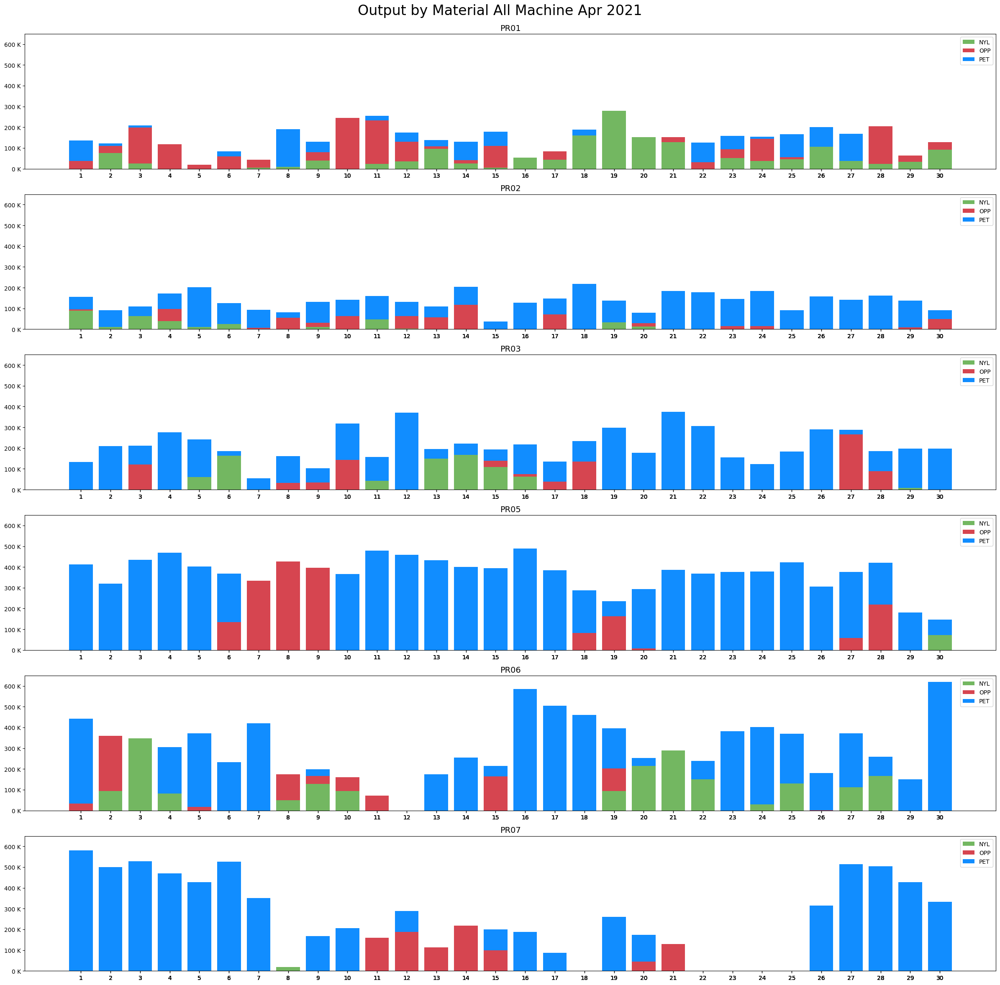

In [ ]:
op_month = op[op['Bulan']==4].pivot_table(values='Output',index=['Tgl','KdMesin'],columns='FILM',aggfunc='sum',fill_value=0).reset_index().rename_axis(None, axis=1)
op_month['Tgl'] = op_month['Tgl'].dt.day

fig, ax = plt.subplots(nrows=6,ncols=1,figsize=(24, 24),sharex=True,sharey=True)
for i in range(length):
  ax[i].bar(op_month[op_month['KdMesin']=='PR0'+str(list[i])]['Tgl'], op_month[op_month['KdMesin']=='PR0'+str(list[i])]['NYL'], label='NYL',color='#73b761')
  ax[i].bar(op_month[op_month['KdMesin']=='PR0'+str(list[i])]['Tgl'], op_month[op_month['KdMesin']=='PR0'+str(list[i])]['OPP'], 
          bottom=op_month[op_month['KdMesin']=='PR0'+str(list[i])]['NYL'],label='OPP',color='#d64550')
  ax[i].bar(op_month[op_month['KdMesin']=='PR0'+str(list[i])]['Tgl'], op_month[op_month['KdMesin']=='PR0'+str(list[i])]['PET'], 
          bottom=op_month[op_month['KdMesin']=='PR0'+str(list[i])]['NYL']+np.array(op_month[op_month['KdMesin']=='PR0'+str(list[i])]['OPP']),label='PET',color='#118dff')
  ax[i].yaxis.set_major_formatter(thousand_formatter)
  ax[i].set_xticks(op_month['Tgl'])
  ax[i].legend()
  ax[i].set_title('PR0'+str(list[i]),fontsize=14)
  ax[i].xaxis.set_tick_params(labelbottom=True)

fig.suptitle('Output by Material All Machine Apr 2021',fontsize=24)
# Tight layout often produces nice results
# but requires the title to be spaced accordingly
fig.tight_layout()
fig.subplots_adjust(top=0.95)
plt.show()

### **May**

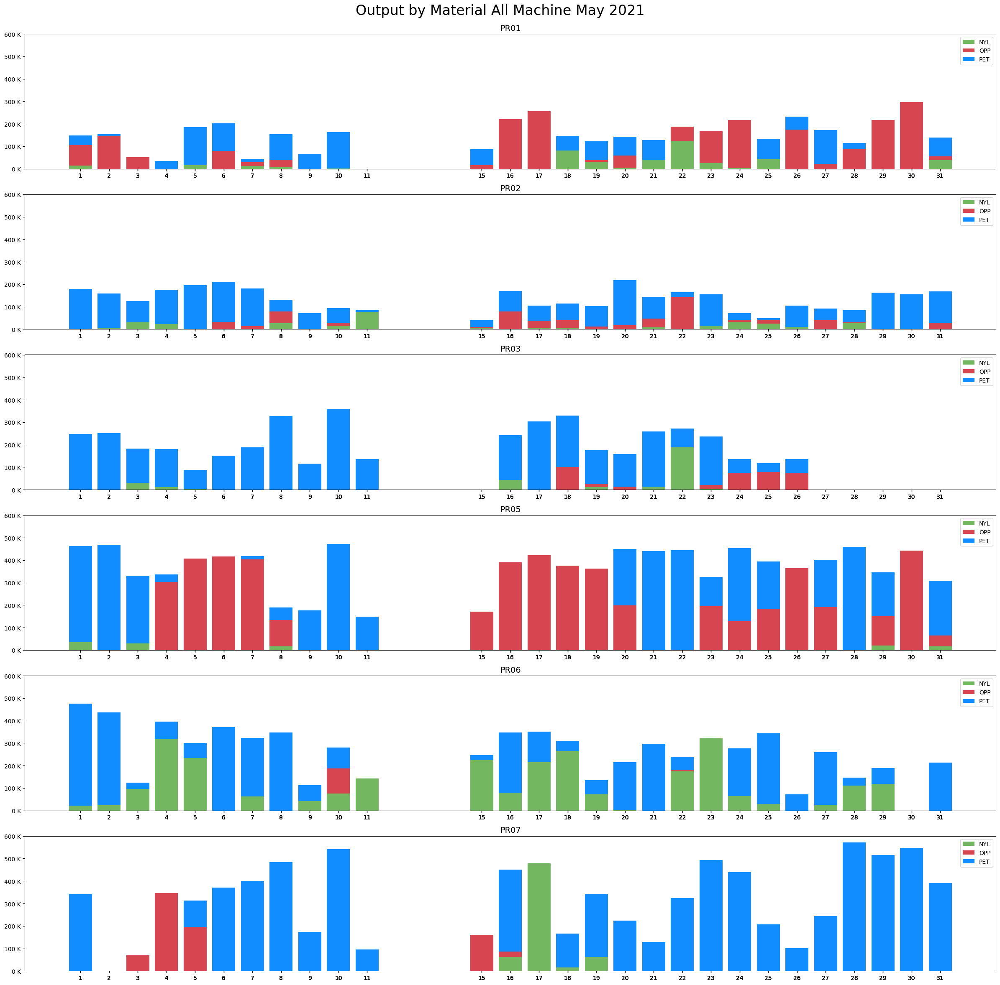

In [ ]:
op_month = op[op['Bulan']==5].pivot_table(values='Output',index=['Tgl','KdMesin'],columns='FILM',aggfunc='sum',fill_value=0).reset_index().rename_axis(None, axis=1)
op_month['Tgl'] = op_month['Tgl'].dt.day

fig, ax = plt.subplots(nrows=6,ncols=1,figsize=(24, 24),sharex=True,sharey=True)
for i in range(length):
  ax[i].bar(op_month[op_month['KdMesin']=='PR0'+str(list[i])]['Tgl'], op_month[op_month['KdMesin']=='PR0'+str(list[i])]['NYL'], label='NYL',color='#73b761')
  ax[i].bar(op_month[op_month['KdMesin']=='PR0'+str(list[i])]['Tgl'], op_month[op_month['KdMesin']=='PR0'+str(list[i])]['OPP'], 
          bottom=op_month[op_month['KdMesin']=='PR0'+str(list[i])]['NYL'],label='OPP',color='#d64550')
  ax[i].bar(op_month[op_month['KdMesin']=='PR0'+str(list[i])]['Tgl'], op_month[op_month['KdMesin']=='PR0'+str(list[i])]['PET'], 
          bottom=op_month[op_month['KdMesin']=='PR0'+str(list[i])]['NYL']+np.array(op_month[op_month['KdMesin']=='PR0'+str(list[i])]['OPP']),label='PET',color='#118dff')
  ax[i].yaxis.set_major_formatter(thousand_formatter)
  ax[i].set_xticks(op_month['Tgl'])
  ax[i].legend()
  ax[i].set_title('PR0'+str(list[i]),fontsize=14)
  ax[i].xaxis.set_tick_params(labelbottom=True)

fig.suptitle('Output by Material All Machine May 2021',fontsize=24)
# Tight layout often produces nice results
# but requires the title to be spaced accordingly
fig.tight_layout()
fig.subplots_adjust(top=0.95)
plt.show()

### **June**

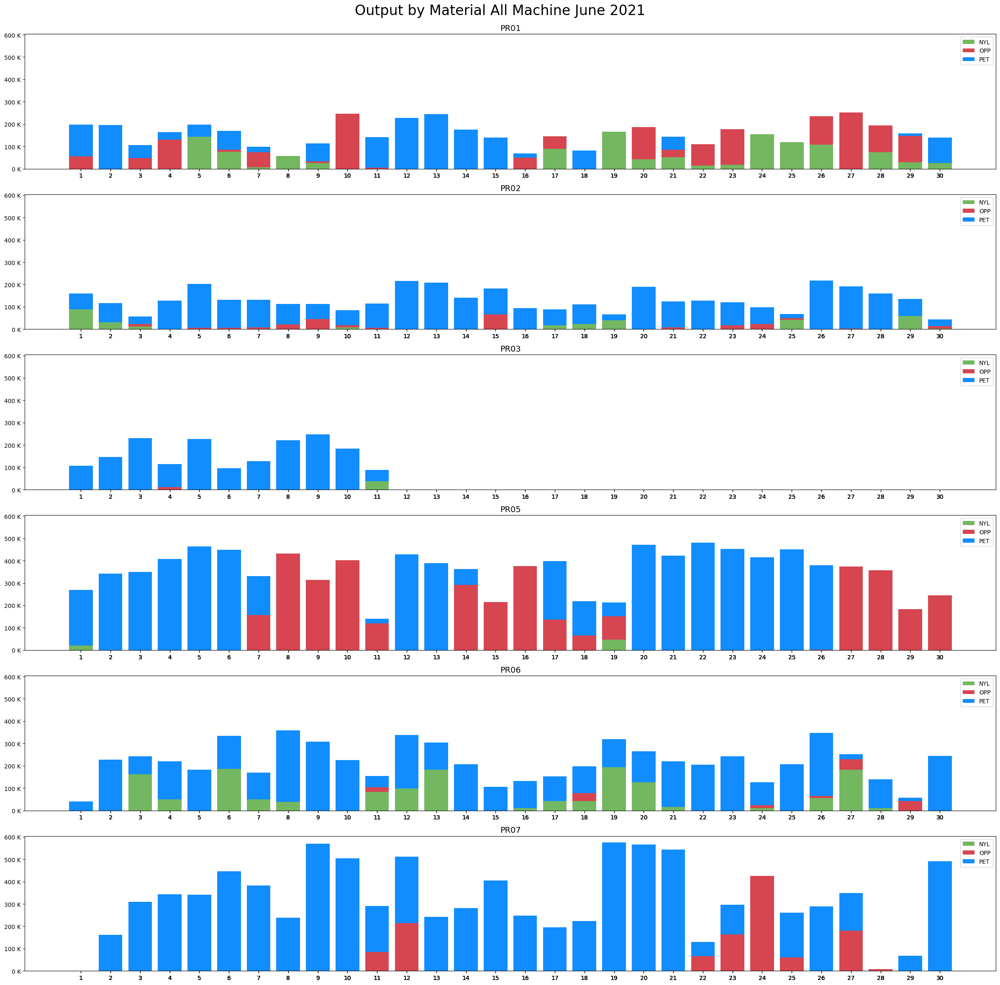

In [ ]:
op_month = op[op['Bulan']==6].pivot_table(values='Output',index=['Tgl','KdMesin'],columns='FILM',aggfunc='sum',fill_value=0).reset_index().rename_axis(None, axis=1)
op_month['Tgl'] = op_month['Tgl'].dt.day

fig, ax = plt.subplots(nrows=6,ncols=1,figsize=(24, 24),sharex=True,sharey=True)
for i in range(length):
  ax[i].bar(op_month[op_month['KdMesin']=='PR0'+str(list[i])]['Tgl'], op_month[op_month['KdMesin']=='PR0'+str(list[i])]['NYL'], label='NYL',color='#73b761')
  ax[i].bar(op_month[op_month['KdMesin']=='PR0'+str(list[i])]['Tgl'], op_month[op_month['KdMesin']=='PR0'+str(list[i])]['OPP'], 
          bottom=op_month[op_month['KdMesin']=='PR0'+str(list[i])]['NYL'],label='OPP',color='#d64550')
  ax[i].bar(op_month[op_month['KdMesin']=='PR0'+str(list[i])]['Tgl'], op_month[op_month['KdMesin']=='PR0'+str(list[i])]['PET'], 
          bottom=op_month[op_month['KdMesin']=='PR0'+str(list[i])]['NYL']+np.array(op_month[op_month['KdMesin']=='PR0'+str(list[i])]['OPP']),label='PET',color='#118dff')
  ax[i].yaxis.set_major_formatter(thousand_formatter)
  ax[i].set_xticks(op_month['Tgl'])
  ax[i].legend()
  ax[i].set_title('PR0'+str(list[i]),fontsize=14)
  ax[i].xaxis.set_tick_params(labelbottom=True)

fig.suptitle('Output by Material All Machine June 2021',fontsize=24)
# Tight layout often produces nice results
# but requires the title to be spaced accordingly
fig.tight_layout()
fig.subplots_adjust(top=0.95)
plt.show()

### **July**

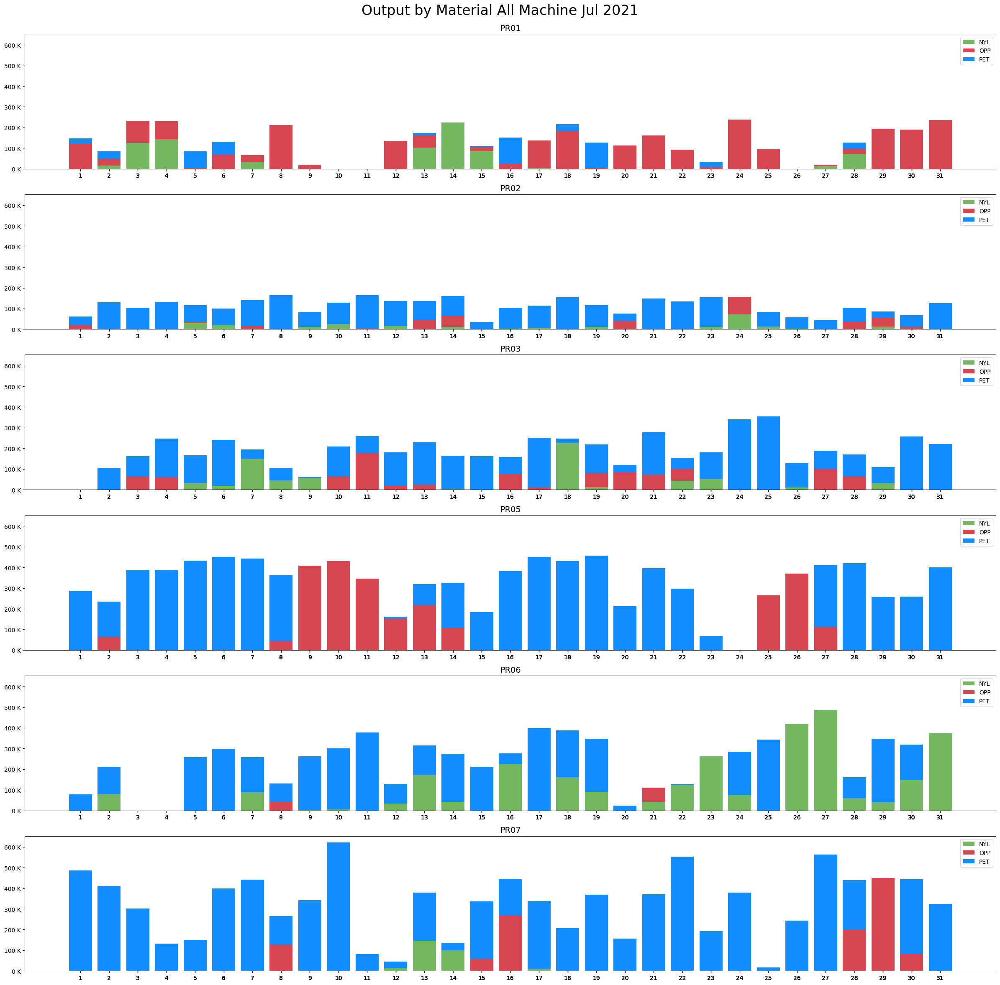

In [ ]:
op_month = op[op['Bulan']==7].pivot_table(values='Output',index=['Tgl','KdMesin'],columns='FILM',aggfunc='sum',fill_value=0).reset_index().rename_axis(None, axis=1)
op_month['Tgl'] = op_month['Tgl'].dt.day

fig, ax = plt.subplots(nrows=6,ncols=1,figsize=(24, 24),sharex=True,sharey=True)

for i in range(length):
  ax[i].bar(op_month[op_month['KdMesin']=='PR0'+str(list[i])]['Tgl'], op_month[op_month['KdMesin']=='PR0'+str(list[i])]['NYL'], label='NYL',color='#73b761')
  ax[i].bar(op_month[op_month['KdMesin']=='PR0'+str(list[i])]['Tgl'], op_month[op_month['KdMesin']=='PR0'+str(list[i])]['OPP'], 
          bottom=op_month[op_month['KdMesin']=='PR0'+str(list[i])]['NYL'],label='OPP',color='#d64550')
  ax[i].bar(op_month[op_month['KdMesin']=='PR0'+str(list[i])]['Tgl'], op_month[op_month['KdMesin']=='PR0'+str(list[i])]['PET'], 
          bottom=op_month[op_month['KdMesin']=='PR0'+str(list[i])]['NYL']+np.array(op_month[op_month['KdMesin']=='PR0'+str(list[i])]['OPP']),label='PET',color='#118dff')
  ax[i].yaxis.set_major_formatter(thousand_formatter)
  ax[i].set_xticks(op_month['Tgl'])
  ax[i].legend()
  ax[i].set_title('PR0'+str(list[i]),fontsize=14)
  ax[i].xaxis.set_tick_params(labelbottom=True)

fig.suptitle('Output by Material All Machine Jul 2021',fontsize=24)
# Tight layout often produces nice results
# but requires the title to be spaced accordingly
fig.tight_layout()
fig.subplots_adjust(top=0.95)
plt.show()

### **August**

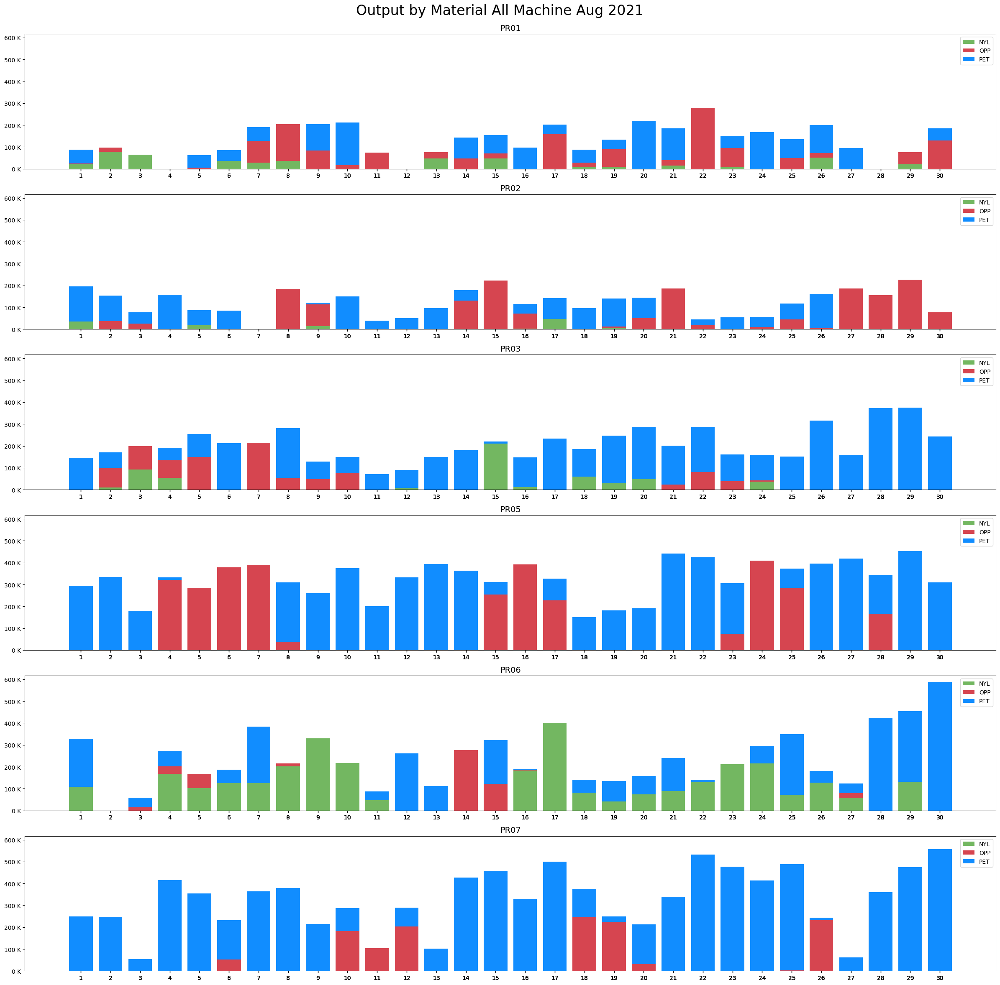

In [ ]:
op_month = op[op['Bulan']==8].pivot_table(values='Output',index=['Tgl','KdMesin'],columns='FILM',aggfunc='sum',fill_value=0).reset_index().rename_axis(None, axis=1)
op_month['Tgl'] = op_month['Tgl'].dt.day

fig, ax = plt.subplots(nrows=6,ncols=1,figsize=(24, 24),sharex=True,sharey=True)

for i in range(length):
  ax[i].bar(op_month[op_month['KdMesin']=='PR0'+str(list[i])]['Tgl'], op_month[op_month['KdMesin']=='PR0'+str(list[i])]['NYL'], label='NYL',color='#73b761')
  ax[i].bar(op_month[op_month['KdMesin']=='PR0'+str(list[i])]['Tgl'], op_month[op_month['KdMesin']=='PR0'+str(list[i])]['OPP'], 
          bottom=op_month[op_month['KdMesin']=='PR0'+str(list[i])]['NYL'],label='OPP',color='#d64550')
  ax[i].bar(op_month[op_month['KdMesin']=='PR0'+str(list[i])]['Tgl'], op_month[op_month['KdMesin']=='PR0'+str(list[i])]['PET'], 
          bottom=op_month[op_month['KdMesin']=='PR0'+str(list[i])]['NYL']+np.array(op_month[op_month['KdMesin']=='PR0'+str(list[i])]['OPP']),label='PET',color='#118dff')
  ax[i].yaxis.set_major_formatter(thousand_formatter)
  ax[i].set_xticks(op_month['Tgl'])
  ax[i].legend()
  ax[i].set_title('PR0'+str(list[i]),fontsize=14)
  ax[i].xaxis.set_tick_params(labelbottom=True)

fig.suptitle('Output by Material All Machine Aug 2021',fontsize=24)
# Tight layout often produces nice results
# but requires the title to be spaced accordingly
fig.tight_layout()
fig.subplots_adjust(top=0.95)
plt.show()

### **September**

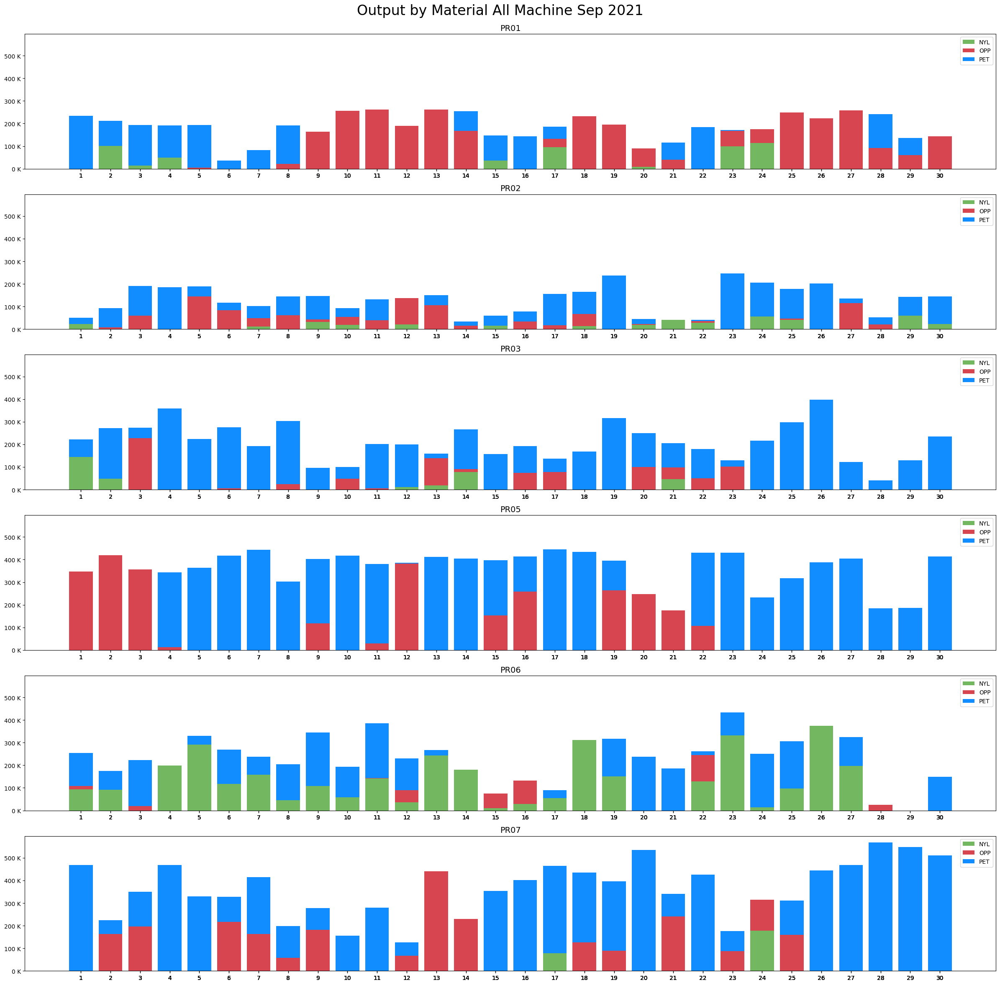

In [ ]:
op_month = op[op['Bulan']==9].pivot_table(values='Output',index=['Tgl','KdMesin'],columns='FILM',aggfunc='sum',fill_value=0).reset_index().rename_axis(None, axis=1)
op_month['Tgl'] = op_month['Tgl'].dt.day

fig, ax = plt.subplots(nrows=6,ncols=1,figsize=(24, 24),sharex=True,sharey=True)

for i in range(length):
  ax[i].bar(op_month[op_month['KdMesin']=='PR0'+str(list[i])]['Tgl'], op_month[op_month['KdMesin']=='PR0'+str(list[i])]['NYL'], label='NYL',color='#73b761')
  ax[i].bar(op_month[op_month['KdMesin']=='PR0'+str(list[i])]['Tgl'], op_month[op_month['KdMesin']=='PR0'+str(list[i])]['OPP'], 
          bottom=op_month[op_month['KdMesin']=='PR0'+str(list[i])]['NYL'],label='OPP',color='#d64550')
  ax[i].bar(op_month[op_month['KdMesin']=='PR0'+str(list[i])]['Tgl'], op_month[op_month['KdMesin']=='PR0'+str(list[i])]['PET'], 
          bottom=op_month[op_month['KdMesin']=='PR0'+str(list[i])]['NYL']+np.array(op_month[op_month['KdMesin']=='PR0'+str(list[i])]['OPP']),label='PET',color='#118dff')
  ax[i].yaxis.set_major_formatter(thousand_formatter)
  ax[i].set_xticks(op_month['Tgl'])
  ax[i].legend()
  ax[i].set_title('PR0'+str(list[i]),fontsize=14)
  ax[i].xaxis.set_tick_params(labelbottom=True)

fig.suptitle('Output by Material All Machine Sep 2021',fontsize=24)
# Tight layout often produces nice results
# but requires the title to be spaced accordingly
fig.tight_layout()
fig.subplots_adjust(top=0.95)
plt.show()

### **October**

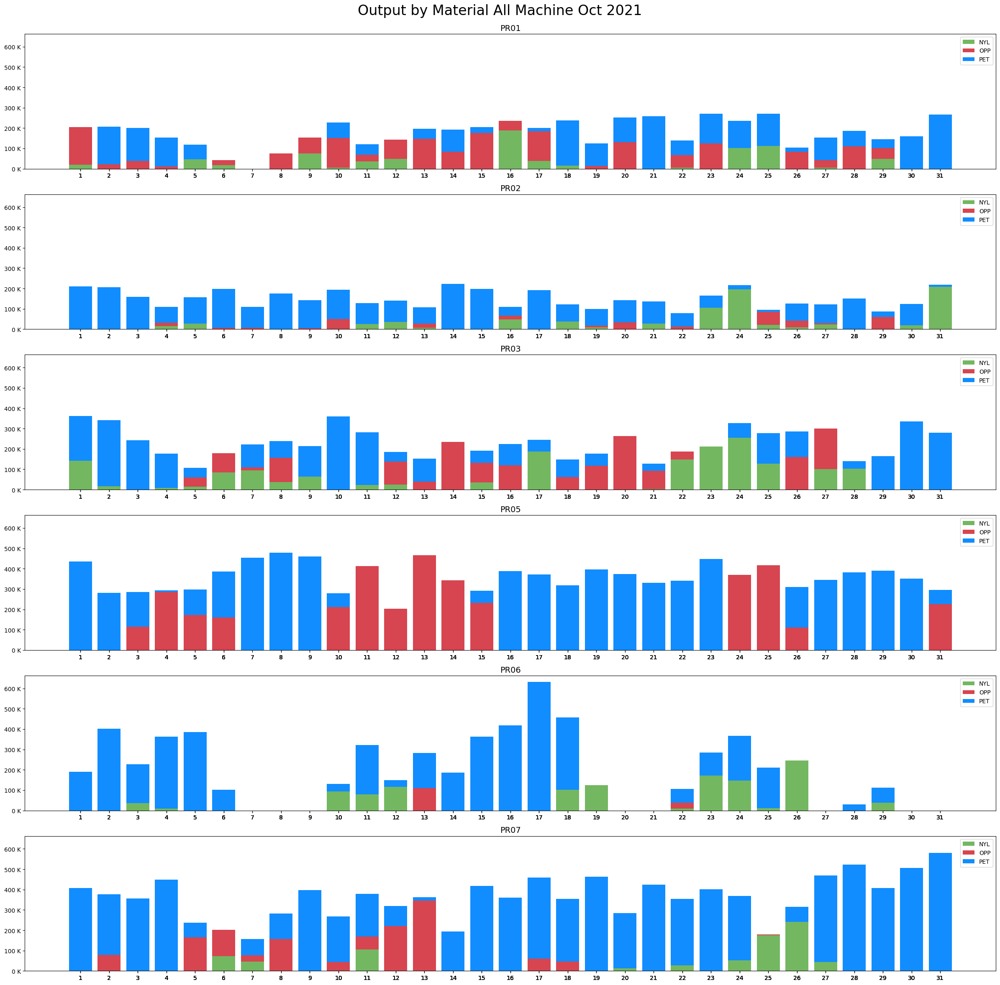

In [ ]:
op_month = op[op['Bulan']==10].pivot_table(values='Output',index=['Tgl','KdMesin'],columns='FILM',aggfunc='sum',fill_value=0).reset_index().rename_axis(None, axis=1)
op_month['Tgl'] = op_month['Tgl'].dt.day

fig, ax = plt.subplots(nrows=6,ncols=1,figsize=(24, 24),sharex=True,sharey=True)
for i in range(length):
  ax[i].bar(op_month[op_month['KdMesin']=='PR0'+str(list[i])]['Tgl'], op_month[op_month['KdMesin']=='PR0'+str(list[i])]['NYL'], label='NYL',color='#73b761')
  ax[i].bar(op_month[op_month['KdMesin']=='PR0'+str(list[i])]['Tgl'], op_month[op_month['KdMesin']=='PR0'+str(list[i])]['OPP'], 
          bottom=op_month[op_month['KdMesin']=='PR0'+str(list[i])]['NYL'],label='OPP',color='#d64550')
  ax[i].bar(op_month[op_month['KdMesin']=='PR0'+str(list[i])]['Tgl'], op_month[op_month['KdMesin']=='PR0'+str(list[i])]['PET'], 
          bottom=op_month[op_month['KdMesin']=='PR0'+str(list[i])]['NYL']+np.array(op_month[op_month['KdMesin']=='PR0'+str(list[i])]['OPP']),label='PET',color='#118dff')
  ax[i].yaxis.set_major_formatter(thousand_formatter)
  ax[i].set_xticks(op_month['Tgl'])
  ax[i].legend()
  ax[i].set_title('PR0'+str(list[i]),fontsize=14)
  ax[i].xaxis.set_tick_params(labelbottom=True)

fig.suptitle('Output by Material All Machine Oct 2021',fontsize=24)
# Tight layout often produces nice results
# but requires the title to be spaced accordingly
fig.tight_layout()
fig.subplots_adjust(top=0.95)
plt.show()

### **November**

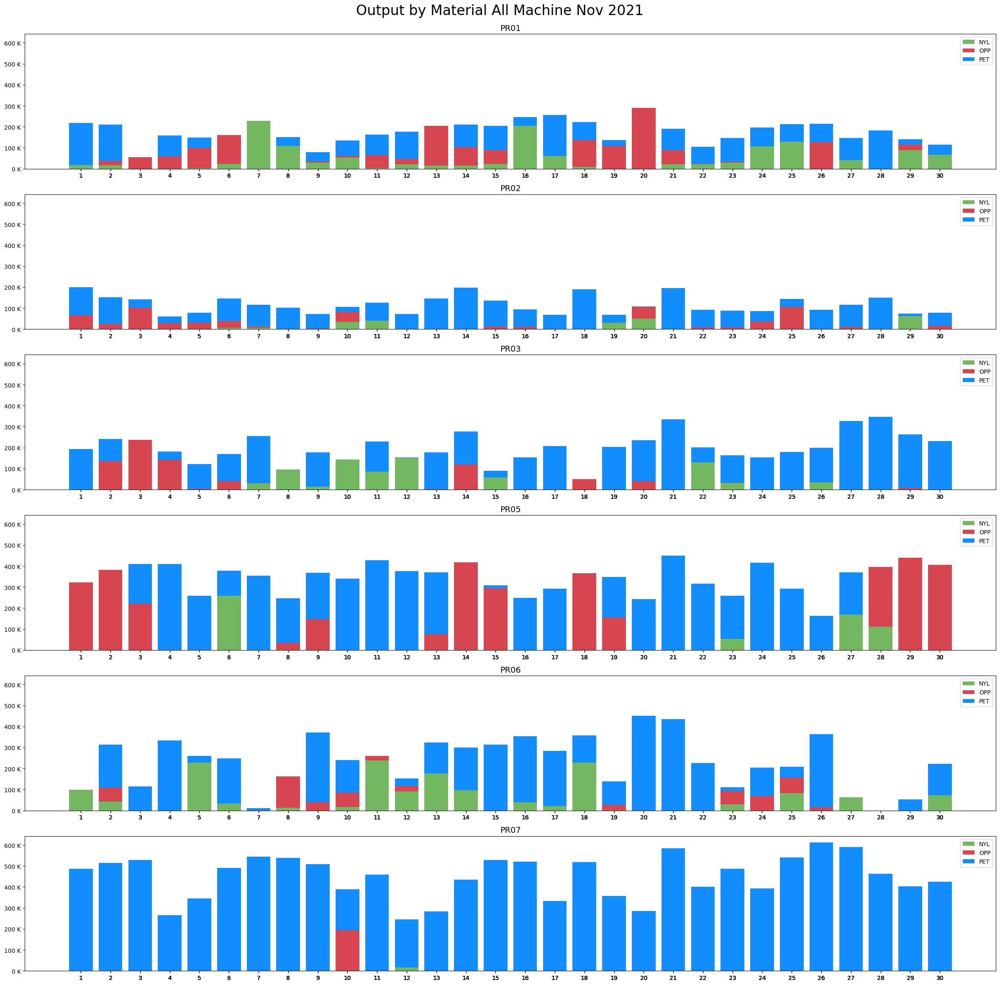

In [ ]:
op_month = op[op['Bulan']==11].pivot_table(values='Output',index=['Tgl','KdMesin'],columns='FILM',aggfunc='sum',fill_value=0).reset_index().rename_axis(None, axis=1)
op_month['Tgl'] = op_month['Tgl'].dt.day

fig, ax = plt.subplots(nrows=6,ncols=1,figsize=(24, 24),sharex=True,sharey=True)
for i in range(length):
  ax[i].bar(op_month[op_month['KdMesin']=='PR0'+str(list[i])]['Tgl'], op_month[op_month['KdMesin']=='PR0'+str(list[i])]['NYL'], label='NYL',color='#73b761')
  ax[i].bar(op_month[op_month['KdMesin']=='PR0'+str(list[i])]['Tgl'], op_month[op_month['KdMesin']=='PR0'+str(list[i])]['OPP'], 
          bottom=op_month[op_month['KdMesin']=='PR0'+str(list[i])]['NYL'],label='OPP',color='#d64550')
  ax[i].bar(op_month[op_month['KdMesin']=='PR0'+str(list[i])]['Tgl'], op_month[op_month['KdMesin']=='PR0'+str(list[i])]['PET'], 
          bottom=op_month[op_month['KdMesin']=='PR0'+str(list[i])]['NYL']+np.array(op_month[op_month['KdMesin']=='PR0'+str(list[i])]['OPP']),label='PET',color='#118dff')
  ax[i].yaxis.set_major_formatter(thousand_formatter)
  ax[i].set_xticks(op_month['Tgl'])
  ax[i].legend()
  ax[i].set_title('PR0'+str(list[i]),fontsize=14)
  ax[i].xaxis.set_tick_params(labelbottom=True)

fig.suptitle('Output by Material All Machine Nov 2021',fontsize=24)
# Tight layout often produces nice results
# but requires the title to be spaced accordingly
fig.tight_layout()
fig.subplots_adjust(top=0.95)
plt.show()

### **December**

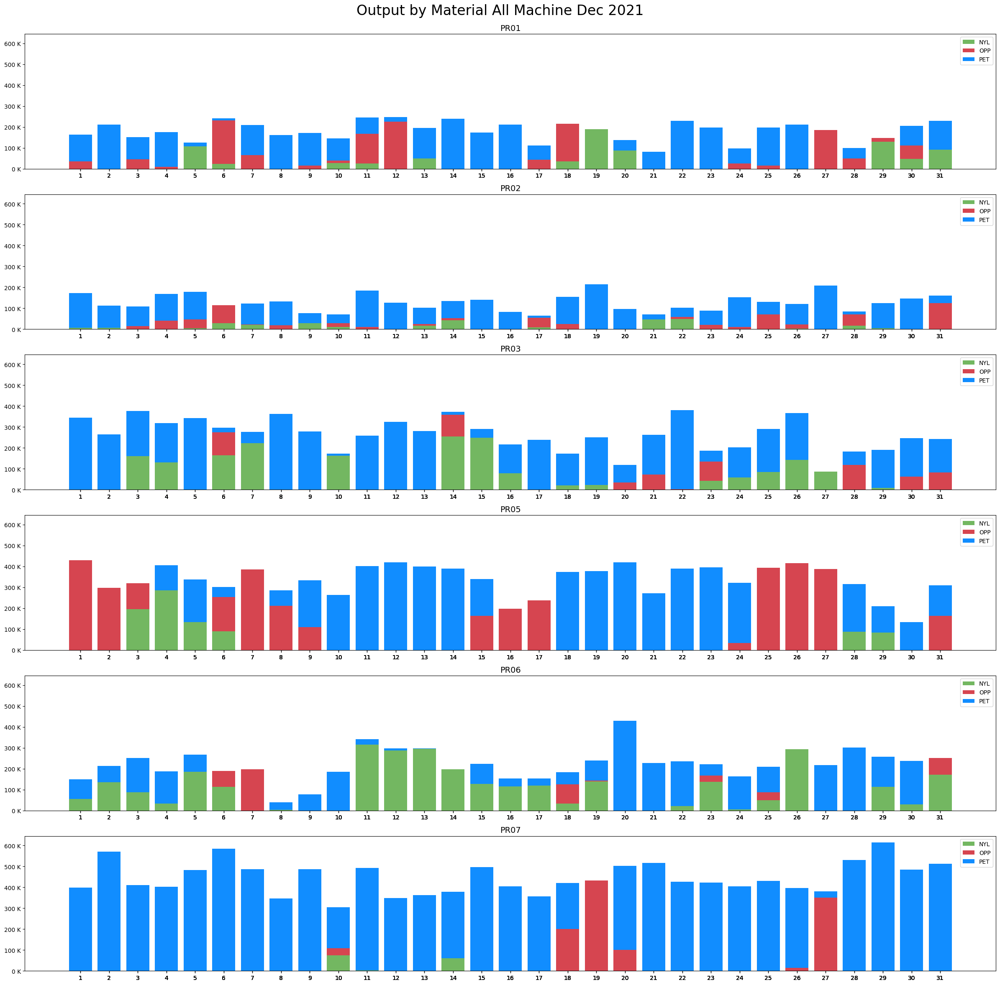

In [ ]:
op_month = op[op['Bulan']==12].pivot_table(values='Output',index=['Tgl','KdMesin'],columns='FILM',aggfunc='sum',fill_value=0).reset_index().rename_axis(None, axis=1)
op_month['Tgl'] = op_month['Tgl'].dt.day

fig, ax = plt.subplots(nrows=6,ncols=1,figsize=(24, 24),sharex=True,sharey=True)
for i in range(length):
  ax[i].bar(op_month[op_month['KdMesin']=='PR0'+str(list[i])]['Tgl'], op_month[op_month['KdMesin']=='PR0'+str(list[i])]['NYL'], label='NYL',color='#73b761')
  ax[i].bar(op_month[op_month['KdMesin']=='PR0'+str(list[i])]['Tgl'], op_month[op_month['KdMesin']=='PR0'+str(list[i])]['OPP'], 
          bottom=op_month[op_month['KdMesin']=='PR0'+str(list[i])]['NYL'],label='OPP',color='#d64550')
  ax[i].bar(op_month[op_month['KdMesin']=='PR0'+str(list[i])]['Tgl'], op_month[op_month['KdMesin']=='PR0'+str(list[i])]['PET'], 
          bottom=op_month[op_month['KdMesin']=='PR0'+str(list[i])]['NYL']+np.array(op_month[op_month['KdMesin']=='PR0'+str(list[i])]['OPP']),label='PET',color='#118dff')
  ax[i].yaxis.set_major_formatter(thousand_formatter)
  ax[i].set_xticks(op_month['Tgl'])
  ax[i].legend()
  ax[i].set_title('PR0'+str(list[i]),fontsize=14)
  ax[i].xaxis.set_tick_params(labelbottom=True)

fig.suptitle('Output by Material All Machine Dec 2021',fontsize=24)
# Tight layout often produces nice results
# but requires the title to be spaced accordingly
fig.tight_layout()
fig.subplots_adjust(top=0.95)
plt.show()

## **5. Monthly Output by Material per Machine**

### **PR01**

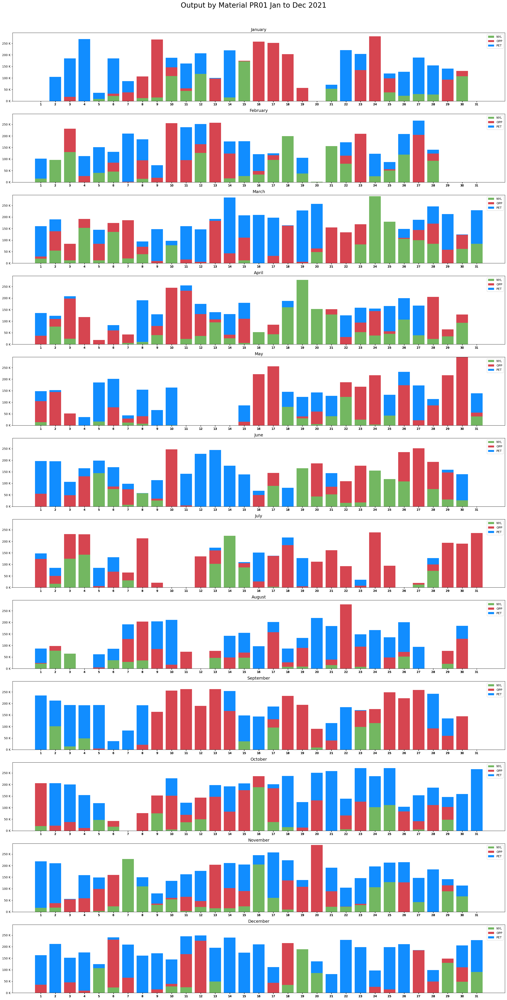

In [ ]:
op_pr= op[op['KdMesin']=='PR01'].pivot_table(values='Output',index=['Tgl','Bulan'],columns='FILM',aggfunc='sum', fill_value=0).reset_index().rename_axis(None, axis=1)
op_pr['Tgl'] = op_pr['Tgl'].dt.day
fig, ax = plt.subplots(nrows=12,ncols=1,figsize=(24, 48),sharex=True,sharey=True)

for i in range(12):
  ax[i].bar(op_pr[op_pr['Bulan']==i+1]['Tgl'], op_pr[op_pr['Bulan']==i+1]['NYL'], label='NYL',color='#73b761')
  ax[i].bar(op_pr[op_pr['Bulan']==i+1]['Tgl'], op_pr[op_pr['Bulan']==i+1]['OPP'], 
              bottom=op_pr[op_pr['Bulan']==i+1]['NYL'],label='OPP',color='#d64550')
  ax[i].bar(op_pr[op_pr['Bulan']==i+1]['Tgl'], op_pr[op_pr['Bulan']==i+1]['PET'], 
              bottom=op_pr[op_pr['Bulan']==i+1]['NYL']+np.array(op_pr[op_pr['Bulan']==i+1]['OPP']),label='PET',color='#118dff')
  ax[i].yaxis.set_major_formatter(thousand_formatter)
  ax[i].set_xticks(op_pr['Tgl'])
  ax[i].legend()
  ax[i].set_title(calendar.month_name[i+1],fontsize=14)
  ax[i].xaxis.set_tick_params(labelbottom=True)

fig.suptitle('Output by Material PR01 Jan to Dec 2021',fontsize=24)
# Tight layout often produces nice results
# but requires the title to be spaced accordingly
fig.tight_layout()
fig.subplots_adjust(top=0.95)
plt.show()

### **PR02**

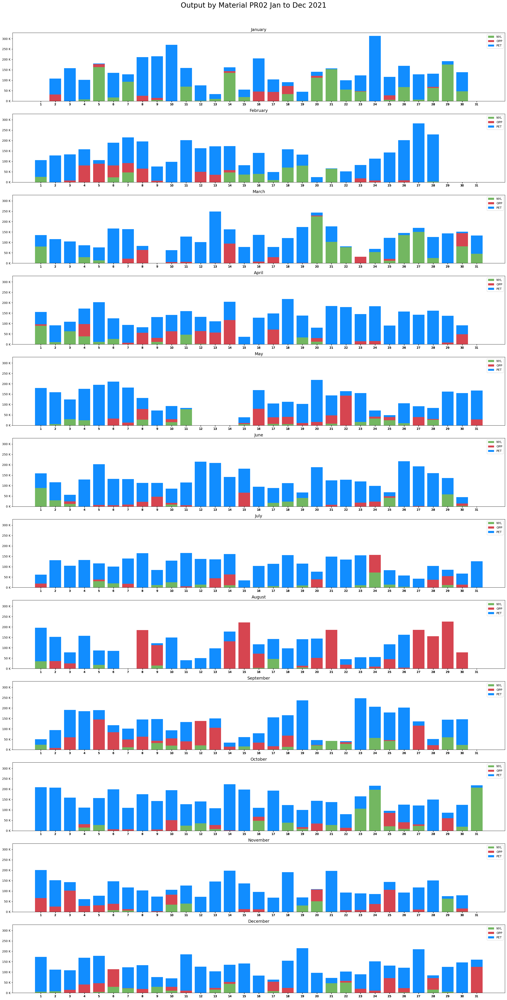

In [ ]:
op_pr= op[op['KdMesin']=='PR02'].pivot_table(values='Output',index=['Tgl','Bulan'],columns='FILM',aggfunc='sum', fill_value=0).reset_index().rename_axis(None, axis=1)
op_pr['Tgl'] = op_pr['Tgl'].dt.day
fig, ax = plt.subplots(nrows=12,ncols=1,figsize=(24, 48),sharex=True,sharey=True)

for i in range(12):
  ax[i].bar(op_pr[op_pr['Bulan']==i+1]['Tgl'], op_pr[op_pr['Bulan']==i+1]['NYL'], label='NYL',color='#73b761')
  ax[i].bar(op_pr[op_pr['Bulan']==i+1]['Tgl'], op_pr[op_pr['Bulan']==i+1]['OPP'], 
              bottom=op_pr[op_pr['Bulan']==i+1]['NYL'],label='OPP',color='#d64550')
  ax[i].bar(op_pr[op_pr['Bulan']==i+1]['Tgl'], op_pr[op_pr['Bulan']==i+1]['PET'], 
              bottom=op_pr[op_pr['Bulan']==i+1]['NYL']+np.array(op_pr[op_pr['Bulan']==i+1]['OPP']),label='PET',color='#118dff')
  ax[i].yaxis.set_major_formatter(thousand_formatter)
  ax[i].set_xticks(op_pr['Tgl'])
  ax[i].legend()
  ax[i].set_title(calendar.month_name[i+1],fontsize=14)
  ax[i].xaxis.set_tick_params(labelbottom=True)

fig.suptitle('Output by Material PR02 Jan to Dec 2021',fontsize=24)
# Tight layout often produces nice results
# but requires the title to be spaced accordingly
fig.tight_layout()
fig.subplots_adjust(top=0.95)
plt.show()

### **PR03**

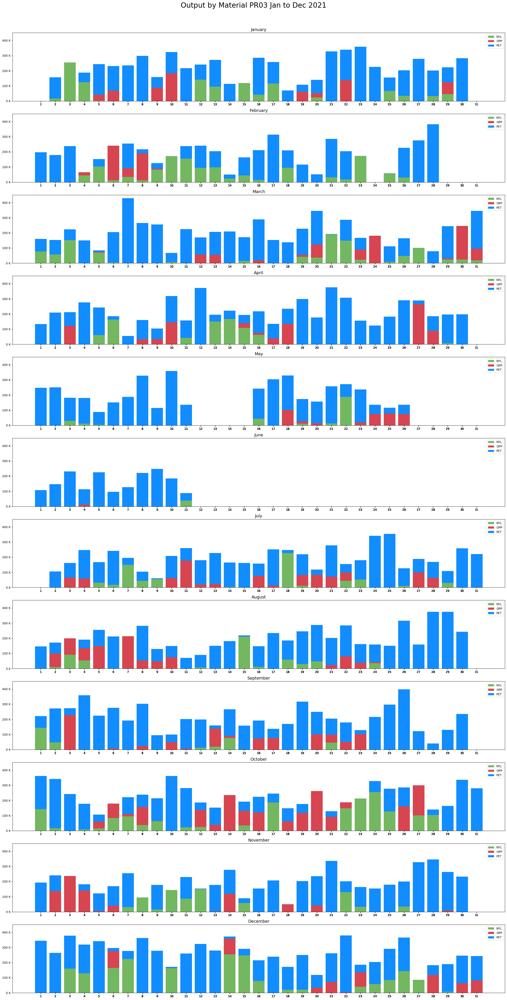

In [ ]:
op_pr= op[op['KdMesin']=='PR03'].pivot_table(values='Output',index=['Tgl','Bulan'],columns='FILM',aggfunc='sum', fill_value=0).reset_index().rename_axis(None, axis=1)
op_pr['Tgl'] = op_pr['Tgl'].dt.day
fig, ax = plt.subplots(nrows=12,ncols=1,figsize=(24, 48),sharex=True,sharey=True)

for i in range(12):
  ax[i].bar(op_pr[op_pr['Bulan']==i+1]['Tgl'], op_pr[op_pr['Bulan']==i+1]['NYL'], label='NYL',color='#73b761')
  ax[i].bar(op_pr[op_pr['Bulan']==i+1]['Tgl'], op_pr[op_pr['Bulan']==i+1]['OPP'], 
              bottom=op_pr[op_pr['Bulan']==i+1]['NYL'],label='OPP',color='#d64550')
  ax[i].bar(op_pr[op_pr['Bulan']==i+1]['Tgl'], op_pr[op_pr['Bulan']==i+1]['PET'], 
              bottom=op_pr[op_pr['Bulan']==i+1]['NYL']+np.array(op_pr[op_pr['Bulan']==i+1]['OPP']),label='PET',color='#118dff')
  ax[i].yaxis.set_major_formatter(thousand_formatter)
  ax[i].set_xticks(op_pr['Tgl'])
  ax[i].legend()
  ax[i].set_title(calendar.month_name[i+1],fontsize=14)
  ax[i].xaxis.set_tick_params(labelbottom=True)

fig.suptitle('Output by Material PR03 Jan to Dec 2021',fontsize=24)
# Tight layout often produces nice results
# but requires the title to be spaced accordingly
fig.tight_layout()
fig.subplots_adjust(top=0.95)
plt.show()

### **PR05**

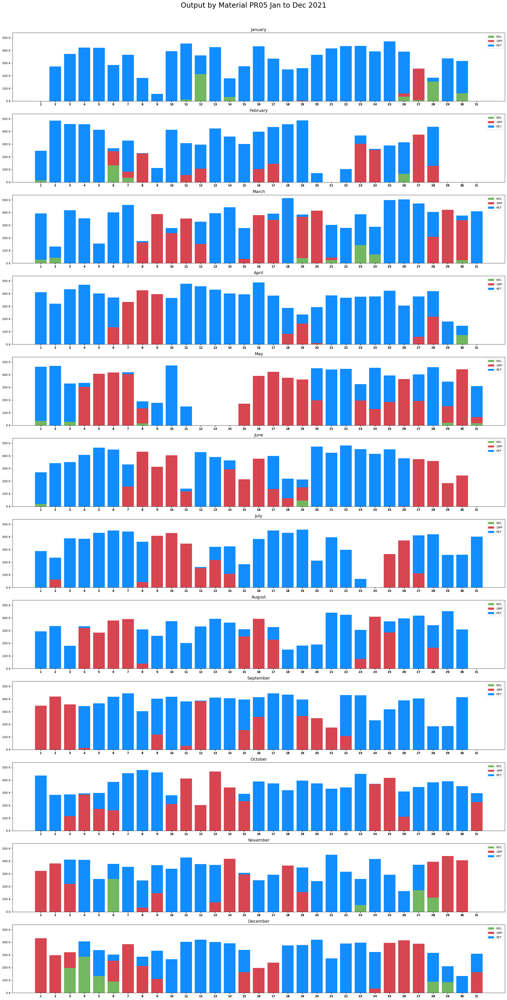

In [ ]:
op_pr= op[op['KdMesin']=='PR05'].pivot_table(values='Output',index=['Tgl','Bulan'],columns='FILM',aggfunc='sum', fill_value=0).reset_index().rename_axis(None, axis=1)
op_pr['Tgl'] = op_pr['Tgl'].dt.day

fig, ax = plt.subplots(nrows=12,ncols=1,figsize=(24, 48),sharex=True,sharey=True)
for i in range(12):
  ax[i].bar(op_pr[op_pr['Bulan']==i+1]['Tgl'], op_pr[op_pr['Bulan']==i+1]['NYL'], label='NYL',color='#73b761')
  ax[i].bar(op_pr[op_pr['Bulan']==i+1]['Tgl'], op_pr[op_pr['Bulan']==i+1]['OPP'], 
              bottom=op_pr[op_pr['Bulan']==i+1]['NYL'],label='OPP',color='#d64550')
  ax[i].bar(op_pr[op_pr['Bulan']==i+1]['Tgl'], op_pr[op_pr['Bulan']==i+1]['PET'], 
              bottom=op_pr[op_pr['Bulan']==i+1]['NYL']+np.array(op_pr[op_pr['Bulan']==i+1]['OPP']),label='PET',color='#118dff')
  ax[i].yaxis.set_major_formatter(thousand_formatter)
  ax[i].set_xticks(op_pr['Tgl'])
  ax[i].legend()
  ax[i].set_title(calendar.month_name[i+1],fontsize=14)
  ax[i].xaxis.set_tick_params(labelbottom=True)

fig.suptitle('Output by Material PR05 Jan to Dec 2021',fontsize=24)
# Tight layout often produces nice results
# but requires the title to be spaced accordingly
fig.tight_layout()
fig.subplots_adjust(top=0.95)
plt.show()

### **PR06**

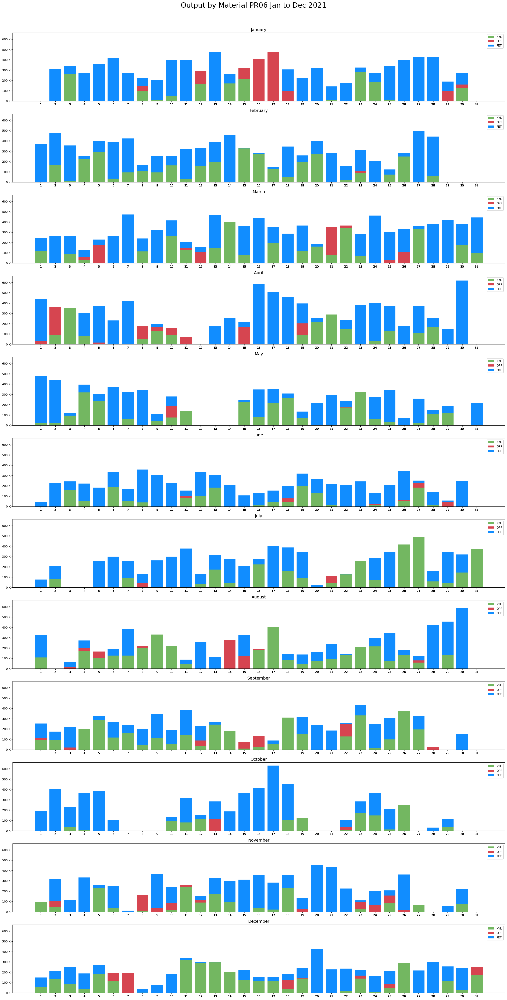

In [ ]:
op_pr= op[op['KdMesin']=='PR06'].pivot_table(values='Output',index=['Tgl','Bulan'],columns='FILM',aggfunc='sum', fill_value=0).reset_index().rename_axis(None, axis=1)
op_pr['Tgl'] = op_pr['Tgl'].dt.day

fig, ax = plt.subplots(nrows=12,ncols=1,figsize=(24, 48),sharex=True,sharey=True)
for i in range(12):
  ax[i].bar(op_pr[op_pr['Bulan']==i+1]['Tgl'], op_pr[op_pr['Bulan']==i+1]['NYL'], label='NYL',color='#73b761')
  ax[i].bar(op_pr[op_pr['Bulan']==i+1]['Tgl'], op_pr[op_pr['Bulan']==i+1]['OPP'], 
              bottom=op_pr[op_pr['Bulan']==i+1]['NYL'],label='OPP',color='#d64550')
  ax[i].bar(op_pr[op_pr['Bulan']==i+1]['Tgl'], op_pr[op_pr['Bulan']==i+1]['PET'], 
              bottom=op_pr[op_pr['Bulan']==i+1]['NYL']+np.array(op_pr[op_pr['Bulan']==i+1]['OPP']),label='PET',color='#118dff')
  ax[i].yaxis.set_major_formatter(thousand_formatter)
  ax[i].set_xticks(op_pr['Tgl'])
  ax[i].legend()
  ax[i].set_title(calendar.month_name[i+1],fontsize=14)
  ax[i].xaxis.set_tick_params(labelbottom=True)

fig.suptitle('Output by Material PR06 Jan to Dec 2021',fontsize=24)
# Tight layout often produces nice results
# but requires the title to be spaced accordingly
fig.tight_layout()
fig.subplots_adjust(top=0.95)
plt.show()

### **PR07**

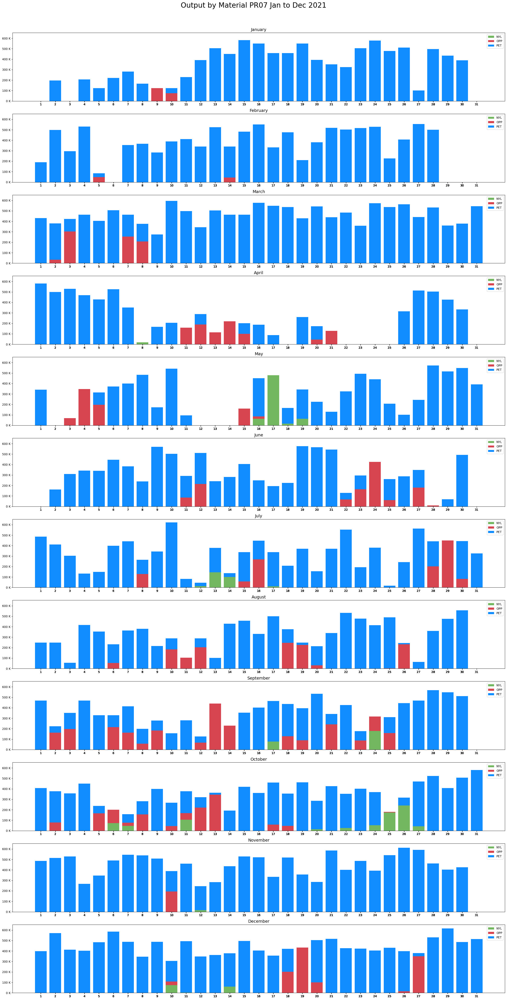

In [ ]:
op_pr= op[op['KdMesin']=='PR07'].pivot_table(values='Output',index=['Tgl','Bulan'],columns='FILM',aggfunc='sum', fill_value=0).reset_index().rename_axis(None, axis=1)
op_pr['Tgl'] = op_pr['Tgl'].dt.day

fig, ax = plt.subplots(nrows=12,ncols=1,figsize=(24, 48),sharex=True,sharey=True)
for i in range(12):
  ax[i].bar(op_pr[op_pr['Bulan']==i+1]['Tgl'], op_pr[op_pr['Bulan']==i+1]['NYL'], label='NYL',color='#73b761')
  ax[i].bar(op_pr[op_pr['Bulan']==i+1]['Tgl'], op_pr[op_pr['Bulan']==i+1]['OPP'], 
              bottom=op_pr[op_pr['Bulan']==i+1]['NYL'],label='OPP',color='#d64550')
  ax[i].bar(op_pr[op_pr['Bulan']==i+1]['Tgl'], op_pr[op_pr['Bulan']==i+1]['PET'], 
              bottom=op_pr[op_pr['Bulan']==i+1]['NYL']+np.array(op_pr[op_pr['Bulan']==i+1]['OPP']),label='PET',color='#118dff')
  ax[i].yaxis.set_major_formatter(thousand_formatter)
  ax[i].set_xticks(op_pr['Tgl'])
  ax[i].legend()
  ax[i].set_title(calendar.month_name[i+1],fontsize=14)
  ax[i].xaxis.set_tick_params(labelbottom=True)

fig.suptitle('Output by Material PR07 Jan to Dec 2021',fontsize=24)
# Tight layout often produces nice results
# but requires the title to be spaced accordingly
fig.tight_layout()
fig.subplots_adjust(top=0.95)
plt.show()

## **6. Downtime by Material**

In [ ]:
# downtime data by material per machine
down_pet= down[down['FILM']=='PET'].pivot_table(values='Downtime',index='KdMesin',aggfunc='sum').reset_index()
down_nyl= down[down['FILM']=='NYL'].pivot_table(values='Downtime',index='KdMesin',aggfunc='sum').reset_index()
down_opp= down[down['FILM']=='OPP'].pivot_table(values='Downtime',index='KdMesin',aggfunc='sum').reset_index()

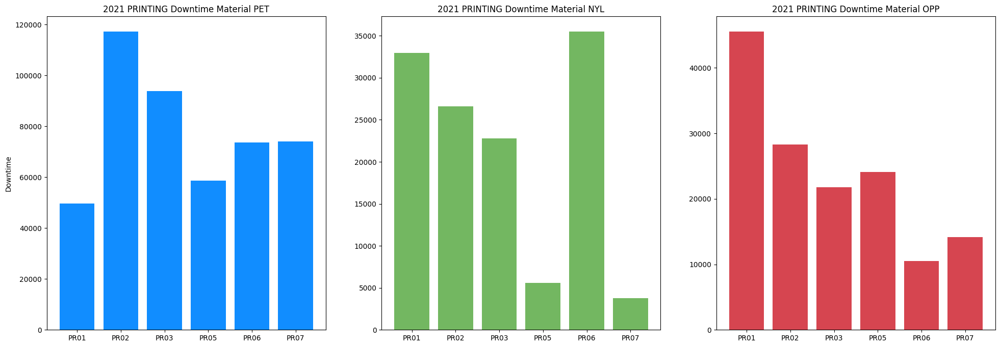

In [ ]:
# plotting Downtime by material per machine
f, axarr = plt.subplots(nrows=1,ncols=3,figsize=(24, 8))

# plot material PET
plt.sca(axarr[0]);
plt.bar(down_pet['KdMesin'],down_pet['Downtime'], color='#118dff')
plt.ylabel('Downtime')
plt.title('2021 PRINTING Downtime Material PET')

# plot material NYL
plt.sca(axarr[1]);
plt.bar(down_nyl['KdMesin'],down_nyl['Downtime'],color='#73b761')
plt.title('2021 PRINTING Downtime Material NYL')

# plot material OPP
plt.sca(axarr[2]);
plt.bar(down_opp['KdMesin'],down_opp['Downtime'],color='#d64550')
plt.title('2021 PRINTING Downtime Material OPP')

plt.show()

In [ ]:
# downtime data by material per breakdown code
down_pet= down[down['FILM']=='PET'].pivot_table(values='Downtime',index='KodeBD',aggfunc='sum').reset_index()
down_nyl= down[down['FILM']=='NYL'].pivot_table(values='Downtime',index='KodeBD',aggfunc='sum').reset_index()
down_opp= down[down['FILM']=='OPP'].pivot_table(values='Downtime',index='KodeBD',aggfunc='sum').reset_index()

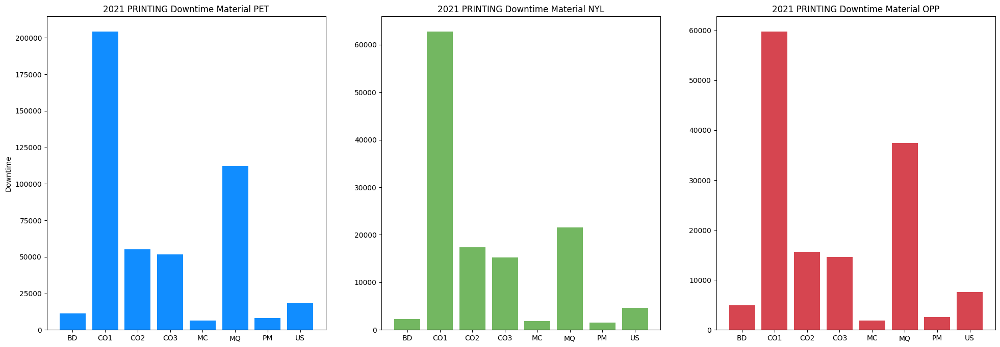

In [ ]:
# plotting Downtime by material breakdown code
f, axarr = plt.subplots(nrows=1,ncols=3,figsize=(24, 8))

# plot material PET
plt.sca(axarr[0]);
plt.bar(down_pet['KodeBD'],down_pet['Downtime'], color='#118dff')
plt.ylabel('Downtime')
plt.title('2021 PRINTING Downtime Material PET')

# plot material NYL
plt.sca(axarr[1]);
plt.bar(down_nyl['KodeBD'],down_nyl['Downtime'],color='#73b761')
plt.title('2021 PRINTING Downtime Material NYL')

# plot material OPP
plt.sca(axarr[2]);
plt.bar(down_opp['KodeBD'],down_opp['Downtime'],color='#d64550')
plt.title('2021 PRINTING Downtime Material OPP')

plt.show()

### **Line Plot**

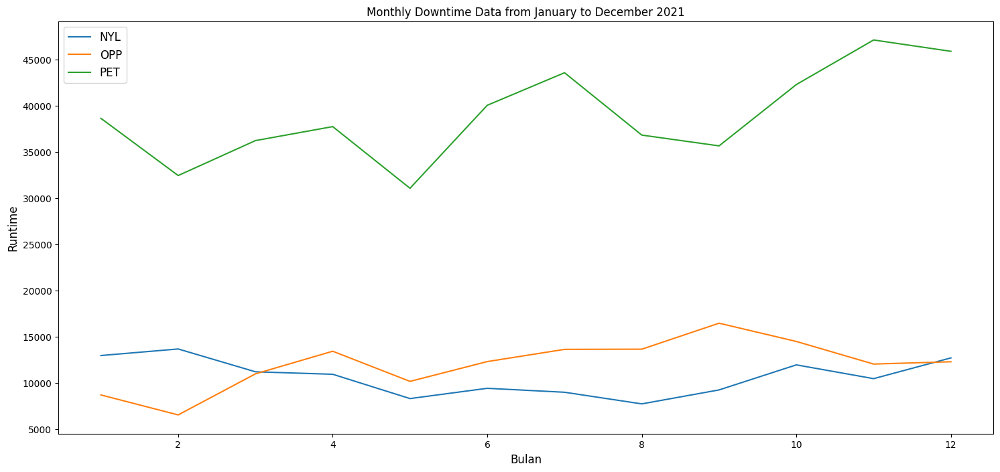

In [ ]:
# plotting daily runtime per material
down_monthly.plot('Bulan',['NYL','OPP','PET'],figsize=(18 , 8)).legend(loc='best', fontsize=12)
plt.xlabel('Bulan', fontsize=12)
plt.ylabel('Runtime', fontsize=12)
plt.title('Monthly Downtime Data from January to December 2021', fontsize=12)
plt.show()

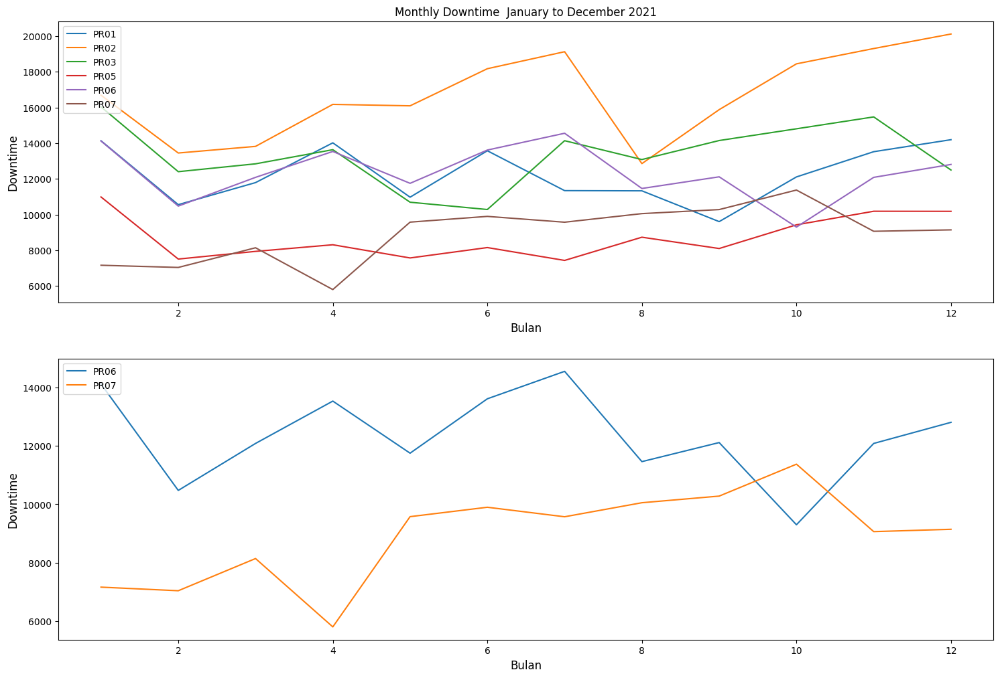

In [ ]:
# plotting daily Downtime by machine
f, ax = plt.subplots(nrows=2,ncols=1,figsize=(18, 12))
line1, = ax[0].plot(dmc_monthly['Bulan'],dmc_monthly['PR01'],label='PR01')
line2, = ax[0].plot(dmc_monthly['Bulan'],dmc_monthly['PR02'],label='PR02')
line3, = ax[0].plot(dmc_monthly['Bulan'],dmc_monthly['PR03'],label='PR03')
line5, = ax[0].plot(dmc_monthly['Bulan'],dmc_monthly['PR05'],label='PR05')
line6, = ax[0].plot(dmc_monthly['Bulan'],dmc_monthly['PR06'],label='PR06')
line7, = ax[0].plot(dmc_monthly['Bulan'],dmc_monthly['PR07'],label='PR07')
ax[0].legend(loc='upper left')
ax[0].set_xlabel('Bulan', fontsize=12)
ax[0].set_ylabel('Downtime', fontsize=12)
ax[0].set_title('Monthly Downtime  January to December 2021', fontsize=12)

line1, = ax[1].plot(dmc_monthly['Bulan'],dmc_monthly['PR06'],label='PR06')
line2, = ax[1].plot(dmc_monthly['Bulan'],dmc_monthly['PR07'],label='PR07')
ax[1].legend(loc= 'upper left')
ax[1].set_xlabel('Bulan', fontsize=12)
ax[1].set_ylabel('Downtime', fontsize=12)
plt.show()

# **Forecasting using model to get new insights after doing data mining with machine learning or deep learning methods**
Forecasting is a technique that uses historical data as inputs to make informed estimates that are predictive in determining the direction of future trends. In future planning, forecasts will become the basis for every company. if a company can predict what will happen in the future then they can change their current habits and take a position that will be much more developed in the future.

## **Forecasting Daily Runtime Data with N-Beats**


In [ ]:
idx = pd.date_range('2021-01-01', '2021-12-31')
run_all = df[df['KodeBD']=='RUN'].pivot_table(values='RunTime', index='Tgl', fill_value=0, aggfunc=np.sum)
run_all = run_all.reindex(idx, fill_value=0).reset_index()

In [ ]:
# defining time series
run_series = TimeSeries.from_dataframe(run_all, 'index','RunTime')

### **Forecasting Daily Runtime by Material With N-Beats**

In [ ]:
pet = run[run['FILM']=='PET'].pivot_table(values='RunTime', index='Tgl', fill_value=0, aggfunc=np.sum)
pet = pet.reindex(idx, fill_value=0).reset_index()
nyl = run[run['FILM']=='NYL'].pivot_table(values='RunTime', index='Tgl', fill_value=0, aggfunc=np.sum)
nyl = nyl.reindex(idx, fill_value=0).reset_index()
opp = run[run['FILM']=='OPP'].pivot_table(values='RunTime', index='Tgl', fill_value=0, aggfunc=np.sum)
opp = opp.reindex(idx, fill_value=0).reset_index()

In [ ]:
# defining time series by material
pet_series = TimeSeries.from_dataframe(pet, 'index','RunTime')
nyl_series = TimeSeries.from_dataframe(nyl, 'index','RunTime')
opp_series = TimeSeries.from_dataframe(opp, 'index','RunTime')

In [ ]:
# check seasonality for PET
is_seasonal, pet_periodicity = check_seasonality(pet_series, max_lag=240)
dict_seas ={
    "PET is seasonal?":is_seasonal,
    "pet_periodicity (days)":f'{pet_periodicity:.1f}', 
    "pet_periodicity (~months)": f'{pet_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

PET is seasonal? : True
pet_periodicity (days) : 7.0
pet_periodicity (~months) : 0.2


In [ ]:
# check seasonality for NYL
is_seasonal, nyl_periodicity = check_seasonality(nyl_series, max_lag=240)
dict_seas ={
    "NYL is seasonal?":is_seasonal,
    "nyl_periodicity (days)":f'{nyl_periodicity:.1f}', 
    "nyl_periodicity (~months)": f'{nyl_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

NYL is seasonal? : True
nyl_periodicity (days) : 7.0
nyl_periodicity (~months) : 0.2


In [ ]:
is_seasonal, opp_periodicity = check_seasonality(opp_series, max_lag=240)
dict_seas ={
    "OPP is seasonal?":is_seasonal,
    "opp_periodicity (days)":f'{opp_periodicity:.1f}', 
    "opp_periodicity (~months)": f'{opp_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

OPP is seasonal? : True
opp_periodicity (days) : 7.0
opp_periodicity (~months) : 0.2


In [ ]:
# data normalization
scaler= Scaler()
series_pet_scaled = scaler.fit_transform(pet_series)
series_nyl_scaled = scaler.fit_transform(nyl_series)
series_opp_scaled = scaler.fit_transform(opp_series)

In [ ]:
# train test split
train_pet, val_pet = series_pet_scaled[:-73], series_pet_scaled[-73:]
pet.iloc[-73:].to_csv('/content/run_pet.csv')
train_nyl, val_nyl = series_nyl_scaled[:-73], series_nyl_scaled[-73:]
nyl.iloc[-73:].to_csv('/content/run_nyl.csv')
train_opp, val_opp = series_opp_scaled[:-73], series_opp_scaled[-73:]
opp.iloc[-73:].to_csv('/content/run_opp.csv')

In [ ]:
# defining and training the model for PET
nbeats_pet= NBEATSModel(
    input_chunk_length=pet_periodicity, 
    output_chunk_length=30, 
    n_epochs=300, 
    optimizer_kwargs={"lr": 1e-3},
    random_state=42)
nbeats_pet.fit(train_pet)

[2022-03-28 07:07:04,273] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 256 samples.
[2022-03-28 07:07:04,273] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 256 samples.
[2022-03-28 07:07:04,385] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
[2022-03-28 07:07:04,385] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs

  | Name      | Type       | Params
-----------------------------------------
0 | criterion | MSELoss    | 0     
1 | stacks    | ModuleList | 6.1 M 
-----------------------------------------
6.1 M     Trainable params
1.3 K     Non-trainable params
6.1 M     Total params
48.532    Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

In [ ]:
# defining and training the model for NYL
nbeats_nyl= NBEATSModel(
    input_chunk_length=nyl_periodicity, 
    output_chunk_length=30, 
    n_epochs=300, 
    optimizer_kwargs={"lr": 1e-3},
    random_state=42)
nbeats_nyl.fit(train_nyl)

[2022-03-28 07:15:12,976] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 256 samples.
[2022-03-28 07:15:12,976] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 256 samples.
[2022-03-28 07:15:13,057] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
[2022-03-28 07:15:13,057] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs

  | Name      | Type       | Params
-----------------------------------------
0 | criterion | MSELoss    | 0     
1 | stacks    | ModuleList | 6.1 M 
-----------------------------------------
6.1 M     Trainable params
1.3 K     Non-trainable params
6.1 M     Total params
48.532    Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

In [ ]:
# defining and training the model for OPP
nbeats_opp= NBEATSModel(
    input_chunk_length=opp_periodicity, 
    output_chunk_length=30, 
    n_epochs=300, 
    optimizer_kwargs={"lr": 1e-3},
    random_state=42)
nbeats_opp.fit(train_opp)

[2022-03-28 07:25:36,721] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 256 samples.
[2022-03-28 07:25:36,721] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 256 samples.
[2022-03-28 07:25:36,801] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
[2022-03-28 07:25:36,801] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs

  | Name      | Type       | Params
-----------------------------------------
0 | criterion | MSELoss    | 0     
1 | stacks    | ModuleList | 6.1 M 
-----------------------------------------
6.1 M     Trainable params
1.3 K     Non-trainable params
6.1 M     Total params
48.532    Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

Predicting: 8it [00:00, ?it/s]

RMSE = 0.187
MAE = 0.149
MSE = 0.035
SMAPE = 28.157
OPE = 6.571%


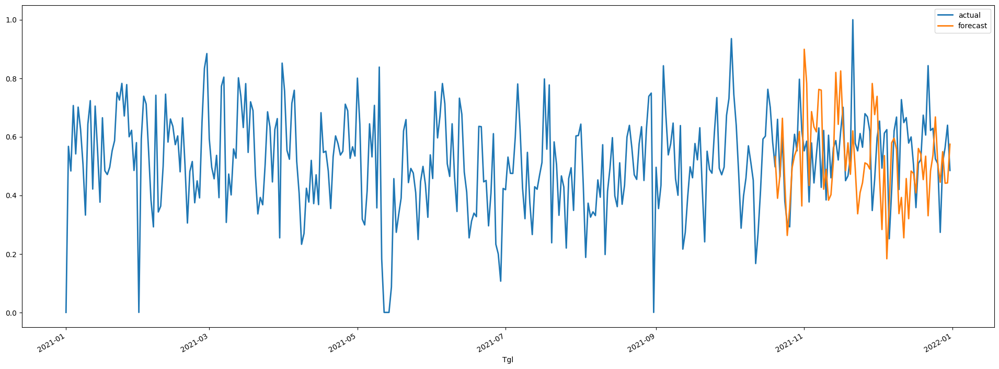

In [ ]:
# prediction for PET
mpl.style.use('default')
pred = nbeats_pet.predict(n=73, series=train_pet)

pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_run_pet_nbeats.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(24,8))
series_pet_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_pet_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_pet_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_pet_scaled, pred)))
print("SMAPE = {:.3f}".format(smape(series_pet_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_pet_scaled, pred)))

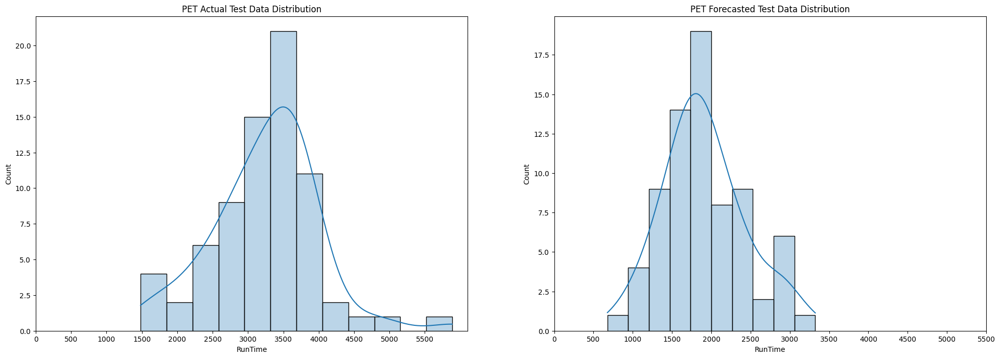

In [ ]:
# normal distribution for PET
pred_pet = pd.read_csv('/content/pred_run_pet_nbeats.csv')
f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(pet.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('PET Actual Test Data Distribution')
axarr[0].set_xticks(np.arange(start=0,stop=6000,step=500))

# plot forecasted test data
sns.histplot(pred_pet['RunTime'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('PET Forecasted Test Data Distribution')
axarr[1].set_xticks(np.arange(start=0,stop=6000,step=500))

plt.show()

Predicting: 8it [00:00, ?it/s]

RMSE = 0.242
MAE = 0.182
MSE = 0.059
SMAPE = 81.73
OPE = 21.678%


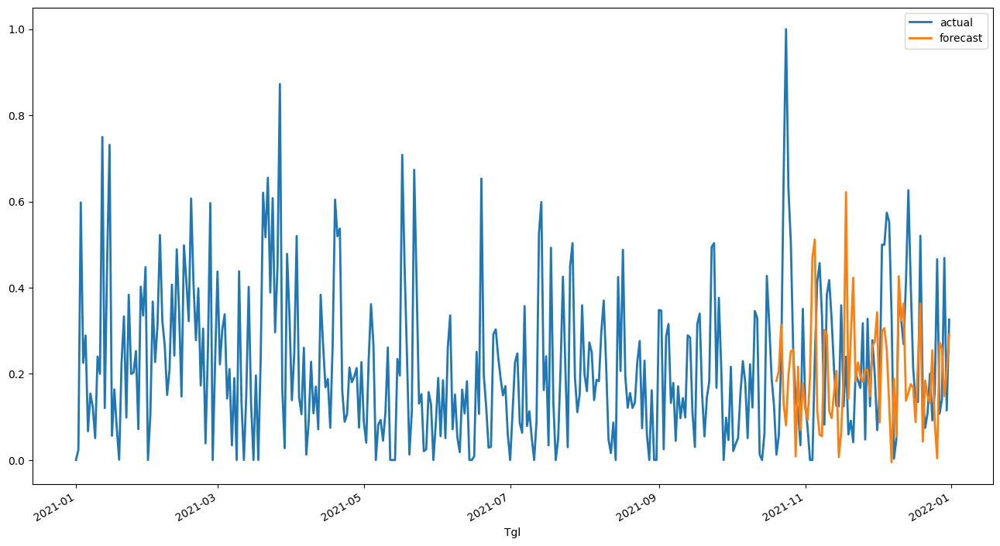

In [ ]:
# prediction for NYL
pred = nbeats_nyl.predict(n=73, series=train_nyl)

pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_run_nyl_nbeats.csv')
# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_nyl_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_nyl_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_nyl_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_nyl_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_nyl_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_nyl_scaled, pred)))

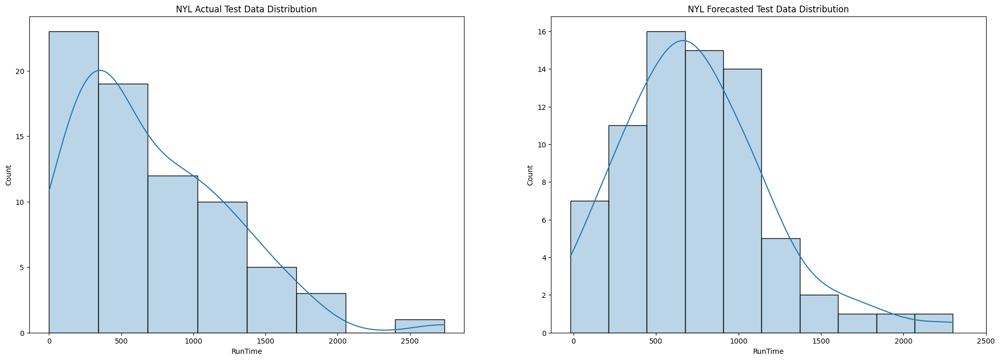

In [ ]:
# normal distribution for NYL
mpl.style.use('default')

pred_nyl = pd.read_csv('/content/pred_run_nyl_nbeats.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(nyl.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('NYL Actual Test Data Distribution')
axarr[0].set_xticks(np.arange(start=0,stop=3000,step=500))

# plot forecasted test data
sns.histplot(pred_nyl['RunTime'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('NYL Forecasted Test Data Distribution')
axarr[1].set_xticks(np.arange(start=0,stop=3000,step=500))

plt.show()

Predicting: 8it [00:00, ?it/s]

RMSE = 0.233
MAE = 0.188
MSE = 0.054
SMAPE = 84.55
OPE = 15.348%


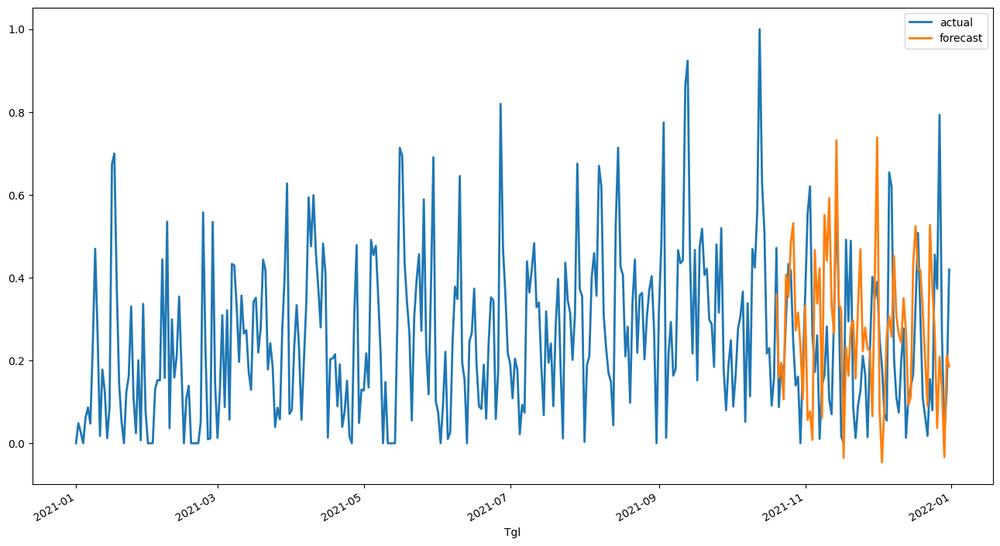

In [ ]:
# prediction for OPP
pred = nbeats_opp.predict(n=73, series=train_opp)
pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_run_opp_nbeats.csv')
# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_opp_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_opp_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_opp_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_opp_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_opp_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_opp_scaled, pred)))

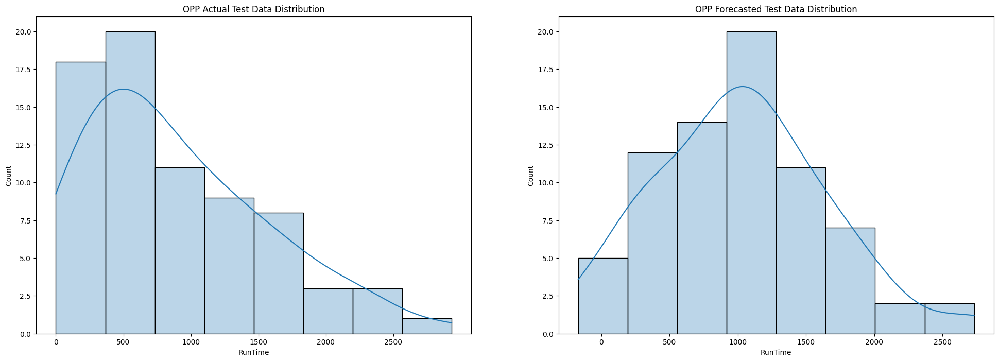

In [ ]:
# normal distribution for OPP

pred_opp = pd.read_csv('/content/pred_run_opp_nbeats.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(opp.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('OPP Actual Test Data Distribution')
axarr[0].set_xticks(np.arange(start=0,stop=3000,step=500))

# plot forecasted test data
sns.histplot(pred_opp['RunTime'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('OPP Forecasted Test Data Distribution')
axarr[1].set_xticks(np.arange(start=0,stop=3000,step=500))

plt.show()

### **Forecasting Daily Runtime by Machine With N-Beats**

In [ ]:
PR01 = run[run['KdMesin']=='PR01'].pivot_table(values='RunTime', index='Tgl', fill_value=0, aggfunc=np.sum)
PR01 = PR01.reindex(idx, fill_value=0).reset_index()
PR02 = run[run['KdMesin']=='PR02'].pivot_table(values='RunTime', index='Tgl', fill_value=0, aggfunc=np.sum)
PR02 = PR02.reindex(idx, fill_value=0).reset_index()
PR03 = run[run['KdMesin']=='PR03'].pivot_table(values='RunTime', index='Tgl', fill_value=0, aggfunc=np.sum)
PR03 = PR03.reindex(idx, fill_value=0).reset_index()
PR05 = run[run['KdMesin']=='PR05'].pivot_table(values='RunTime', index='Tgl', fill_value=0, aggfunc=np.sum)
PR05 = PR05.reindex(idx, fill_value=0).reset_index()
PR06 = run[run['KdMesin']=='PR06'].pivot_table(values='RunTime', index='Tgl', fill_value=0, aggfunc=np.sum)
PR06 = PR06.reindex(idx, fill_value=0).reset_index()
PR07 = run[run['KdMesin']=='PR07'].pivot_table(values='RunTime', index='Tgl', fill_value=0, aggfunc=np.sum)
PR07 = PR07.reindex(idx, fill_value=0).reset_index()

In [ ]:
# defining time series by material
PR01_series = TimeSeries.from_dataframe(PR01, 'index','RunTime')
PR02_series = TimeSeries.from_dataframe(PR02, 'index','RunTime')
PR03_series = TimeSeries.from_dataframe(PR03, 'index','RunTime')
PR05_series = TimeSeries.from_dataframe(PR05, 'index','RunTime')
PR06_series = TimeSeries.from_dataframe(PR06, 'index','RunTime')
PR07_series = TimeSeries.from_dataframe(PR07, 'index','RunTime')

In [ ]:
# check seasonality for PR01
is_seasonal, pr01_periodicity = check_seasonality(PR01_series, max_lag=240)
dict_seas ={
    "PR01 is seasonal?":is_seasonal,
    "pr01_periodicity (days)":f'{pr01_periodicity:.1f}', 
    "pr01_periodicity (~months)": f'{pr01_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

PR01 is seasonal? : True
pr01_periodicity (days) : 7.0
pr01_periodicity (~months) : 0.2


In [ ]:
# check seasonality for PR02
is_seasonal, pr02_periodicity = check_seasonality(PR02_series, max_lag=240)
dict_seas ={
    "PR02 is seasonal?":is_seasonal,
    "pr02_periodicity (days)":f'{pr02_periodicity:.1f}', 
    "pr02_periodicity (~months)": f'{pr02_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

PR02 is seasonal? : True
pr02_periodicity (days) : 7.0
pr02_periodicity (~months) : 0.2


In [ ]:
# check seasonality for PR03
is_seasonal, pr03_periodicity = check_seasonality(PR03_series, max_lag=240)
dict_seas ={
    "PR03 is seasonal?":is_seasonal,
    "pr03_periodicity (days)":f'{pr03_periodicity:.1f}', 
    "pr03_periodicity (~months)": f'{pr03_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

PR03 is seasonal? : True
pr03_periodicity (days) : 6.0
pr03_periodicity (~months) : 0.2


In [ ]:
# check seasonality for PR05
is_seasonal, pr05_periodicity = check_seasonality(PR05_series, max_lag=240)
dict_seas ={
    "PR05 is seasonal?":is_seasonal,
    "pr05_periodicity (days)":f'{pr05_periodicity:.1f}', 
    "pr05_periodicity (~months)": f'{pr05_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

PR05 is seasonal? : True
pr05_periodicity (days) : 3.0
pr05_periodicity (~months) : 0.1


In [ ]:
# check seasonality for PR06
is_seasonal, pr06_periodicity = check_seasonality(PR06_series, max_lag=240)
dict_seas ={
    "PR06 is seasonal?":is_seasonal,
    "pr06_periodicity (days)":f'{pr06_periodicity:.1f}', 
    "pr06_periodicity (~months)": f'{pr06_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

PR06 is seasonal? : True
pr06_periodicity (days) : 8.0
pr06_periodicity (~months) : 0.3


In [ ]:
# check seasonality for PR07
is_seasonal, pr07_periodicity = check_seasonality(PR07_series, max_lag=240)
dict_seas ={
    "PR07 is seasonal?":is_seasonal,
    "pr07_periodicity (days)":f'{pr07_periodicity:.1f}', 
    "pr07_periodicity (~months)": f'{pr07_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

PR07 is seasonal? : True
pr07_periodicity (days) : 6.0
pr07_periodicity (~months) : 0.2


In [ ]:
# data normalization
scaler= Scaler()
series_PR01_scaled = scaler.fit_transform(PR01_series)
series_PR02_scaled = scaler.fit_transform(PR02_series)
series_PR03_scaled = scaler.fit_transform(PR03_series)
series_PR05_scaled = scaler.fit_transform(PR05_series)
series_PR06_scaled = scaler.fit_transform(PR06_series)
series_PR07_scaled = scaler.fit_transform(PR07_series)

In [ ]:
# train test split
train_PR01, val_PR01 = series_PR01_scaled[:-73], series_PR01_scaled[-73:]
PR01.iloc[-73:].to_csv('/content/run_pr01.csv')
train_PR02, val_PR02 = series_PR02_scaled[:-73], series_PR02_scaled[-73:]
PR02.iloc[-73:].to_csv('/content/run_pr02.csv')
train_PR03, val_PR03 = series_PR03_scaled[:-73], series_PR03_scaled[-73:]
PR03.iloc[-73:].to_csv('/content/run_pr03.csv')
train_PR05, val_PR05 = series_PR05_scaled[:-73], series_PR05_scaled[-73:]
PR05.iloc[-73:].to_csv('/content/run_pr05.csv')
train_PR06, val_PR06 = series_PR06_scaled[:-73], series_PR06_scaled[-73:]
PR06.iloc[-73:].to_csv('/content/run_pr06.csv')
train_PR07, val_PR07 = series_PR07_scaled[:-73], series_PR07_scaled[-73:]
PR07.iloc[-73:].to_csv('/content/run_pr07.csv')

In [ ]:
# defining and training the model for PR01
nbeats_PR01= NBEATSModel(
    input_chunk_length=pr01_periodicity, 
    output_chunk_length=30, 
    n_epochs=300, 
    optimizer_kwargs={"lr": 1e-3},
    random_state=42)
nbeats_PR01.fit(train_PR01)

[2022-03-29 01:18:49,388] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 256 samples.
[2022-03-29 01:18:49,388] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 256 samples.
[2022-03-29 01:18:49,608] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
[2022-03-29 01:18:49,608] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs

  | Name      | Type       | Params
-----------------------------------------
0 | criterion | MSELoss    | 0     
1 | stacks    | ModuleList | 6.1 M 
-----------------------------------------
6.1 M     Trainable params
1.3 K     Non-trainable params
6.1 M     Total params
48.532    Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

In [ ]:
# defining and training the model for PR02
nbeats_PR02= NBEATSModel(
    input_chunk_length=pr02_periodicity, 
    output_chunk_length=30, 
    n_epochs=300, 
    optimizer_kwargs={"lr": 1e-3},
    random_state=42)
nbeats_PR02.fit(train_PR02)

[2022-03-29 01:31:36,685] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 256 samples.
[2022-03-29 01:31:36,685] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 256 samples.
[2022-03-29 01:31:36,796] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
[2022-03-29 01:31:36,796] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs

  | Name      | Type       | Params
-----------------------------------------
0 | criterion | MSELoss    | 0     
1 | stacks    | ModuleList | 6.1 M 
-----------------------------------------
6.1 M     Trainable params
1.3 K     Non-trainable params
6.1 M     Total params
48.532    Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

In [ ]:
# defining and training the model for PR03
nbeats_PR03= NBEATSModel(
    input_chunk_length=pr03_periodicity, 
    output_chunk_length=30, 
    n_epochs=300, 
    optimizer_kwargs={"lr": 1e-3},
    random_state=42)
nbeats_PR03.fit(train_PR03)

[2022-03-29 01:40:34,018] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 257 samples.
[2022-03-29 01:40:34,018] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 257 samples.
[2022-03-29 01:40:34,111] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
[2022-03-29 01:40:34,111] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs

  | Name      | Type       | Params
-----------------------------------------
0 | criterion | MSELoss    | 0     
1 | stacks    | ModuleList | 6.1 M 
-----------------------------------------
6.1 M     Trainable params
1.3 K     Non-trainable params
6.1 M     Total params
48.469    Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

In [ ]:
# defining and training the model for PR05
nbeats_PR05= NBEATSModel(
    input_chunk_length=pr05_periodicity, 
    output_chunk_length=30, 
    n_epochs=300, 
    optimizer_kwargs={"lr": 1e-3},
    random_state=42)
nbeats_PR05.fit(train_PR05)

[2022-03-29 01:50:27,735] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 260 samples.
[2022-03-29 01:50:27,735] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 260 samples.
[2022-03-29 01:50:27,835] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
[2022-03-29 01:50:27,835] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs

  | Name      | Type       | Params
-----------------------------------------
0 | criterion | MSELoss    | 0     
1 | stacks    | ModuleList | 6.0 M 
-----------------------------------------
6.0 M     Trainable params
1.3 K     Non-trainable params
6.0 M     Total params
48.280    Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

In [ ]:
# defining and training the model for PR06
nbeats_PR06= NBEATSModel(
    input_chunk_length=pr06_periodicity, 
    output_chunk_length=30, 
    n_epochs=300, 
    optimizer_kwargs={"lr": 1e-3},
    random_state=42)
nbeats_PR06.fit(train_PR06)

[2022-03-29 02:00:10,088] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 255 samples.
[2022-03-29 02:00:10,088] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 255 samples.
[2022-03-29 02:00:10,293] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
[2022-03-29 02:00:10,293] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs

  | Name      | Type       | Params
-----------------------------------------
0 | criterion | MSELoss    | 0     
1 | stacks    | ModuleList | 6.1 M 
-----------------------------------------
6.1 M     Trainable params
1.3 K     Non-trainable params
6.1 M     Total params
48.595    Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

In [ ]:
# defining and training the model for PR07
nbeats_PR07= NBEATSModel(
    input_chunk_length=pr07_periodicity, 
    output_chunk_length=30, 
    n_epochs=300, 
    optimizer_kwargs={"lr": 1e-3},
    random_state=42)
nbeats_PR07.fit(train_PR07)

[2022-03-29 02:09:02,206] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 257 samples.
[2022-03-29 02:09:02,206] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 257 samples.
[2022-03-29 02:09:02,304] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
[2022-03-29 02:09:02,304] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs

  | Name      | Type       | Params
-----------------------------------------
0 | criterion | MSELoss    | 0     
1 | stacks    | ModuleList | 6.1 M 
-----------------------------------------
6.1 M     Trainable params
1.3 K     Non-trainable params
6.1 M     Total params
48.469    Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

Predicting: 8it [00:00, ?it/s]

RMSE = 0.221
MAE = 0.181
MSE = 0.049
SMAPE = 30.073
OPE = 1.841%


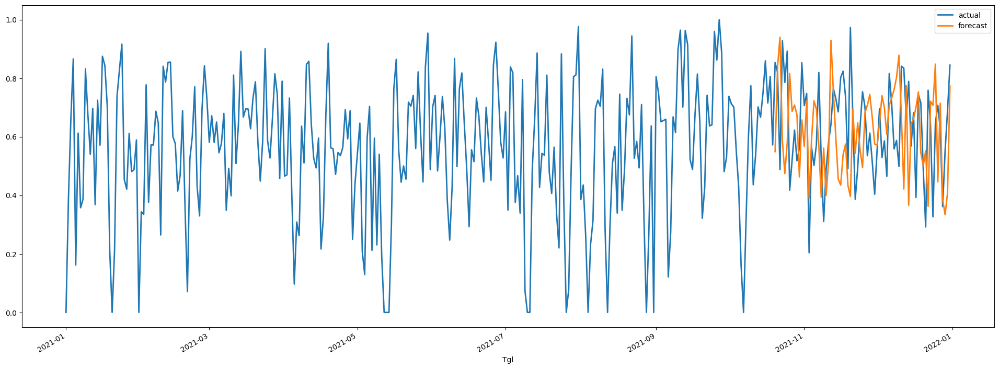

In [ ]:
# prediction for PR01
mpl.style.use('default')
pred = nbeats_PR01.predict(n=73, series=train_PR01)

pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_run_PR01_nbeats.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(24,8))
series_PR01_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_PR01_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_PR01_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_PR01_scaled, pred)))
print("SMAPE = {:.3f}".format(smape(series_PR01_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_PR01_scaled, pred)))

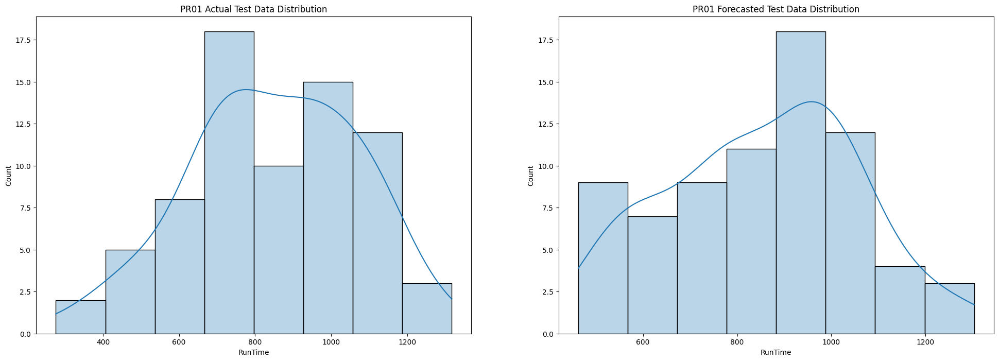

In [ ]:
# normal distribution for PR01
pred_PR01 = pd.read_csv('/content/pred_run_PR01_nbeats.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(PR01.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('PR01 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_PR01['RunTime'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('PR01 Forecasted Test Data Distribution')

plt.show()

Predicting: 8it [00:00, ?it/s]

RMSE = 0.204
MAE = 0.173
MSE = 0.042
SMAPE = 38.77
OPE = 1.986%


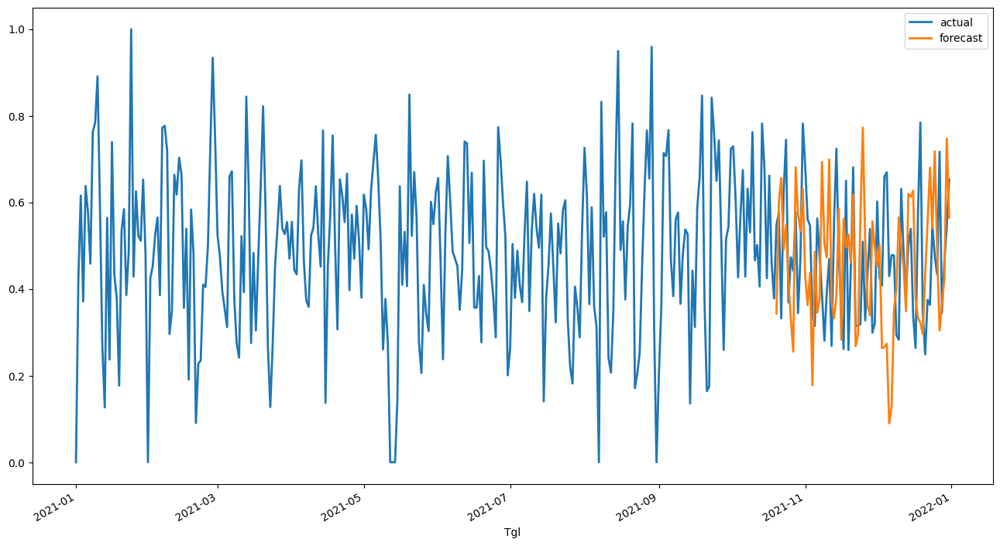

In [ ]:
# prediction for PR02
pred = nbeats_PR02.predict(n=73, series=train_PR02)

pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_run_PR02_nbeats.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_PR02_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_PR02_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_PR02_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_PR02_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_PR02_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_PR02_scaled, pred)))

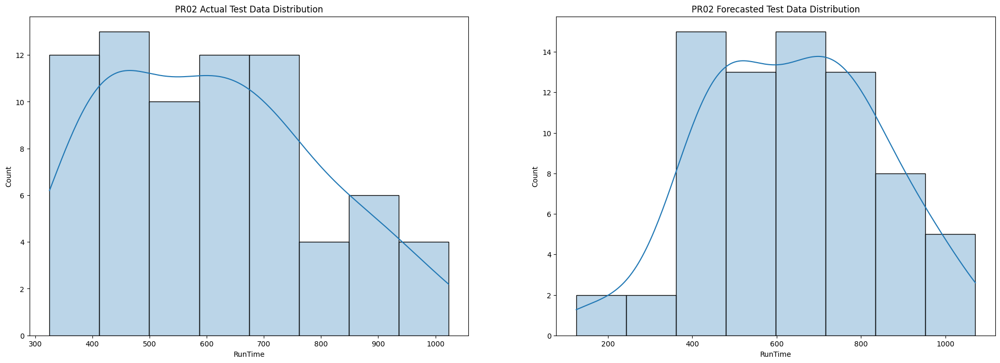

In [ ]:
# normal distribution for PR02

pred_PR02 = pd.read_csv('/content/pred_run_PR02_nbeats.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(PR02.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('PR02 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_PR02['RunTime'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('PR02 Forecasted Test Data Distribution')

plt.show()

Predicting: 9it [00:00, ?it/s]

RMSE = 0.260
MAE = 0.205
MSE = 0.068
SMAPE = 37.32
OPE = 14.920%


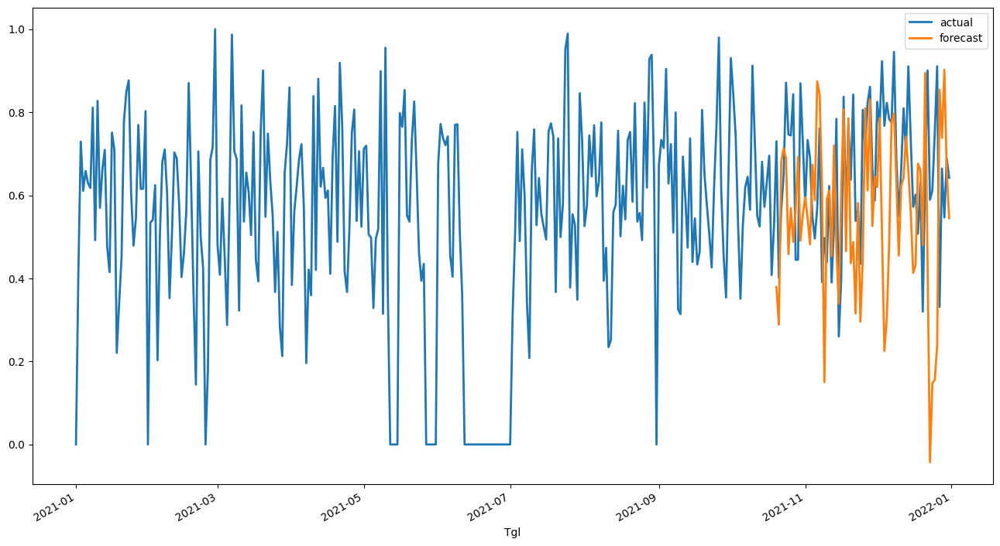

In [ ]:
# prediction for PR03
pred = nbeats_PR03.predict(n=73, series=train_PR03)
pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_run_PR03_nbeats.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_PR03_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_PR03_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_PR03_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_PR03_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_PR03_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_PR03_scaled, pred)))

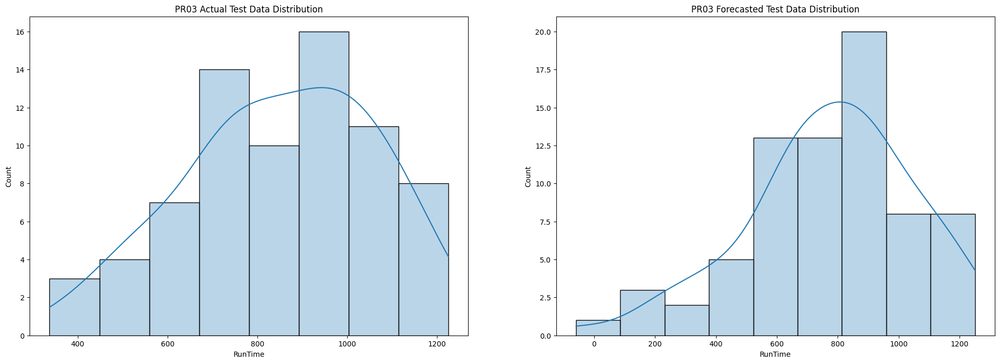

In [ ]:
# normal distribution for PR03

pred_PR03 = pd.read_csv('/content/pred_run_PR03_nbeats.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(PR03.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('PR03 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_PR03['RunTime'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('PR03 Forecasted Test Data Distribution')

plt.show()

Predicting: 9it [00:00, ?it/s]

RMSE = 0.155
MAE = 0.119
MSE = 0.024
SMAPE = 16.31
OPE = 0.820%


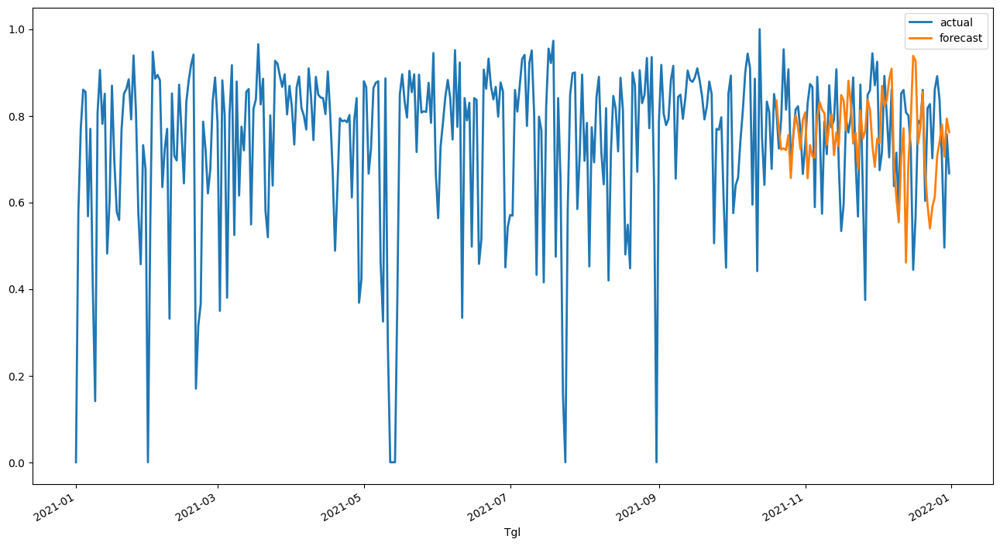

In [ ]:
# prediction for PR05
pred = nbeats_PR05.predict(n=73, series=train_PR05)
pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_run_PR05_nbeats.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_PR05_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_PR05_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_PR05_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_PR05_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_PR05_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_PR05_scaled, pred)))

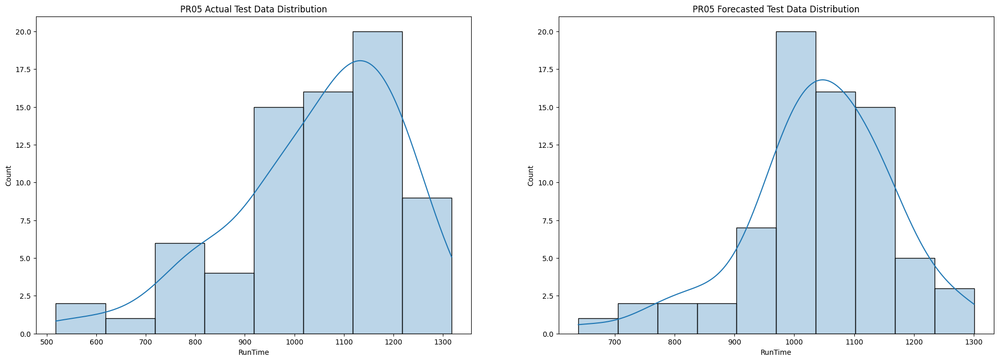

In [ ]:
# normal distribution for PR05

pred_PR05 = pd.read_csv('/content/pred_run_PR05_nbeats.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(PR05.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('PR05 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_PR05['RunTime'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('PR05 Forecasted Test Data Distribution')

plt.show()

Predicting: 8it [00:00, ?it/s]

RMSE = 0.308
MAE = 0.249
MSE = 0.095
SMAPE = 62.66
OPE = 34.978%


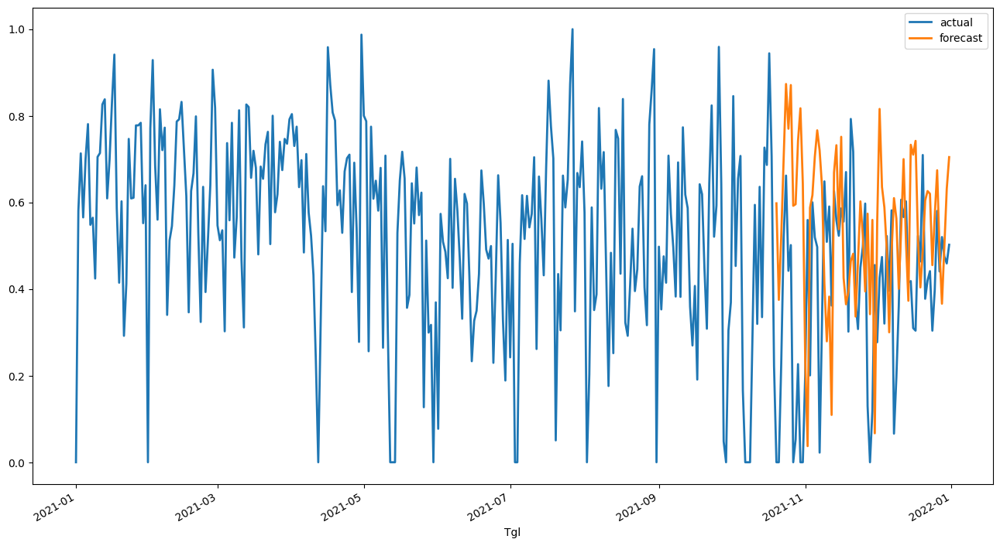

In [ ]:
# prediction for PR06
pred = nbeats_PR06.predict(n=73, series=train_PR06)
pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_run_PR06_nbeats.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_PR06_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_PR06_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_PR06_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_PR06_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_PR06_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_PR06_scaled, pred)))

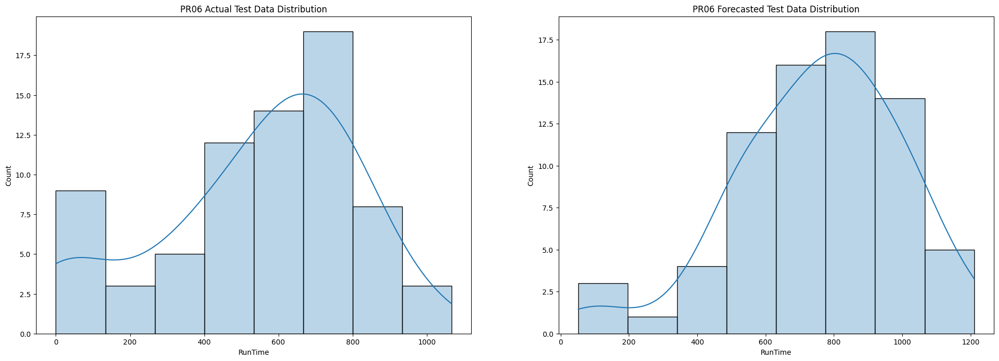

In [ ]:
# normal distribution for PR06

pred_PR06 = pd.read_csv('/content/pred_run_PR06_nbeats.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(PR06.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('PR06 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_PR06['RunTime'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('PR06 Forecasted Test Data Distribution')

plt.show()

Predicting: 9it [00:00, ?it/s]

RMSE = 0.253
MAE = 0.196
MSE = 0.064
SMAPE = 33.92
OPE = 21.154%


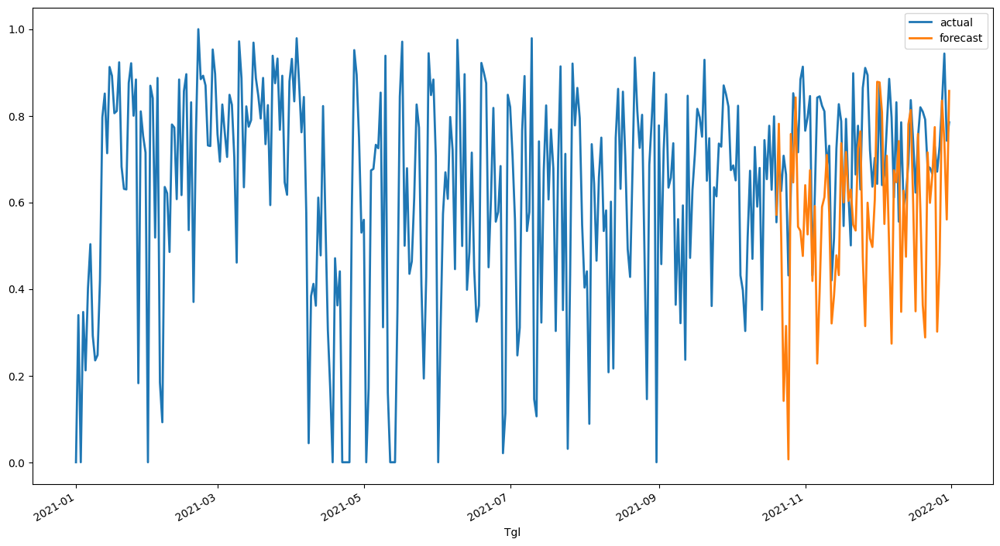

In [ ]:
# prediction for PR07
pred = nbeats_PR07.predict(n=73, series=train_PR07)
pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_run_PR07_nbeats.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_PR07_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_PR07_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_PR07_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_PR07_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_PR07_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_PR07_scaled, pred)))

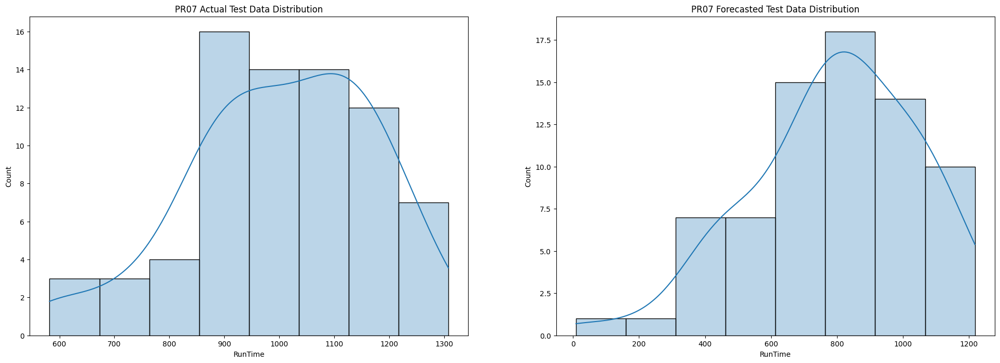

In [ ]:
# normal distribution for PR07

pred_PR07 = pd.read_csv('/content/pred_run_PR07_nbeats.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(PR07.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('PR07 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_PR07['RunTime'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('PR07 Forecasted Test Data Distribution')

plt.show()

## **Forecasting Daily Speed Data with N-Beats**


### **Forecasting Daily Speed by Material with N-Beats**

In [ ]:
idx = pd.date_range('2021-01-01', '2021-12-31')
pet = run[run['FILM']=='PET'].pivot_table(values='Speed', index='Tgl', fill_value=0, aggfunc=np.mean)
pet = pet.reindex(idx, fill_value=0).reset_index()
nyl = run[run['FILM']=='NYL'].pivot_table(values='Speed', index='Tgl', fill_value=0, aggfunc=np.mean)
nyl = nyl.reindex(idx, fill_value=0).reset_index()
opp = run[run['FILM']=='OPP'].pivot_table(values='Speed', index='Tgl', fill_value=0, aggfunc=np.mean)
opp = opp.reindex(idx, fill_value=0).reset_index()

In [ ]:
# defining time series by material
pet_series = TimeSeries.from_dataframe(pet, 'index','Speed')
nyl_series = TimeSeries.from_dataframe(nyl, 'index','Speed')
opp_series = TimeSeries.from_dataframe(opp, 'index','Speed')

In [ ]:
# check seasonality for PET
is_seasonal, pet_periodicity = check_seasonality(pet_series, max_lag=240)
dict_seas ={
    "PET is seasonal?":is_seasonal,
    "pet_periodicity (days)":f'{pet_periodicity:.1f}', 
    "pet_periodicity (~months)": f'{pet_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

PET is seasonal? : True
pet_periodicity (days) : 7.0
pet_periodicity (~months) : 0.2


In [ ]:
# check seasonality for NYL
is_seasonal, nyl_periodicity = check_seasonality(nyl_series, max_lag=240)
dict_seas ={
    "NYL is seasonal?":is_seasonal,
    "nyl_periodicity (days)":f'{nyl_periodicity:.1f}', 
    "nyl_periodicity (~months)": f'{nyl_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

NYL is seasonal? : True
nyl_periodicity (days) : 6.0
nyl_periodicity (~months) : 0.2


In [ ]:
is_seasonal, opp_periodicity = check_seasonality(opp_series, max_lag=240)
dict_seas ={
    "OPP is seasonal?":is_seasonal,
    "opp_periodicity (days)":f'{opp_periodicity:.1f}', 
    "opp_periodicity (~months)": f'{opp_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

OPP is seasonal? : True
opp_periodicity (days) : 7.0
opp_periodicity (~months) : 0.2


In [ ]:
# data normalization
scaler= Scaler()
series_pet_scaled = scaler.fit_transform(pet_series)
series_nyl_scaled = scaler.fit_transform(nyl_series)
series_opp_scaled = scaler.fit_transform(opp_series)

In [ ]:
# train test split
train_pet, val_pet = series_pet_scaled[:-73], series_pet_scaled[-73:]
pet.iloc[-73:].to_csv('/content/speed_pet.csv')
train_nyl, val_nyl = series_nyl_scaled[:-73], series_nyl_scaled[-73:]
nyl.iloc[-73:].to_csv('/content/speed_nyl.csv')
train_opp, val_opp = series_opp_scaled[:-73], series_opp_scaled[-73:]
opp.iloc[-73:].to_csv('/content/speed_opp.csv')

In [ ]:
# defining and training the model for PET
nbeats_pet= NBEATSModel(
    input_chunk_length=pet_periodicity, 
    output_chunk_length=30, 
    n_epochs=300, 
    optimizer_kwargs={"lr": 1e-3},
    random_state=42)
nbeats_pet.fit(train_pet)

[2022-03-28 08:59:02,287] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 256 samples.
[2022-03-28 08:59:02,287] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 256 samples.
[2022-03-28 08:59:02,461] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
[2022-03-28 08:59:02,461] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs

  | Name      | Type       | Params
-----------------------------------------
0 | criterion | MSELoss    | 0     
1 | stacks    | ModuleList | 6.1 M 
-----------------------------------------
6.1 M     Trainable params
1.3 K     Non-trainable params
6.1 M     Total params
48.532    Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

In [ ]:
# defining and training the model for NYL
nbeats_nyl= NBEATSModel(
    input_chunk_length=nyl_periodicity, 
    output_chunk_length=30, 
    n_epochs=300, 
    optimizer_kwargs={"lr": 1e-3},
    random_state=42)
nbeats_nyl.fit(train_nyl)

[2022-03-28 08:37:47,234] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 257 samples.
[2022-03-28 08:37:47,234] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 257 samples.
[2022-03-28 08:37:47,335] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
[2022-03-28 08:37:47,335] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs

  | Name      | Type       | Params
-----------------------------------------
0 | criterion | MSELoss    | 0     
1 | stacks    | ModuleList | 6.1 M 
-----------------------------------------
6.1 M     Trainable params
1.3 K     Non-trainable params
6.1 M     Total params
48.469    Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

In [ ]:
# defining and training the model for OPP
nbeats_opp= NBEATSModel(
    input_chunk_length=opp_periodicity, 
    output_chunk_length=30, 
    n_epochs=300, 
    optimizer_kwargs={"lr": 1e-3},
    random_state=42)
nbeats_opp.fit(train_opp)

[2022-03-28 08:46:09,108] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 256 samples.
[2022-03-28 08:46:09,108] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 256 samples.
[2022-03-28 08:46:09,209] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
[2022-03-28 08:46:09,209] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs

  | Name      | Type       | Params
-----------------------------------------
0 | criterion | MSELoss    | 0     
1 | stacks    | ModuleList | 6.1 M 
-----------------------------------------
6.1 M     Trainable params
1.3 K     Non-trainable params
6.1 M     Total params
48.532    Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

Predicting: 8it [00:00, ?it/s]

RMSE = 0.157
MAE = 0.117
MSE = 0.025
SMAPE = 17.509
OPE = 10.397%


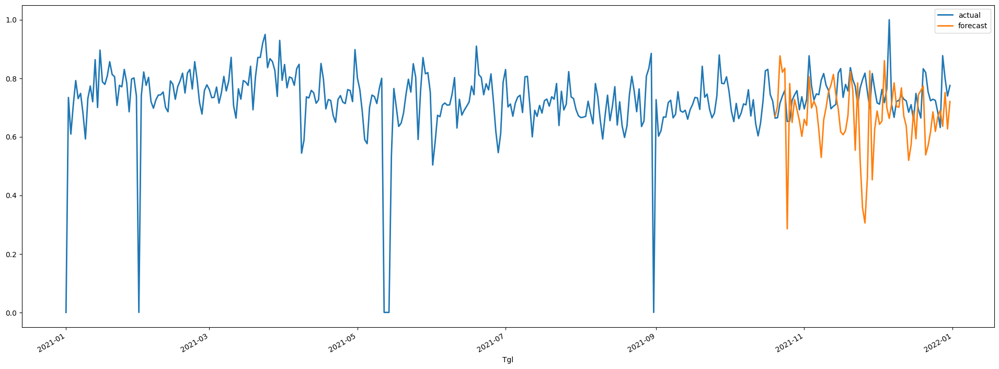

In [ ]:
# prediction for PET
mpl.style.use('default')
pred = nbeats_pet.predict(n=73, series=train_pet)

pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_speed_pet_nbeats.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(24,8))
series_pet_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_pet_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_pet_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_pet_scaled, pred)))
print("SMAPE = {:.3f}".format(smape(series_pet_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_pet_scaled, pred)))

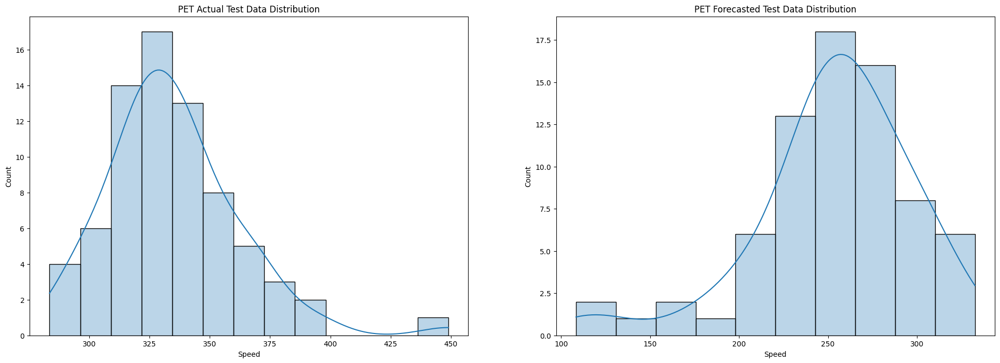

In [ ]:
# normal distribution for PET
pred_pet = pd.read_csv('/content/pred_speed_pet_nbeats.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(pet.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('PET Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_pet['Speed'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('PET Forecasted Test Data Distribution')

plt.show()

Predicting: 9it [00:00, ?it/s]

RMSE = 0.277
MAE = 0.215
MSE = 0.077
SMAPE = 41.76
OPE = 13.402%


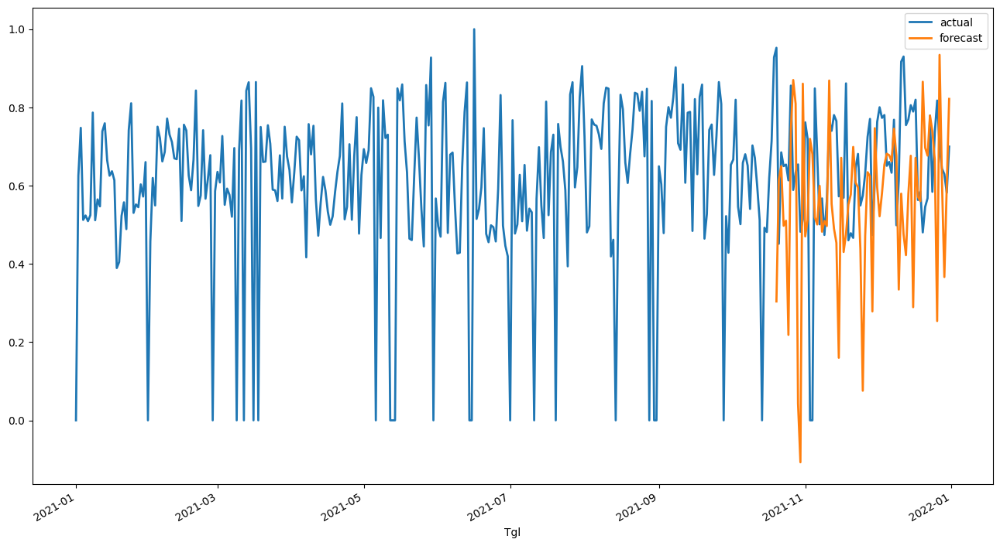

In [ ]:
# prediction for NYL
pred = nbeats_nyl.predict(n=73, series=train_nyl)

pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_speed_nyl_nbeats.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_nyl_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_nyl_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_nyl_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_nyl_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_nyl_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_nyl_scaled, pred)))

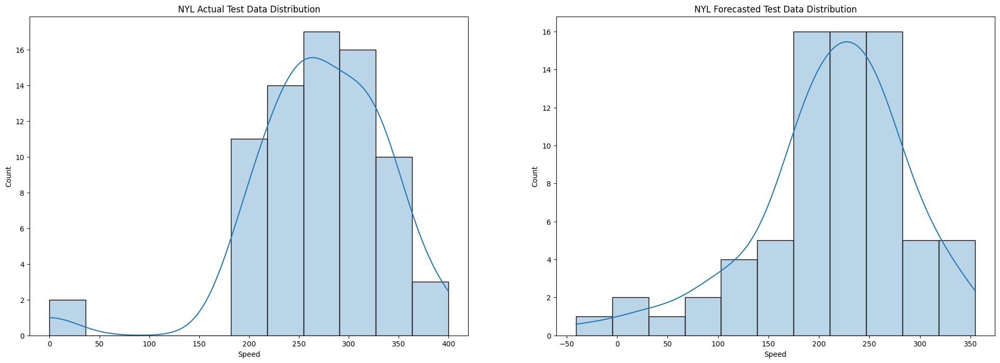

In [ ]:
# normal distribution for NYL
mpl.style.use('default')

pred_nyl = pd.read_csv('/content/pred_speed_nyl_nbeats.csv')
f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(nyl.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('NYL Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_nyl['Speed'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('NYL Forecasted Test Data Distribution')

plt.show()

Predicting: 8it [00:00, ?it/s]

RMSE = 0.269
MAE = 0.207
MSE = 0.073
SMAPE = 35.41
OPE = 11.424%


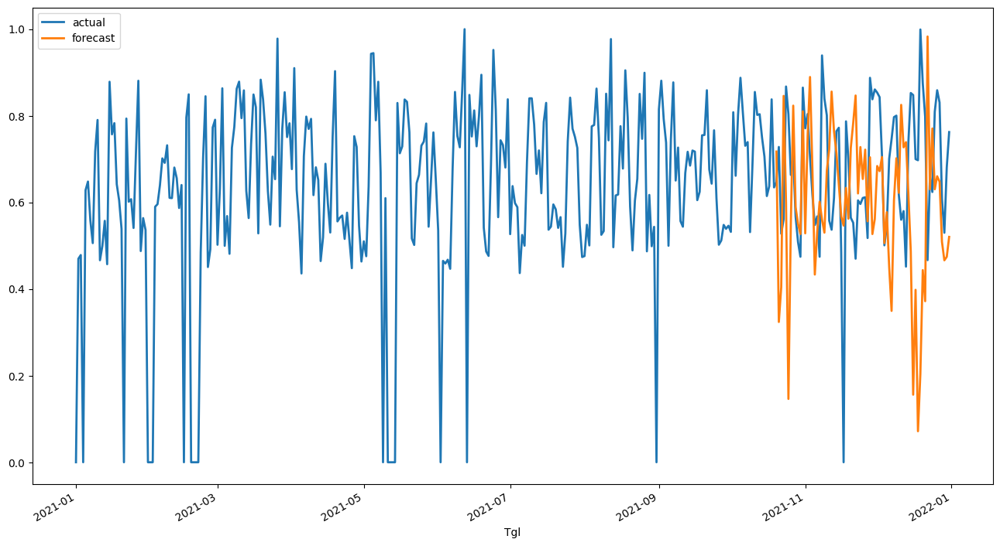

In [ ]:
# prediction for OPP
pred = nbeats_opp.predict(n=73, series=train_opp)
pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_speed_opp_nbeats.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_opp_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_opp_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_opp_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_opp_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_opp_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_opp_scaled, pred)))

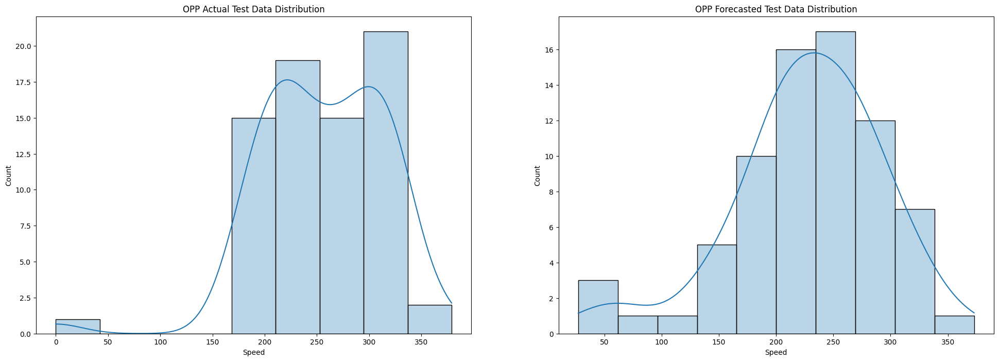

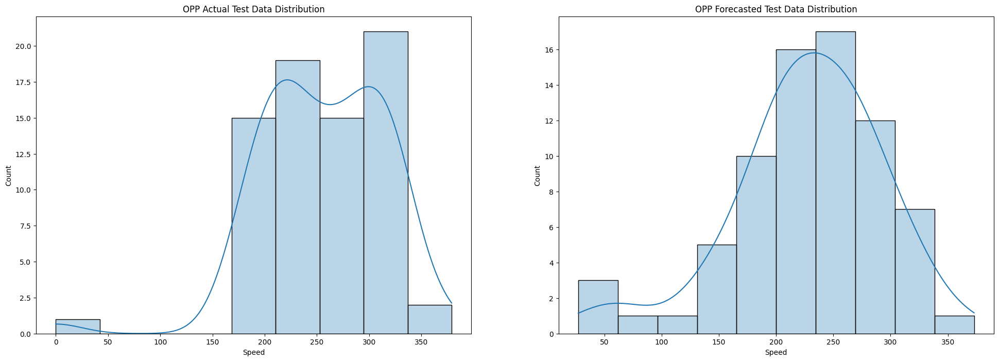

In [ ]:
# normal distribution for OPP

pred_opp = pd.read_csv('/content/pred_speed_opp_nbeats.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(opp.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('OPP Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_opp['Speed'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('OPP Forecasted Test Data Distribution')

plt.show()

### **Forecasting Daily Speed by Machine with N-Beats**

In [ ]:
PR01 = run[run['KdMesin']=='PR01'].pivot_table(values='Speed', index='Tgl', fill_value=0, aggfunc=np.mean)
PR01 = PR01.reindex(idx, fill_value=0).reset_index()
PR02 = run[run['KdMesin']=='PR02'].pivot_table(values='Speed', index='Tgl', fill_value=0, aggfunc=np.mean)
PR02 = PR02.reindex(idx, fill_value=0).reset_index()
PR03 = run[run['KdMesin']=='PR03'].pivot_table(values='Speed', index='Tgl', fill_value=0, aggfunc=np.mean)
PR03 = PR03.reindex(idx, fill_value=0).reset_index()
PR05 = run[run['KdMesin']=='PR05'].pivot_table(values='Speed', index='Tgl', fill_value=0, aggfunc=np.mean)
PR05 = PR05.reindex(idx, fill_value=0).reset_index()
PR06 = run[run['KdMesin']=='PR06'].pivot_table(values='Speed', index='Tgl', fill_value=0, aggfunc=np.mean)
PR06 = PR06.reindex(idx, fill_value=0).reset_index()
PR07 = run[run['KdMesin']=='PR07'].pivot_table(values='Speed', index='Tgl', fill_value=0, aggfunc=np.mean)
PR07 = PR07.reindex(idx, fill_value=0).reset_index()

In [ ]:
# defining time series by material
PR01_series = TimeSeries.from_dataframe(PR01, 'index','Speed')
PR02_series = TimeSeries.from_dataframe(PR02, 'index','Speed')
PR03_series = TimeSeries.from_dataframe(PR03, 'index','Speed')
PR05_series = TimeSeries.from_dataframe(PR05, 'index','Speed')
PR06_series = TimeSeries.from_dataframe(PR06, 'index','Speed')
PR07_series = TimeSeries.from_dataframe(PR07, 'index','Speed')

In [ ]:
# check seasonality for PR01
is_seasonal, pr01_periodicity = check_seasonality(PR01_series, max_lag=240)
dict_seas ={
    "PR01 is seasonal?":is_seasonal,
    "pr01_periodicity (days)":f'{pr01_periodicity:.1f}', 
    "pr01_periodicity (~months)": f'{pr01_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

PR01 is seasonal? : True
pr01_periodicity (days) : 5.0
pr01_periodicity (~months) : 0.2


In [ ]:
# check seasonality for PR02
is_seasonal, pr02_periodicity = check_seasonality(PR02_series, max_lag=240)
dict_seas ={
    "PR02 is seasonal?":is_seasonal,
    "pr02_periodicity (days)":f'{pr02_periodicity:.1f}', 
    "pr02_periodicity (~months)": f'{pr02_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

PR02 is seasonal? : True
pr02_periodicity (days) : 4.0
pr02_periodicity (~months) : 0.1


In [ ]:
# check seasonality for PR03
is_seasonal, pr03_periodicity = check_seasonality(PR03_series, max_lag=240)
dict_seas ={
    "PR03 is seasonal?":is_seasonal,
    "pr03_periodicity (days)":f'{pr03_periodicity:.1f}', 
    "pr03_periodicity (~months)": f'{pr03_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

PR03 is seasonal? : True
pr03_periodicity (days) : 16.0
pr03_periodicity (~months) : 0.5


In [ ]:
# check seasonality for PR05
is_seasonal, pr05_periodicity = check_seasonality(PR05_series, max_lag=240)
dict_seas ={
    "PR05 is seasonal?":is_seasonal,
    "pr05_periodicity (days)":f'{pr05_periodicity:.1f}', 
    "pr05_periodicity (~months)": f'{pr05_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

PR05 is seasonal? : True
pr05_periodicity (days) : 6.0
pr05_periodicity (~months) : 0.2


In [ ]:
# check seasonality for PR06
is_seasonal, pr06_periodicity = check_seasonality(PR06_series, max_lag=240)
dict_seas ={
    "PR06 is seasonal?":is_seasonal,
    "pr06_periodicity (days)":f'{pr06_periodicity:.1f}', 
    "pr06_periodicity (~months)": f'{pr06_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

PR06 is seasonal? : True
pr06_periodicity (days) : 11.0
pr06_periodicity (~months) : 0.4


In [ ]:
# check seasonality for PR07
is_seasonal, pr07_periodicity = check_seasonality(PR07_series, max_lag=240)
dict_seas ={
    "PR07 is seasonal?":is_seasonal,
    "pr07_periodicity (days)":f'{pr07_periodicity:.1f}', 
    "pr07_periodicity (~months)": f'{pr07_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

PR07 is seasonal? : True
pr07_periodicity (days) : 7.0
pr07_periodicity (~months) : 0.2


In [ ]:
# data normalization
scaler= Scaler()
series_PR01_scaled = scaler.fit_transform(PR01_series)
series_PR02_scaled = scaler.fit_transform(PR02_series)
series_PR03_scaled = scaler.fit_transform(PR03_series)
series_PR05_scaled = scaler.fit_transform(PR05_series)
series_PR06_scaled = scaler.fit_transform(PR06_series)
series_PR07_scaled = scaler.fit_transform(PR07_series)

In [ ]:
# train test split
train_PR01, val_PR01 = series_PR01_scaled[:-73], series_PR01_scaled[-73:]
PR01.iloc[-73:].to_csv('/content/speed_PR01.csv')
train_PR02, val_PR02 = series_PR02_scaled[:-73], series_PR02_scaled[-73:]
PR02.iloc[-73:].to_csv('/content/speed_PR02.csv')
train_PR03, val_PR03 = series_PR03_scaled[:-73], series_PR03_scaled[-73:]
PR03.iloc[-73:].to_csv('/content/speed_PR03.csv')
train_PR05, val_PR05 = series_PR05_scaled[:-73], series_PR05_scaled[-73:]
PR05.iloc[-73:].to_csv('/content/speed_PR05.csv')
train_PR06, val_PR06 = series_PR06_scaled[:-73], series_PR06_scaled[-73:]
PR06.iloc[-73:].to_csv('/content/speed_PR06.csv')
train_PR07, val_PR07 = series_PR07_scaled[:-73], series_PR07_scaled[-73:]
PR07.iloc[-73:].to_csv('/content/speed_PR07.csv')

In [ ]:
# defining and training the model for PR01
nbeats_PR01= NBEATSModel(
    input_chunk_length=pr01_periodicity, 
    output_chunk_length=30, 
    n_epochs=300, 
    optimizer_kwargs={"lr": 1e-3},
    random_state=42)
nbeats_PR01.fit(train_PR01)

[2022-03-29 02:37:59,519] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 258 samples.
[2022-03-29 02:37:59,519] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 258 samples.
[2022-03-29 02:37:59,660] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
[2022-03-29 02:37:59,660] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs

  | Name      | Type       | Params
-----------------------------------------
0 | criterion | MSELoss    | 0     
1 | stacks    | ModuleList | 6.1 M 
-----------------------------------------
6.0 M     Trainable params
1.3 K     Non-trainable params
6.1 M     Total params
48.406    Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

In [ ]:
# defining and training the model for PR02
nbeats_PR02= NBEATSModel(
    input_chunk_length=pr02_periodicity, 
    output_chunk_length=30, 
    n_epochs=300, 
    optimizer_kwargs={"lr": 1e-3},
    random_state=42)
nbeats_PR02.fit(train_PR02)

[2022-03-29 02:50:56,570] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 259 samples.
[2022-03-29 02:50:56,570] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 259 samples.
[2022-03-29 02:50:56,665] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
[2022-03-29 02:50:56,665] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs

  | Name      | Type       | Params
-----------------------------------------
0 | criterion | MSELoss    | 0     
1 | stacks    | ModuleList | 6.0 M 
-----------------------------------------
6.0 M     Trainable params
1.3 K     Non-trainable params
6.0 M     Total params
48.343    Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

In [ ]:
# defining and training the model for PR03
nbeats_PR03= NBEATSModel(
    input_chunk_length=pr03_periodicity, 
    output_chunk_length=30, 
    n_epochs=300, 
    optimizer_kwargs={"lr": 1e-3},
    random_state=42)
nbeats_PR03.fit(train_PR03)

[2022-03-29 03:00:56,965] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 247 samples.
[2022-03-29 03:00:56,965] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 247 samples.
[2022-03-29 03:00:57,058] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
[2022-03-29 03:00:57,058] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs

  | Name      | Type       | Params
-----------------------------------------
0 | criterion | MSELoss    | 0     
1 | stacks    | ModuleList | 6.1 M 
-----------------------------------------
6.1 M     Trainable params
1.4 K     Non-trainable params
6.1 M     Total params
49.098    Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

In [ ]:
# defining and training the model for PR05
nbeats_PR05= NBEATSModel(
    input_chunk_length=pr05_periodicity, 
    output_chunk_length=30, 
    n_epochs=300, 
    optimizer_kwargs={"lr": 1e-3},
    random_state=42)
nbeats_PR05.fit(train_PR05)

[2022-03-29 03:09:50,581] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 257 samples.
[2022-03-29 03:09:50,581] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 257 samples.
[2022-03-29 03:09:50,677] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
[2022-03-29 03:09:50,677] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs

  | Name      | Type       | Params
-----------------------------------------
0 | criterion | MSELoss    | 0     
1 | stacks    | ModuleList | 6.1 M 
-----------------------------------------
6.1 M     Trainable params
1.3 K     Non-trainable params
6.1 M     Total params
48.469    Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

In [ ]:
# defining and training the model for PR06
nbeats_PR06= NBEATSModel(
    input_chunk_length=pr06_periodicity, 
    output_chunk_length=30, 
    n_epochs=300, 
    optimizer_kwargs={"lr": 1e-3},
    random_state=42)
nbeats_PR06.fit(train_PR06)

[2022-03-29 03:19:32,697] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 252 samples.
[2022-03-29 03:19:32,697] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 252 samples.
[2022-03-29 03:19:32,791] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
[2022-03-29 03:19:32,791] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs

  | Name      | Type       | Params
-----------------------------------------
0 | criterion | MSELoss    | 0     
1 | stacks    | ModuleList | 6.1 M 
-----------------------------------------
6.1 M     Trainable params
1.4 K     Non-trainable params
6.1 M     Total params
48.783    Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

In [ ]:
# defining and training the model for PR07
nbeats_PR07= NBEATSModel(
    input_chunk_length=pr07_periodicity, 
    output_chunk_length=30, 
    n_epochs=300, 
    optimizer_kwargs={"lr": 1e-3},
    random_state=42)
nbeats_PR07.fit(train_PR07)

[2022-03-29 03:28:21,504] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 256 samples.
[2022-03-29 03:28:21,504] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 256 samples.
[2022-03-29 03:28:21,599] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
[2022-03-29 03:28:21,599] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs

  | Name      | Type       | Params
-----------------------------------------
0 | criterion | MSELoss    | 0     
1 | stacks    | ModuleList | 6.1 M 
-----------------------------------------
6.1 M     Trainable params
1.3 K     Non-trainable params
6.1 M     Total params
48.532    Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

Predicting: 9it [00:00, ?it/s]

RMSE = 0.120
MAE = 0.104
MSE = 0.014
SMAPE = 13.133
OPE = 11.752%


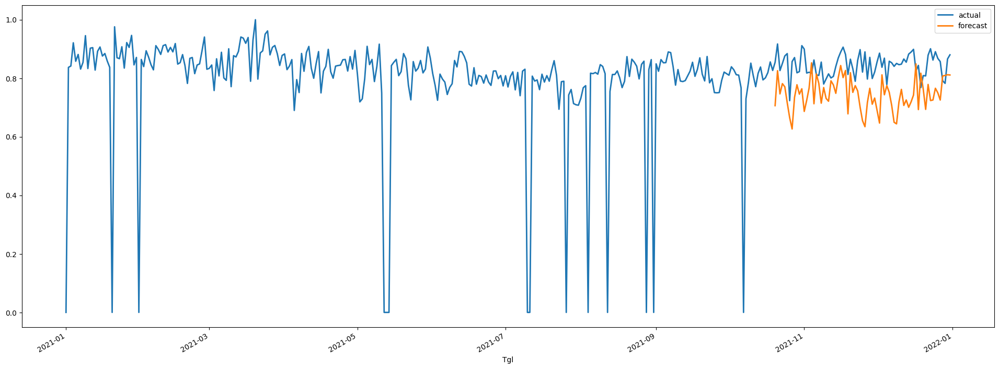

In [ ]:
# prediction for PR01
mpl.style.use('default')
pred = nbeats_PR01.predict(n=73, series=train_PR01)

pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_speed_PR01_nbeats.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(24,8))
series_PR01_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_PR01_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_PR01_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_PR01_scaled, pred)))
print("SMAPE = {:.3f}".format(smape(series_PR01_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_PR01_scaled, pred)))

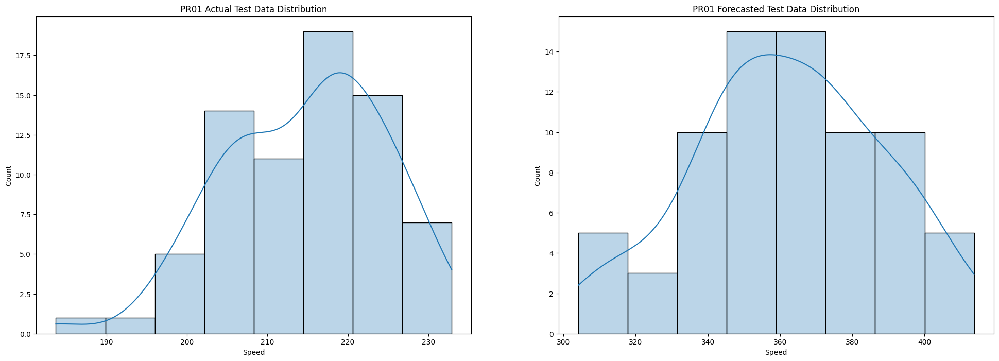

In [ ]:
# normal distribution for PR01
pred_PR01 = pd.read_csv('/content/pred_speed_PR01_nbeats.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(PR01.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('PR01 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_PR01['Speed'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('PR01 Forecasted Test Data Distribution')

plt.show()

Predicting: 9it [00:00, ?it/s]

RMSE = 0.056
MAE = 0.045
MSE = 0.003
SMAPE = 5.54
OPE = 1.470%


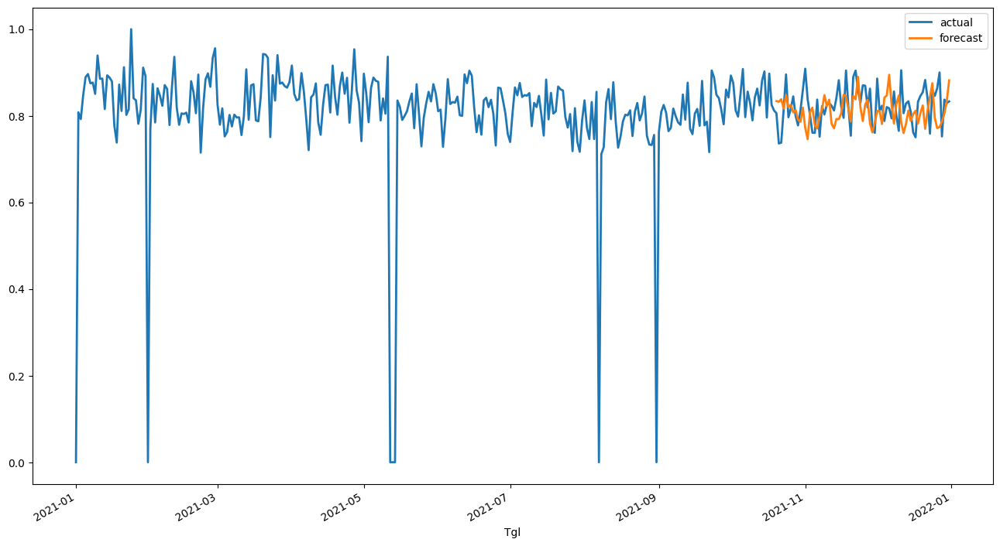

In [ ]:
# prediction for PR02
pred = nbeats_PR02.predict(n=73, series=train_PR02)

pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_speed_PR02_nbeats.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_PR02_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_PR02_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_PR02_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_PR02_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_PR02_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_PR02_scaled, pred)))

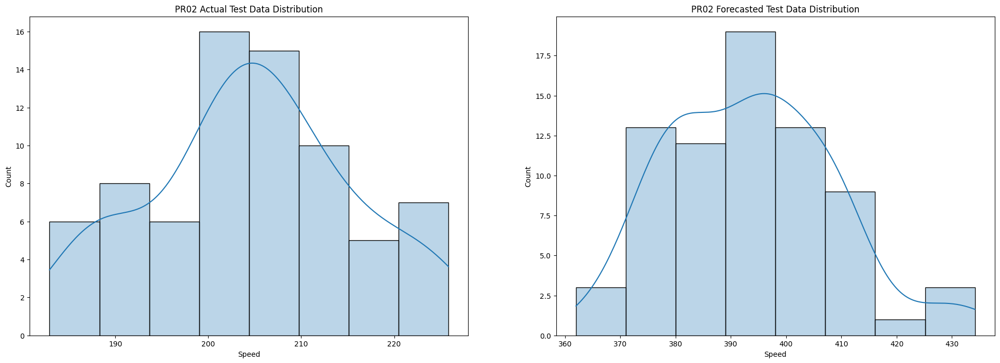

In [ ]:
# normal distribution for PR02

pred_PR02 = pd.read_csv('/content/pred_speed_PR02_nbeats.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(PR02.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('PR02 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_PR02['Speed'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('PR02 Forecasted Test Data Distribution')

plt.show()

Predicting: 8it [00:00, ?it/s]

RMSE = 0.418
MAE = 0.338
MSE = 0.175
SMAPE = 57.06
OPE = 35.326%


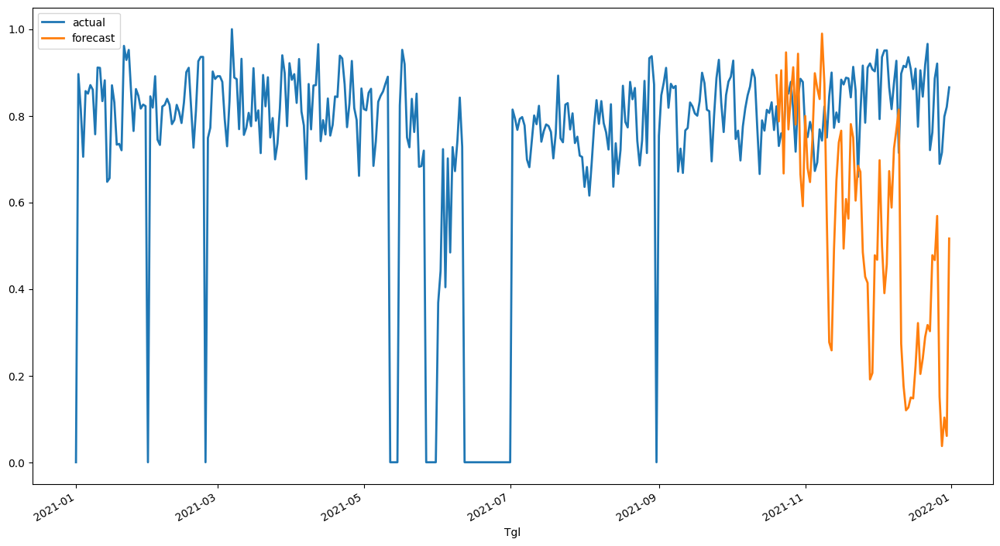

In [ ]:
# prediction for PR03
pred = nbeats_PR03.predict(n=73, series=train_PR03)
pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_speed_PR03_nbeats.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_PR03_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_PR03_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_PR03_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_PR03_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_PR03_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_PR03_scaled, pred)))

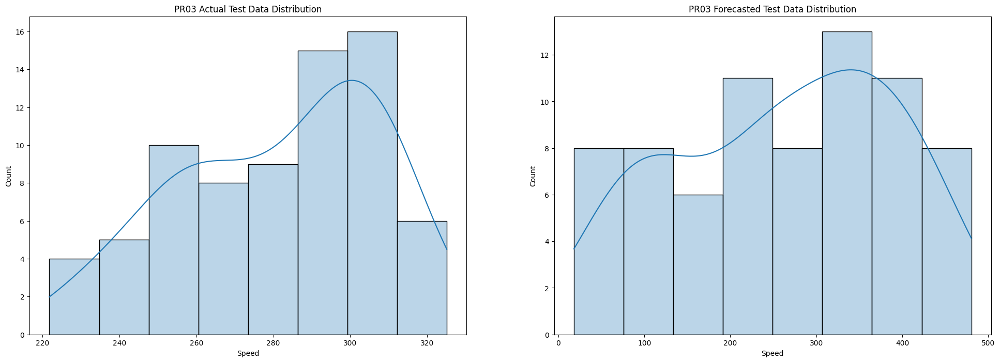

In [ ]:
# normal distribution for PR03

pred_PR03 = pd.read_csv('/content/pred_speed_PR03_nbeats.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(PR03.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('PR03 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_PR03['Speed'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('PR03 Forecasted Test Data Distribution')

plt.show()

Predicting: 9it [00:00, ?it/s]

RMSE = 0.055
MAE = 0.046
MSE = 0.003
SMAPE = 5.56
OPE = 0.491%


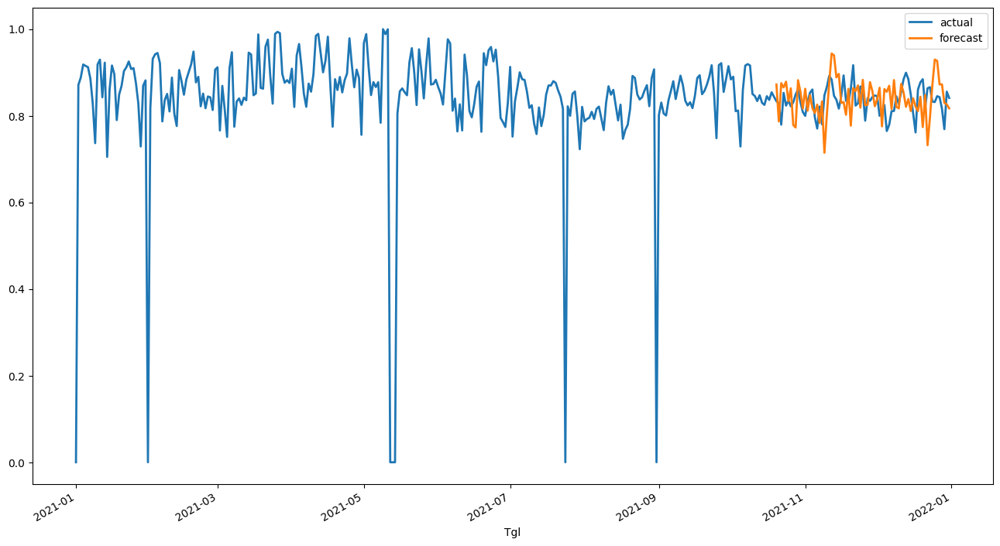

In [ ]:
# prediction for PR05
pred = nbeats_PR05.predict(n=73, series=train_PR05)
pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_speed_PR05_nbeats.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_PR05_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_PR05_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_PR05_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_PR05_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_PR05_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_PR05_scaled, pred)))

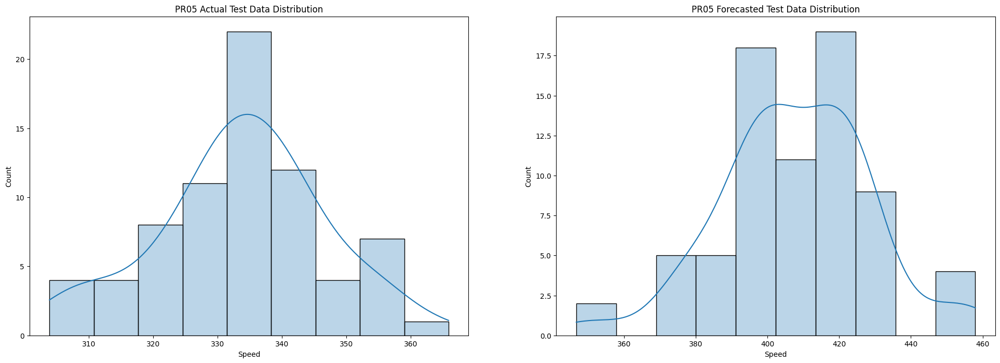

In [ ]:
# normal distribution for PR05

pred_PR05 = pd.read_csv('/content/pred_speed_PR05_nbeats.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(PR05.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('PR05 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_PR05['Speed'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('PR05 Forecasted Test Data Distribution')

plt.show()

Predicting: 8it [00:00, ?it/s]

RMSE = 0.281
MAE = 0.204
MSE = 0.079
SMAPE = 39.20
OPE = 5.547%


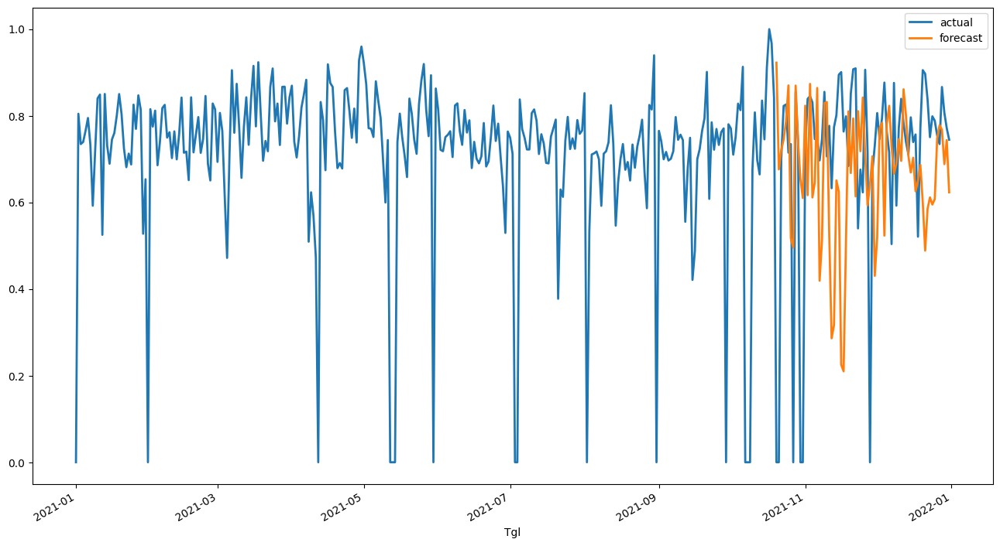

In [ ]:
# prediction for PR06
pred = nbeats_PR06.predict(n=73, series=train_PR06)
pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_speed_PR06_nbeats.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_PR06_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_PR06_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_PR06_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_PR06_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_PR06_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_PR06_scaled, pred)))

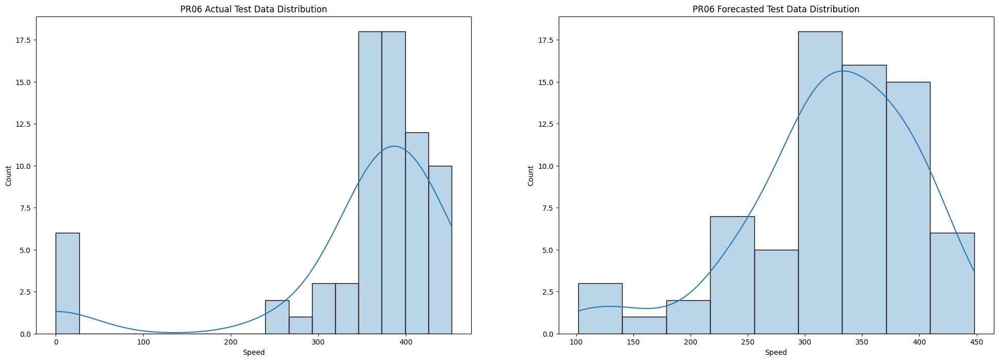

In [ ]:
# normal distribution for PR06

pred_PR06 = pd.read_csv('/content/pred_speed_PR06_nbeats.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(PR06.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('PR06 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_PR06['Speed'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('PR06 Forecasted Test Data Distribution')

plt.show()

Predicting: 8it [00:00, ?it/s]

RMSE = 0.088
MAE = 0.073
MSE = 0.008
SMAPE = 8.33
OPE = 2.106%


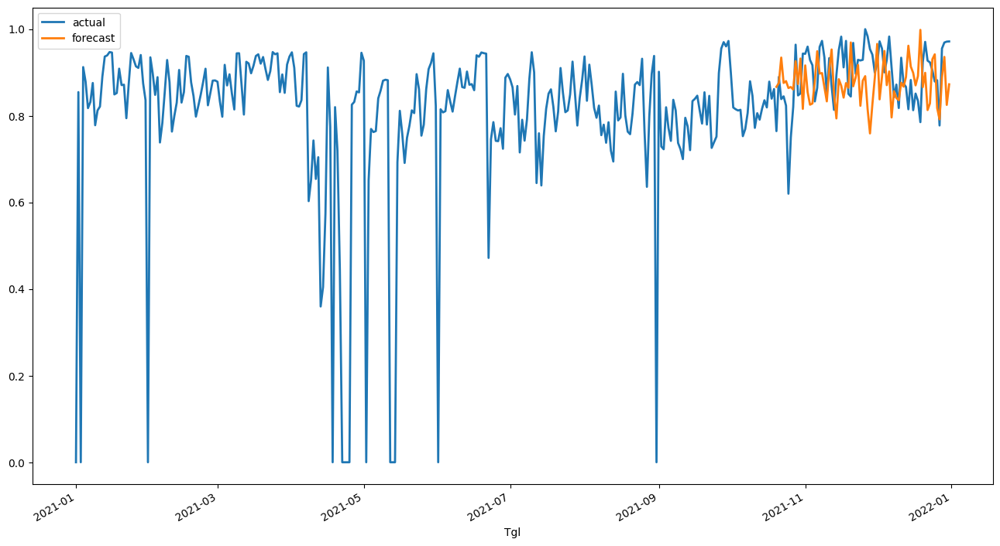

In [ ]:
# prediction for PR07
pred = nbeats_PR07.predict(n=73, series=train_PR07)
pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_speed_PR07_nbeats.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_PR07_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_PR07_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_PR07_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_PR07_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_PR07_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_PR07_scaled, pred)))

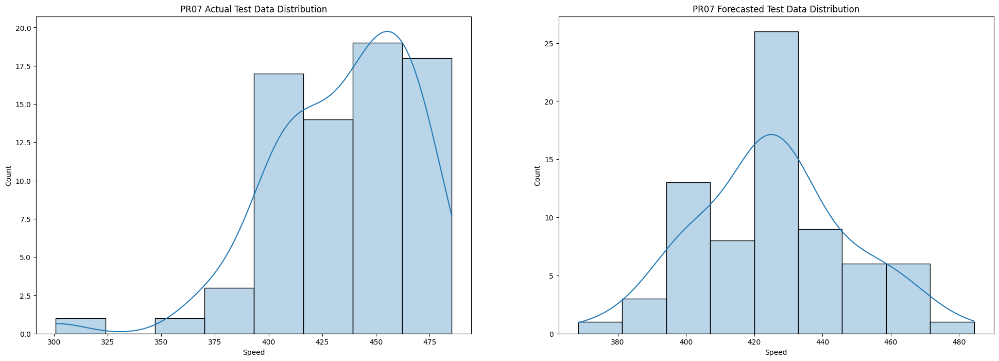

In [ ]:
# normal distribution for PR07

pred_PR07 = pd.read_csv('/content/pred_speed_PR07_nbeats.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(PR07.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('PR07 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_PR07['Speed'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('PR07 Forecasted Test Data Distribution')

plt.show()

## **Forecasting Daily Output Data with N-Beats**

### **Forecasting Daily Output by Material with N-Beats**

In [ ]:
op = run.pivot_table(values='Speed',index=['Tgl','OrderID','KdMesin','FILM'],aggfunc='mean').reset_index().rename_axis(None, axis=1)
op['Speed'] = op['Speed'].round(0).astype(int)
op['RunTime'] = run.groupby(['Tgl','OrderID','KdMesin','FILM'])['RunTime'].sum().reset_index().drop(columns=['Tgl','OrderID','KdMesin','FILM'])
op['Output'] = (op['RunTime'] * op['Speed']).astype(int)
op.drop(op[(op['FILM']=='BOP')|(op['FILM']=='CPP')|(op['FILM']=='LIT')|(op['FILM']=='OTHER')].index, inplace=True)

op_all = op.pivot_table(values='Output', index='Tgl', fill_value=0, aggfunc=np.sum)
op_all = op_all.reindex(idx, fill_value=0).reset_index()

In [ ]:
idx = pd.date_range('2021-01-01', '2021-12-31')
pet = op[op['FILM']=='PET'].pivot_table(values='Output', index='Tgl', fill_value=0, aggfunc=np.mean)
pet = pet.reindex(idx, fill_value=0).reset_index()
nyl = op[op['FILM']=='NYL'].pivot_table(values='Output', index='Tgl', fill_value=0, aggfunc=np.mean)
nyl = nyl.reindex(idx, fill_value=0).reset_index()
opp = op[op['FILM']=='OPP'].pivot_table(values='Output', index='Tgl', fill_value=0, aggfunc=np.mean)
opp = opp.reindex(idx, fill_value=0).reset_index()

In [ ]:
# defining time series by material
pet_series = TimeSeries.from_dataframe(pet, 'index','Output')
nyl_series = TimeSeries.from_dataframe(nyl, 'index','Output')
opp_series = TimeSeries.from_dataframe(opp, 'index','Output')

In [ ]:
# check seasonality for PET
is_seasonal, pet_periodicity = check_seasonality(pet_series, max_lag=240)
dict_seas ={
    "PET is seasonal?":is_seasonal,
    "pet_periodicity (days)":f'{pet_periodicity:.1f}', 
    "pet_periodicity (~months)": f'{pet_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

PET is seasonal? : True
pet_periodicity (days) : 7.0
pet_periodicity (~months) : 0.2


In [ ]:
# check seasonality for NYL
is_seasonal, nyl_periodicity = check_seasonality(nyl_series, max_lag=240)
dict_seas ={
    "NYL is seasonal?":is_seasonal,
    "nyl_periodicity (days)":f'{nyl_periodicity:.1f}', 
    "nyl_periodicity (~months)": f'{nyl_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

NYL is seasonal? : True
nyl_periodicity (days) : 6.0
nyl_periodicity (~months) : 0.2


In [ ]:
is_seasonal, opp_periodicity = check_seasonality(opp_series, max_lag=240)
dict_seas ={
    "OPP is seasonal?":is_seasonal,
    "opp_periodicity (days)":f'{opp_periodicity:.1f}', 
    "opp_periodicity (~months)": f'{opp_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

OPP is seasonal? : True
opp_periodicity (days) : 4.0
opp_periodicity (~months) : 0.1


In [ ]:
# data normalization
scaler= Scaler()
series_pet_scaled = scaler.fit_transform(pet_series)
series_nyl_scaled = scaler.fit_transform(nyl_series)
series_opp_scaled = scaler.fit_transform(opp_series)

In [ ]:
# train test split
train_pet, val_pet = series_pet_scaled[:-73], series_pet_scaled[-73:]
pet.iloc[-73:].to_csv('/content/output_pet.csv')
train_nyl, val_nyl = series_nyl_scaled[:-73], series_nyl_scaled[-73:]
nyl.iloc[-73:].to_csv('/content/output_nyl.csv')
train_opp, val_opp = series_opp_scaled[:-73], series_opp_scaled[-73:]
opp.iloc[-73:].to_csv('/content/output_opp.csv')

In [ ]:
# defining and training the model for PET
nbeats_pet= NBEATSModel(
    input_chunk_length=pet_periodicity, 
    output_chunk_length=30, 
    n_epochs=300, 
    optimizer_kwargs={"lr": 1e-3},
    random_state=42)
nbeats_pet.fit(train_pet)

[2022-03-28 09:20:48,656] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 256 samples.
[2022-03-28 09:20:48,656] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 256 samples.
[2022-03-28 09:20:48,809] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
[2022-03-28 09:20:48,809] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs

  | Name      | Type       | Params
-----------------------------------------
0 | criterion | MSELoss    | 0     
1 | stacks    | ModuleList | 6.1 M 
-----------------------------------------
6.1 M     Trainable params
1.3 K     Non-trainable params
6.1 M     Total params
48.532    Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

In [ ]:
# defining and training the model for NYL
nbeats_nyl= NBEATSModel(
    input_chunk_length=nyl_periodicity, 
    output_chunk_length=30, 
    n_epochs=300, 
    optimizer_kwargs={"lr": 1e-3},
    random_state=42)
nbeats_nyl.fit(train_nyl)

[2022-03-28 09:29:22,009] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 257 samples.
[2022-03-28 09:29:22,009] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 257 samples.
[2022-03-28 09:29:22,109] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
[2022-03-28 09:29:22,109] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs

  | Name      | Type       | Params
-----------------------------------------
0 | criterion | MSELoss    | 0     
1 | stacks    | ModuleList | 6.1 M 
-----------------------------------------
6.1 M     Trainable params
1.3 K     Non-trainable params
6.1 M     Total params
48.469    Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

In [ ]:
# defining and training the model for OPP
nbeats_opp= NBEATSModel(
    input_chunk_length=opp_periodicity, 
    output_chunk_length=30, 
    n_epochs=300, 
    optimizer_kwargs={"lr": 1e-3},
    random_state=42)
nbeats_opp.fit(train_opp)

[2022-03-28 09:38:04,773] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 259 samples.
[2022-03-28 09:38:04,773] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 259 samples.
[2022-03-28 09:38:04,875] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
[2022-03-28 09:38:04,875] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs

  | Name      | Type       | Params
-----------------------------------------
0 | criterion | MSELoss    | 0     
1 | stacks    | ModuleList | 6.0 M 
-----------------------------------------
6.0 M     Trainable params
1.3 K     Non-trainable params
6.0 M     Total params
48.343    Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

In [ ]:
# prediction for PET
mpl.style.use('default')
pred = nbeats_pet.predict(n=73, series=train_pet)

pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_op_pet_nbeats.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(24,8))
series_pet_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_pet_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_pet_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_pet_scaled, pred)))
print("SMAPE = {:.3f}".format(smape(series_pet_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_pet_scaled, pred)))

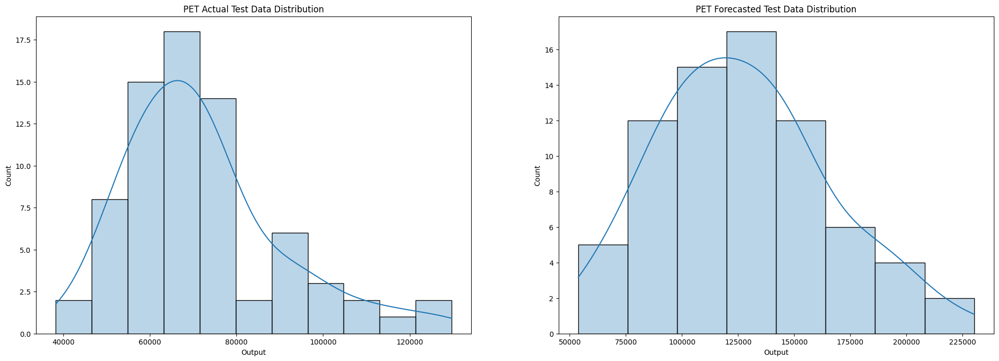

In [ ]:
# normal distribution for PET
pred_pet = pd.read_csv('/content/pred_op_pet_nbeats.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(pet.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('PET Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_pet['Output'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('PET Forecasted Test Data Distribution')

plt.show()

Predicting: 9it [00:00, ?it/s]

RMSE = 0.164
MAE = 0.111
MSE = 0.027
SMAPE = 72.58
OPE = 17.515%


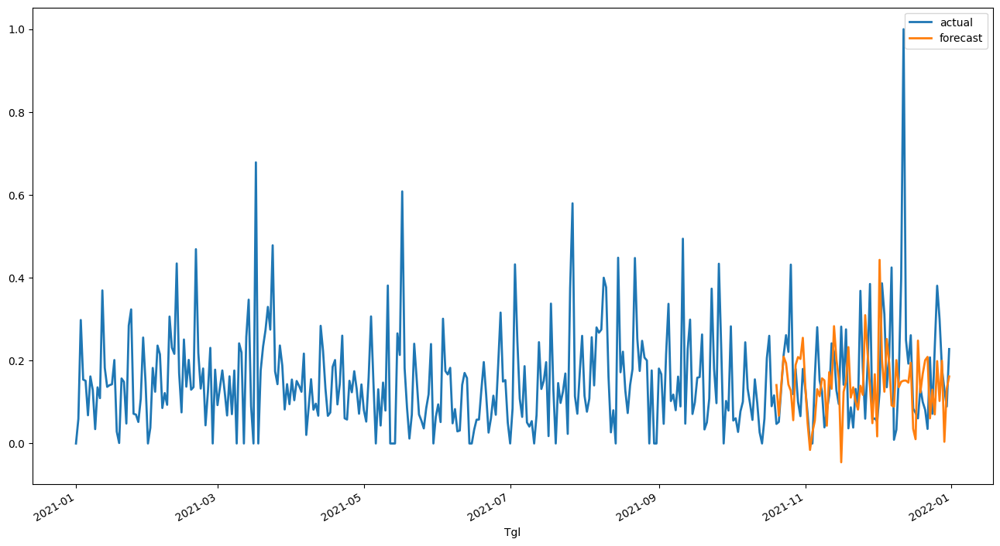

In [ ]:
# prediction for NYL
pred = nbeats_nyl.predict(n=73, series=train_nyl)

pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_op_nyl_nbeats.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_nyl_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_nyl_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_nyl_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_nyl_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_nyl_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_nyl_scaled, pred)))

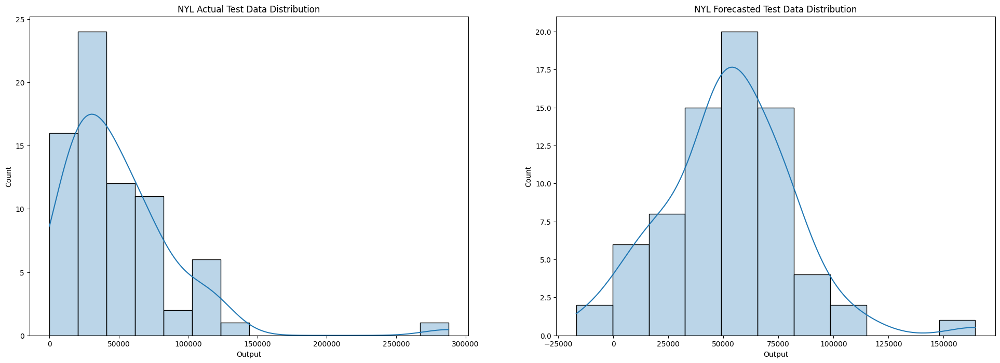

In [ ]:
# normal distribution for NYL
mpl.style.use('default')

pred_nyl = pd.read_csv('/content/pred_op_nyl_nbeats.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(nyl.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('NYL Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_nyl['Output'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('NYL Forecasted Test Data Distribution')

plt.show()

Predicting: 9it [00:00, ?it/s]

RMSE = 0.176
MAE = 0.138
MSE = 0.031
SMAPE = 83.43
OPE = 3.459%


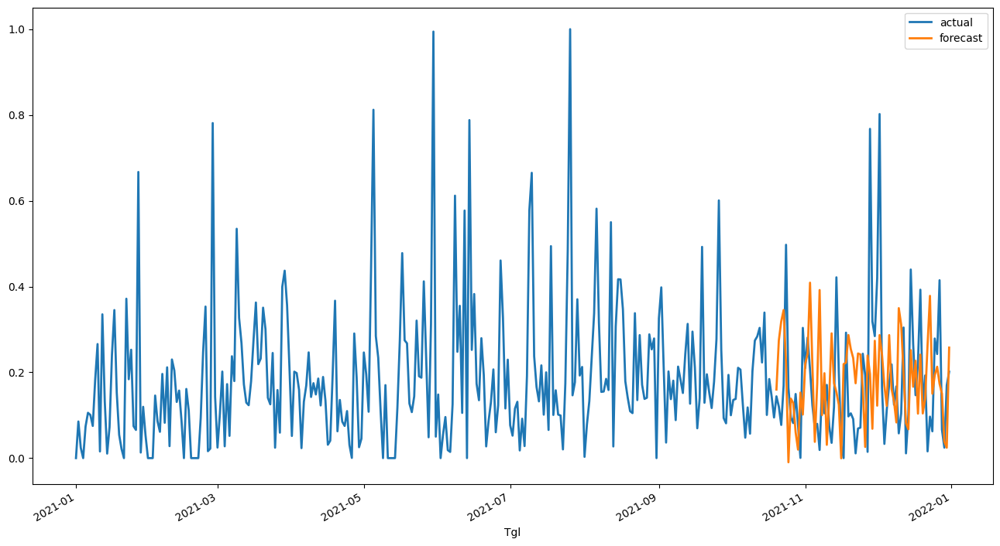

In [ ]:
# prediction for OPP
pred = nbeats_opp.predict(n=73, series=train_opp)
pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_op_opp_nbeats.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_opp_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_opp_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_opp_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_opp_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_opp_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_opp_scaled, pred)))

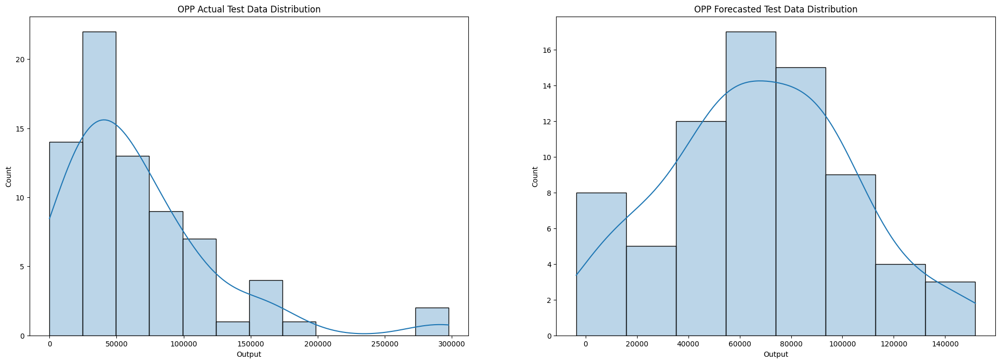

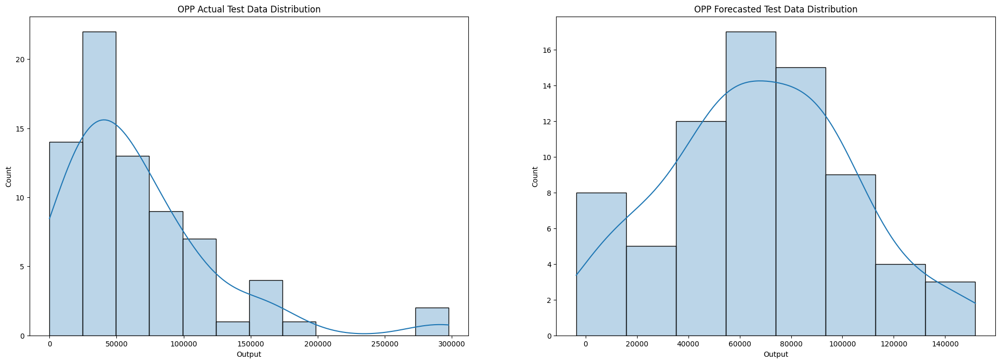

In [ ]:
# normal distribution for OPP

pred_opp = pd.read_csv('/content/pred_op_opp_nbeats.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(opp.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('OPP Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_opp['Output'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('OPP Forecasted Test Data Distribution')

plt.show()

### **Forecasting Daily Output by Machine with N-Beats**

In [ ]:
PR01 = op[op['KdMesin']=='PR01'].pivot_table(values='Output', index='Tgl', fill_value=0, aggfunc=np.mean)
PR01 = PR01.reindex(idx, fill_value=0).reset_index()
PR02 = op[op['KdMesin']=='PR02'].pivot_table(values='Output', index='Tgl', fill_value=0, aggfunc=np.mean)
PR02 = PR02.reindex(idx, fill_value=0).reset_index()
PR03 = op[op['KdMesin']=='PR03'].pivot_table(values='Output', index='Tgl', fill_value=0, aggfunc=np.mean)
PR03 = PR03.reindex(idx, fill_value=0).reset_index()
PR05 = op[op['KdMesin']=='PR05'].pivot_table(values='Output', index='Tgl', fill_value=0, aggfunc=np.mean)
PR05 = PR05.reindex(idx, fill_value=0).reset_index()
PR06 = op[op['KdMesin']=='PR06'].pivot_table(values='Output', index='Tgl', fill_value=0, aggfunc=np.mean)
PR06 = PR06.reindex(idx, fill_value=0).reset_index()
PR07 = op[op['KdMesin']=='PR07'].pivot_table(values='Output', index='Tgl', fill_value=0, aggfunc=np.mean)
PR07 = PR07.reindex(idx, fill_value=0).reset_index()

In [ ]:
# defining time series by material
PR01_series = TimeSeries.from_dataframe(PR01, 'index','Output')
PR02_series = TimeSeries.from_dataframe(PR02, 'index','Output')
PR03_series = TimeSeries.from_dataframe(PR03, 'index','Output')
PR05_series = TimeSeries.from_dataframe(PR05, 'index','Output')
PR06_series = TimeSeries.from_dataframe(PR06, 'index','Output')
PR07_series = TimeSeries.from_dataframe(PR07, 'index','Output')

In [ ]:
# check seasonality for PR01
is_seasonal, pr01_periodicity = check_seasonality(PR01_series, max_lag=240)
dict_seas ={
    "PR01 is seasonal?":is_seasonal,
    "pr01_periodicity (days)":f'{pr01_periodicity:.1f}', 
    "pr01_periodicity (~months)": f'{pr01_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

PR01 is seasonal? : True
pr01_periodicity (days) : 8.0
pr01_periodicity (~months) : 0.3


In [ ]:
# check seasonality for PR02
is_seasonal, pr02_periodicity = check_seasonality(PR02_series, max_lag=240)
dict_seas ={
    "PR02 is seasonal?":is_seasonal,
    "pr02_periodicity (days)":f'{pr02_periodicity:.1f}', 
    "pr02_periodicity (~months)": f'{pr02_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

PR02 is seasonal? : True
pr02_periodicity (days) : 7.0
pr02_periodicity (~months) : 0.2


In [ ]:
# check seasonality for PR03
is_seasonal, pr03_periodicity = check_seasonality(PR03_series, max_lag=240)
dict_seas ={
    "PR03 is seasonal?":is_seasonal,
    "pr03_periodicity (days)":f'{pr03_periodicity:.1f}', 
    "pr03_periodicity (~months)": f'{pr03_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

PR03 is seasonal? : True
pr03_periodicity (days) : 4.0
pr03_periodicity (~months) : 0.1


In [ ]:
# check seasonality for PR05
is_seasonal, pr05_periodicity = check_seasonality(PR05_series, max_lag=240)
dict_seas ={
    "PR05 is seasonal?":is_seasonal,
    "pr05_periodicity (days)":f'{pr05_periodicity:.1f}', 
    "pr05_periodicity (~months)": f'{pr05_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

PR05 is seasonal? : True
pr05_periodicity (days) : 9.0
pr05_periodicity (~months) : 0.3


In [ ]:
# check seasonality for PR06
is_seasonal, pr06_periodicity = check_seasonality(PR06_series, max_lag=240)
dict_seas ={
    "PR06 is seasonal?":is_seasonal,
    "pr06_periodicity (days)":f'{pr06_periodicity:.1f}', 
    "pr06_periodicity (~months)": f'{pr06_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

PR06 is seasonal? : True
pr06_periodicity (days) : 6.0
pr06_periodicity (~months) : 0.2


In [ ]:
# check seasonality for PR07
is_seasonal, pr07_periodicity = check_seasonality(PR07_series, max_lag=240)
dict_seas ={
    "PR07 is seasonal?":is_seasonal,
    "pr07_periodicity (days)":f'{pr07_periodicity:.1f}', 
    "pr07_periodicity (~months)": f'{pr07_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

PR07 is seasonal? : True
pr07_periodicity (days) : 6.0
pr07_periodicity (~months) : 0.2


In [ ]:
# data normalization
scaler= Scaler()
series_PR01_scaled = scaler.fit_transform(PR01_series)
series_PR02_scaled = scaler.fit_transform(PR02_series)
series_PR03_scaled = scaler.fit_transform(PR03_series)
series_PR05_scaled = scaler.fit_transform(PR05_series)
series_PR06_scaled = scaler.fit_transform(PR06_series)
series_PR07_scaled = scaler.fit_transform(PR07_series)

In [ ]:
# train test split
train_PR01, val_PR01 = series_PR01_scaled[:-73], series_PR01_scaled[-73:]
PR01.iloc[-73:].to_csv('/content/output_PR01.csv')
train_PR02, val_PR02 = series_PR02_scaled[:-73], series_PR02_scaled[-73:]
PR02.iloc[-73:].to_csv('/content/output_PR02.csv')
train_PR03, val_PR03 = series_PR03_scaled[:-73], series_PR03_scaled[-73:]
PR03.iloc[-73:].to_csv('/content/output_PR03.csv')
train_PR05, val_PR05 = series_PR05_scaled[:-73], series_PR05_scaled[-73:]
PR05.iloc[-73:].to_csv('/content/output_PR05.csv')
train_PR06, val_PR06 = series_PR06_scaled[:-73], series_PR06_scaled[-73:]
PR06.iloc[-73:].to_csv('/content/output_PR06.csv')
train_PR07, val_PR07 = series_PR07_scaled[:-73], series_PR07_scaled[-73:]
PR07.iloc[-73:].to_csv('/content/output_PR07.csv')

In [ ]:
# defining and training the model for PR01
nbeats_PR01= NBEATSModel(
    input_chunk_length=pr01_periodicity, 
    output_chunk_length=30, 
    n_epochs=300, 
    optimizer_kwargs={"lr": 1e-3},
    random_state=42)
nbeats_PR01.fit(train_PR01)

[2022-03-29 04:56:18,197] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 255 samples.
[2022-03-29 04:56:18,197] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 255 samples.
[2022-03-29 04:56:18,347] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
[2022-03-29 04:56:18,347] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs

  | Name      | Type       | Params
-----------------------------------------
0 | criterion | MSELoss    | 0     
1 | stacks    | ModuleList | 6.1 M 
-----------------------------------------
6.1 M     Trainable params
1.3 K     Non-trainable params
6.1 M     Total params
48.595    Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

In [ ]:
# defining and training the model for PR02
nbeats_PR02= NBEATSModel(
    input_chunk_length=pr02_periodicity, 
    output_chunk_length=30, 
    n_epochs=300, 
    optimizer_kwargs={"lr": 1e-3},
    random_state=42)
nbeats_PR02.fit(train_PR02)

[2022-03-29 05:09:42,391] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 256 samples.
[2022-03-29 05:09:42,391] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 256 samples.
[2022-03-29 05:09:42,542] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
[2022-03-29 05:09:42,542] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs

  | Name      | Type       | Params
-----------------------------------------
0 | criterion | MSELoss    | 0     
1 | stacks    | ModuleList | 6.1 M 
-----------------------------------------
6.1 M     Trainable params
1.3 K     Non-trainable params
6.1 M     Total params
48.532    Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

In [ ]:
# defining and training the model for PR03
nbeats_PR03= NBEATSModel(
    input_chunk_length=pr03_periodicity, 
    output_chunk_length=30, 
    n_epochs=300, 
    optimizer_kwargs={"lr": 1e-3},
    random_state=42)
nbeats_PR03.fit(train_PR03)

[2022-03-29 05:18:51,169] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 259 samples.
[2022-03-29 05:18:51,169] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 259 samples.
[2022-03-29 05:18:51,280] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
[2022-03-29 05:18:51,280] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs

  | Name      | Type       | Params
-----------------------------------------
0 | criterion | MSELoss    | 0     
1 | stacks    | ModuleList | 6.0 M 
-----------------------------------------
6.0 M     Trainable params
1.3 K     Non-trainable params
6.0 M     Total params
48.343    Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

In [ ]:
# defining and training the model for PR05
nbeats_PR05= NBEATSModel(
    input_chunk_length=pr05_periodicity, 
    output_chunk_length=30, 
    n_epochs=300, 
    optimizer_kwargs={"lr": 1e-3},
    random_state=42)
nbeats_PR05.fit(train_PR05)

[2022-03-29 05:28:45,272] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 254 samples.
[2022-03-29 05:28:45,272] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 254 samples.
[2022-03-29 05:28:45,387] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
[2022-03-29 05:28:45,387] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs

  | Name      | Type       | Params
-----------------------------------------
0 | criterion | MSELoss    | 0     
1 | stacks    | ModuleList | 6.1 M 
-----------------------------------------
6.1 M     Trainable params
1.3 K     Non-trainable params
6.1 M     Total params
48.658    Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

In [ ]:
# defining and training the model for PR06
nbeats_PR06= NBEATSModel(
    input_chunk_length=pr06_periodicity, 
    output_chunk_length=30, 
    n_epochs=300, 
    optimizer_kwargs={"lr": 1e-3},
    random_state=42)
nbeats_PR06.fit(train_PR06)

[2022-03-29 05:37:38,409] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 257 samples.
[2022-03-29 05:37:38,409] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 257 samples.
[2022-03-29 05:37:38,515] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
[2022-03-29 05:37:38,515] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs

  | Name      | Type       | Params
-----------------------------------------
0 | criterion | MSELoss    | 0     
1 | stacks    | ModuleList | 6.1 M 
-----------------------------------------
6.1 M     Trainable params
1.3 K     Non-trainable params
6.1 M     Total params
48.469    Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

In [ ]:
# defining and training the model for PR07
nbeats_PR07= NBEATSModel(
    input_chunk_length=pr07_periodicity, 
    output_chunk_length=30, 
    n_epochs=300, 
    optimizer_kwargs={"lr": 1e-3},
    random_state=42)
nbeats_PR07.fit(train_PR07)

[2022-03-29 05:47:20,386] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 257 samples.
[2022-03-29 05:47:20,386] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 257 samples.
[2022-03-29 05:47:20,499] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
[2022-03-29 05:47:20,499] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs

  | Name      | Type       | Params
-----------------------------------------
0 | criterion | MSELoss    | 0     
1 | stacks    | ModuleList | 6.1 M 
-----------------------------------------
6.1 M     Trainable params
1.3 K     Non-trainable params
6.1 M     Total params
48.469    Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

Predicting: 8it [00:00, ?it/s]

RMSE = 0.255
MAE = 0.198
MSE = 0.065
SMAPE = 56.628
OPE = 0.428%


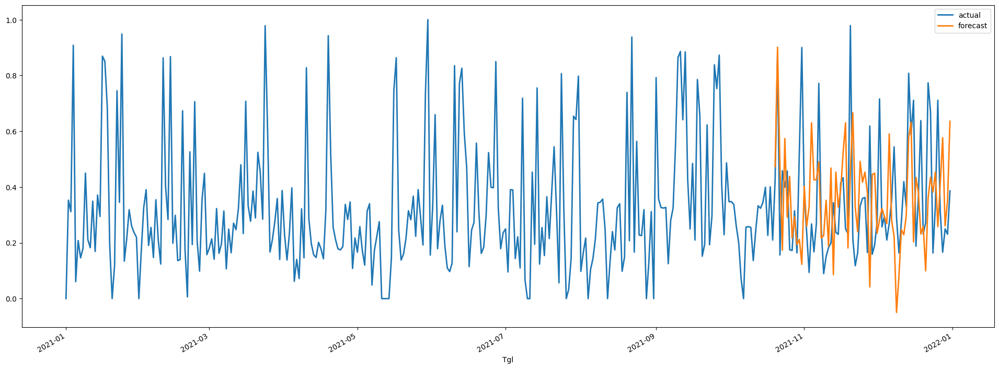

In [ ]:
# prediction for PR01
mpl.style.use('default')
pred = nbeats_PR01.predict(n=73, series=train_PR01)

pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_op_PR01_nbeats.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(24,8))
series_PR01_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_PR01_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_PR01_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_PR01_scaled, pred)))
print("SMAPE = {:.3f}".format(smape(series_PR01_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_PR01_scaled, pred)))

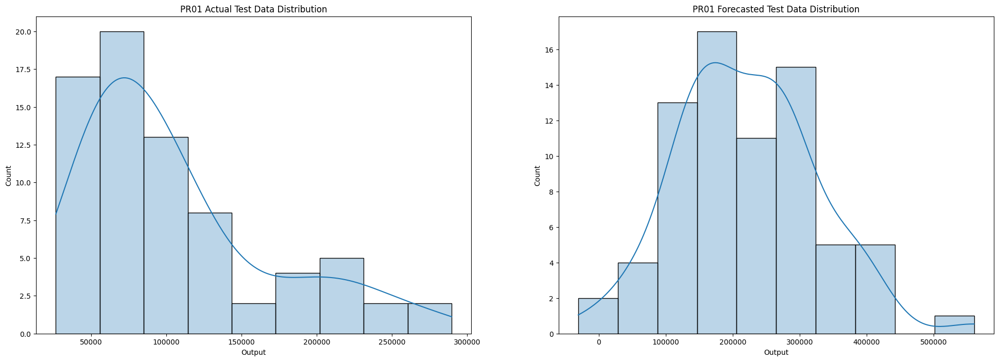

In [ ]:
# normal distribution for PR01
pred_PR01 = pd.read_csv('/content/pred_op_PR01_nbeats.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(PR01.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('PR01 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_PR01['Output'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('PR01 Forecasted Test Data Distribution')

plt.show()

Predicting: 8it [00:00, ?it/s]

RMSE = 0.160
MAE = 0.123
MSE = 0.026
SMAPE = 53.20
OPE = 3.246%


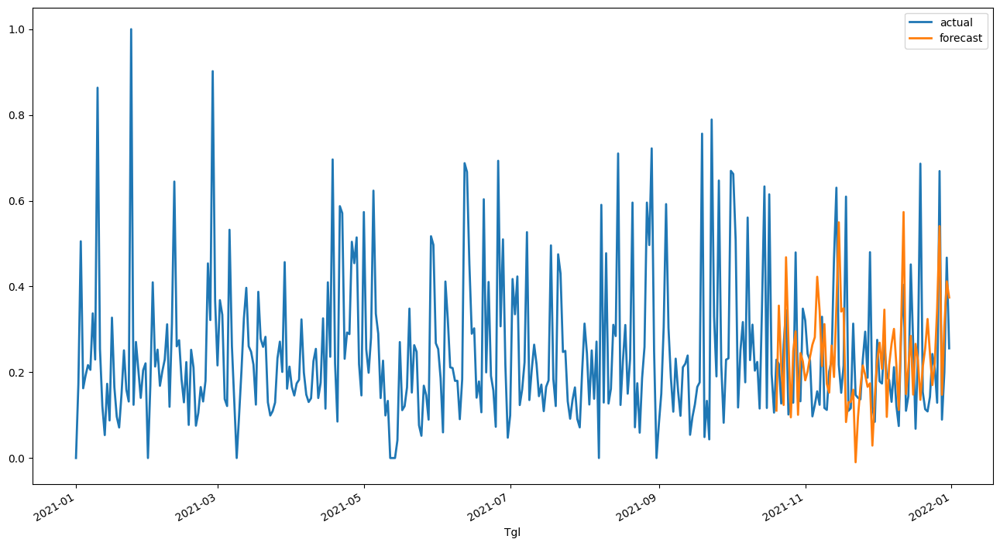

In [ ]:
# prediction for PR02
pred = nbeats_PR02.predict(n=73, series=train_PR02)

pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_op_PR02_nbeats.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_PR02_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_PR02_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_PR02_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_PR02_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_PR02_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_PR02_scaled, pred)))

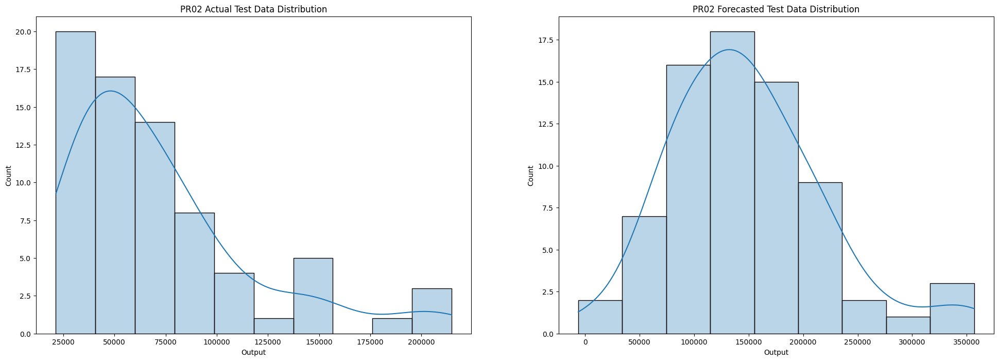

In [ ]:
# normal distribution for PR02

pred_PR02 = pd.read_csv('/content/pred_op_PR02_nbeats.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(PR02.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('PR02 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_PR02['Output'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('PR02 Forecasted Test Data Distribution')

plt.show()

Predicting: 9it [00:00, ?it/s]

RMSE = 0.284
MAE = 0.219
MSE = 0.081
SMAPE = 75.69
OPE = 37.047%


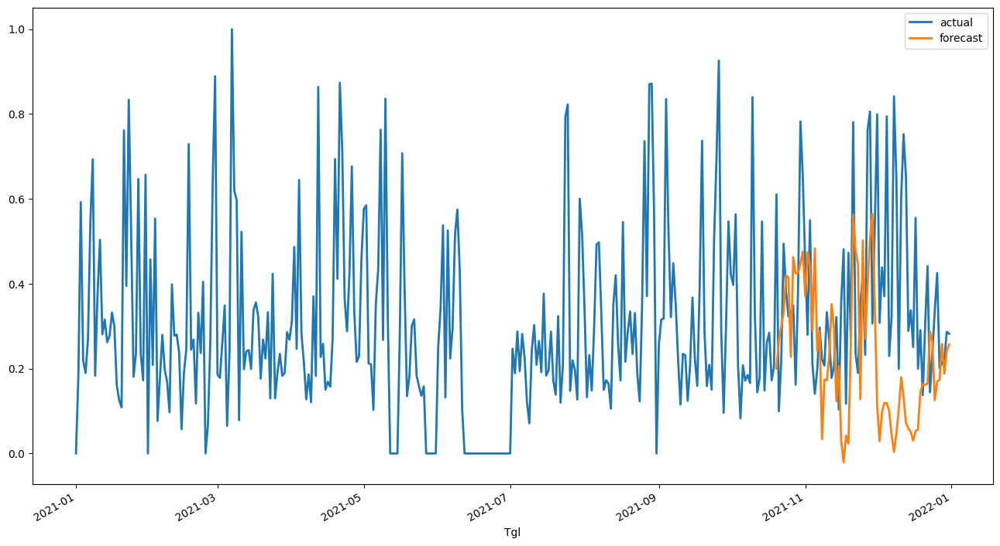

In [ ]:
# prediction for PR03
pred = nbeats_PR03.predict(n=73, series=train_PR03)
pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_op_PR03_nbeats.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_PR03_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_PR03_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_PR03_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_PR03_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_PR03_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_PR03_scaled, pred)))

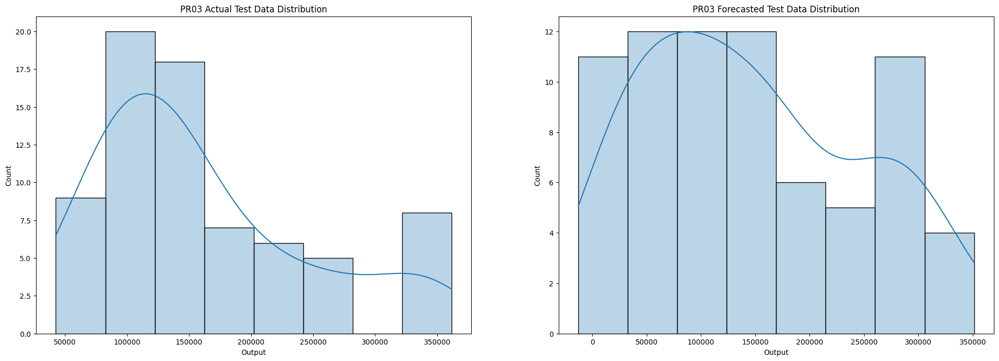

In [ ]:
# normal distribution for PR03

pred_PR03 = pd.read_csv('/content/pred_op_PR03_nbeats.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(PR03.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('PR03 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_PR03['Output'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('PR03 Forecasted Test Data Distribution')

plt.show()

Predicting: 8it [00:00, ?it/s]

RMSE = 0.243
MAE = 0.202
MSE = 0.059
SMAPE = 38.74
OPE = 1.055%


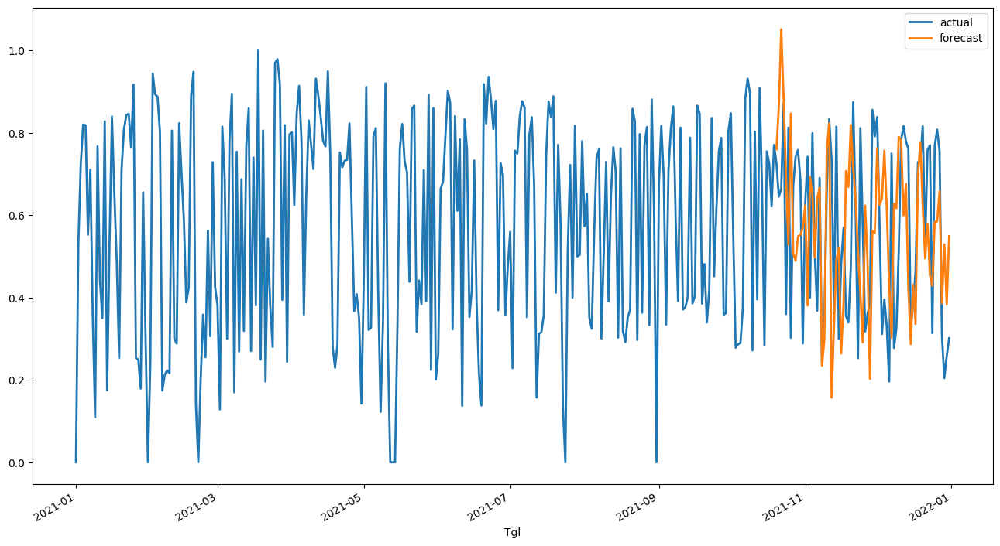

In [ ]:
# prediction for PR05
pred = nbeats_PR05.predict(n=73, series=train_PR05)
pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_op_PR05_nbeats.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_PR05_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_PR05_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_PR05_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_PR05_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_PR05_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_PR05_scaled, pred)))

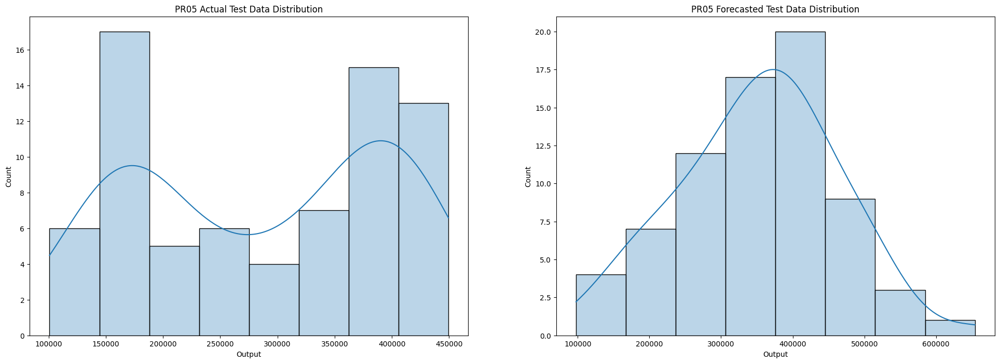

In [ ]:
# normal distribution for PR05

pred_PR05 = pd.read_csv('/content/pred_op_PR05_nbeats.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(PR05.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('PR05 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_PR05['Output'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('PR05 Forecasted Test Data Distribution')

plt.show()

Predicting: 9it [00:00, ?it/s]

RMSE = 0.222
MAE = 0.167
MSE = 0.049
SMAPE = 75.87
OPE = 23.960%


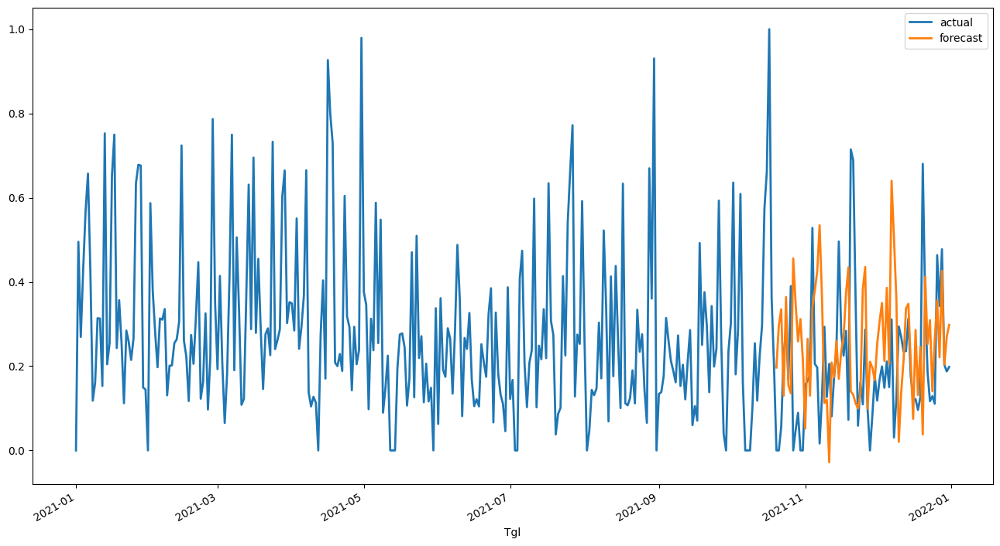

In [ ]:
# prediction for PR06
pred = nbeats_PR06.predict(n=73, series=train_PR06)
pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_op_PR06_nbeats.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_PR06_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_PR06_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_PR06_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_PR06_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_PR06_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_PR06_scaled, pred)))

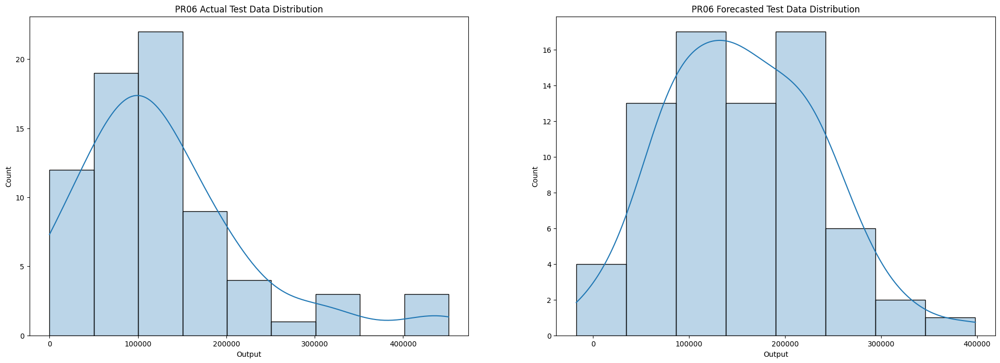

In [ ]:
# normal distribution for PR06

pred_PR06 = pd.read_csv('/content/pred_op_PR06_nbeats.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(PR06.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('PR06 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_PR06['Output'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('PR06 Forecasted Test Data Distribution')

plt.show()

Predicting: 9it [00:00, ?it/s]

RMSE = 0.321
MAE = 0.262
MSE = 0.103
SMAPE = 52.49
OPE = 27.433%


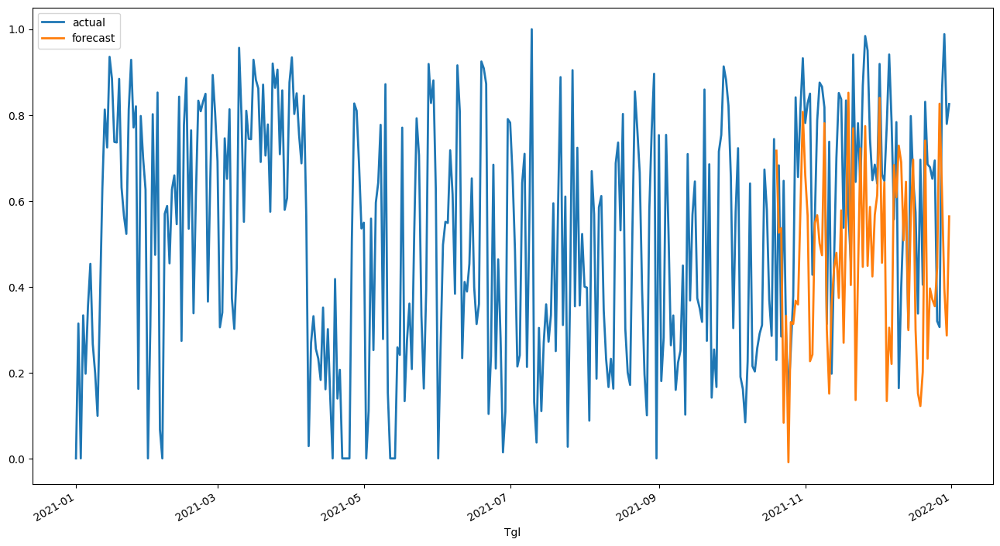

In [ ]:
# prediction for PR07
pred = nbeats_PR07.predict(n=73, series=train_PR07)
pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_op_PR07_nbeats.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_PR07_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_PR07_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_PR07_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_PR07_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_PR07_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_PR07_scaled, pred)))

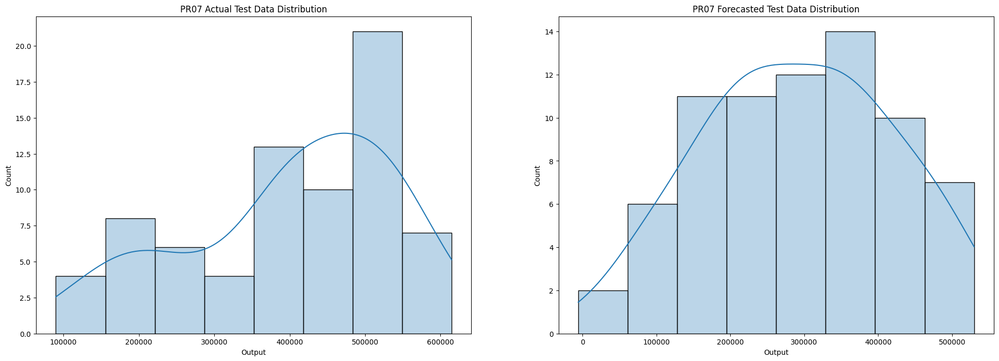

In [ ]:
# normal distribution for PR07

pred_PR07 = pd.read_csv('/content/pred_op_PR07_nbeats.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(PR07.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('PR07 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_PR07['Output'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('PR07 Forecasted Test Data Distribution')

plt.show()

## **Forecasting Daily Downtime Data with N-Beats**


In [ ]:
idx = pd.date_range('2021-01-01', '2021-12-31')
down_all = df[df['KodeBD']!='RUN'].pivot_table(values='Downtime', index='Tgl', fill_value=0, aggfunc=np.sum)
down_all = down_all.reindex(idx, fill_value=0).reset_index()

In [ ]:
# defining time series
down_series = TimeSeries.from_dataframe(down_all, 'index','Downtime')

### **Forecasting Daily Runtime by Material With N-Beats**

In [ ]:
pet = down[down['FILM']=='PET'].pivot_table(values='Downtime', index='Tgl', fill_value=0, aggfunc=np.sum)
pet = pet.reindex(idx, fill_value=0).reset_index()
nyl = down[down['FILM']=='NYL'].pivot_table(values='Downtime', index='Tgl', fill_value=0, aggfunc=np.sum)
nyl = nyl.reindex(idx, fill_value=0).reset_index()
opp = down[down['FILM']=='OPP'].pivot_table(values='Downtime', index='Tgl', fill_value=0, aggfunc=np.sum)
opp = opp.reindex(idx, fill_value=0).reset_index()

In [ ]:
# defining time series by material
pet_series = TimeSeries.from_dataframe(pet, 'index','Downtime')
nyl_series = TimeSeries.from_dataframe(nyl, 'index','Downtime')
opp_series = TimeSeries.from_dataframe(opp, 'index','Downtime')

In [ ]:
# check seasonality for PET
is_seasonal, pet_periodicity = check_seasonality(pet_series, max_lag=240)
dict_seas ={
    "PET is seasonal?":is_seasonal,
    "pet_periodicity (days)":f'{pet_periodicity:.1f}', 
    "pet_periodicity (~months)": f'{pet_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

PET is seasonal? : True
pet_periodicity (days) : 6.0
pet_periodicity (~months) : 0.2


In [ ]:
# check seasonality for NYL
is_seasonal, nyl_periodicity = check_seasonality(nyl_series, max_lag=240)
dict_seas ={
    "NYL is seasonal?":is_seasonal,
    "nyl_periodicity (days)":f'{nyl_periodicity:.1f}', 
    "nyl_periodicity (~months)": f'{nyl_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

NYL is seasonal? : True
nyl_periodicity (days) : 3.0
nyl_periodicity (~months) : 0.1


In [ ]:
is_seasonal, opp_periodicity = check_seasonality(opp_series, max_lag=240)
dict_seas ={
    "OPP is seasonal?":is_seasonal,
    "opp_periodicity (days)":f'{opp_periodicity:.1f}', 
    "opp_periodicity (~months)": f'{opp_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

OPP is seasonal? : True
opp_periodicity (days) : 4.0
opp_periodicity (~months) : 0.1


In [ ]:
# data normalization
scaler= Scaler()
series_pet_scaled = scaler.fit_transform(pet_series)
series_nyl_scaled = scaler.fit_transform(nyl_series)
series_opp_scaled = scaler.fit_transform(opp_series)

In [ ]:
# train test split
train_pet, val_pet = series_pet_scaled[:-73], series_pet_scaled[-73:]
pet.iloc[-73:].to_csv('/content/down_pet.csv')
train_nyl, val_nyl = series_nyl_scaled[:-73], series_nyl_scaled[-73:]
nyl.iloc[-73:].to_csv('/content/down_nyl.csv')
train_opp, val_opp = series_opp_scaled[:-73], series_opp_scaled[-73:]
opp.iloc[-73:].to_csv('/content/down_opp.csv')

In [ ]:
# defining and training the model for PET
nbeats_pet= NBEATSModel(
    input_chunk_length=pet_periodicity, 
    output_chunk_length=30, 
    n_epochs=300, 
    optimizer_kwargs={"lr": 1e-3},
    random_state=42)
nbeats_pet.fit(train_pet)

[2022-04-01 02:47:49,359] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 257 samples.
[2022-04-01 02:47:49,359] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 257 samples.
[2022-04-01 02:47:49,456] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
[2022-04-01 02:47:49,456] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name      | Type       | Params
-----------------------------------------
0 | criterion | MSELoss    | 0     
1 | stacks    | ModuleList | 6.1 M 
-----------------------------------------
6.1 M     Trainable params
1.3 K     Non-trainable params
6.1 M     Total params
48.469    Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

In [ ]:
# defining and training the model for NYL
nbeats_nyl= NBEATSModel(
    input_chunk_length=nyl_periodicity, 
    output_chunk_length=30, 
    n_epochs=300, 
    optimizer_kwargs={"lr": 1e-3},
    random_state=42)
nbeats_nyl.fit(train_nyl)

[2022-04-01 02:56:03,663] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 260 samples.
[2022-04-01 02:56:03,663] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 260 samples.
[2022-04-01 02:56:03,740] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
[2022-04-01 02:56:03,740] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name      | Type       | Params
-----------------------------------------
0 | criterion | MSELoss    | 0     
1 | stacks    | ModuleList | 6.0 M 
-----------------------------------------
6.0 M     Trainable params
1.3 K     Non-trainable params
6.0 M     Total params
48.280    Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

In [ ]:
# defining and training the model for OPP
nbeats_opp= NBEATSModel(
    input_chunk_length=opp_periodicity, 
    output_chunk_length=30, 
    n_epochs=300, 
    optimizer_kwargs={"lr": 1e-3},
    random_state=42)
nbeats_opp.fit(train_opp)

[2022-04-01 03:03:22,738] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 259 samples.
[2022-04-01 03:03:22,738] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 259 samples.
[2022-04-01 03:03:22,811] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
[2022-04-01 03:03:22,811] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name      | Type       | Params
-----------------------------------------
0 | criterion | MSELoss    | 0     
1 | stacks    | ModuleList | 6.0 M 
-----------------------------------------
6.0 M     Trainable params
1.3 K     Non-trainable params
6.0 M     Total params
48.343    Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

Predicting: 9it [00:00, ?it/s]

RMSE = 0.259
MAE = 0.203
MSE = 0.067
SMAPE = 45.884
OPE = 22.186%


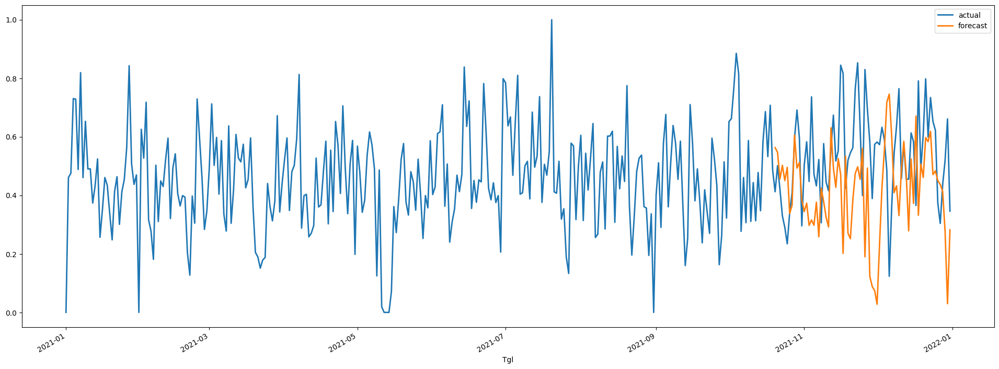

In [ ]:
# prediction for PET
mpl.style.use('default')
pred = nbeats_pet.predict(n=73, series=train_pet)

pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_down_pet_nbeats.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(24,8))
series_pet_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_pet_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_pet_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_pet_scaled, pred)))
print("SMAPE = {:.3f}".format(smape(series_pet_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_pet_scaled, pred)))

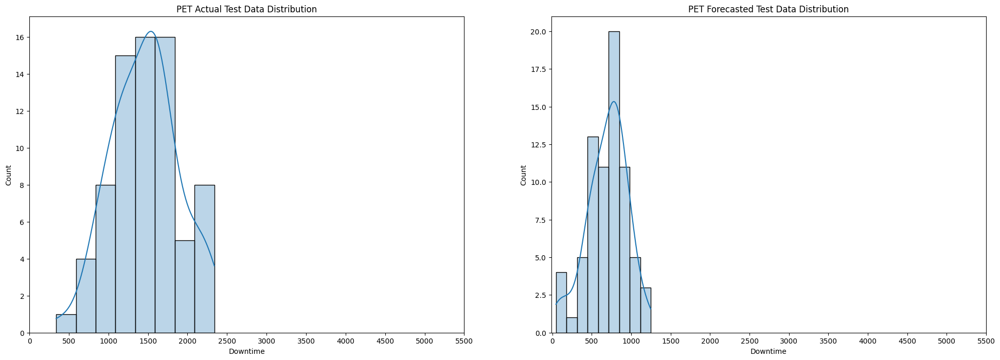

In [ ]:
# normal distribution for PET
pred_pet = pd.read_csv('/content/pred_down_pet_nbeats.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(pet.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('PET Actual Test Data Distribution')
axarr[0].set_xticks(np.arange(start=0,stop=6000,step=500))

# plot forecasted test data
sns.histplot(pred_pet['Downtime'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('PET Forecasted Test Data Distribution')
axarr[1].set_xticks(np.arange(start=0,stop=6000,step=500))

plt.show()

Predicting: 9it [00:00, ?it/s]

RMSE = 0.253
MAE = 0.182
MSE = 0.064
SMAPE = 74.50
OPE = 27.946%


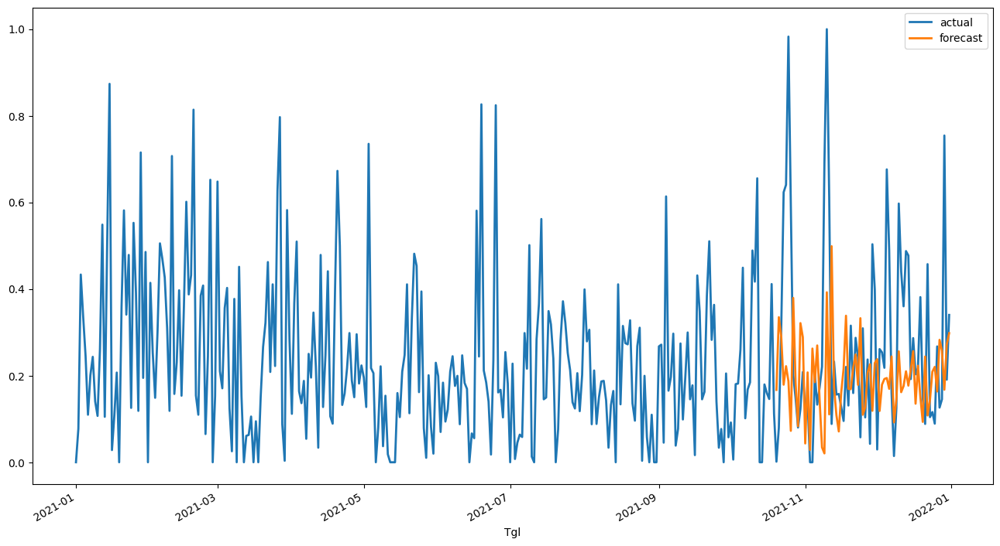

In [ ]:
# prediction for NYL
pred = nbeats_nyl.predict(n=73, series=train_nyl)

pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_down_nyl_nbeats.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_nyl_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_nyl_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_nyl_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_nyl_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_nyl_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_nyl_scaled, pred)))

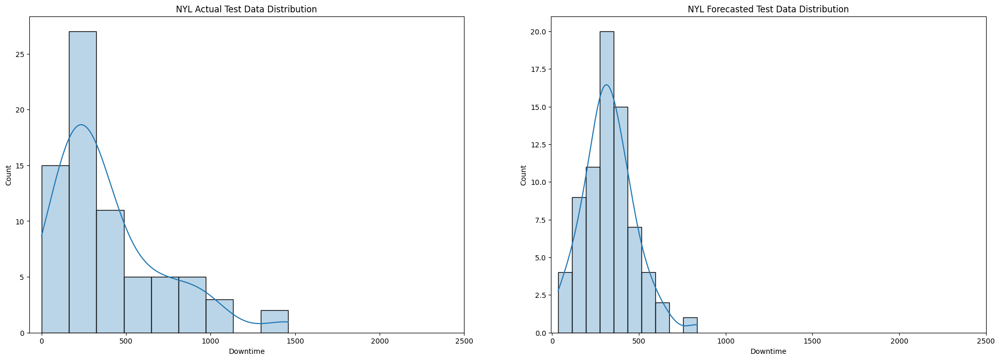

In [ ]:
# normal distribution for NYL
mpl.style.use('default')

pred_nyl = pd.read_csv('/content/pred_down_nyl_nbeats.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(nyl.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('NYL Actual Test Data Distribution')
axarr[0].set_xticks(np.arange(start=0,stop=3000,step=500))

# plot forecasted test data
sns.histplot(pred_nyl['Downtime'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('NYL Forecasted Test Data Distribution')
axarr[1].set_xticks(np.arange(start=0,stop=3000,step=500))

plt.show()

Predicting: 9it [00:00, ?it/s]

RMSE = 0.203
MAE = 0.161
MSE = 0.041
SMAPE = 76.07
OPE = 14.419%


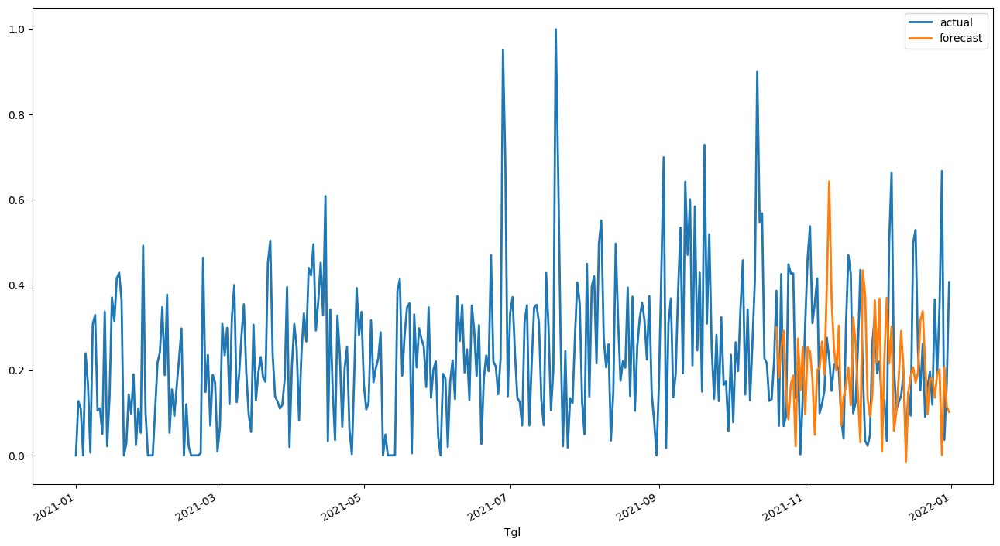

In [ ]:
# prediction for OPP
pred = nbeats_opp.predict(n=73, series=train_opp)
pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_down_opp_nbeats.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_opp_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_opp_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_opp_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_opp_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_opp_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_opp_scaled, pred)))

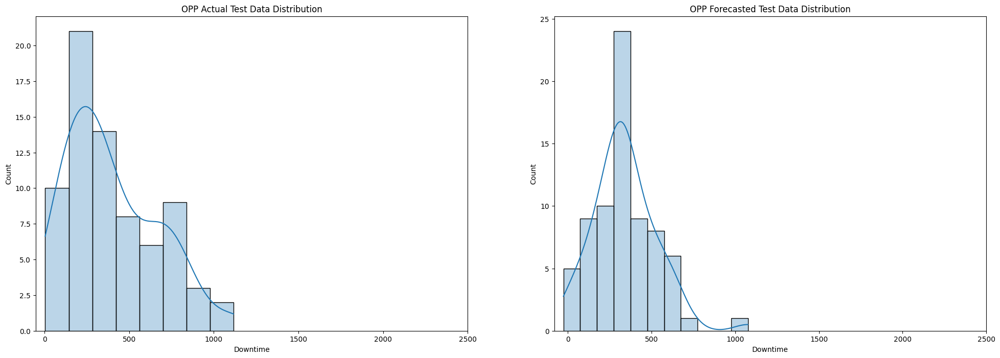

In [ ]:
# normal distribution for OPP

pred_opp = pd.read_csv('/content/pred_down_opp_nbeats.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(opp.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('OPP Actual Test Data Distribution')
axarr[0].set_xticks(np.arange(start=0,stop=3000,step=500))

# plot forecasted test data
sns.histplot(pred_opp['Downtime'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('OPP Forecasted Test Data Distribution')
axarr[1].set_xticks(np.arange(start=0,stop=3000,step=500))

plt.show()

### **Forecasting Daily Runtime by Machine With N-Beats**

In [ ]:
PR01 = down[down['KdMesin']=='PR01'].pivot_table(values='Downtime', index='Tgl', fill_value=0, aggfunc=np.sum)
PR01 = PR01.reindex(idx, fill_value=0).reset_index()
PR02 = down[down['KdMesin']=='PR02'].pivot_table(values='Downtime', index='Tgl', fill_value=0, aggfunc=np.sum)
PR02 = PR02.reindex(idx, fill_value=0).reset_index()
PR03 = down[down['KdMesin']=='PR03'].pivot_table(values='Downtime', index='Tgl', fill_value=0, aggfunc=np.sum)
PR03 = PR03.reindex(idx, fill_value=0).reset_index()
PR05 = down[down['KdMesin']=='PR05'].pivot_table(values='Downtime', index='Tgl', fill_value=0, aggfunc=np.sum)
PR05 = PR05.reindex(idx, fill_value=0).reset_index()
PR06 = down[down['KdMesin']=='PR06'].pivot_table(values='Downtime', index='Tgl', fill_value=0, aggfunc=np.sum)
PR06 = PR06.reindex(idx, fill_value=0).reset_index()
PR07 = down[down['KdMesin']=='PR07'].pivot_table(values='Downtime', index='Tgl', fill_value=0, aggfunc=np.sum)
PR07 = PR07.reindex(idx, fill_value=0).reset_index()

In [ ]:
# defining time series by material
PR01_series = TimeSeries.from_dataframe(PR01, 'index','Downtime')
PR02_series = TimeSeries.from_dataframe(PR02, 'index','Downtime')
PR03_series = TimeSeries.from_dataframe(PR03, 'index','Downtime')
PR05_series = TimeSeries.from_dataframe(PR05, 'index','Downtime')
PR06_series = TimeSeries.from_dataframe(PR06, 'index','Downtime')
PR07_series = TimeSeries.from_dataframe(PR07, 'index','Downtime')

In [ ]:
# check seasonality for PR01
is_seasonal, pr01_periodicity = check_seasonality(PR01_series, max_lag=240)
dict_seas ={
    "PR01 is seasonal?":is_seasonal,
    "pr01_periodicity (days)":f'{pr01_periodicity:.1f}', 
    "pr01_periodicity (~months)": f'{pr01_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

PR01 is seasonal? : True
pr01_periodicity (days) : 4.0
pr01_periodicity (~months) : 0.1


In [ ]:
# check seasonality for PR02
is_seasonal, pr02_periodicity = check_seasonality(PR02_series, max_lag=240)
dict_seas ={
    "PR02 is seasonal?":is_seasonal,
    "pr02_periodicity (days)":f'{pr02_periodicity:.1f}', 
    "pr02_periodicity (~months)": f'{pr02_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

PR02 is seasonal? : True
pr02_periodicity (days) : 3.0
pr02_periodicity (~months) : 0.1


In [ ]:
# check seasonality for PR03
is_seasonal, pr03_periodicity = check_seasonality(PR03_series, max_lag=240)
dict_seas ={
    "PR03 is seasonal?":is_seasonal,
    "pr03_periodicity (days)":f'{pr03_periodicity:.1f}', 
    "pr03_periodicity (~months)": f'{pr03_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

PR03 is seasonal? : True
pr03_periodicity (days) : 5.0
pr03_periodicity (~months) : 0.2


In [ ]:
# check seasonality for PR05
is_seasonal, pr05_periodicity = check_seasonality(PR05_series, max_lag=240)
dict_seas ={
    "PR05 is seasonal?":is_seasonal,
    "pr05_periodicity (days)":f'{pr05_periodicity:.1f}', 
    "pr05_periodicity (~months)": f'{pr05_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

PR05 is seasonal? : True
pr05_periodicity (days) : 4.0
pr05_periodicity (~months) : 0.1


In [ ]:
# check seasonality for PR06
is_seasonal, pr06_periodicity = check_seasonality(PR06_series, max_lag=240)
dict_seas ={
    "PR06 is seasonal?":is_seasonal,
    "pr06_periodicity (days)":f'{pr06_periodicity:.1f}', 
    "pr06_periodicity (~months)": f'{pr06_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

PR06 is seasonal? : True
pr06_periodicity (days) : 6.0
pr06_periodicity (~months) : 0.2


In [ ]:
# check seasonality for PR07
is_seasonal, pr07_periodicity = check_seasonality(PR07_series, max_lag=240)
dict_seas ={
    "PR07 is seasonal?":is_seasonal,
    "pr07_periodicity (days)":f'{pr07_periodicity:.1f}', 
    "pr07_periodicity (~months)": f'{pr07_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

PR07 is seasonal? : True
pr07_periodicity (days) : 4.0
pr07_periodicity (~months) : 0.1


In [ ]:
# data normalization
scaler= Scaler()
series_PR01_scaled = scaler.fit_transform(PR01_series)
series_PR02_scaled = scaler.fit_transform(PR02_series)
series_PR03_scaled = scaler.fit_transform(PR03_series)
series_PR05_scaled = scaler.fit_transform(PR05_series)
series_PR06_scaled = scaler.fit_transform(PR06_series)
series_PR07_scaled = scaler.fit_transform(PR07_series)

In [ ]:
# train test split
train_PR01, val_PR01 = series_PR01_scaled[:-73], series_PR01_scaled[-73:]
PR01.iloc[-73:].to_csv('/content/down_PR01.csv')
train_PR02, val_PR02 = series_PR02_scaled[:-73], series_PR02_scaled[-73:]
PR02.iloc[-73:].to_csv('/content/down_PR02.csv')
train_PR03, val_PR03 = series_PR03_scaled[:-73], series_PR03_scaled[-73:]
PR03.iloc[-73:].to_csv('/content/down_PR03.csv')
train_PR05, val_PR05 = series_PR05_scaled[:-73], series_PR05_scaled[-73:]
PR05.iloc[-73:].to_csv('/content/down_PR05.csv')
train_PR06, val_PR06 = series_PR06_scaled[:-73], series_PR06_scaled[-73:]
PR06.iloc[-73:].to_csv('/content/down_PR06.csv')
train_PR07, val_PR07 = series_PR07_scaled[:-73], series_PR07_scaled[-73:]
PR07.iloc[-73:].to_csv('/content/down_PR07.csv')

In [ ]:
# defining and training the model for PR01
nbeats_PR01= NBEATSModel(
    input_chunk_length=pr01_periodicity, 
    output_chunk_length=30, 
    n_epochs=300, 
    optimizer_kwargs={"lr": 1e-3},
    random_state=42)
nbeats_PR01.fit(train_PR01)

[2022-04-04 06:42:46,513] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 259 samples.
[2022-04-04 06:42:46,513] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 259 samples.
[2022-04-04 06:42:46,632] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
[2022-04-04 06:42:46,632] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name      | Type       | Params
-----------------------------------------
0 | criterion | MSELoss    | 0     
1 | stacks    | ModuleList | 6.0 M 
-----------------------------------------
6.0 M     Trainable params
1.3 K     Non-trainable params
6.0 M     Total params
48.343    Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

In [ ]:
# defining and training the model for PR02
nbeats_PR02= NBEATSModel(
    input_chunk_length=pr02_periodicity, 
    output_chunk_length=30, 
    n_epochs=300, 
    optimizer_kwargs={"lr": 1e-3},
    random_state=42)
nbeats_PR02.fit(train_PR02)

[2022-04-04 06:54:12,800] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 260 samples.
[2022-04-04 06:54:12,800] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 260 samples.
[2022-04-04 06:54:12,918] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
[2022-04-04 06:54:12,918] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name      | Type       | Params
-----------------------------------------
0 | criterion | MSELoss    | 0     
1 | stacks    | ModuleList | 6.0 M 
-----------------------------------------
6.0 M     Trainable params
1.3 K     Non-trainable params
6.0 M     Total params
48.280    Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

In [ ]:
# defining and training the model for PR03
nbeats_PR03= NBEATSModel(
    input_chunk_length=pr03_periodicity, 
    output_chunk_length=30, 
    n_epochs=300, 
    optimizer_kwargs={"lr": 1e-3},
    random_state=42)
nbeats_PR03.fit(train_PR03)

[2022-04-04 07:03:52,081] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 258 samples.
[2022-04-04 07:03:52,081] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 258 samples.
[2022-04-04 07:03:52,168] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
[2022-04-04 07:03:52,168] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name      | Type       | Params
-----------------------------------------
0 | criterion | MSELoss    | 0     
1 | stacks    | ModuleList | 6.1 M 
-----------------------------------------
6.0 M     Trainable params
1.3 K     Non-trainable params
6.1 M     Total params
48.406    Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

In [ ]:
# defining and training the model for PR05
nbeats_PR05= NBEATSModel(
    input_chunk_length=pr05_periodicity, 
    output_chunk_length=30, 
    n_epochs=300, 
    optimizer_kwargs={"lr": 1e-3},
    random_state=42)
nbeats_PR05.fit(train_PR05)

[2022-04-04 07:13:16,555] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 259 samples.
[2022-04-04 07:13:16,555] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 259 samples.
[2022-04-04 07:13:17,001] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
[2022-04-04 07:13:17,001] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name      | Type       | Params
-----------------------------------------
0 | criterion | MSELoss    | 0     
1 | stacks    | ModuleList | 6.0 M 
-----------------------------------------
6.0 M     Trainable params
1.3 K     Non-trainable params
6.0 M     Total params
48.343    Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

In [ ]:
# defining and training the model for PR06
nbeats_PR06= NBEATSModel(
    input_chunk_length=pr06_periodicity, 
    output_chunk_length=30, 
    n_epochs=300, 
    optimizer_kwargs={"lr": 1e-3},
    random_state=42)
nbeats_PR06.fit(train_PR06)

[2022-04-04 07:22:54,219] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 257 samples.
[2022-04-04 07:22:54,219] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 257 samples.
[2022-04-04 07:22:54,308] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
[2022-04-04 07:22:54,308] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name      | Type       | Params
-----------------------------------------
0 | criterion | MSELoss    | 0     
1 | stacks    | ModuleList | 6.1 M 
-----------------------------------------
6.1 M     Trainable params
1.3 K     Non-trainable params
6.1 M     Total params
48.469    Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

In [ ]:
# defining and training the model for PR07
nbeats_PR07= NBEATSModel(
    input_chunk_length=pr07_periodicity, 
    output_chunk_length=30, 
    n_epochs=300, 
    optimizer_kwargs={"lr": 1e-3},
    random_state=42)
nbeats_PR07.fit(train_PR07)

[2022-04-04 07:32:23,342] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 259 samples.
[2022-04-04 07:32:23,342] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 259 samples.
[2022-04-04 07:32:23,429] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
[2022-04-04 07:32:23,429] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name      | Type       | Params
-----------------------------------------
0 | criterion | MSELoss    | 0     
1 | stacks    | ModuleList | 6.0 M 
-----------------------------------------
6.0 M     Trainable params
1.3 K     Non-trainable params
6.0 M     Total params
48.343    Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

Predicting: 9it [00:00, ?it/s]

RMSE = 0.148
MAE = 0.117
MSE = 0.022
SMAPE = 39.707
OPE = 5.474%


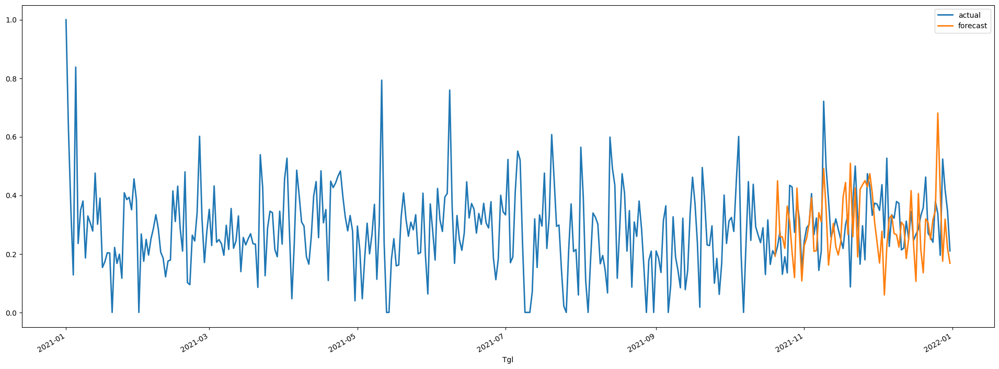

In [ ]:
# prediction for PR01
mpl.style.use('default')
pred = nbeats_PR01.predict(n=73, series=train_PR01)

pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_down_PR01_nbeats.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(24,8))
series_PR01_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_PR01_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_PR01_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_PR01_scaled, pred)))
print("SMAPE = {:.3f}".format(smape(series_PR01_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_PR01_scaled, pred)))

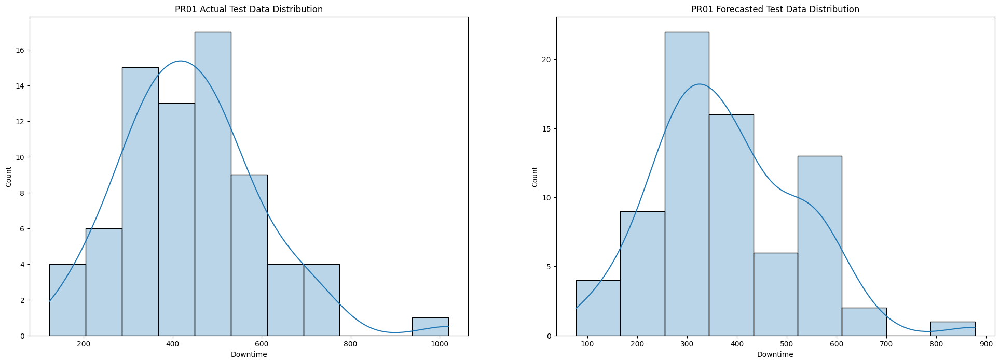

In [ ]:
# normal distribution for PR01
pred_PR01 = pd.read_csv('/content/pred_down_PR01_nbeats.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(PR01.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('PR01 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_PR01['Downtime'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('PR01 Forecasted Test Data Distribution')

plt.show()

Predicting: 9it [00:00, ?it/s]

RMSE = 0.149
MAE = 0.123
MSE = 0.022
SMAPE = 28.70
OPE = 12.492%


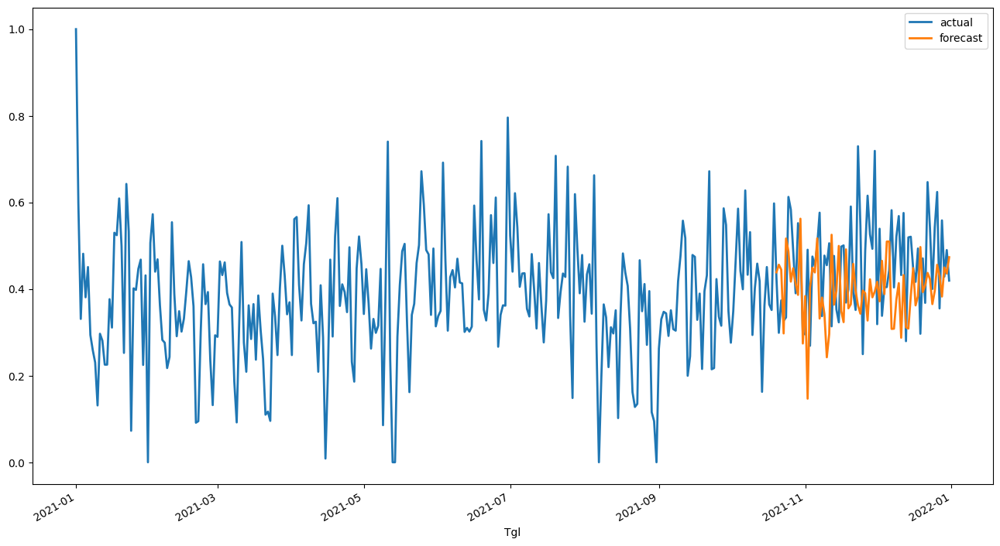

In [ ]:
# prediction for PR02
pred = nbeats_PR02.predict(n=73, series=train_PR02)

pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_down_PR02_nbeats.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_PR02_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_PR02_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_PR02_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_PR02_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_PR02_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_PR02_scaled, pred)))

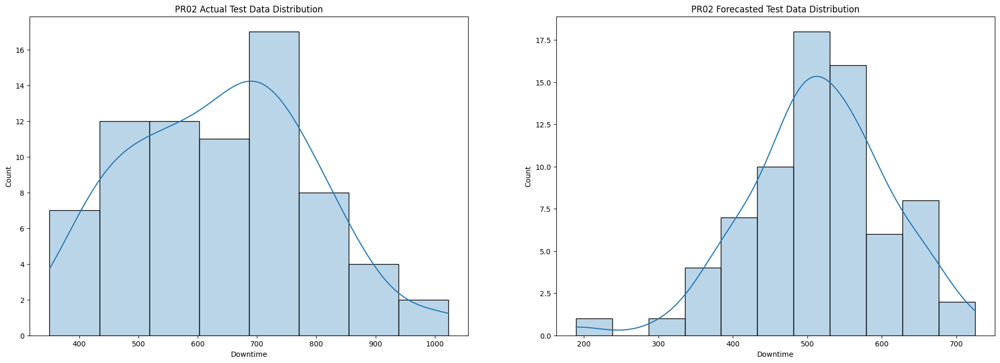

In [ ]:
# normal distribution for PR02

pred_PR02 = pd.read_csv('/content/pred_down_PR02_nbeats.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(PR02.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('PR02 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_PR02['Downtime'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('PR02 Forecasted Test Data Distribution')

plt.show()

Predicting: 9it [00:00, ?it/s]

RMSE = 0.143
MAE = 0.115
MSE = 0.020
SMAPE = 36.68
OPE = 7.614%


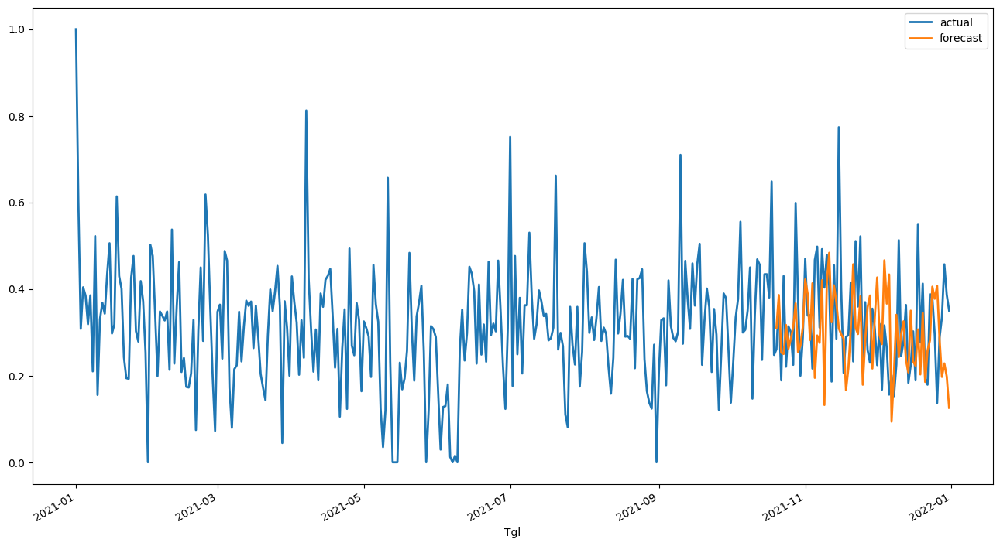

In [ ]:
# prediction for PR03
pred = nbeats_PR03.predict(n=73, series=train_PR03)
pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_down_PR03_nbeats.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_PR03_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_PR03_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_PR03_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_PR03_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_PR03_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_PR03_scaled, pred)))

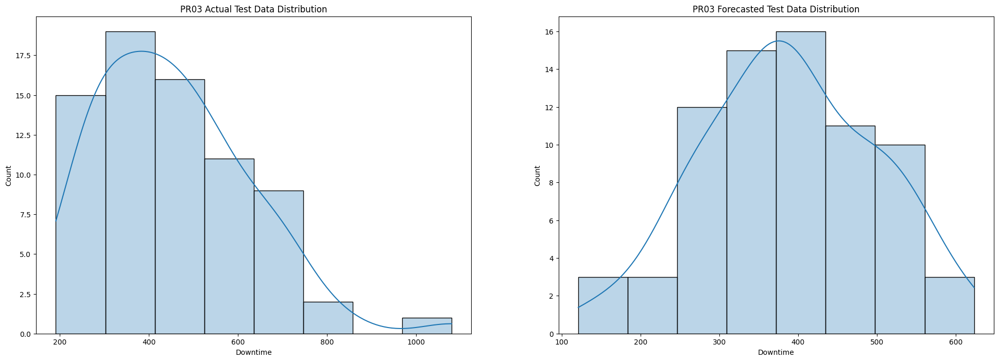

In [ ]:
# normal distribution for PR03

pred_PR03 = pd.read_csv('/content/pred_down_PR03_nbeats.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(PR03.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('PR03 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_PR03['Downtime'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('PR03 Forecasted Test Data Distribution')

plt.show()

Predicting: 9it [00:00, ?it/s]

RMSE = 0.130
MAE = 0.094
MSE = 0.017
SMAPE = 45.20
OPE = 22.918%


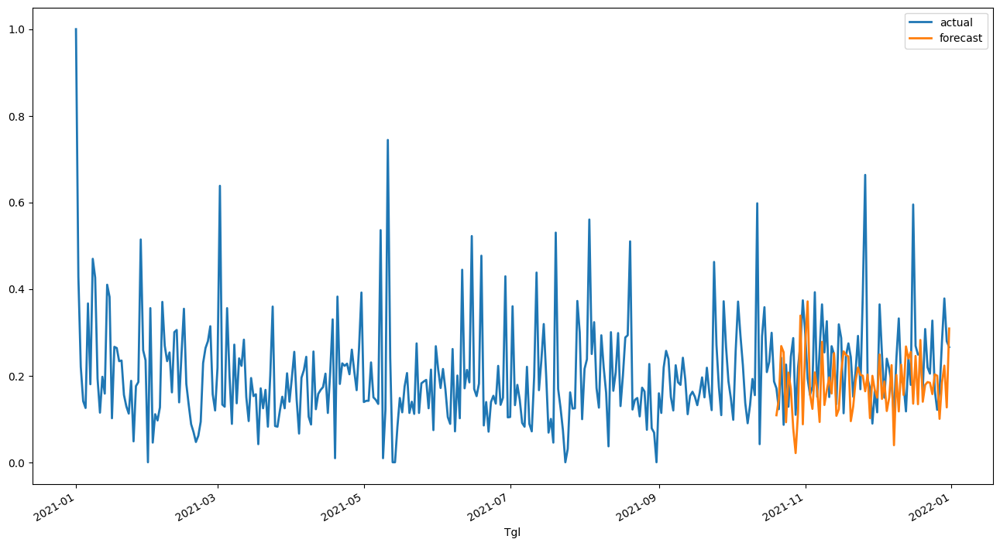

In [ ]:
# prediction for PR05
pred = nbeats_PR05.predict(n=73, series=train_PR05)
pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_down_PR05_nbeats.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_PR05_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_PR05_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_PR05_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_PR05_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_PR05_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_PR05_scaled, pred)))

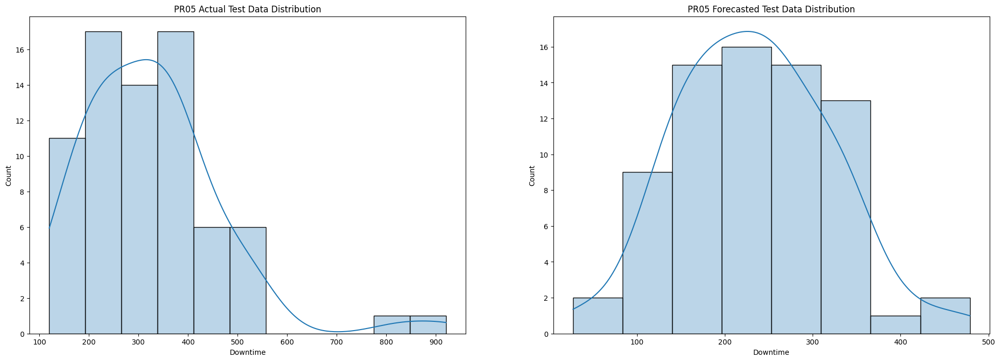

In [ ]:
# normal distribution for PR05

pred_PR05 = pd.read_csv('/content/pred_down_PR05_nbeats.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(PR05.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('PR05 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_PR05['Downtime'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('PR05 Forecasted Test Data Distribution')

plt.show()

Predicting: 9it [00:00, ?it/s]

RMSE = 0.195
MAE = 0.146
MSE = 0.038
SMAPE = 59.95
OPE = 19.069%


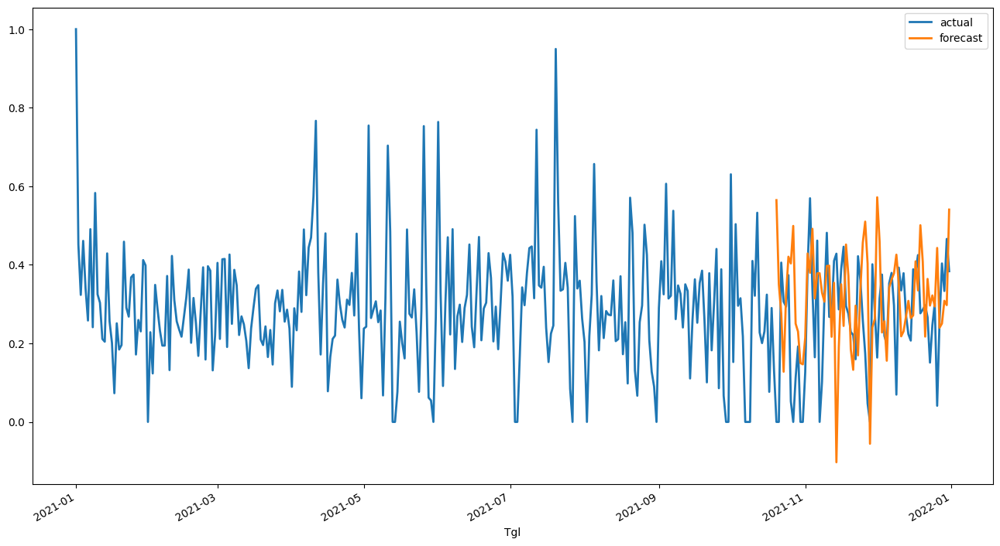

In [ ]:
# prediction for PR06
pred = nbeats_PR06.predict(n=73, series=train_PR06)
pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_down_PR06_nbeats.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_PR06_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_PR06_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_PR06_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_PR06_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_PR06_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_PR06_scaled, pred)))

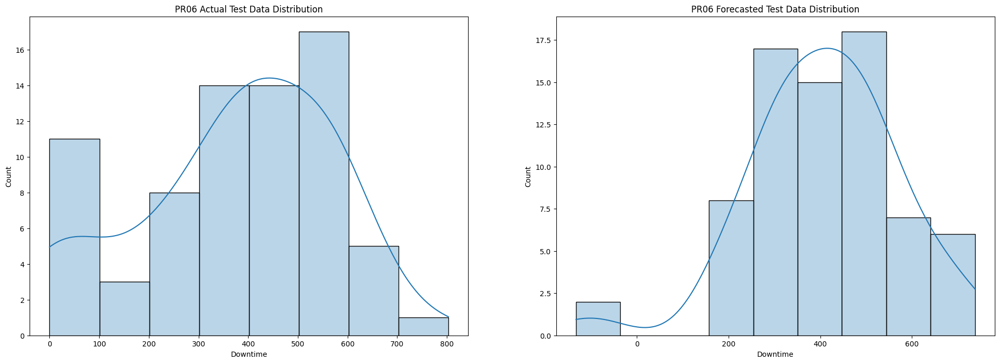

In [ ]:
# normal distribution for PR06

pred_PR06 = pd.read_csv('/content/pred_down_PR06_nbeats.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(PR06.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('PR06 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_PR06['Downtime'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('PR06 Forecasted Test Data Distribution')

plt.show()

Predicting: 9it [00:00, ?it/s]

RMSE = 0.163
MAE = 0.131
MSE = 0.027
SMAPE = 63.30
OPE = 11.769%


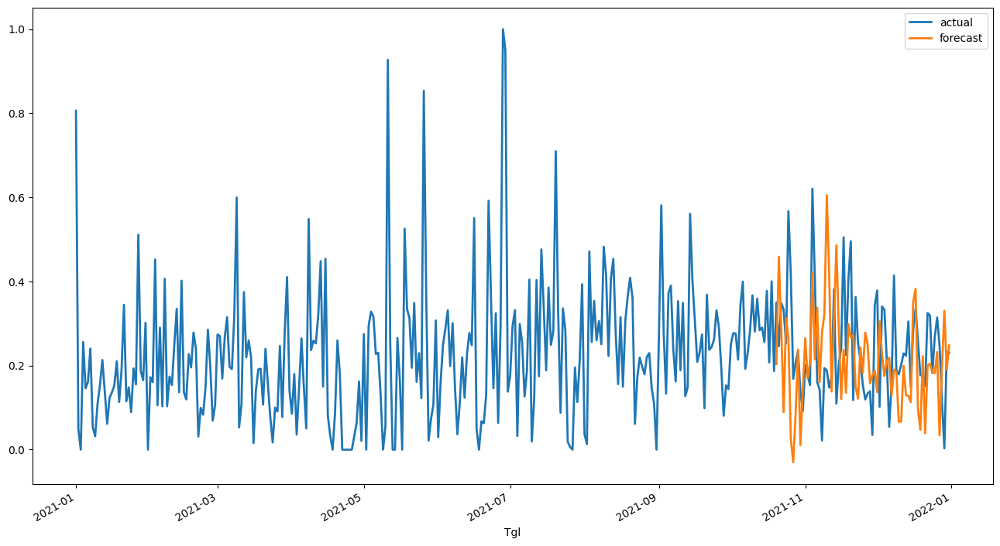

In [ ]:
# prediction for PR07
pred = nbeats_PR07.predict(n=73, series=train_PR07)
pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_down_PR07_nbeats.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_PR07_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_PR07_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_PR07_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_PR07_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_PR07_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_PR07_scaled, pred)))

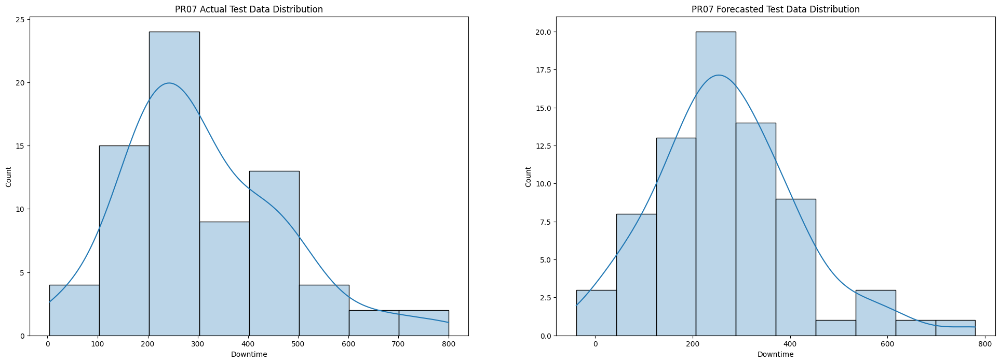

In [ ]:
# normal distribution for PR07

pred_PR07 = pd.read_csv('/content/pred_down_PR07_nbeats.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(PR07.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('PR07 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_PR07['Downtime'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('PR07 Forecasted Test Data Distribution')

plt.show()

## **Forecasting Daily Runtime Data with RNN**

### **Forecasting Daily Runtime by Material With RNN**

In [ ]:
pet = run[run['FILM']=='PET'].pivot_table(values='RunTime', index='Tgl', fill_value=0, aggfunc=np.sum)
pet = pet.reindex(idx, fill_value=0).reset_index()
nyl = run[run['FILM']=='NYL'].pivot_table(values='RunTime', index='Tgl', fill_value=0, aggfunc=np.sum)
nyl = nyl.reindex(idx, fill_value=0).reset_index()
opp = run[run['FILM']=='OPP'].pivot_table(values='RunTime', index='Tgl', fill_value=0, aggfunc=np.sum)
opp = opp.reindex(idx, fill_value=0).reset_index()

In [ ]:
# defining time series by material
pet_series = TimeSeries.from_dataframe(pet, 'index','RunTime')
nyl_series = TimeSeries.from_dataframe(nyl, 'index','RunTime')
opp_series = TimeSeries.from_dataframe(opp, 'index','RunTime')

In [ ]:
# check seasonality for PET
is_seasonal, pet_periodicity = check_seasonality(pet_series, max_lag=240)
dict_seas ={
    "PET is seasonal?":is_seasonal,
    "pet_periodicity (days)":f'{pet_periodicity:.1f}', 
    "pet_periodicity (~months)": f'{pet_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

PET is seasonal? : True
pet_periodicity (days) : 7.0
pet_periodicity (~months) : 0.2


In [ ]:
# check seasonality for NYL
is_seasonal, nyl_periodicity = check_seasonality(nyl_series, max_lag=240)
dict_seas ={
    "NYL is seasonal?":is_seasonal,
    "nyl_periodicity (days)":f'{nyl_periodicity:.1f}', 
    "nyl_periodicity (~months)": f'{nyl_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

NYL is seasonal? : True
nyl_periodicity (days) : 7.0
nyl_periodicity (~months) : 0.2


In [ ]:
is_seasonal, opp_periodicity = check_seasonality(opp_series, max_lag=240)
dict_seas ={
    "OPP is seasonal?":is_seasonal,
    "opp_periodicity (days)":f'{opp_periodicity:.1f}', 
    "opp_periodicity (~months)": f'{opp_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

OPP is seasonal? : True
opp_periodicity (days) : 7.0
opp_periodicity (~months) : 0.2


In [ ]:
# data normalization
scaler= Scaler()
series_pet_scaled = scaler.fit_transform(pet_series)
series_nyl_scaled = scaler.fit_transform(nyl_series)
series_opp_scaled = scaler.fit_transform(opp_series)

In [ ]:
# train test split
train_pet, val_pet = series_pet_scaled[:-73], series_pet_scaled[-73:]
train_nyl, val_nyl = series_nyl_scaled[:-73], series_nyl_scaled[-73:]
train_opp, val_opp = series_opp_scaled[:-73], series_opp_scaled[-73:]

In [ ]:
# defining and training the model for PET
rnn_pet= RNNModel(
    model="RNN",
    input_chunk_length=pet_periodicity,
    output_chunk_length=30,
    n_rnn_layers=3,
    batch_size=32,
    n_epochs=300,
    dropout=0.1,
    optimizer_kwargs={"lr": 1e-3},
    log_tensorboard=True,
    random_state=42,
    force_reset=True,
)
rnn_pet.fit(train_pet)

[2022-03-28 08:18:08,678] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 268 samples.
[2022-03-28 08:18:08,678] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 268 samples.
[2022-03-28 08:18:08,704] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
[2022-03-28 08:18:08,704] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs

  | Name      | Type    | Params
--------------------------------------
0 | criterion | MSELoss | 0     
1 | rnn       | RNN     | 3.3 K 
2 | V         | Linear  | 26    
--------------------------------------
3.3 K     Trainable params
0         Non-trainable params
3.3 K     Total params
0.027     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

In [ ]:
# defining and training the model for NYL
rnn_nyl= RNNModel(
    model="RNN",
    input_chunk_length=nyl_periodicity,
    output_chunk_length=30,
    n_rnn_layers=3,
    batch_size=32,
    n_epochs=300,
    dropout=0.1,
    optimizer_kwargs={"lr": 1e-3},
    log_tensorboard=True,
    random_state=42,
    force_reset=True,
)
rnn_nyl.fit(train_nyl)

[2022-03-28 08:19:42,147] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 268 samples.
[2022-03-28 08:19:42,147] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 268 samples.
[2022-03-28 08:19:42,159] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
[2022-03-28 08:19:42,159] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs

  | Name      | Type    | Params
--------------------------------------
0 | criterion | MSELoss | 0     
1 | rnn       | RNN     | 3.3 K 
2 | V         | Linear  | 26    
--------------------------------------
3.3 K     Trainable params
0         Non-trainable params
3.3 K     Total params
0.027     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

In [ ]:
# defining and training the model for OPP
rnn_opp= RNNModel(
    model="RNN",
    input_chunk_length=opp_periodicity,
    output_chunk_length=30,
    n_rnn_layers=3,
    batch_size=32,
    n_epochs=300,
    dropout=0.1,
    optimizer_kwargs={"lr": 1e-3},
    log_tensorboard=True,
    random_state=42,
    force_reset=True,
)
rnn_opp.fit(train_opp)

[2022-03-28 08:21:12,981] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 268 samples.
[2022-03-28 08:21:12,981] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 268 samples.
[2022-03-28 08:21:12,991] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
[2022-03-28 08:21:12,991] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs

  | Name      | Type    | Params
--------------------------------------
0 | criterion | MSELoss | 0     
1 | rnn       | RNN     | 3.3 K 
2 | V         | Linear  | 26    
--------------------------------------
3.3 K     Trainable params
0         Non-trainable params
3.3 K     Total params
0.027     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

Predicting: 9it [00:00, ?it/s]

RMSE = 0.138
MAE = 0.105
MSE = 0.019
SMAPE = 19.727
OPE = 2.648%


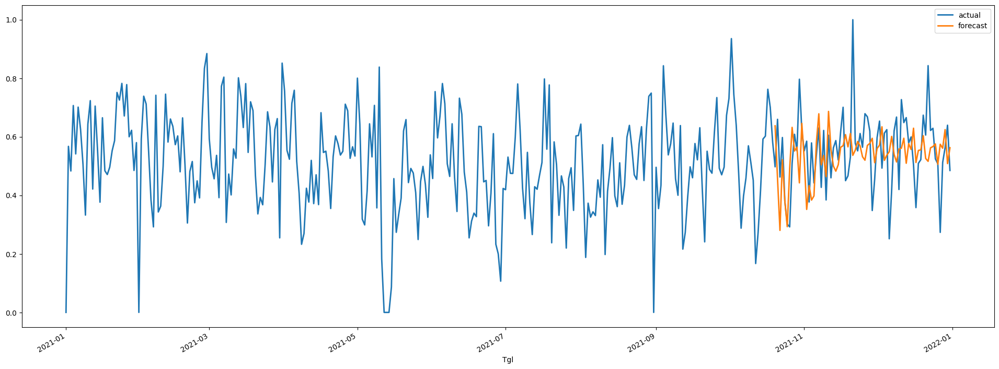

In [ ]:
# prediction for PET
mpl.style.use('default')
pred = rnn_pet.predict(n=73, series=train_pet)

pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_run_pet_rnn.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(24,8))
series_pet_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_pet_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_pet_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_pet_scaled, pred)))
print("SMAPE = {:.3f}".format(smape(series_pet_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_pet_scaled, pred)))

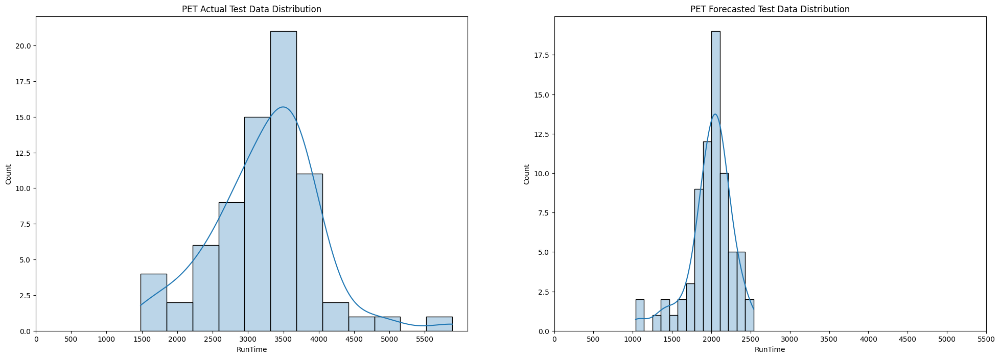

In [ ]:
# normal distribution for PET
pred_pet = pd.read_csv('/content/pred_run_pet_rnn.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(pet.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('PET Actual Test Data Distribution')
axarr[0].set_xticks(np.arange(start=0,stop=6000,step=500))

# plot forecasted test data
sns.histplot(pred_pet['RunTime'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('PET Forecasted Test Data Distribution')
axarr[1].set_xticks(np.arange(start=0,stop=6000,step=500))

plt.show()

Predicting: 9it [00:00, ?it/s]

RMSE = 0.252
MAE = 0.186
MSE = 0.064
SMAPE = 87.59
OPE = 35.644%


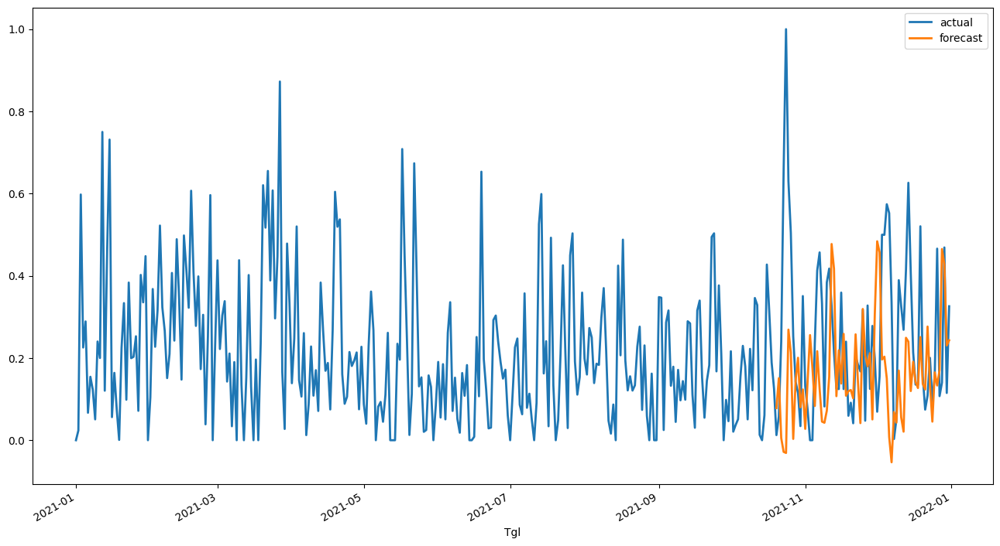

In [ ]:
# prediction for NYL
pred = rnn_nyl.predict(n=73, series=train_nyl)

pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_run_nyl_rnn.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_nyl_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_nyl_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_nyl_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_nyl_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_nyl_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_nyl_scaled, pred)))

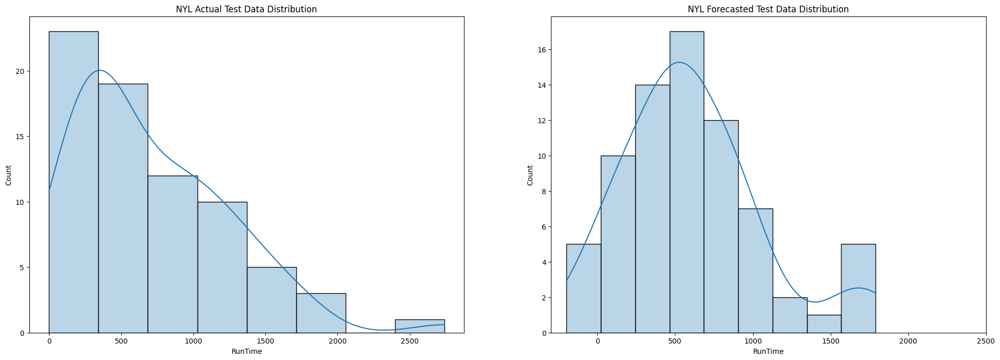

In [ ]:
# normal distribution for NYL
mpl.style.use('default')

pred_nyl = pd.read_csv('/content/pred_run_nyl_rnn.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(nyl.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('NYL Actual Test Data Distribution')
axarr[0].set_xticks(np.arange(start=0,stop=3000,step=500))

# plot forecasted test data
sns.histplot(pred_nyl['RunTime'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('NYL Forecasted Test Data Distribution')
axarr[1].set_xticks(np.arange(start=0,stop=3000,step=500))

plt.show()

Predicting: 9it [00:00, ?it/s]

RMSE = 0.195
MAE = 0.154
MSE = 0.038
SMAPE = 67.70
OPE = 17.026%


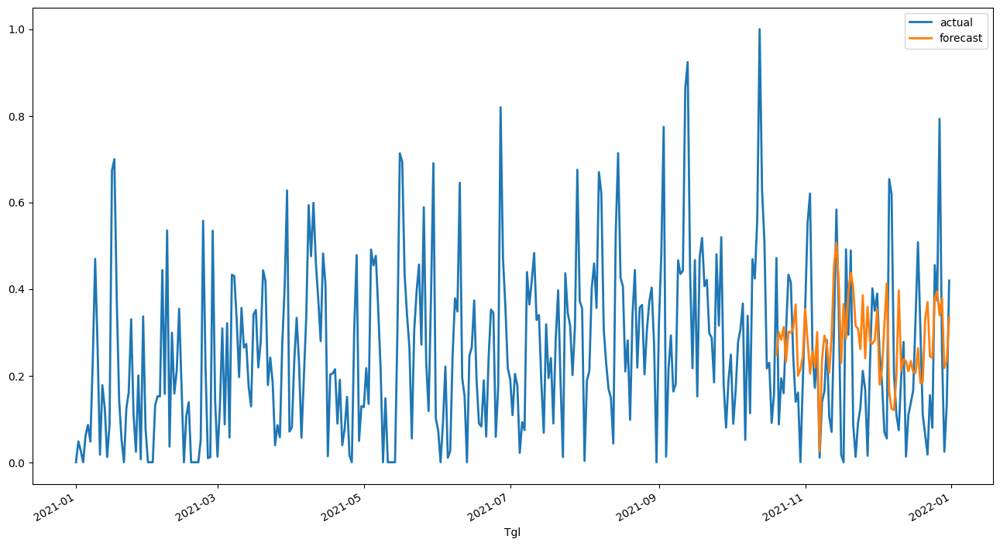

In [ ]:
# prediction for OPP
pred = rnn_opp.predict(n=73, series=train_opp)
pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_run_opp_rnn.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_opp_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_opp_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_opp_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_opp_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_opp_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_opp_scaled, pred)))

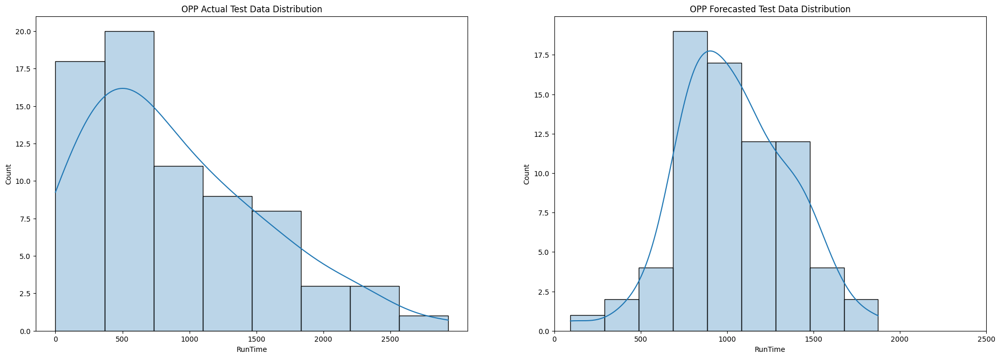

In [ ]:
# normal distribution for OPP

pred_opp = pd.read_csv('/content/pred_run_opp_rnn.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(opp.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('OPP Actual Test Data Distribution')
axarr[0].set_xticks(np.arange(start=0,stop=3000,step=500))

# plot forecasted test data
sns.histplot(pred_opp['RunTime'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('OPP Forecasted Test Data Distribution')
axarr[1].set_xticks(np.arange(start=0,stop=3000,step=500))

plt.show()

### **Forecasting Daily Runtime by Machine With RNN**

In [ ]:
PR01 = run[run['KdMesin']=='PR01'].pivot_table(values='RunTime', index='Tgl', fill_value=0, aggfunc=np.sum)
PR01 = PR01.reindex(idx, fill_value=0).reset_index()
PR02 = run[run['KdMesin']=='PR02'].pivot_table(values='RunTime', index='Tgl', fill_value=0, aggfunc=np.sum)
PR02 = PR02.reindex(idx, fill_value=0).reset_index()
PR03 = run[run['KdMesin']=='PR03'].pivot_table(values='RunTime', index='Tgl', fill_value=0, aggfunc=np.sum)
PR03 = PR03.reindex(idx, fill_value=0).reset_index()
PR05 = run[run['KdMesin']=='PR05'].pivot_table(values='RunTime', index='Tgl', fill_value=0, aggfunc=np.sum)
PR05 = PR05.reindex(idx, fill_value=0).reset_index()
PR06 = run[run['KdMesin']=='PR06'].pivot_table(values='RunTime', index='Tgl', fill_value=0, aggfunc=np.sum)
PR06 = PR06.reindex(idx, fill_value=0).reset_index()
PR07 = run[run['KdMesin']=='PR07'].pivot_table(values='RunTime', index='Tgl', fill_value=0, aggfunc=np.sum)
PR07 = PR07.reindex(idx, fill_value=0).reset_index()

In [ ]:
# defining time series by material
PR01_series = TimeSeries.from_dataframe(PR01, 'index','RunTime')
PR02_series = TimeSeries.from_dataframe(PR02, 'index','RunTime')
PR03_series = TimeSeries.from_dataframe(PR03, 'index','RunTime')
PR05_series = TimeSeries.from_dataframe(PR05, 'index','RunTime')
PR06_series = TimeSeries.from_dataframe(PR06, 'index','RunTime')
PR07_series = TimeSeries.from_dataframe(PR07, 'index','RunTime')

In [ ]:
# check seasonality for PR01
is_seasonal, pr01_periodicity = check_seasonality(PR01_series, max_lag=240)
dict_seas ={
    "PR01 is seasonal?":is_seasonal,
    "pr01_periodicity (days)":f'{pr01_periodicity:.1f}', 
    "pr01_periodicity (~months)": f'{pr01_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

PR01 is seasonal? : True
pr01_periodicity (days) : 7.0
pr01_periodicity (~months) : 0.2


In [ ]:
# check seasonality for PR02
is_seasonal, pr02_periodicity = check_seasonality(PR02_series, max_lag=240)
dict_seas ={
    "PR02 is seasonal?":is_seasonal,
    "pr02_periodicity (days)":f'{pr02_periodicity:.1f}', 
    "pr02_periodicity (~months)": f'{pr02_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

PR02 is seasonal? : True
pr02_periodicity (days) : 7.0
pr02_periodicity (~months) : 0.2


In [ ]:
# check seasonality for PR03
is_seasonal, pr03_periodicity = check_seasonality(PR03_series, max_lag=240)
dict_seas ={
    "PR03 is seasonal?":is_seasonal,
    "pr03_periodicity (days)":f'{pr03_periodicity:.1f}', 
    "pr03_periodicity (~months)": f'{pr03_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

PR03 is seasonal? : True
pr03_periodicity (days) : 6.0
pr03_periodicity (~months) : 0.2


In [ ]:
# check seasonality for PR05
is_seasonal, pr05_periodicity = check_seasonality(PR05_series, max_lag=240)
dict_seas ={
    "PR05 is seasonal?":is_seasonal,
    "pr05_periodicity (days)":f'{pr05_periodicity:.1f}', 
    "pr05_periodicity (~months)": f'{pr05_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

PR05 is seasonal? : True
pr05_periodicity (days) : 3.0
pr05_periodicity (~months) : 0.1


In [ ]:
# check seasonality for PR06
is_seasonal, pr06_periodicity = check_seasonality(PR06_series, max_lag=240)
dict_seas ={
    "PR06 is seasonal?":is_seasonal,
    "pr06_periodicity (days)":f'{pr06_periodicity:.1f}', 
    "pr06_periodicity (~months)": f'{pr06_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

PR06 is seasonal? : True
pr06_periodicity (days) : 8.0
pr06_periodicity (~months) : 0.3


In [ ]:
# check seasonality for PR07
is_seasonal, pr07_periodicity = check_seasonality(PR07_series, max_lag=240)
dict_seas ={
    "PR07 is seasonal?":is_seasonal,
    "pr07_periodicity (days)":f'{pr07_periodicity:.1f}', 
    "pr07_periodicity (~months)": f'{pr07_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

PR07 is seasonal? : True
pr07_periodicity (days) : 6.0
pr07_periodicity (~months) : 0.2


In [ ]:
# data normalization
scaler= Scaler()
series_PR01_scaled = scaler.fit_transform(PR01_series)
series_PR02_scaled = scaler.fit_transform(PR02_series)
series_PR03_scaled = scaler.fit_transform(PR03_series)
series_PR05_scaled = scaler.fit_transform(PR05_series)
series_PR06_scaled = scaler.fit_transform(PR06_series)
series_PR07_scaled = scaler.fit_transform(PR07_series)

In [ ]:
# train test split
train_PR01, val_PR01 = series_PR01_scaled[:-73], series_PR01_scaled[-73:]
train_PR02, val_PR02 = series_PR02_scaled[:-73], series_PR02_scaled[-73:]
train_PR03, val_PR03 = series_PR03_scaled[:-73], series_PR03_scaled[-73:]
train_PR05, val_PR05 = series_PR05_scaled[:-73], series_PR05_scaled[-73:]
train_PR06, val_PR06 = series_PR06_scaled[:-73], series_PR06_scaled[-73:]
train_PR07, val_PR07 = series_PR07_scaled[:-73], series_PR07_scaled[-73:]

In [ ]:
# defining and training the model for PR01
rnn_PR01= RNNModel(
    model="RNN",
    input_chunk_length=pr01_periodicity,
    output_chunk_length=30,
    n_rnn_layers=3,
    batch_size=32,
    n_epochs=300,
    dropout=0.1,
    optimizer_kwargs={"lr": 1e-3},
    log_tensorboard=True,
    random_state=42,
    force_reset=True,
)
rnn_PR01.fit(train_PR01)

[2022-03-29 02:25:29,794] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 268 samples.
[2022-03-29 02:25:29,794] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 268 samples.
[2022-03-29 02:25:29,805] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
[2022-03-29 02:25:29,805] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs

  | Name      | Type    | Params
--------------------------------------
0 | criterion | MSELoss | 0     
1 | rnn       | RNN     | 3.3 K 
2 | V         | Linear  | 26    
--------------------------------------
3.3 K     Trainable params
0         Non-trainable params
3.3 K     Total params
0.027     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

In [ ]:
# defining and training the model for PR02
rnn_PR02= RNNModel(
    model="RNN",
    input_chunk_length=pr02_periodicity,
    output_chunk_length=30,
    n_rnn_layers=3,
    batch_size=32,
    n_epochs=300,
    dropout=0.1,
    optimizer_kwargs={"lr": 1e-3},
    log_tensorboard=True,
    random_state=42,
    force_reset=True,
)
rnn_PR02.fit(train_PR02)

[2022-03-29 02:26:38,841] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 268 samples.
[2022-03-29 02:26:38,841] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 268 samples.
[2022-03-29 02:26:38,851] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
[2022-03-29 02:26:38,851] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs

  | Name      | Type    | Params
--------------------------------------
0 | criterion | MSELoss | 0     
1 | rnn       | RNN     | 3.3 K 
2 | V         | Linear  | 26    
--------------------------------------
3.3 K     Trainable params
0         Non-trainable params
3.3 K     Total params
0.027     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

In [ ]:
# defining and training the model for PR03
rnn_PR03= RNNModel(
    model="RNN",
    input_chunk_length=pr03_periodicity,
    output_chunk_length=30,
    n_rnn_layers=3,
    batch_size=32,
    n_epochs=300,
    dropout=0.1,
    optimizer_kwargs={"lr": 1e-3},
    log_tensorboard=True,
    random_state=42,
    force_reset=True,
)
rnn_PR03.fit(train_PR03)

[2022-03-29 02:27:42,161] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 268 samples.
[2022-03-29 02:27:42,161] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 268 samples.
[2022-03-29 02:27:42,170] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
[2022-03-29 02:27:42,170] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs

  | Name      | Type    | Params
--------------------------------------
0 | criterion | MSELoss | 0     
1 | rnn       | RNN     | 3.3 K 
2 | V         | Linear  | 26    
--------------------------------------
3.3 K     Trainable params
0         Non-trainable params
3.3 K     Total params
0.027     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

In [ ]:
# defining and training the model for PR05
rnn_PR05= RNNModel(
    model="RNN",
    input_chunk_length=pr05_periodicity,
    output_chunk_length=30,
    n_rnn_layers=3,
    batch_size=32,
    n_epochs=300,
    dropout=0.1,
    optimizer_kwargs={"lr": 1e-3},
    log_tensorboard=True,
    random_state=42,
    force_reset=True,
)
rnn_PR05.fit(train_PR05)

[2022-03-29 02:28:45,060] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 268 samples.
[2022-03-29 02:28:45,060] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 268 samples.
[2022-03-29 02:28:45,069] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
[2022-03-29 02:28:45,069] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs

  | Name      | Type    | Params
--------------------------------------
0 | criterion | MSELoss | 0     
1 | rnn       | RNN     | 3.3 K 
2 | V         | Linear  | 26    
--------------------------------------
3.3 K     Trainable params
0         Non-trainable params
3.3 K     Total params
0.027     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

In [ ]:
# defining and training the model for PR06
rnn_PR06= RNNModel(
    model="RNN",
    input_chunk_length=pr06_periodicity,
    output_chunk_length=30,
    n_rnn_layers=3,
    batch_size=32,
    n_epochs=300,
    dropout=0.1,
    optimizer_kwargs={"lr": 1e-3},
    log_tensorboard=True,
    random_state=42,
    force_reset=True,
)
rnn_PR06.fit(train_PR06)

[2022-03-29 02:29:48,031] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 268 samples.
[2022-03-29 02:29:48,031] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 268 samples.
[2022-03-29 02:29:48,041] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
[2022-03-29 02:29:48,041] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs

  | Name      | Type    | Params
--------------------------------------
0 | criterion | MSELoss | 0     
1 | rnn       | RNN     | 3.3 K 
2 | V         | Linear  | 26    
--------------------------------------
3.3 K     Trainable params
0         Non-trainable params
3.3 K     Total params
0.027     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

In [ ]:
# defining and training the model for PR07
rnn_PR07= RNNModel(
    model="RNN",
    input_chunk_length=pr07_periodicity,
    output_chunk_length=30,
    n_rnn_layers=3,
    batch_size=32,
    n_epochs=300,
    dropout=0.1,
    optimizer_kwargs={"lr": 1e-3},
    log_tensorboard=True,
    random_state=42,
    force_reset=True,
)
rnn_PR07.fit(train_PR07)

[2022-03-29 02:30:51,370] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 268 samples.
[2022-03-29 02:30:51,370] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 268 samples.
[2022-03-29 02:30:51,379] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
[2022-03-29 02:30:51,379] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs

  | Name      | Type    | Params
--------------------------------------
0 | criterion | MSELoss | 0     
1 | rnn       | RNN     | 3.3 K 
2 | V         | Linear  | 26    
--------------------------------------
3.3 K     Trainable params
0         Non-trainable params
3.3 K     Total params
0.027     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

Predicting: 9it [00:00, ?it/s]

RMSE = 0.199
MAE = 0.153
MSE = 0.039
SMAPE = 26.314
OPE = 7.277%


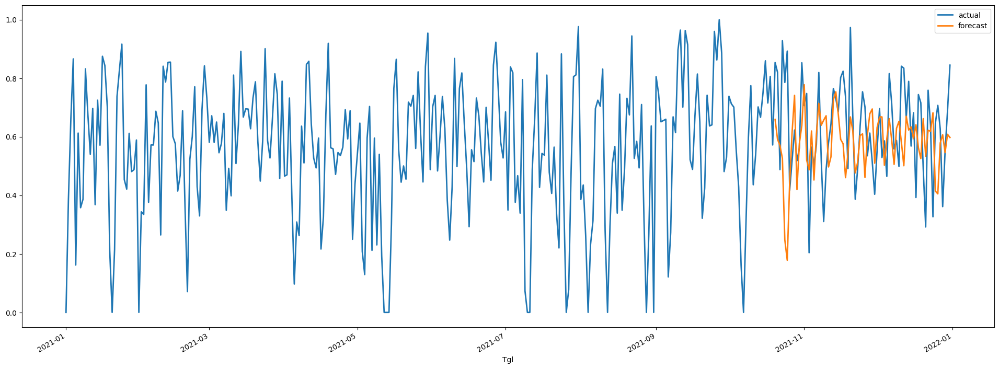

In [ ]:
# prediction for PR01
mpl.style.use('default')
pred = rnn_PR01.predict(n=73, series=train_PR01)

pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_run_PR01_rnn.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(24,8))
series_PR01_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_PR01_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_PR01_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_PR01_scaled, pred)))
print("SMAPE = {:.3f}".format(smape(series_PR01_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_PR01_scaled, pred)))

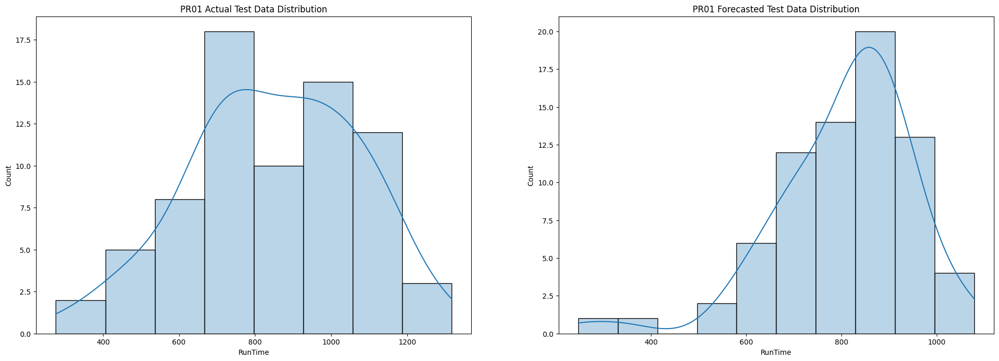

In [ ]:
# normal distribution for PR01
pred_PR01 = pd.read_csv('/content/pred_run_PR01_rnn.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(PR01.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('PR01 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_PR01['RunTime'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('PR01 Forecasted Test Data Distribution')

plt.show()

Predicting: 9it [00:00, ?it/s]

RMSE = 0.182
MAE = 0.146
MSE = 0.033
SMAPE = 30.34
OPE = 9.385%


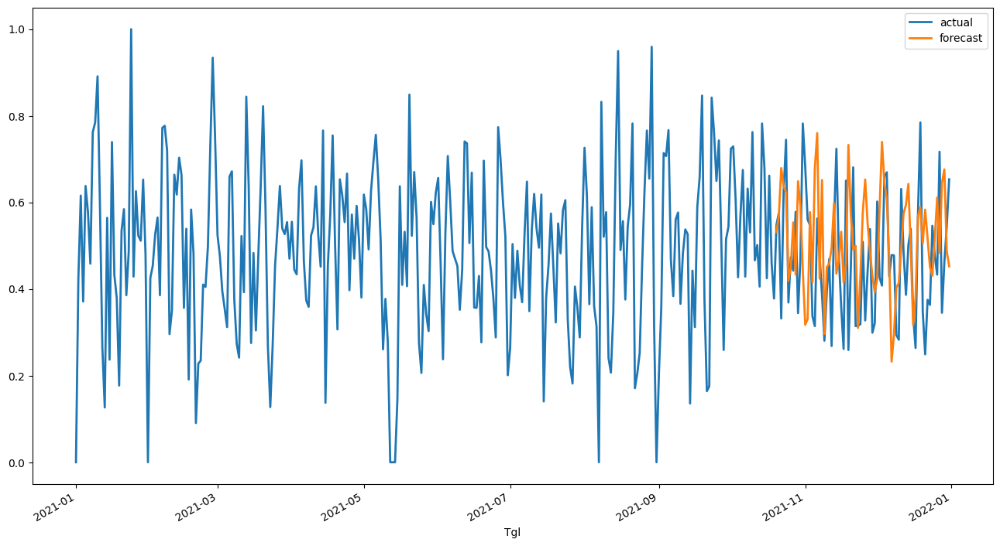

In [ ]:
# prediction for PR02
pred = rnn_PR02.predict(n=73, series=train_PR02)

pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_run_PR02_rnn.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_PR02_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_PR02_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_PR02_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_PR02_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_PR02_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_PR02_scaled, pred)))

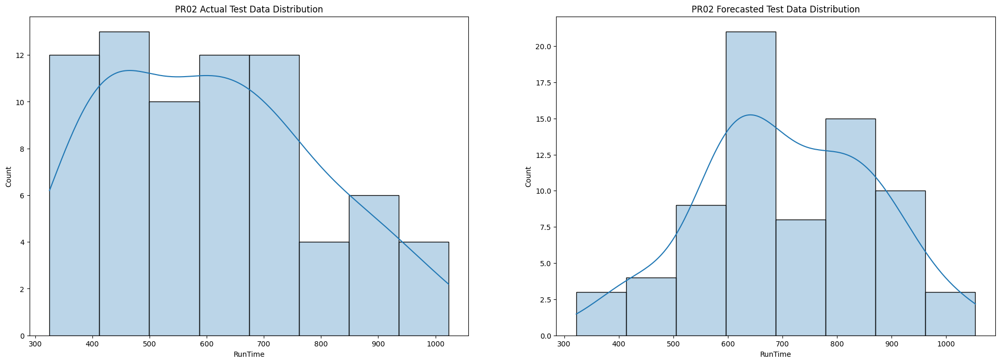

In [ ]:
# normal distribution for PR02
mpl.style.use('default')

pred_PR02 = pd.read_csv('/content/pred_run_PR02_rnn.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(PR02.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('PR02 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_PR02['RunTime'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('PR02 Forecasted Test Data Distribution')
plt.show()

Predicting: 9it [00:00, ?it/s]

RMSE = 0.230
MAE = 0.197
MSE = 0.053
SMAPE = 32.63
OPE = 10.374%


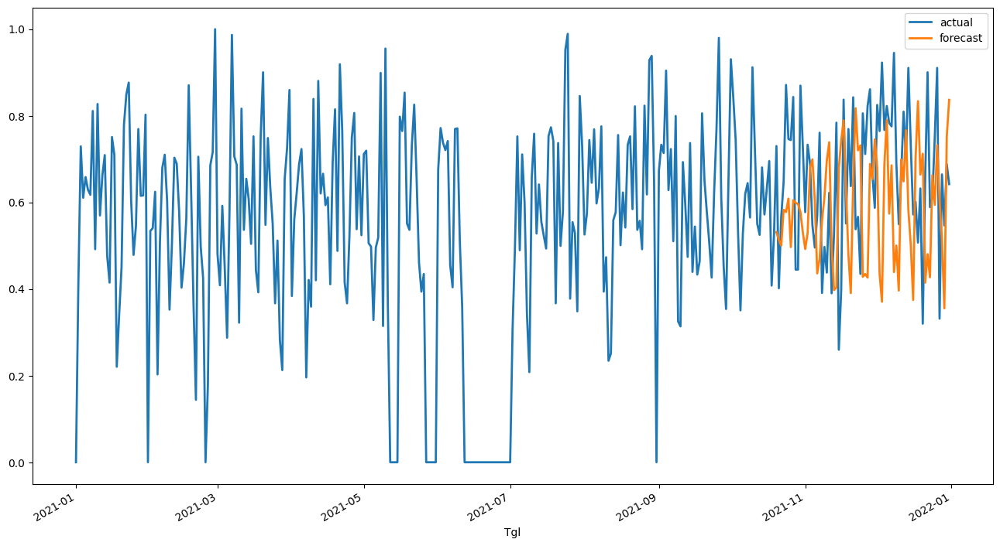

In [ ]:
# prediction for PR03
pred = rnn_PR03.predict(n=73, series=train_PR03)
pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_run_PR03_rnn.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_PR03_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_PR03_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_PR03_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_PR03_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_PR03_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_PR03_scaled, pred)))

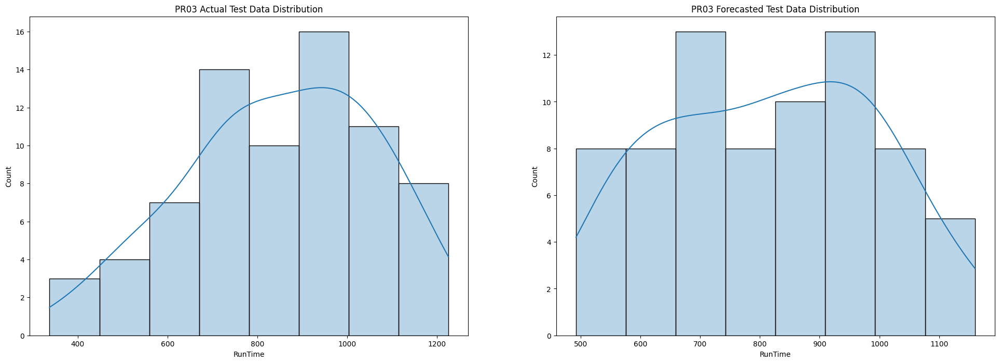

In [ ]:
# normal distribution for PR03

pred_PR03 = pd.read_csv('/content/pred_run_PR03_rnn.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(PR03.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('PR03 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_PR03['RunTime'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('PR03 Forecasted Test Data Distribution')

plt.show()

Predicting: 9it [00:00, ?it/s]

RMSE = 0.122
MAE = 0.100
MSE = 0.015
SMAPE = 13.78
OPE = 2.170%


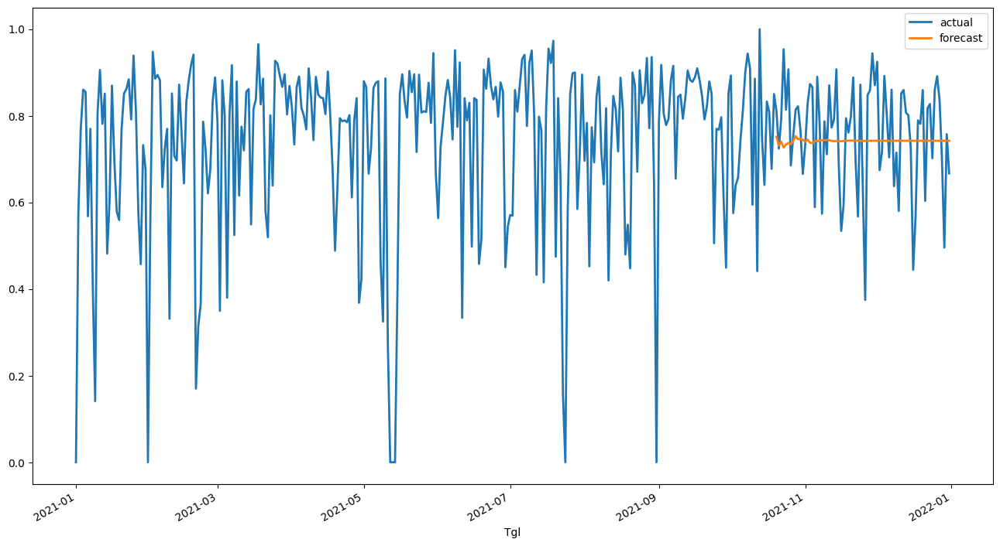

In [ ]:
# prediction for PR05
pred = rnn_PR05.predict(n=73, series=train_PR05)
pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_run_PR05_rnn.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_PR05_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_PR05_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_PR05_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_PR05_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_PR05_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_PR05_scaled, pred)))

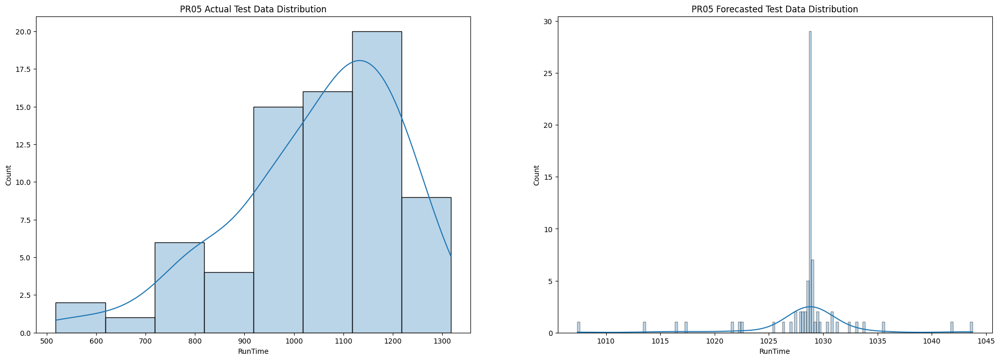

In [ ]:
# normal distribution for PR05

pred_PR05 = pd.read_csv('/content/pred_run_PR05_rnn.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(PR05.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('PR05 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_PR05['RunTime'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('PR05 Forecasted Test Data Distribution')

plt.show()


Predicting: 9it [00:00, ?it/s]

RMSE = 0.305
MAE = 0.231
MSE = 0.093
SMAPE = 55.33
OPE = 41.567%


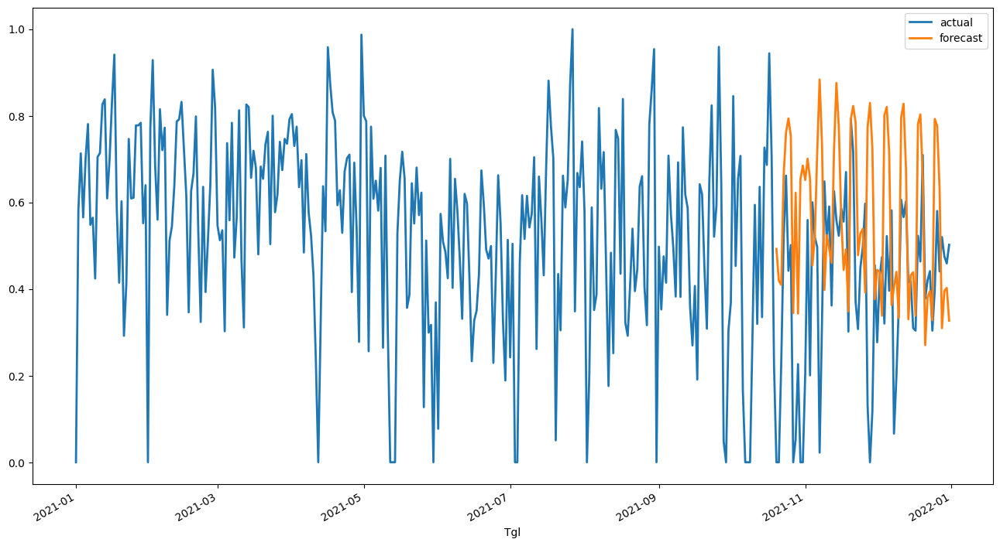

In [ ]:
# prediction for PR06
pred = rnn_PR06.predict(n=73, series=train_PR06)
pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_run_PR06_rnn.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_PR06_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_PR06_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_PR06_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_PR06_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_PR06_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_PR06_scaled, pred)))

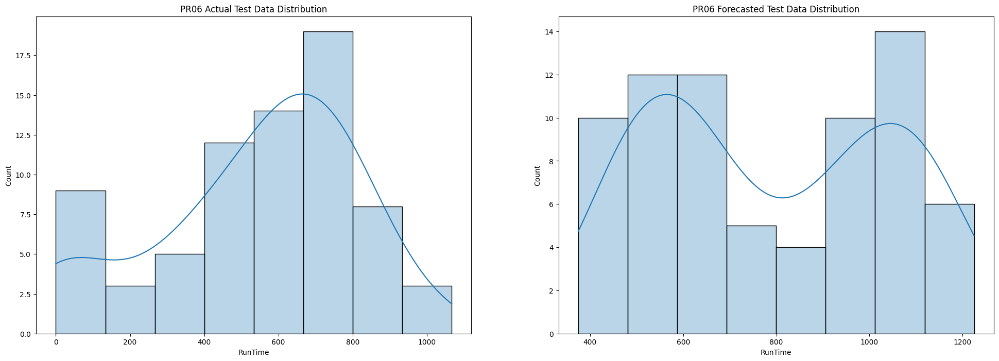

In [ ]:
# normal distribution for PR06

pred_PR06 = pd.read_csv('/content/pred_run_PR06_rnn.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(PR06.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('PR06 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_PR06['RunTime'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('PR06 Forecasted Test Data Distribution')

plt.show()

Predicting: 9it [00:00, ?it/s]

RMSE = 0.169
MAE = 0.131
MSE = 0.029
SMAPE = 18.49
OPE = 2.737%


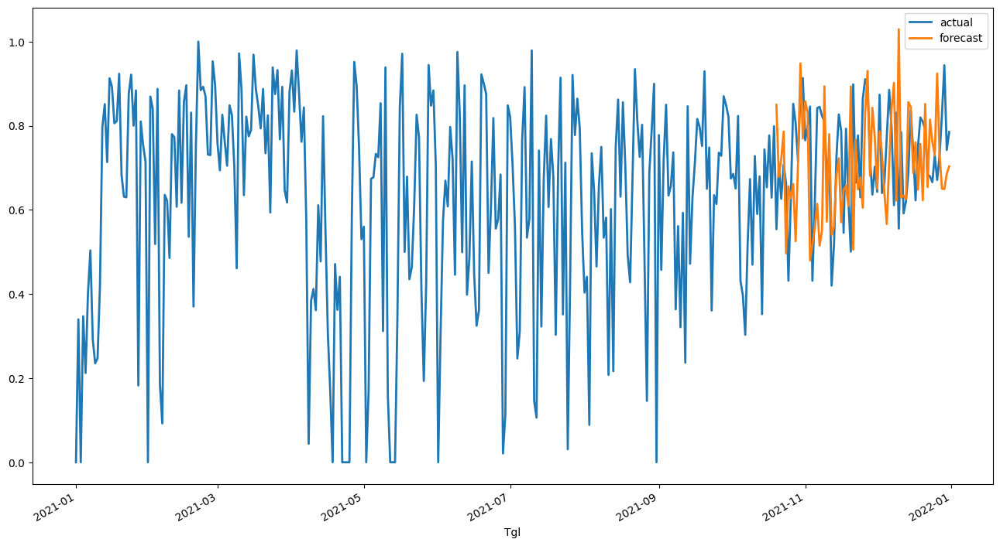

In [ ]:
# prediction for PR07
pred = rnn_PR07.predict(n=73, series=train_PR07)
pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_run_PR07_rnn.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_PR07_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_PR07_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_PR07_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_PR07_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_PR07_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_PR07_scaled, pred)))

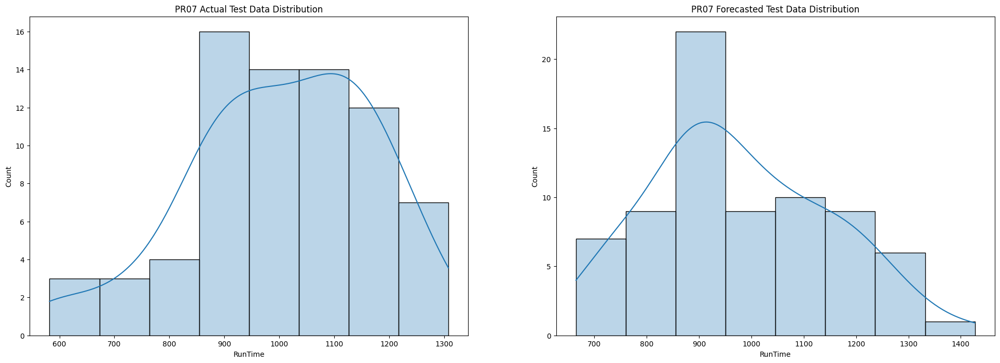

In [ ]:
# normal distribution for PR07

pred_PR07 = pd.read_csv('/content/pred_run_PR07_rnn.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(PR07.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('PR07 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_PR07['RunTime'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('PR07 Forecasted Test Data Distribution')

plt.show()

## **Forecasting Daily Speed Data with RNN**

### **Forecasting Daily Speed by Material with RNN**

In [ ]:
idx = pd.date_range('2021-01-01', '2021-12-31')
pet = run[run['FILM']=='PET'].pivot_table(values='Speed', index='Tgl', fill_value=0, aggfunc=np.mean)
pet = pet.reindex(idx, fill_value=0).reset_index()
nyl = run[run['FILM']=='NYL'].pivot_table(values='Speed', index='Tgl', fill_value=0, aggfunc=np.mean)
nyl = nyl.reindex(idx, fill_value=0).reset_index()
opp = run[run['FILM']=='OPP'].pivot_table(values='Speed', index='Tgl', fill_value=0, aggfunc=np.mean)
opp = opp.reindex(idx, fill_value=0).reset_index()

In [ ]:
# defining time series by material
pet_series = TimeSeries.from_dataframe(pet, 'index','Speed')
nyl_series = TimeSeries.from_dataframe(nyl, 'index','Speed')
opp_series = TimeSeries.from_dataframe(opp, 'index','Speed')

In [ ]:
# check seasonality for PET
is_seasonal, pet_periodicity = check_seasonality(pet_series, max_lag=240)
dict_seas ={
    "PET is seasonal?":is_seasonal,
    "pet_periodicity (days)":f'{pet_periodicity:.1f}', 
    "pet_periodicity (~months)": f'{pet_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

PET is seasonal? : True
pet_periodicity (days) : 7.0
pet_periodicity (~months) : 0.2


In [ ]:
# check seasonality for NYL
is_seasonal, nyl_periodicity = check_seasonality(nyl_series, max_lag=240)
dict_seas ={
    "NYL is seasonal?":is_seasonal,
    "nyl_periodicity (days)":f'{nyl_periodicity:.1f}', 
    "nyl_periodicity (~months)": f'{nyl_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

NYL is seasonal? : True
nyl_periodicity (days) : 6.0
nyl_periodicity (~months) : 0.2


In [ ]:
is_seasonal, opp_periodicity = check_seasonality(opp_series, max_lag=240)
dict_seas ={
    "OPP is seasonal?":is_seasonal,
    "opp_periodicity (days)":f'{opp_periodicity:.1f}', 
    "opp_periodicity (~months)": f'{opp_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

OPP is seasonal? : True
opp_periodicity (days) : 7.0
opp_periodicity (~months) : 0.2


In [ ]:
# defining and training the model for PET
rnn_pet= RNNModel(
    model="RNN",
    input_chunk_length=pet_periodicity,
    output_chunk_length=30,
    n_rnn_layers=3,
    batch_size=32,
    n_epochs=300,
    dropout=0.1,
    optimizer_kwargs={"lr": 1e-3},
    log_tensorboard=True,
    random_state=42,
    force_reset=True,
)
rnn_pet.fit(train_pet)

[2022-03-28 09:07:47,459] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 268 samples.
[2022-03-28 09:07:47,459] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 268 samples.
[2022-03-28 09:07:47,472] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
[2022-03-28 09:07:47,472] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs

  | Name      | Type    | Params
--------------------------------------
0 | criterion | MSELoss | 0     
1 | rnn       | RNN     | 3.3 K 
2 | V         | Linear  | 26    
--------------------------------------
3.3 K     Trainable params
0         Non-trainable params
3.3 K     Total params
0.027     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

In [ ]:
# defining and training the model for NYL
rnn_nyl= RNNModel(
    model="RNN",
    input_chunk_length=nyl_periodicity,
    output_chunk_length=30,
    n_rnn_layers=3,
    batch_size=32,
    n_epochs=300,
    dropout=0.1,
    optimizer_kwargs={"lr": 1e-3},
    log_tensorboard=True,
    random_state=42,
    force_reset=True,
)
rnn_nyl.fit(train_nyl)

[2022-03-28 09:09:22,564] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 268 samples.
[2022-03-28 09:09:22,564] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 268 samples.
[2022-03-28 09:09:22,573] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
[2022-03-28 09:09:22,573] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs

  | Name      | Type    | Params
--------------------------------------
0 | criterion | MSELoss | 0     
1 | rnn       | RNN     | 3.3 K 
2 | V         | Linear  | 26    
--------------------------------------
3.3 K     Trainable params
0         Non-trainable params
3.3 K     Total params
0.027     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

In [ ]:
# defining and training the model for OPP
rnn_opp= RNNModel(
    model="RNN",
    input_chunk_length=opp_periodicity,
    output_chunk_length=30,
    n_rnn_layers=3,
    batch_size=32,
    n_epochs=300,
    dropout=0.1,
    optimizer_kwargs={"lr": 1e-3},
    log_tensorboard=True,
    random_state=42,
    force_reset=True,
)
rnn_opp.fit(train_opp)

[2022-03-28 09:10:50,535] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 268 samples.
[2022-03-28 09:10:50,535] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 268 samples.
[2022-03-28 09:10:50,543] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
[2022-03-28 09:10:50,543] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs

  | Name      | Type    | Params
--------------------------------------
0 | criterion | MSELoss | 0     
1 | rnn       | RNN     | 3.3 K 
2 | V         | Linear  | 26    
--------------------------------------
3.3 K     Trainable params
0         Non-trainable params
3.3 K     Total params
0.027     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

Predicting: 9it [00:00, ?it/s]

RMSE = 0.060
MAE = 0.045
MSE = 0.004
SMAPE = 6.011
OPE = 0.082%


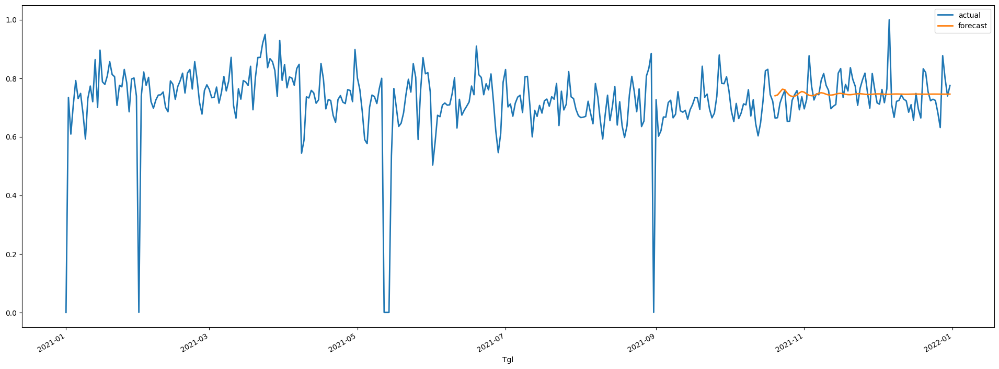

In [ ]:
# prediction for PET
mpl.style.use('default')
pred = rnn_pet.predict(n=73, series=train_pet)

pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_speed_pet_rnn.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(24,8))
series_pet_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_pet_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_pet_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_pet_scaled, pred)))
print("SMAPE = {:.3f}".format(smape(series_pet_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_pet_scaled, pred)))

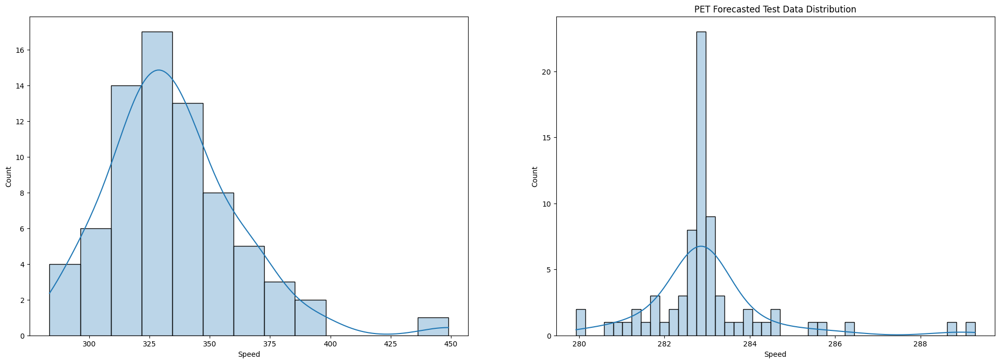

In [ ]:
# normal distribution for PET
pred_pet = pd.read_csv('/content/pred_speed_pet_rnn.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(pet.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)

# plot forecasted test data
sns.histplot(pred_pet['Speed'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('PET Forecasted Test Data Distribution')

plt.show()

Predicting: 9it [00:00, ?it/s]

RMSE = 0.212
MAE = 0.167
MSE = 0.045
SMAPE = 29.89
OPE = 10.404%


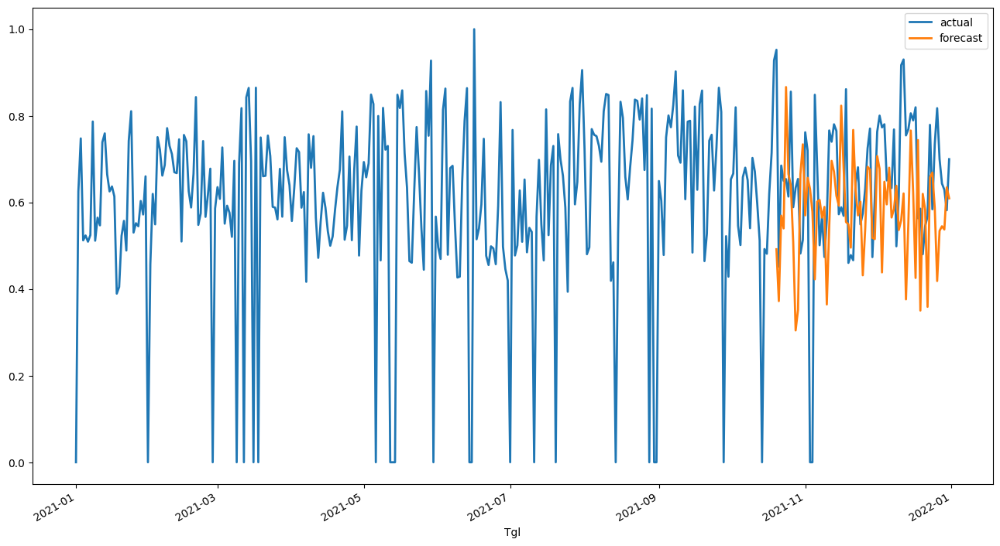

In [ ]:
# prediction for NYL
pred = rnn_nyl.predict(n=73, series=train_nyl)

pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_speed_nyl_rnn.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_nyl_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_nyl_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_nyl_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_nyl_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_nyl_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_nyl_scaled, pred)))

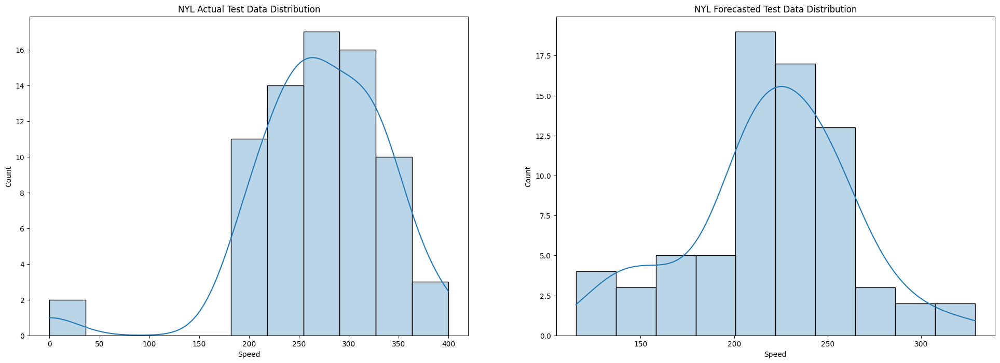

In [ ]:
# normal distribution for NYL
mpl.style.use('default')

pred_nyl = pd.read_csv('/content/pred_speed_nyl_rnn.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(nyl.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('NYL Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_nyl['Speed'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('NYL Forecasted Test Data Distribution')

plt.show()

Predicting: 9it [00:00, ?it/s]

RMSE = 0.186
MAE = 0.150
MSE = 0.035
SMAPE = 23.99
OPE = 5.938%


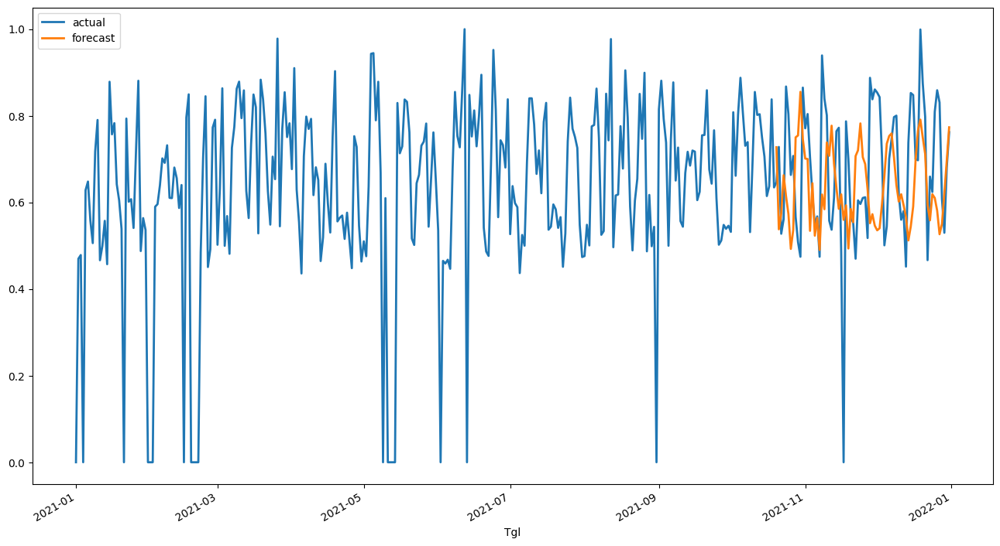

In [ ]:
# prediction for OPP
pred = rnn_opp.predict(n=73, series=train_opp)
pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_speed_opp_rnn.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_opp_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_opp_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_opp_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_opp_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_opp_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_opp_scaled, pred)))

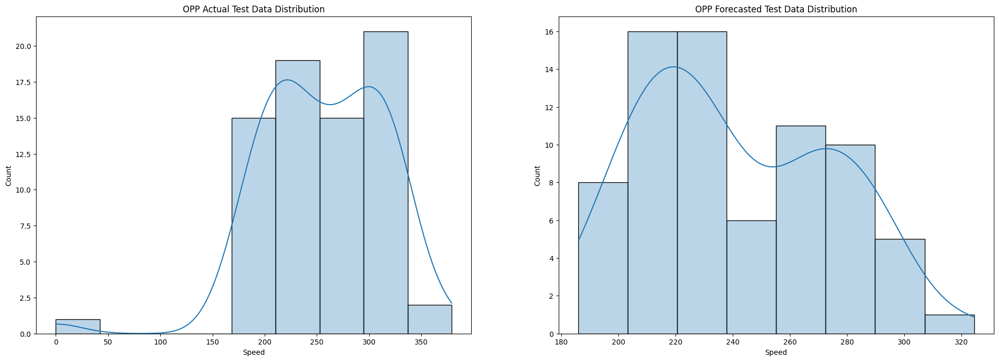

In [ ]:
# normal distribution for OPP

pred_opp = pd.read_csv('/content/pred_speed_opp_rnn.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(opp.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('OPP Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_opp['Speed'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('OPP Forecasted Test Data Distribution')

plt.show()

### **Forecasting Daily Speed by Machine with RNN**

In [ ]:
PR01 = run[run['KdMesin']=='PR01'].pivot_table(values='Speed', index='Tgl', fill_value=0, aggfunc=np.mean)
PR01 = PR01.reindex(idx, fill_value=0).reset_index()
PR02 = run[run['KdMesin']=='PR02'].pivot_table(values='Speed', index='Tgl', fill_value=0, aggfunc=np.mean)
PR02 = PR02.reindex(idx, fill_value=0).reset_index()
PR03 = run[run['KdMesin']=='PR03'].pivot_table(values='Speed', index='Tgl', fill_value=0, aggfunc=np.mean)
PR03 = PR03.reindex(idx, fill_value=0).reset_index()
PR05 = run[run['KdMesin']=='PR05'].pivot_table(values='Speed', index='Tgl', fill_value=0, aggfunc=np.mean)
PR05 = PR05.reindex(idx, fill_value=0).reset_index()
PR06 = run[run['KdMesin']=='PR06'].pivot_table(values='Speed', index='Tgl', fill_value=0, aggfunc=np.mean)
PR06 = PR06.reindex(idx, fill_value=0).reset_index()
PR07 = run[run['KdMesin']=='PR07'].pivot_table(values='Speed', index='Tgl', fill_value=0, aggfunc=np.mean)
PR07 = PR07.reindex(idx, fill_value=0).reset_index()

In [ ]:
# defining time series by material
PR01_series = TimeSeries.from_dataframe(PR01, 'index','Speed')
PR02_series = TimeSeries.from_dataframe(PR02, 'index','Speed')
PR03_series = TimeSeries.from_dataframe(PR03, 'index','Speed')
PR05_series = TimeSeries.from_dataframe(PR05, 'index','Speed')
PR06_series = TimeSeries.from_dataframe(PR06, 'index','Speed')
PR07_series = TimeSeries.from_dataframe(PR07, 'index','Speed')

In [ ]:
# check seasonality for PR01
is_seasonal, pr01_periodicity = check_seasonality(PR01_series, max_lag=240)
dict_seas ={
    "PR01 is seasonal?":is_seasonal,
    "pr01_periodicity (days)":f'{pr01_periodicity:.1f}', 
    "pr01_periodicity (~months)": f'{pr01_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

PR01 is seasonal? : True
pr01_periodicity (days) : 5.0
pr01_periodicity (~months) : 0.2


In [ ]:
# check seasonality for PR02
is_seasonal, pr02_periodicity = check_seasonality(PR02_series, max_lag=240)
dict_seas ={
    "PR02 is seasonal?":is_seasonal,
    "pr02_periodicity (days)":f'{pr02_periodicity:.1f}', 
    "pr02_periodicity (~months)": f'{pr02_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

PR02 is seasonal? : True
pr02_periodicity (days) : 4.0
pr02_periodicity (~months) : 0.1


In [ ]:
# check seasonality for PR03
is_seasonal, pr03_periodicity = check_seasonality(PR03_series, max_lag=240)
dict_seas ={
    "PR03 is seasonal?":is_seasonal,
    "pr03_periodicity (days)":f'{pr03_periodicity:.1f}', 
    "pr03_periodicity (~months)": f'{pr03_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

PR03 is seasonal? : True
pr03_periodicity (days) : 16.0
pr03_periodicity (~months) : 0.5


In [ ]:
# check seasonality for PR05
is_seasonal, pr05_periodicity = check_seasonality(PR05_series, max_lag=240)
dict_seas ={
    "PR05 is seasonal?":is_seasonal,
    "pr05_periodicity (days)":f'{pr05_periodicity:.1f}', 
    "pr05_periodicity (~months)": f'{pr05_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

PR05 is seasonal? : True
pr05_periodicity (days) : 6.0
pr05_periodicity (~months) : 0.2


In [ ]:
# check seasonality for PR06
is_seasonal, pr06_periodicity = check_seasonality(PR06_series, max_lag=240)
dict_seas ={
    "PR06 is seasonal?":is_seasonal,
    "pr06_periodicity (days)":f'{pr06_periodicity:.1f}', 
    "pr06_periodicity (~months)": f'{pr06_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

PR06 is seasonal? : True
pr06_periodicity (days) : 11.0
pr06_periodicity (~months) : 0.4


In [ ]:
# check seasonality for PR07
is_seasonal, pr07_periodicity = check_seasonality(PR07_series, max_lag=240)
dict_seas ={
    "PR07 is seasonal?":is_seasonal,
    "pr07_periodicity (days)":f'{pr07_periodicity:.1f}', 
    "pr07_periodicity (~months)": f'{pr07_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

PR07 is seasonal? : True
pr07_periodicity (days) : 7.0
pr07_periodicity (~months) : 0.2


In [ ]:
# data normalization
scaler= Scaler()
series_PR01_scaled = scaler.fit_transform(PR01_series)
series_PR02_scaled = scaler.fit_transform(PR02_series)
series_PR03_scaled = scaler.fit_transform(PR03_series)
series_PR05_scaled = scaler.fit_transform(PR05_series)
series_PR06_scaled = scaler.fit_transform(PR06_series)
series_PR07_scaled = scaler.fit_transform(PR07_series)

In [ ]:
# train test split
train_PR01, val_PR01 = series_PR01_scaled[:-73], series_PR01_scaled[-73:]
train_PR02, val_PR02 = series_PR02_scaled[:-73], series_PR02_scaled[-73:]
train_PR03, val_PR03 = series_PR03_scaled[:-73], series_PR03_scaled[-73:]
train_PR05, val_PR05 = series_PR05_scaled[:-73], series_PR05_scaled[-73:]
train_PR06, val_PR06 = series_PR06_scaled[:-73], series_PR06_scaled[-73:]
train_PR07, val_PR07 = series_PR07_scaled[:-73], series_PR07_scaled[-73:]

In [ ]:
# defining and training the model for PR01
rnn_PR01= RNNModel(
    model="RNN",
    input_chunk_length=pr01_periodicity,
    output_chunk_length=30,
    n_rnn_layers=3,
    batch_size=32,
    n_epochs=300,
    dropout=0.1,
    optimizer_kwargs={"lr": 1e-3},
    log_tensorboard=True,
    random_state=42,
    force_reset=True,
)
rnn_PR01.fit(train_PR01)

[2022-03-29 04:42:10,187] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 268 samples.
[2022-03-29 04:42:10,187] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 268 samples.
[2022-03-29 04:42:10,196] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
[2022-03-29 04:42:10,196] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs

  | Name      | Type    | Params
--------------------------------------
0 | criterion | MSELoss | 0     
1 | rnn       | RNN     | 3.3 K 
2 | V         | Linear  | 26    
--------------------------------------
3.3 K     Trainable params
0         Non-trainable params
3.3 K     Total params
0.027     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

In [ ]:
# defining and training the model for PR02
rnn_PR02= RNNModel(
    model="RNN",
    input_chunk_length=pr02_periodicity,
    output_chunk_length=30,
    n_rnn_layers=3,
    batch_size=32,
    n_epochs=300,
    dropout=0.1,
    optimizer_kwargs={"lr": 1e-3},
    log_tensorboard=True,
    random_state=42,
    force_reset=True,
)
rnn_PR02.fit(train_PR02)

[2022-03-29 04:43:16,043] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 268 samples.
[2022-03-29 04:43:16,043] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 268 samples.
[2022-03-29 04:43:16,055] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
[2022-03-29 04:43:16,055] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs

  | Name      | Type    | Params
--------------------------------------
0 | criterion | MSELoss | 0     
1 | rnn       | RNN     | 3.3 K 
2 | V         | Linear  | 26    
--------------------------------------
3.3 K     Trainable params
0         Non-trainable params
3.3 K     Total params
0.027     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

In [ ]:
# defining and training the model for PR03
rnn_PR03= RNNModel(
    model="RNN",
    input_chunk_length=pr03_periodicity,
    output_chunk_length=30,
    n_rnn_layers=3,
    batch_size=32,
    n_epochs=300,
    dropout=0.1,
    optimizer_kwargs={"lr": 1e-3},
    log_tensorboard=True,
    random_state=42,
    force_reset=True,
)
rnn_PR03.fit(train_PR03)

[2022-03-29 04:44:23,002] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 268 samples.
[2022-03-29 04:44:23,002] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 268 samples.
[2022-03-29 04:44:23,012] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
[2022-03-29 04:44:23,012] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs

  | Name      | Type    | Params
--------------------------------------
0 | criterion | MSELoss | 0     
1 | rnn       | RNN     | 3.3 K 
2 | V         | Linear  | 26    
--------------------------------------
3.3 K     Trainable params
0         Non-trainable params
3.3 K     Total params
0.027     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

In [ ]:
# defining and training the model for PR05
rnn_PR05= RNNModel(
    model="RNN",
    input_chunk_length=pr05_periodicity,
    output_chunk_length=30,
    n_rnn_layers=3,
    batch_size=32,
    n_epochs=300,
    dropout=0.1,
    optimizer_kwargs={"lr": 1e-3},
    log_tensorboard=True,
    random_state=42,
    force_reset=True,
)
rnn_PR05.fit(train_PR05)

[2022-03-29 04:45:28,037] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 268 samples.
[2022-03-29 04:45:28,037] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 268 samples.
[2022-03-29 04:45:28,047] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
[2022-03-29 04:45:28,047] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs

  | Name      | Type    | Params
--------------------------------------
0 | criterion | MSELoss | 0     
1 | rnn       | RNN     | 3.3 K 
2 | V         | Linear  | 26    
--------------------------------------
3.3 K     Trainable params
0         Non-trainable params
3.3 K     Total params
0.027     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

In [ ]:
# defining and training the model for PR06
rnn_PR06= RNNModel(
    model="RNN",
    input_chunk_length=pr06_periodicity,
    output_chunk_length=30,
    n_rnn_layers=3,
    batch_size=32,
    n_epochs=300,
    dropout=0.1,
    optimizer_kwargs={"lr": 1e-3},
    log_tensorboard=True,
    random_state=42,
    force_reset=True,
)
rnn_PR06.fit(train_PR06)

[2022-03-29 04:46:34,023] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 268 samples.
[2022-03-29 04:46:34,023] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 268 samples.
[2022-03-29 04:46:34,032] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
[2022-03-29 04:46:34,032] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs

  | Name      | Type    | Params
--------------------------------------
0 | criterion | MSELoss | 0     
1 | rnn       | RNN     | 3.3 K 
2 | V         | Linear  | 26    
--------------------------------------
3.3 K     Trainable params
0         Non-trainable params
3.3 K     Total params
0.027     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

In [ ]:
# defining and training the model for PR07
rnn_PR07= RNNModel(
    model="RNN",
    input_chunk_length=pr07_periodicity,
    output_chunk_length=30,
    n_rnn_layers=3,
    batch_size=32,
    n_epochs=300,
    dropout=0.1,
    optimizer_kwargs={"lr": 1e-3},
    log_tensorboard=True,
    random_state=42,
    force_reset=True,
)
rnn_PR07.fit(train_PR07)

[2022-03-29 04:47:41,209] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 268 samples.
[2022-03-29 04:47:41,209] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 268 samples.
[2022-03-29 04:47:41,217] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
[2022-03-29 04:47:41,217] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs

  | Name      | Type    | Params
--------------------------------------
0 | criterion | MSELoss | 0     
1 | rnn       | RNN     | 3.3 K 
2 | V         | Linear  | 26    
--------------------------------------
3.3 K     Trainable params
0         Non-trainable params
3.3 K     Total params
0.027     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

Predicting: 9it [00:00, ?it/s]

RMSE = 0.078
MAE = 0.069
MSE = 0.006
SMAPE = 8.466
OPE = 7.969%


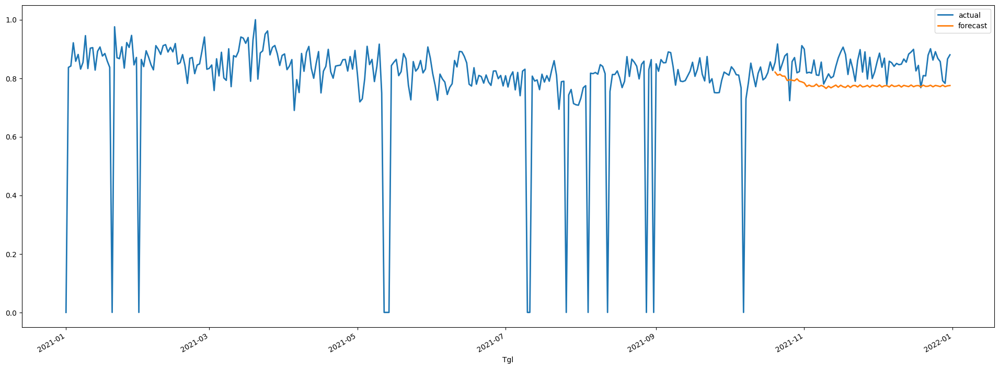

In [ ]:
# prediction for PR01
mpl.style.use('default')
pred = rnn_PR01.predict(n=73, series=train_PR01)

pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_speed_PR01_rnn.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(24,8))
series_PR01_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_PR01_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_PR01_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_PR01_scaled, pred)))
print("SMAPE = {:.3f}".format(smape(series_PR01_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_PR01_scaled, pred)))

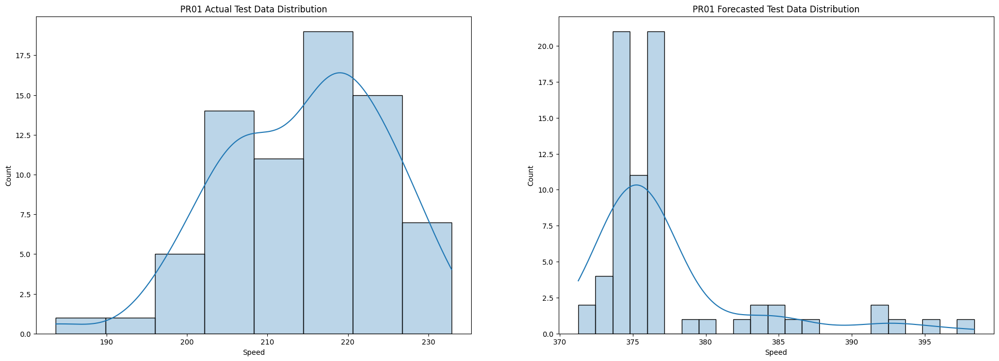

In [ ]:
# normal distribution for PR01
pred_PR01 = pd.read_csv('/content/pred_speed_PR01_rnn.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(PR01.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('PR01 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_PR01['Speed'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('PR01 Forecasted Test Data Distribution')

plt.show()

Predicting: 9it [00:00, ?it/s]

RMSE = 0.048
MAE = 0.038
MSE = 0.002
SMAPE = 4.65
OPE = 0.820%


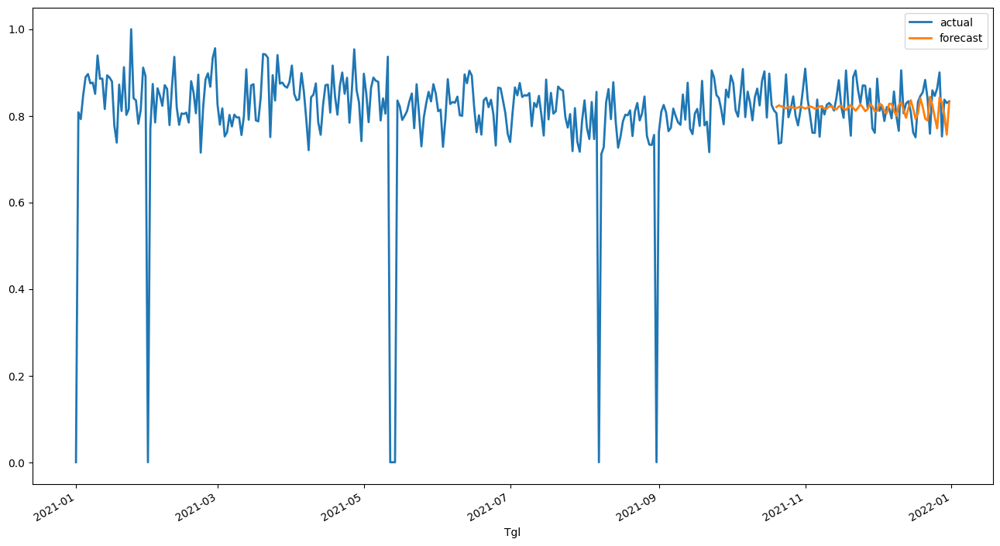

In [ ]:
# prediction for PR02
pred = rnn_PR02.predict(n=73, series=train_PR02)

pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_speed_PR02_rnn.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_PR02_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_PR02_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_PR02_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_PR02_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_PR02_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_PR02_scaled, pred)))

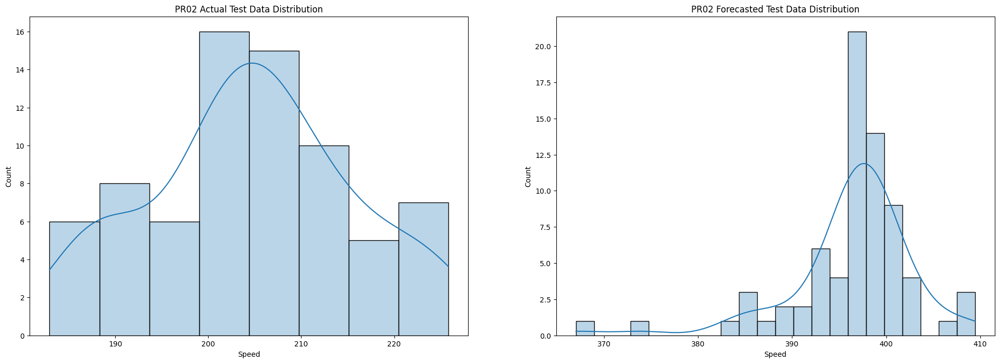

In [ ]:
# normal distribution for PR02
mpl.style.use('default')

pred_PR02 = pd.read_csv('/content/pred_speed_PR02_rnn.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(PR02.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('PR02 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_PR02['Speed'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('PR02 Forecasted Test Data Distribution')
plt.show()

Predicting: 9it [00:00, ?it/s]

RMSE = 0.100
MAE = 0.085
MSE = 0.010
SMAPE = 10.37
OPE = 7.490%


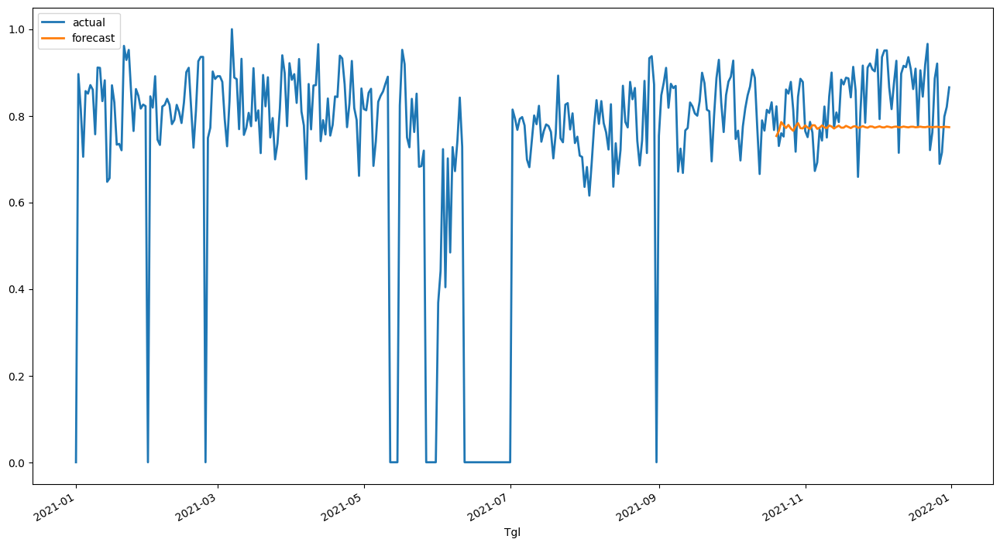

In [ ]:
# prediction for PR03
pred = rnn_PR03.predict(n=73, series=train_PR03)
pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_speed_PR03_rnn.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_PR03_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_PR03_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_PR03_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_PR03_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_PR03_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_PR03_scaled, pred)))

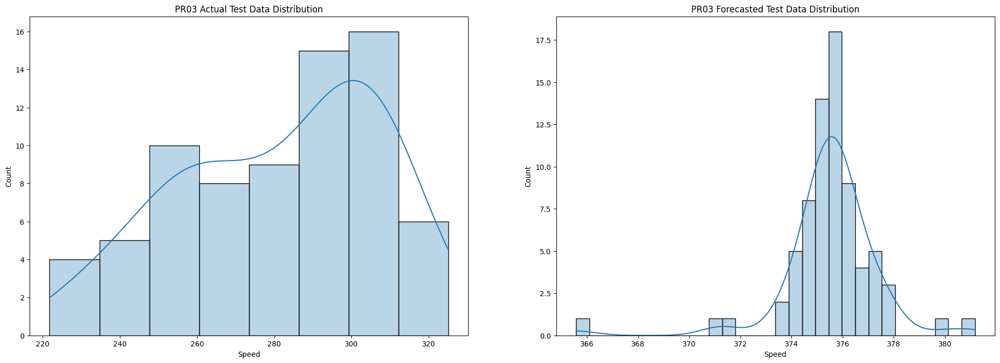

In [ ]:
# normal distribution for PR03

pred_PR03 = pd.read_csv('/content/pred_speed_PR03_rnn.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(PR03.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('PR03 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_PR03['Speed'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('PR03 Forecasted Test Data Distribution')

plt.show()

Predicting: 9it [00:00, ?it/s]

RMSE = 0.035
MAE = 0.027
MSE = 0.001
SMAPE = 3.27
OPE = 1.566%


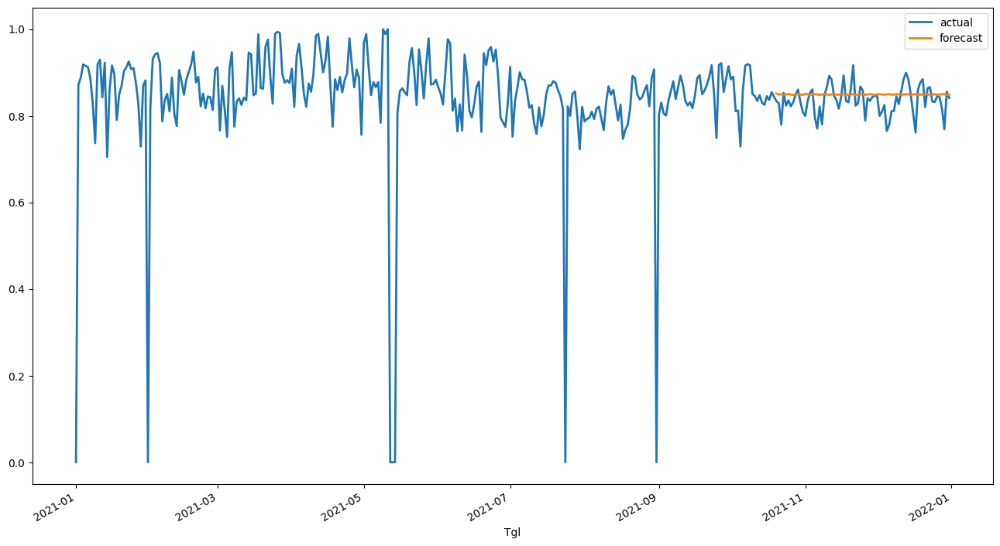

In [ ]:
# prediction for PR05
pred = rnn_PR05.predict(n=73, series=train_PR05)
pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_speed_PR05_rnn.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_PR05_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_PR05_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_PR05_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_PR05_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_PR05_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_PR05_scaled, pred)))

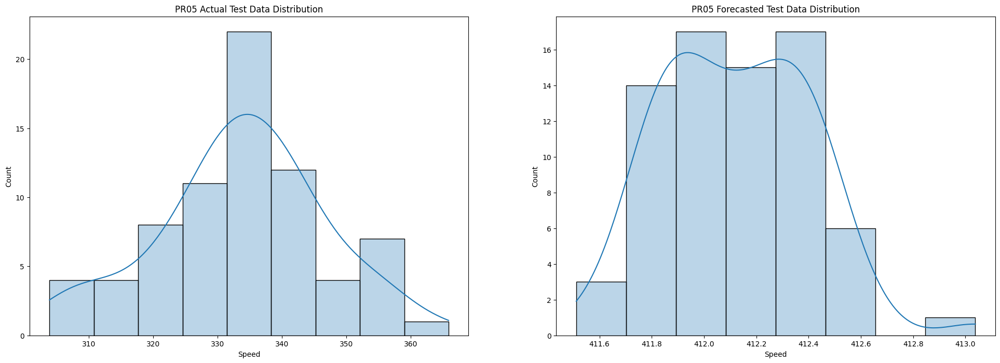

In [ ]:
# normal distribution for PR05

pred_PR05 = pd.read_csv('/content/pred_speed_PR05_rnn.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(PR05.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('PR05 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_PR05['Speed'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('PR05 Forecasted Test Data Distribution')

plt.show()


Predicting: 9it [00:00, ?it/s]

RMSE = 0.233
MAE = 0.130
MSE = 0.054
SMAPE = 25.52
OPE = 4.679%


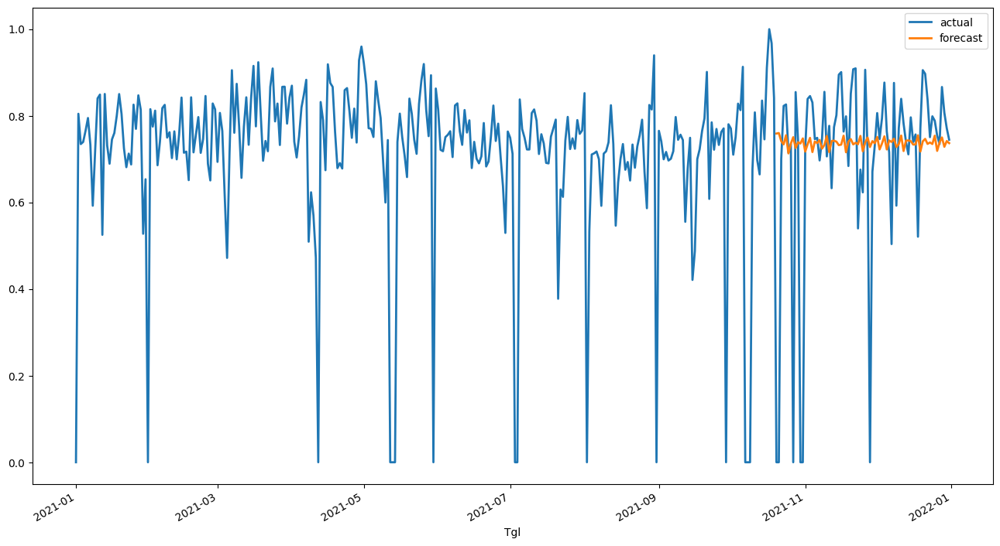

In [ ]:
# prediction for PR06
pred = rnn_PR06.predict(n=73, series=train_PR06)
pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_speed_PR06_rnn.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_PR06_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_PR06_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_PR06_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_PR06_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_PR06_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_PR06_scaled, pred)))

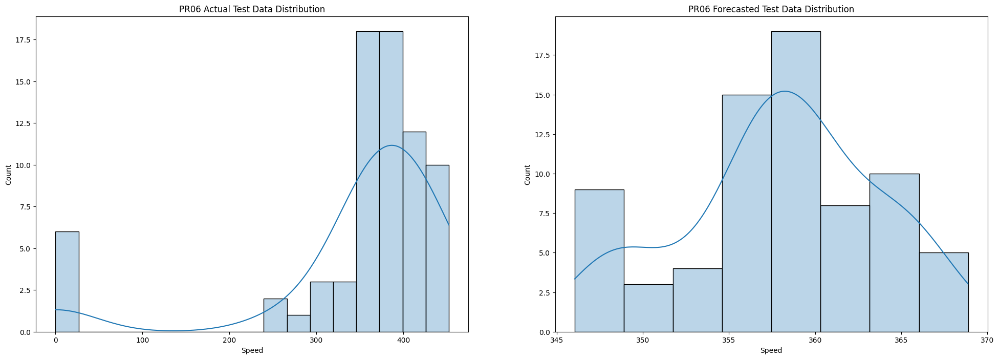

In [ ]:
# normal distribution for PR06

pred_PR06 = pd.read_csv('/content/pred_speed_PR06_rnn.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(PR06.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('PR06 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_PR06['Speed'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('PR06 Forecasted Test Data Distribution')

plt.show()

Predicting: 9it [00:00, ?it/s]

RMSE = 0.078
MAE = 0.065
MSE = 0.006
SMAPE = 7.39
OPE = 4.416%


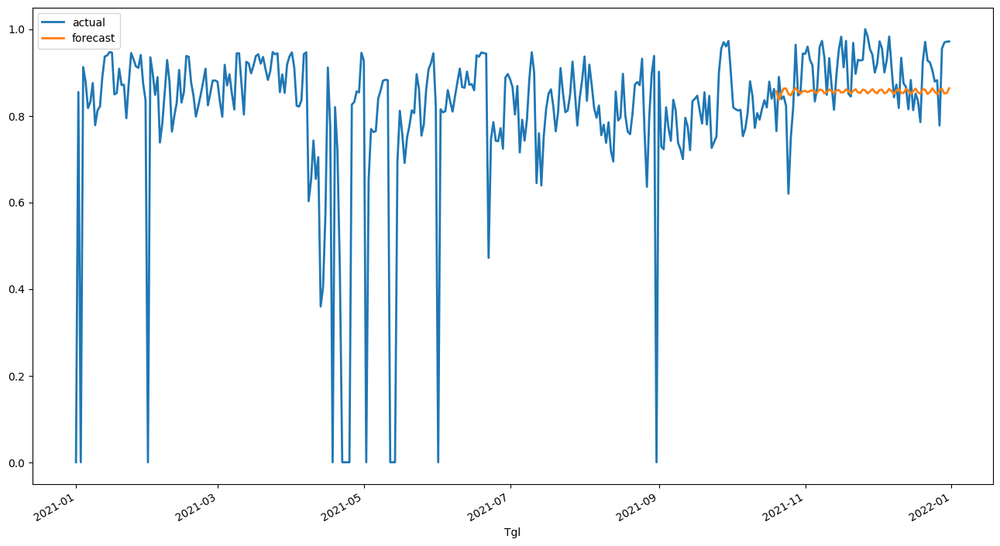

In [ ]:
# prediction for PR07
pred = rnn_PR07.predict(n=73, series=train_PR07)
pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_speed_PR07_rnn.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_PR07_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_PR07_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_PR07_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_PR07_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_PR07_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_PR07_scaled, pred)))

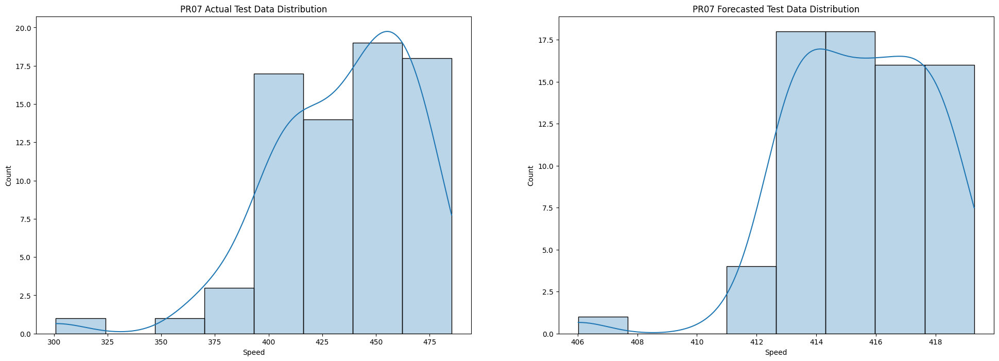

In [ ]:
# normal distribution for PR07

pred_PR07 = pd.read_csv('/content/pred_speed_PR07_rnn.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(PR07.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('PR07 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_PR07['Speed'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('PR07 Forecasted Test Data Distribution')

plt.show()

## **Forecasting Daily Output Data with RNN**



### **Forecasting Daily Output by Material with RNN**

In [ ]:
idx = pd.date_range('2021-01-01', '2021-12-31')
pet = op[op['FILM']=='PET'].pivot_table(values='Output', index='Tgl', fill_value=0, aggfunc=np.mean)
pet = pet.reindex(idx, fill_value=0).reset_index()
nyl = op[op['FILM']=='NYL'].pivot_table(values='Output', index='Tgl', fill_value=0, aggfunc=np.mean)
nyl = nyl.reindex(idx, fill_value=0).reset_index()
opp = op[op['FILM']=='OPP'].pivot_table(values='Output', index='Tgl', fill_value=0, aggfunc=np.mean)
opp = opp.reindex(idx, fill_value=0).reset_index()

In [ ]:
# defining time series by material
pet_series = TimeSeries.from_dataframe(pet, 'index','Output')
nyl_series = TimeSeries.from_dataframe(nyl, 'index','Output')
opp_series = TimeSeries.from_dataframe(opp, 'index','Output')

In [ ]:
# check seasonality for PET
is_seasonal, pet_periodicity = check_seasonality(pet_series, max_lag=240)
dict_seas ={
    "PET is seasonal?":is_seasonal,
    "pet_periodicity (days)":f'{pet_periodicity:.1f}', 
    "pet_periodicity (~months)": f'{pet_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

PET is seasonal? : True
pet_periodicity (days) : 7.0
pet_periodicity (~months) : 0.2


In [ ]:
# check seasonality for NYL
is_seasonal, nyl_periodicity = check_seasonality(nyl_series, max_lag=240)
dict_seas ={
    "NYL is seasonal?":is_seasonal,
    "nyl_periodicity (days)":f'{nyl_periodicity:.1f}', 
    "nyl_periodicity (~months)": f'{nyl_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

NYL is seasonal? : True
nyl_periodicity (days) : 5.0
nyl_periodicity (~months) : 0.2


In [ ]:
is_seasonal, opp_periodicity = check_seasonality(opp_series, max_lag=240)
dict_seas ={
    "OPP is seasonal?":is_seasonal,
    "opp_periodicity (days)":f'{opp_periodicity:.1f}', 
    "opp_periodicity (~months)": f'{opp_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

OPP is seasonal? : True
opp_periodicity (days) : 4.0
opp_periodicity (~months) : 0.1


In [ ]:
# data normalization
scaler= Scaler()
series_pet_scaled = scaler.fit_transform(pet_series)
series_nyl_scaled = scaler.fit_transform(nyl_series)
series_opp_scaled = scaler.fit_transform(opp_series)

In [ ]:
# train test split
train_pet, val_pet = series_pet_scaled[:-73], series_pet_scaled[-73:]

train_nyl, val_nyl = series_nyl_scaled[:-73], series_nyl_scaled[-73:]
train_opp, val_opp = series_opp_scaled[:-73], series_opp_scaled[-73:]

In [ ]:
# defining and training the model for PET
rnn_pet= RNNModel(
    model="RNN",
    input_chunk_length=pet_periodicity,
    output_chunk_length=30,
    n_rnn_layers=3,
    batch_size=32,
    n_epochs=300,
    dropout=0.1,
    optimizer_kwargs={"lr": 1e-3},
    log_tensorboard=True,
    random_state=42,
    force_reset=True,
)
rnn_pet.fit(train_pet)

[2022-03-28 09:52:25,522] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 268 samples.
[2022-03-28 09:52:25,522] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 268 samples.
[2022-03-28 09:52:25,545] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
[2022-03-28 09:52:25,545] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs

  | Name      | Type    | Params
--------------------------------------
0 | criterion | MSELoss | 0     
1 | rnn       | RNN     | 3.3 K 
2 | V         | Linear  | 26    
--------------------------------------
3.3 K     Trainable params
0         Non-trainable params
3.3 K     Total params
0.027     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

In [ ]:
# defining and training the model for NYL
rnn_nyl= RNNModel(
    model="RNN",
    input_chunk_length=nyl_periodicity,
    output_chunk_length=30,
    n_rnn_layers=3,
    batch_size=32,
    n_epochs=300,
    dropout=0.1,
    optimizer_kwargs={"lr": 1e-3},
    log_tensorboard=True,
    random_state=42,
    force_reset=True,
)
rnn_nyl.fit(train_nyl)

[2022-03-28 09:53:29,144] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 268 samples.
[2022-03-28 09:53:29,144] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 268 samples.
[2022-03-28 09:53:29,154] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
[2022-03-28 09:53:29,154] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs

  | Name      | Type    | Params
--------------------------------------
0 | criterion | MSELoss | 0     
1 | rnn       | RNN     | 3.3 K 
2 | V         | Linear  | 26    
--------------------------------------
3.3 K     Trainable params
0         Non-trainable params
3.3 K     Total params
0.027     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

In [ ]:
# defining and training the model for OPP
rnn_opp= RNNModel(
    model="RNN",
    input_chunk_length=opp_periodicity,
    output_chunk_length=30,
    n_rnn_layers=3,
    batch_size=32,
    n_epochs=300,
    dropout=0.1,
    optimizer_kwargs={"lr": 1e-3},
    log_tensorboard=True,
    random_state=42,
    force_reset=True,
)
rnn_opp.fit(train_opp)

[2022-03-28 09:54:25,193] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 268 samples.
[2022-03-28 09:54:25,193] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 268 samples.
[2022-03-28 09:54:25,200] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
[2022-03-28 09:54:25,200] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs

  | Name      | Type    | Params
--------------------------------------
0 | criterion | MSELoss | 0     
1 | rnn       | RNN     | 3.3 K 
2 | V         | Linear  | 26    
--------------------------------------
3.3 K     Trainable params
0         Non-trainable params
3.3 K     Total params
0.027     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

Predicting: 9it [00:00, ?it/s]

RMSE = 0.131
MAE = 0.102
MSE = 0.017
SMAPE = 20.100
OPE = 8.013%


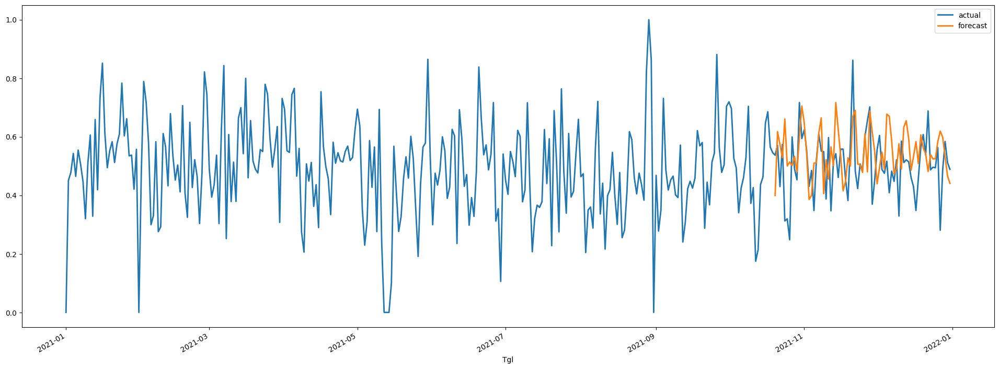

In [ ]:
# prediction for PET
mpl.style.use('default')
pred = rnn_pet.predict(n=73, series=train_pet)

pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_op_pet_rnn.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(24,8))
series_pet_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_pet_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_pet_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_pet_scaled, pred)))
print("SMAPE = {:.3f}".format(smape(series_pet_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_pet_scaled, pred)))

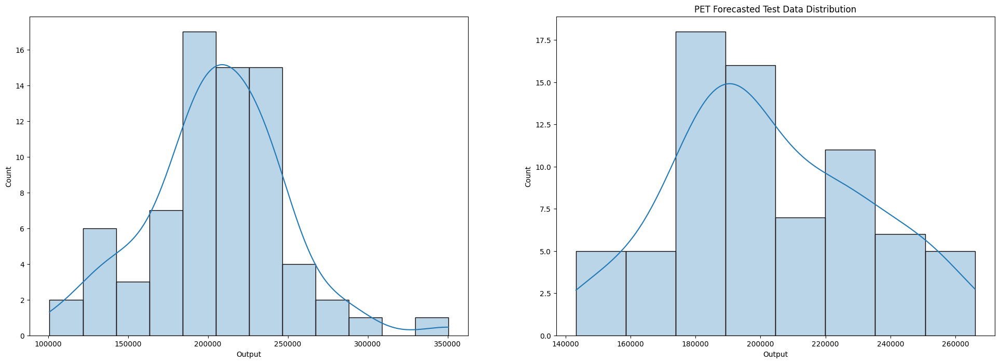

In [ ]:
# normal distribution for PET
pred_pet = pd.read_csv('/content/pred_op_pet_rnn.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(pet.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)

# plot forecasted test data
sns.histplot(pred_pet['Output'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('PET Forecasted Test Data Distribution')

plt.show()

Predicting: 9it [00:00, ?it/s]

RMSE = 0.191
MAE = 0.150
MSE = 0.037
SMAPE = 83.43
OPE = 18.281%


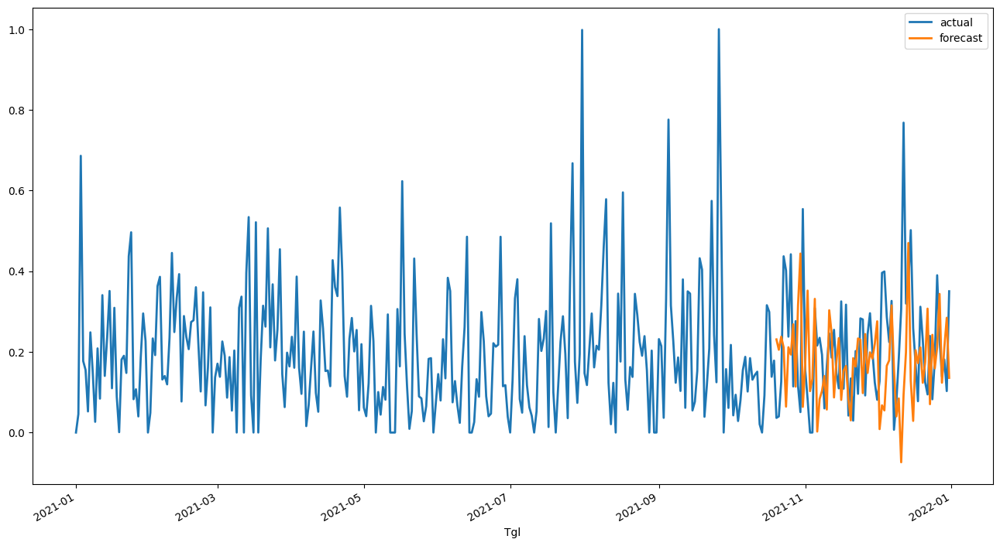

In [ ]:
# prediction for NYL
pred = rnn_nyl.predict(n=73, series=train_nyl)

pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_op_nyl_rnn.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_nyl_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_nyl_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_nyl_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_nyl_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_nyl_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_nyl_scaled, pred)))

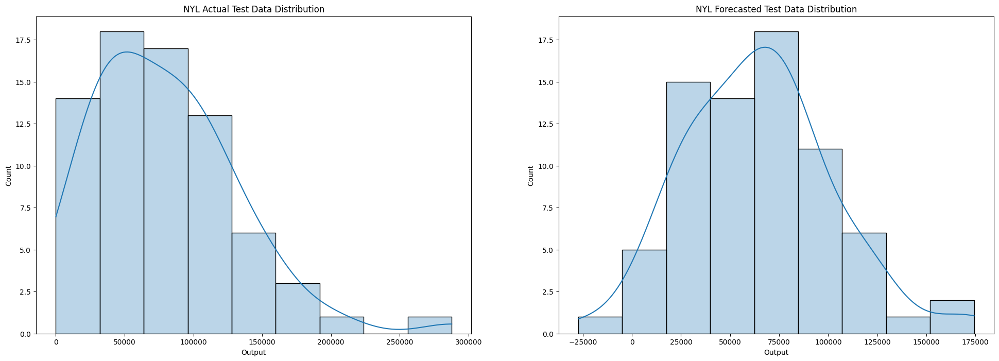

In [ ]:
# normal distribution for NYL
mpl.style.use('default')

pred_nyl = pd.read_csv('/content/pred_op_nyl_rnn.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(nyl.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('NYL Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_nyl['Output'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('NYL Forecasted Test Data Distribution')

plt.show()

Predicting: 9it [00:00, ?it/s]

RMSE = 0.218
MAE = 0.169
MSE = 0.047
SMAPE = 65.44
OPE = 1.588%


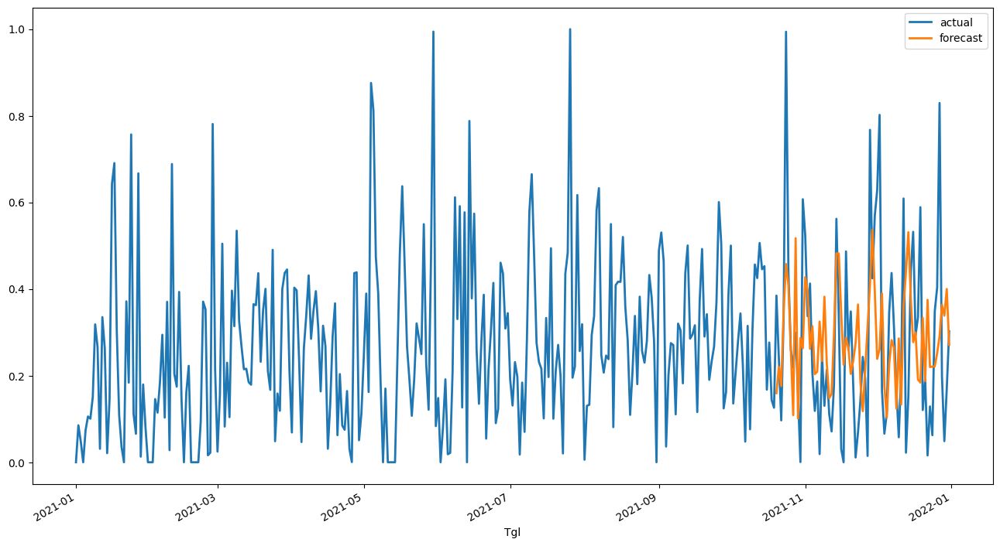

In [ ]:
# prediction for OPP
pred = rnn_opp.predict(n=73, series=train_opp)
pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_op_opp_rnn.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_opp_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_opp_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_opp_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_opp_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_opp_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_opp_scaled, pred)))

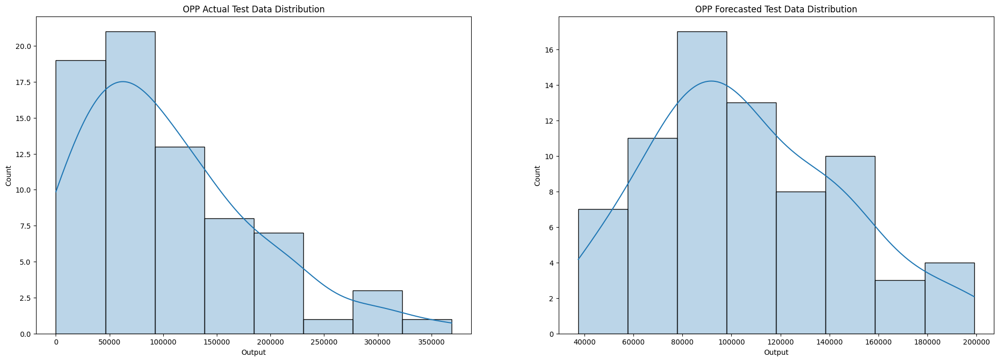

In [ ]:
# normal distribution for OPP

pred_opp = pd.read_csv('/content/pred_op_opp_rnn.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(opp.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('OPP Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_opp['Output'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('OPP Forecasted Test Data Distribution')

plt.show()

### **Forecasting Daily Output by Machine with RNN**

In [ ]:
PR01 = op[op['KdMesin']=='PR01'].pivot_table(values='Output', index='Tgl', fill_value=0, aggfunc=np.mean)
PR01 = PR01.reindex(idx, fill_value=0).reset_index()
PR02 = op[op['KdMesin']=='PR02'].pivot_table(values='Output', index='Tgl', fill_value=0, aggfunc=np.mean)
PR02 = PR02.reindex(idx, fill_value=0).reset_index()
PR03 = op[op['KdMesin']=='PR03'].pivot_table(values='Output', index='Tgl', fill_value=0, aggfunc=np.mean)
PR03 = PR03.reindex(idx, fill_value=0).reset_index()
PR05 = op[op['KdMesin']=='PR05'].pivot_table(values='Output', index='Tgl', fill_value=0, aggfunc=np.mean)
PR05 = PR05.reindex(idx, fill_value=0).reset_index()
PR06 = op[op['KdMesin']=='PR06'].pivot_table(values='Output', index='Tgl', fill_value=0, aggfunc=np.mean)
PR06 = PR06.reindex(idx, fill_value=0).reset_index()
PR07 = op[op['KdMesin']=='PR07'].pivot_table(values='Output', index='Tgl', fill_value=0, aggfunc=np.mean)
PR07 = PR07.reindex(idx, fill_value=0).reset_index()

In [ ]:
# defining time series by material
PR01_series = TimeSeries.from_dataframe(PR01, 'index','Output')
PR02_series = TimeSeries.from_dataframe(PR02, 'index','Output')
PR03_series = TimeSeries.from_dataframe(PR03, 'index','Output')
PR05_series = TimeSeries.from_dataframe(PR05, 'index','Output')
PR06_series = TimeSeries.from_dataframe(PR06, 'index','Output')
PR07_series = TimeSeries.from_dataframe(PR07, 'index','Output')

In [ ]:
# check seasonality for PR01
is_seasonal, pr01_periodicity = check_seasonality(PR01_series, max_lag=240)
dict_seas ={
    "PR01 is seasonal?":is_seasonal,
    "pr01_periodicity (days)":f'{pr01_periodicity:.1f}', 
    "pr01_periodicity (~months)": f'{pr01_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

PR01 is seasonal? : True
pr01_periodicity (days) : 8.0
pr01_periodicity (~months) : 0.3


In [ ]:
# check seasonality for PR02
is_seasonal, pr02_periodicity = check_seasonality(PR02_series, max_lag=240)
dict_seas ={
    "PR02 is seasonal?":is_seasonal,
    "pr02_periodicity (days)":f'{pr02_periodicity:.1f}', 
    "pr02_periodicity (~months)": f'{pr02_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

PR02 is seasonal? : True
pr02_periodicity (days) : 7.0
pr02_periodicity (~months) : 0.2


In [ ]:
# check seasonality for PR03
is_seasonal, pr03_periodicity = check_seasonality(PR03_series, max_lag=240)
dict_seas ={
    "PR03 is seasonal?":is_seasonal,
    "pr03_periodicity (days)":f'{pr03_periodicity:.1f}', 
    "pr03_periodicity (~months)": f'{pr03_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

PR03 is seasonal? : True
pr03_periodicity (days) : 4.0
pr03_periodicity (~months) : 0.1


In [ ]:
# check seasonality for PR05
is_seasonal, pr05_periodicity = check_seasonality(PR05_series, max_lag=240)
dict_seas ={
    "PR05 is seasonal?":is_seasonal,
    "pr05_periodicity (days)":f'{pr05_periodicity:.1f}', 
    "pr05_periodicity (~months)": f'{pr05_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

PR05 is seasonal? : True
pr05_periodicity (days) : 9.0
pr05_periodicity (~months) : 0.3


In [ ]:
# check seasonality for PR06
is_seasonal, pr06_periodicity = check_seasonality(PR06_series, max_lag=240)
dict_seas ={
    "PR06 is seasonal?":is_seasonal,
    "pr06_periodicity (days)":f'{pr06_periodicity:.1f}', 
    "pr06_periodicity (~months)": f'{pr06_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

PR06 is seasonal? : True
pr06_periodicity (days) : 6.0
pr06_periodicity (~months) : 0.2


In [ ]:
# check seasonality for PR07
is_seasonal, pr07_periodicity = check_seasonality(PR07_series, max_lag=240)
dict_seas ={
    "PR07 is seasonal?":is_seasonal,
    "pr07_periodicity (days)":f'{pr07_periodicity:.1f}', 
    "pr07_periodicity (~months)": f'{pr07_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

PR07 is seasonal? : True
pr07_periodicity (days) : 6.0
pr07_periodicity (~months) : 0.2


In [ ]:
# data normalization
scaler= Scaler()
series_PR01_scaled = scaler.fit_transform(PR01_series)
series_PR02_scaled = scaler.fit_transform(PR02_series)
series_PR03_scaled = scaler.fit_transform(PR03_series)
series_PR05_scaled = scaler.fit_transform(PR05_series)
series_PR06_scaled = scaler.fit_transform(PR06_series)
series_PR07_scaled = scaler.fit_transform(PR07_series)

In [ ]:
# train test split
train_PR01, val_PR01 = series_PR01_scaled[:-73], series_PR01_scaled[-73:]
train_PR02, val_PR02 = series_PR02_scaled[:-73], series_PR02_scaled[-73:]
train_PR03, val_PR03 = series_PR03_scaled[:-73], series_PR03_scaled[-73:]
train_PR05, val_PR05 = series_PR05_scaled[:-73], series_PR05_scaled[-73:]
train_PR06, val_PR06 = series_PR06_scaled[:-73], series_PR06_scaled[-73:]
train_PR07, val_PR07 = series_PR07_scaled[:-73], series_PR07_scaled[-73:]

In [ ]:
# defining and training the model for PR01
rnn_PR01= RNNModel(
    model="RNN",
    input_chunk_length=pr01_periodicity,
    output_chunk_length=30,
    n_rnn_layers=3,
    batch_size=32,
    n_epochs=300,
    dropout=0.1,
    optimizer_kwargs={"lr": 1e-3},
    log_tensorboard=True,
    random_state=42,
    force_reset=True,
)
rnn_PR01.fit(train_PR01)

[2022-03-29 06:11:40,750] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 268 samples.
[2022-03-29 06:11:40,750] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 268 samples.
[2022-03-29 06:11:40,763] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
[2022-03-29 06:11:40,763] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs

  | Name      | Type    | Params
--------------------------------------
0 | criterion | MSELoss | 0     
1 | rnn       | RNN     | 3.3 K 
2 | V         | Linear  | 26    
--------------------------------------
3.3 K     Trainable params
0         Non-trainable params
3.3 K     Total params
0.027     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

In [ ]:
# defining and training the model for PR02
rnn_PR02= RNNModel(
    model="RNN",
    input_chunk_length=pr02_periodicity,
    output_chunk_length=30,
    n_rnn_layers=3,
    batch_size=32,
    n_epochs=300,
    dropout=0.1,
    optimizer_kwargs={"lr": 1e-3},
    log_tensorboard=True,
    random_state=42,
    force_reset=True,
)
rnn_PR02.fit(train_PR02)

[2022-03-29 06:12:47,212] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 268 samples.
[2022-03-29 06:12:47,212] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 268 samples.
[2022-03-29 06:12:47,222] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
[2022-03-29 06:12:47,222] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs

  | Name      | Type    | Params
--------------------------------------
0 | criterion | MSELoss | 0     
1 | rnn       | RNN     | 3.3 K 
2 | V         | Linear  | 26    
--------------------------------------
3.3 K     Trainable params
0         Non-trainable params
3.3 K     Total params
0.027     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

In [ ]:
# defining and training the model for PR03
rnn_PR03= RNNModel(
    model="RNN",
    input_chunk_length=pr03_periodicity,
    output_chunk_length=30,
    n_rnn_layers=3,
    batch_size=32,
    n_epochs=300,
    dropout=0.1,
    optimizer_kwargs={"lr": 1e-3},
    log_tensorboard=True,
    random_state=42,
    force_reset=True,
)
rnn_PR03.fit(train_PR03)

[2022-03-29 06:13:52,757] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 268 samples.
[2022-03-29 06:13:52,757] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 268 samples.
[2022-03-29 06:13:52,767] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
[2022-03-29 06:13:52,767] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs

  | Name      | Type    | Params
--------------------------------------
0 | criterion | MSELoss | 0     
1 | rnn       | RNN     | 3.3 K 
2 | V         | Linear  | 26    
--------------------------------------
3.3 K     Trainable params
0         Non-trainable params
3.3 K     Total params
0.027     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

In [ ]:
# defining and training the model for PR05
rnn_PR05= RNNModel(
    model="RNN",
    input_chunk_length=pr05_periodicity,
    output_chunk_length=30,
    n_rnn_layers=3,
    batch_size=32,
    n_epochs=300,
    dropout=0.1,
    optimizer_kwargs={"lr": 1e-3},
    log_tensorboard=True,
    random_state=42,
    force_reset=True,
)
rnn_PR05.fit(train_PR05)

[2022-03-29 06:14:58,119] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 268 samples.
[2022-03-29 06:14:58,119] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 268 samples.
[2022-03-29 06:14:58,128] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
[2022-03-29 06:14:58,128] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs

  | Name      | Type    | Params
--------------------------------------
0 | criterion | MSELoss | 0     
1 | rnn       | RNN     | 3.3 K 
2 | V         | Linear  | 26    
--------------------------------------
3.3 K     Trainable params
0         Non-trainable params
3.3 K     Total params
0.027     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

In [ ]:
# defining and training the model for PR06
rnn_PR06= RNNModel(
    model="RNN",
    input_chunk_length=pr06_periodicity,
    output_chunk_length=30,
    n_rnn_layers=3,
    batch_size=32,
    n_epochs=300,
    dropout=0.1,
    optimizer_kwargs={"lr": 1e-3},
    log_tensorboard=True,
    random_state=42,
    force_reset=True,
)
rnn_PR06.fit(train_PR06)

[2022-03-29 06:16:03,886] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 268 samples.
[2022-03-29 06:16:03,886] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 268 samples.
[2022-03-29 06:16:03,895] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
[2022-03-29 06:16:03,895] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs

  | Name      | Type    | Params
--------------------------------------
0 | criterion | MSELoss | 0     
1 | rnn       | RNN     | 3.3 K 
2 | V         | Linear  | 26    
--------------------------------------
3.3 K     Trainable params
0         Non-trainable params
3.3 K     Total params
0.027     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

In [ ]:
# defining and training the model for PR07
rnn_PR07= RNNModel(
    model="RNN",
    input_chunk_length=pr07_periodicity,
    output_chunk_length=30,
    n_rnn_layers=3,
    batch_size=32,
    n_epochs=300,
    dropout=0.1,
    optimizer_kwargs={"lr": 1e-3},
    log_tensorboard=True,
    random_state=42,
    force_reset=True,
)
rnn_PR07.fit(train_PR07)

[2022-03-29 06:17:08,743] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 268 samples.
[2022-03-29 06:17:08,743] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 268 samples.
[2022-03-29 06:17:08,753] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
[2022-03-29 06:17:08,753] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs

  | Name      | Type    | Params
--------------------------------------
0 | criterion | MSELoss | 0     
1 | rnn       | RNN     | 3.3 K 
2 | V         | Linear  | 26    
--------------------------------------
3.3 K     Trainable params
0         Non-trainable params
3.3 K     Total params
0.027     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

Predicting: 9it [00:00, ?it/s]

RMSE = 0.265
MAE = 0.204
MSE = 0.070
SMAPE = 59.696
OPE = 10.419%


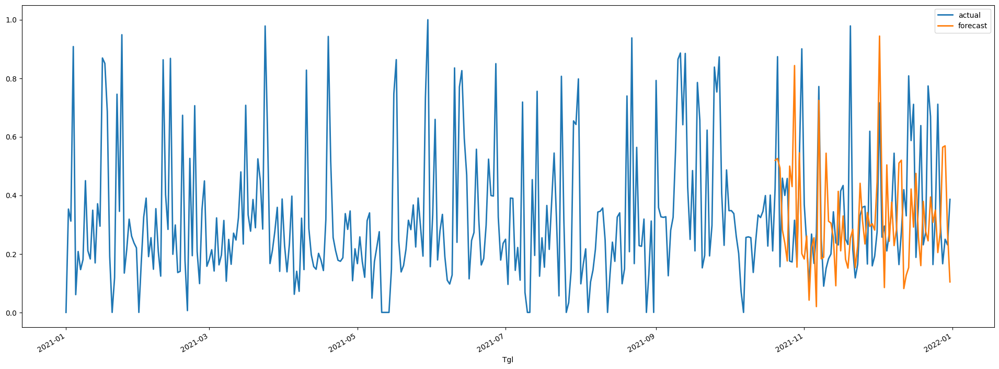

In [ ]:
# prediction for PR01
mpl.style.use('default')
pred = rnn_PR01.predict(n=73, series=train_PR01)

pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_op_PR01_rnn.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(24,8))
series_PR01_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_PR01_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_PR01_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_PR01_scaled, pred)))
print("SMAPE = {:.3f}".format(smape(series_PR01_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_PR01_scaled, pred)))

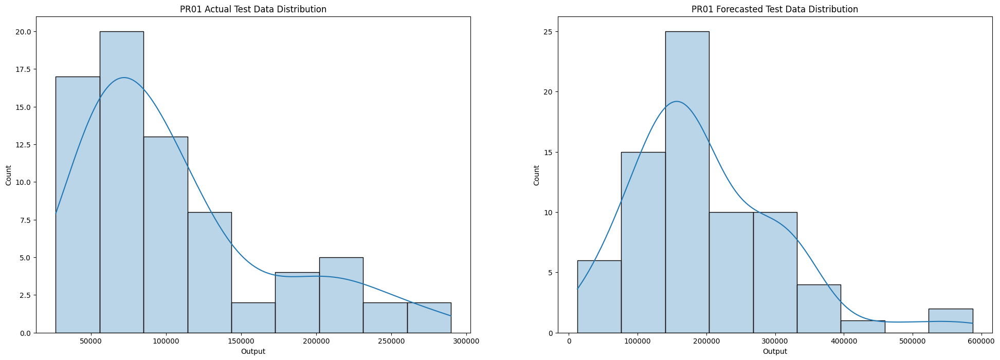

In [ ]:
# normal distribution for PR01
pred_PR01 = pd.read_csv('/content/pred_op_PR01_rnn.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(PR01.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('PR01 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_PR01['Output'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('PR01 Forecasted Test Data Distribution')

plt.show()

Predicting: 9it [00:00, ?it/s]

RMSE = 0.184
MAE = 0.143
MSE = 0.034
SMAPE = 59.49
OPE = 3.385%


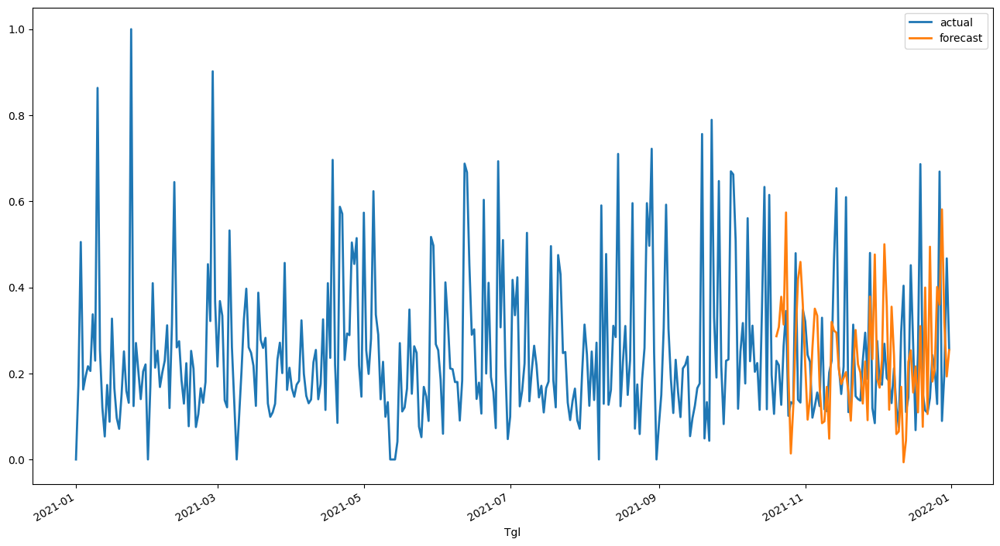

In [ ]:
# prediction for PR02
pred = rnn_PR02.predict(n=73, series=train_PR02)

pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_op_PR02_rnn.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_PR02_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_PR02_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_PR02_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_PR02_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_PR02_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_PR02_scaled, pred)))

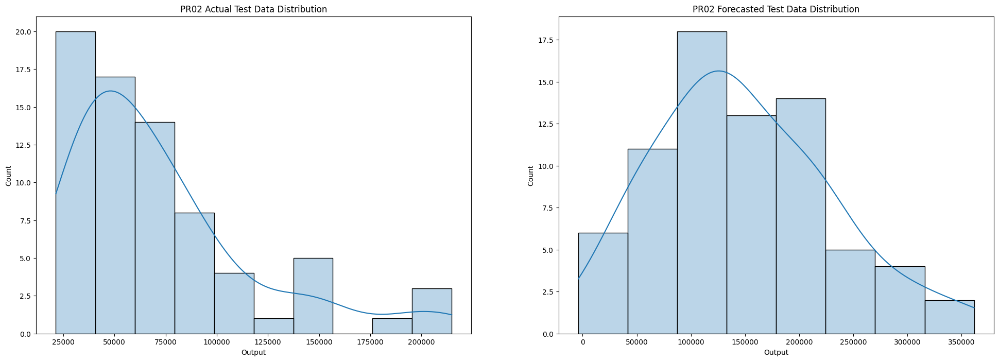

In [ ]:
# normal distribution for PR02
mpl.style.use('default')

pred_PR02 = pd.read_csv('/content/pred_op_PR02_rnn.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(PR02.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('PR02 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_PR02['Output'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('PR02 Forecasted Test Data Distribution')
plt.show()

Predicting: 9it [00:00, ?it/s]

RMSE = 0.267
MAE = 0.198
MSE = 0.071
SMAPE = 56.97
OPE = 25.159%


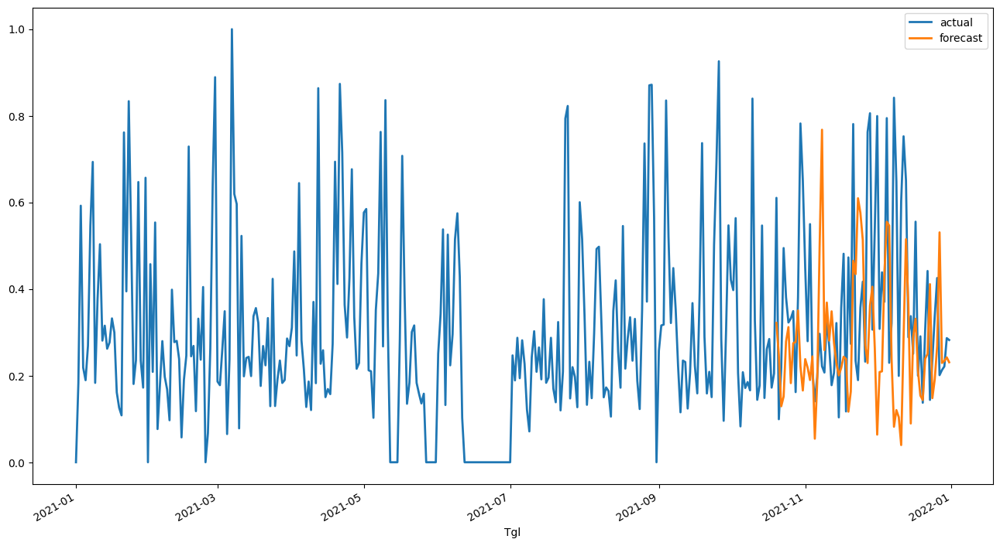

In [ ]:
# prediction for PR03
pred = rnn_PR03.predict(n=73, series=train_PR03)
pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_op_PR03_rnn.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_PR03_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_PR03_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_PR03_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_PR03_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_PR03_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_PR03_scaled, pred)))

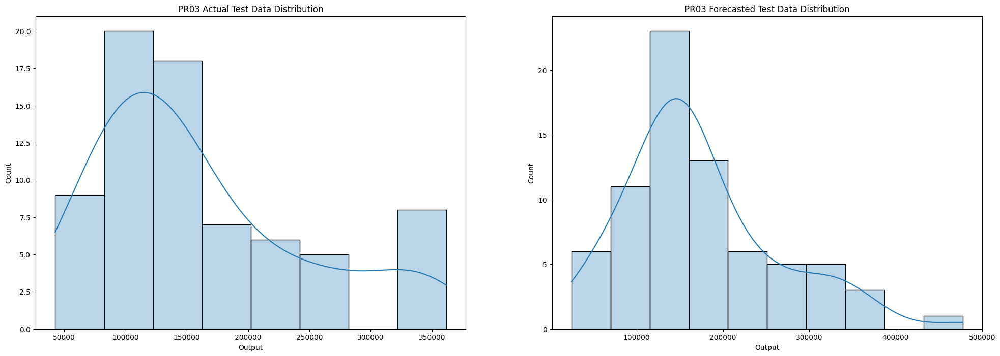

In [ ]:
# normal distribution for PR03

pred_PR03 = pd.read_csv('/content/pred_op_PR03_rnn.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(PR03.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('PR03 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_PR03['Output'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('PR03 Forecasted Test Data Distribution')

plt.show()

Predicting: 9it [00:00, ?it/s]

RMSE = 0.271
MAE = 0.220
MSE = 0.074
SMAPE = 40.59
OPE = 3.746%


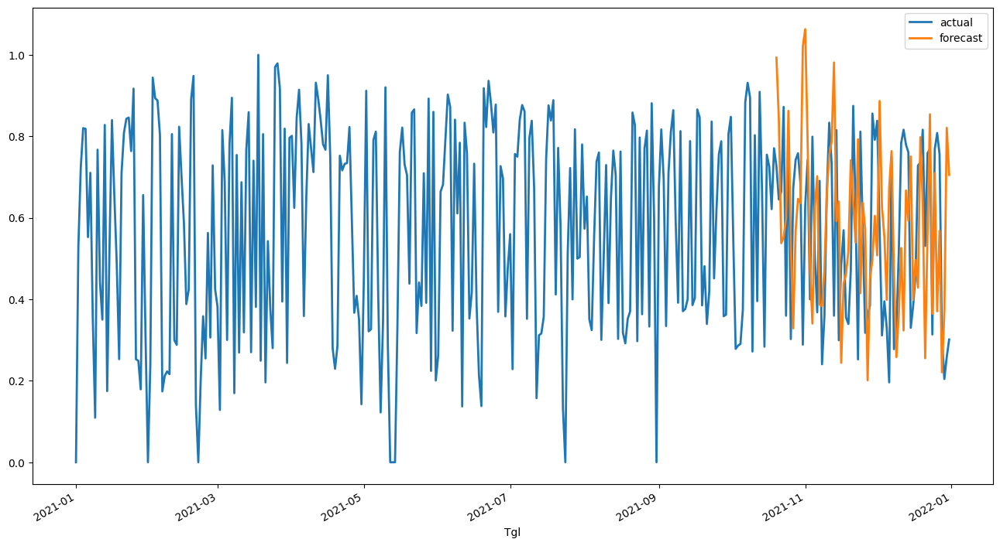

In [ ]:
# prediction for PR05
pred = rnn_PR05.predict(n=73, series=train_PR05)
pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_op_PR05_rnn.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_PR05_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_PR05_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_PR05_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_PR05_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_PR05_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_PR05_scaled, pred)))

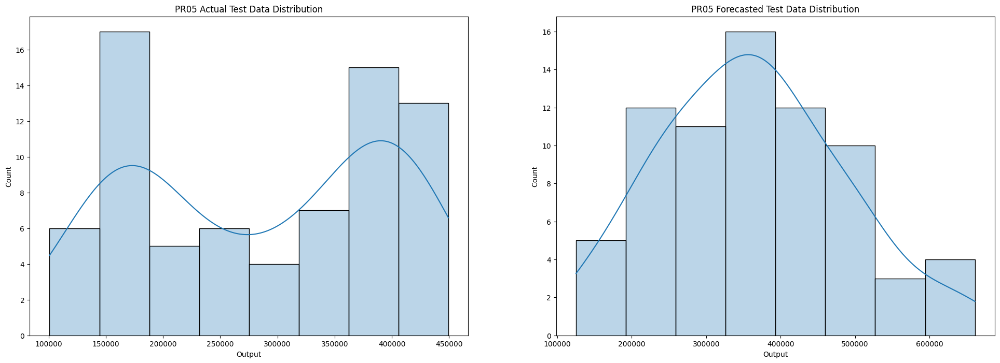

In [ ]:
# normal distribution for PR05

pred_PR05 = pd.read_csv('/content/pred_op_PR05_rnn.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(PR05.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('PR05 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_PR05['Output'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('PR05 Forecasted Test Data Distribution')

plt.show()


Predicting: 9it [00:00, ?it/s]

RMSE = 0.227
MAE = 0.187
MSE = 0.052
SMAPE = 79.26
OPE = 55.405%


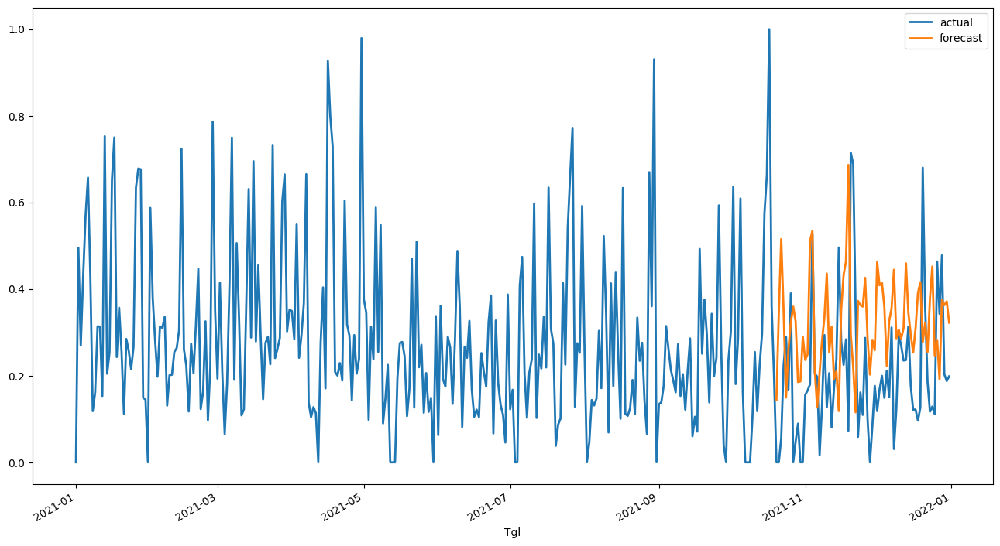

In [ ]:
# prediction for PR06
pred = rnn_PR06.predict(n=73, series=train_PR06)
pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_op_PR06_rnn.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_PR06_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_PR06_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_PR06_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_PR06_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_PR06_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_PR06_scaled, pred)))

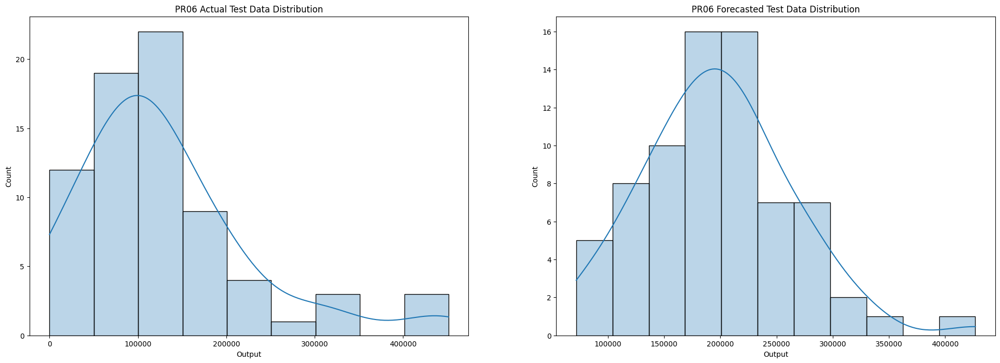

In [ ]:
# normal distribution for PR06

pred_PR06 = pd.read_csv('/content/pred_op_PR06_rnn.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(PR06.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('PR06 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_PR06['Output'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('PR06 Forecasted Test Data Distribution')

plt.show()

Predicting: 9it [00:00, ?it/s]

RMSE = 0.284
MAE = 0.234
MSE = 0.081
SMAPE = 42.09
OPE = 10.277%


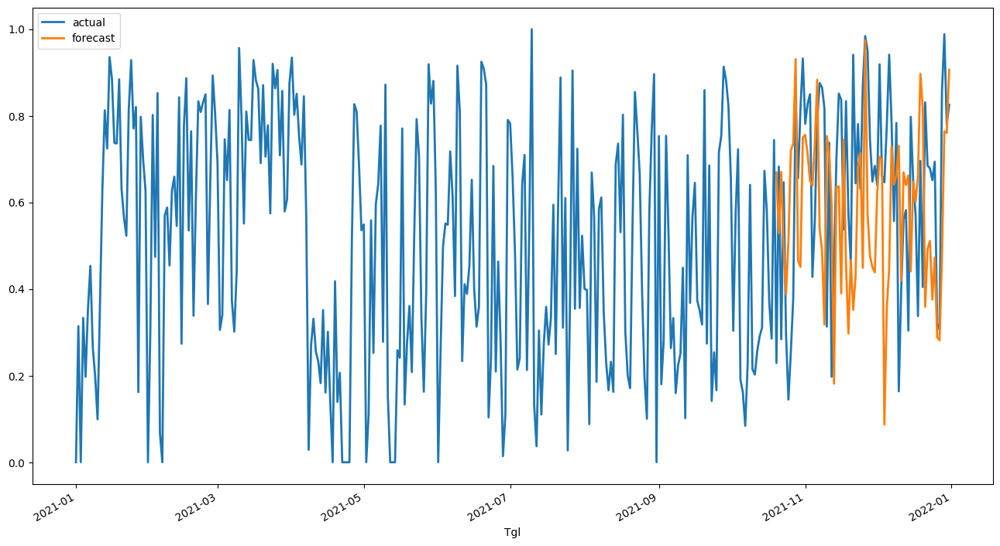

In [ ]:
# prediction for PR07
pred = rnn_PR07.predict(n=73, series=train_PR07)
pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_op_PR07_rnn.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_PR07_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_PR07_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_PR07_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_PR07_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_PR07_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_PR07_scaled, pred)))

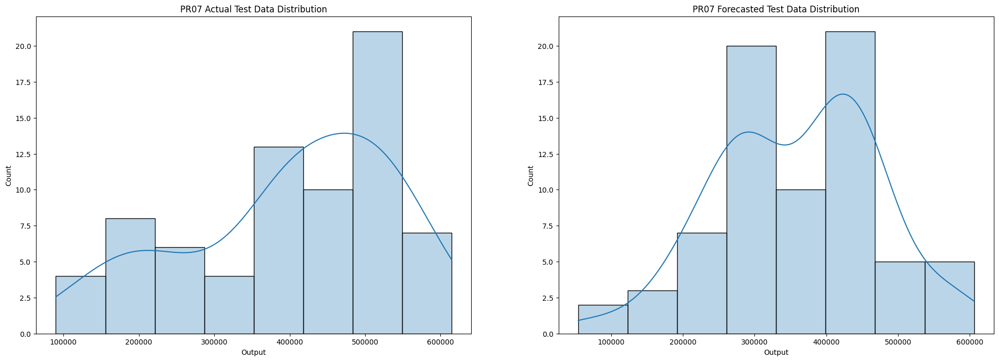

In [ ]:
# normal distribution for PR07

pred_PR07 = pd.read_csv('/content/pred_op_PR07_rnn.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(PR07.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('PR07 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_PR07['Output'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('PR07 Forecasted Test Data Distribution')

plt.show()

## **Forecasting Daily Downtime Data with RNN**


In [ ]:
idx = pd.date_range('2021-01-01', '2021-12-31')
down_all = df[df['KodeBD']!='RUN'].pivot_table(values='Downtime', index='Tgl', fill_value=0, aggfunc=np.sum)
down_all = down_all.reindex(idx, fill_value=0).reset_index()

In [ ]:
# defining time series
down_series = TimeSeries.from_dataframe(down_all, 'index','Downtime')

### **Forecasting Daily Runtime by Material With RNN**

In [ ]:
pet = down[down['FILM']=='PET'].pivot_table(values='Downtime', index='Tgl', fill_value=0, aggfunc=np.sum)
pet = pet.reindex(idx, fill_value=0).reset_index()
nyl = down[down['FILM']=='NYL'].pivot_table(values='Downtime', index='Tgl', fill_value=0, aggfunc=np.sum)
nyl = nyl.reindex(idx, fill_value=0).reset_index()
opp = down[down['FILM']=='OPP'].pivot_table(values='Downtime', index='Tgl', fill_value=0, aggfunc=np.sum)
opp = opp.reindex(idx, fill_value=0).reset_index()

In [ ]:
# defining time series by material
pet_series = TimeSeries.from_dataframe(pet, 'index','Downtime')
nyl_series = TimeSeries.from_dataframe(nyl, 'index','Downtime')
opp_series = TimeSeries.from_dataframe(opp, 'index','Downtime')

In [ ]:
# check seasonality for PET
is_seasonal, pet_periodicity = check_seasonality(pet_series, max_lag=240)
dict_seas ={
    "PET is seasonal?":is_seasonal,
    "pet_periodicity (days)":f'{pet_periodicity:.1f}', 
    "pet_periodicity (~months)": f'{pet_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

PET is seasonal? : True
pet_periodicity (days) : 6.0
pet_periodicity (~months) : 0.2


In [ ]:
# check seasonality for NYL
is_seasonal, nyl_periodicity = check_seasonality(nyl_series, max_lag=240)
dict_seas ={
    "NYL is seasonal?":is_seasonal,
    "nyl_periodicity (days)":f'{nyl_periodicity:.1f}', 
    "nyl_periodicity (~months)": f'{nyl_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

NYL is seasonal? : True
nyl_periodicity (days) : 3.0
nyl_periodicity (~months) : 0.1


In [ ]:
is_seasonal, opp_periodicity = check_seasonality(opp_series, max_lag=240)
dict_seas ={
    "OPP is seasonal?":is_seasonal,
    "opp_periodicity (days)":f'{opp_periodicity:.1f}', 
    "opp_periodicity (~months)": f'{opp_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

OPP is seasonal? : True
opp_periodicity (days) : 4.0
opp_periodicity (~months) : 0.1


In [ ]:
# data normalization
scaler= Scaler()
series_pet_scaled = scaler.fit_transform(pet_series)
series_nyl_scaled = scaler.fit_transform(nyl_series)
series_opp_scaled = scaler.fit_transform(opp_series)

In [ ]:
# train test split
train_pet, val_pet = series_pet_scaled[:-73], series_pet_scaled[-73:]
train_nyl, val_nyl = series_nyl_scaled[:-73], series_nyl_scaled[-73:]
train_opp, val_opp = series_opp_scaled[:-73], series_opp_scaled[-73:]

In [ ]:
# defining and training the model for PET
rnn_pet= RNNModel(
    model="RNN",
    input_chunk_length=pet_periodicity,
    output_chunk_length=30,
    n_rnn_layers=3,
    batch_size=32,
    n_epochs=300,
    dropout=0.1,
    optimizer_kwargs={"lr": 1e-3},
    log_tensorboard=True,
    random_state=42,
    force_reset=True,
)
rnn_pet.fit(train_pet)

[2022-04-04 08:03:16,289] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 268 samples.
[2022-04-04 08:03:16,289] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 268 samples.
[2022-04-04 08:03:16,307] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
[2022-04-04 08:03:16,307] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name      | Type    | Params
--------------------------------------
0 | criterion | MSELoss | 0     
1 | rnn       | RNN     | 3.3 K 
2 | V         | Linear  | 26    
--------------------------------------
3.3 K     Trainable params
0         Non-trainable params
3.3 K     Total params
0.027     Total estimated model param

Training: 0it [00:00, ?it/s]

In [ ]:
# defining and training the model for NYL
rnn_nyl= RNNModel(
    model="RNN",
    input_chunk_length=nyl_periodicity,
    output_chunk_length=30,
    n_rnn_layers=3,
    batch_size=32,
    n_epochs=300,
    dropout=0.1,
    optimizer_kwargs={"lr": 1e-3},
    log_tensorboard=True,
    random_state=42,
    force_reset=True,
)
rnn_nyl.fit(train_nyl)

[2022-04-04 08:05:57,133] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 268 samples.
[2022-04-04 08:05:57,133] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 268 samples.
[2022-04-04 08:05:57,156] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
[2022-04-04 08:05:57,156] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name      | Type    | Params
--------------------------------------
0 | criterion | MSELoss | 0     
1 | rnn       | RNN     | 3.3 K 
2 | V         | Linear  | 26    
--------------------------------------
3.3 K     Trainable params
0         Non-trainable params
3.3 K     Total params
0.027     Total estimated model param

Training: 0it [00:00, ?it/s]

In [ ]:
# defining and training the model for OPP
rnn_opp= RNNModel(
    model="RNN",
    input_chunk_length=opp_periodicity,
    output_chunk_length=30,
    n_rnn_layers=3,
    batch_size=32,
    n_epochs=300,
    dropout=0.1,
    optimizer_kwargs={"lr": 1e-3},
    log_tensorboard=True,
    random_state=42,
    force_reset=True,
)
rnn_opp.fit(train_opp)

[2022-04-04 08:08:06,006] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 268 samples.
[2022-04-04 08:08:06,006] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 268 samples.
[2022-04-04 08:08:06,025] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
[2022-04-04 08:08:06,025] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name      | Type    | Params
--------------------------------------
0 | criterion | MSELoss | 0     
1 | rnn       | RNN     | 3.3 K 
2 | V         | Linear  | 26    
--------------------------------------
3.3 K     Trainable params
0         Non-trainable params
3.3 K     Total params
0.027     Total estimated model param

Training: 0it [00:00, ?it/s]

Predicting: 9it [00:00, ?it/s]

RMSE = 0.208
MAE = 0.166
MSE = 0.043
SMAPE = 34.858
OPE = 20.257%


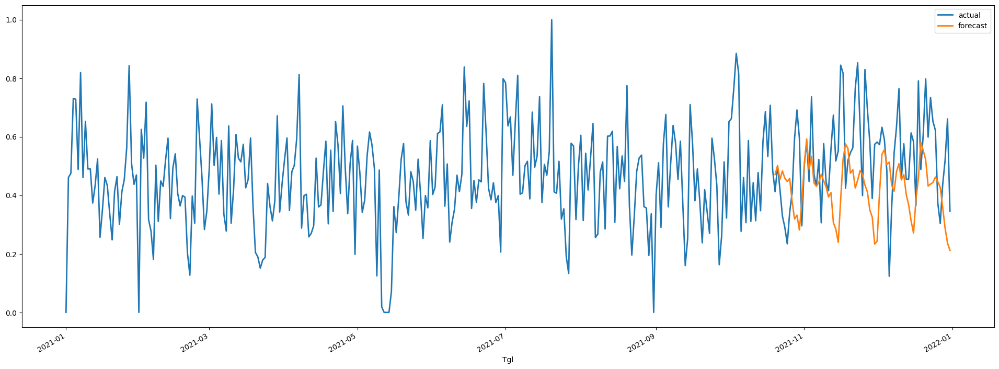

In [ ]:
# prediction for PET
mpl.style.use('default')
pred = rnn_pet.predict(n=73, series=train_pet)

pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_down_pet_rnn.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(24,8))
series_pet_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_pet_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_pet_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_pet_scaled, pred)))
print("SMAPE = {:.3f}".format(smape(series_pet_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_pet_scaled, pred)))

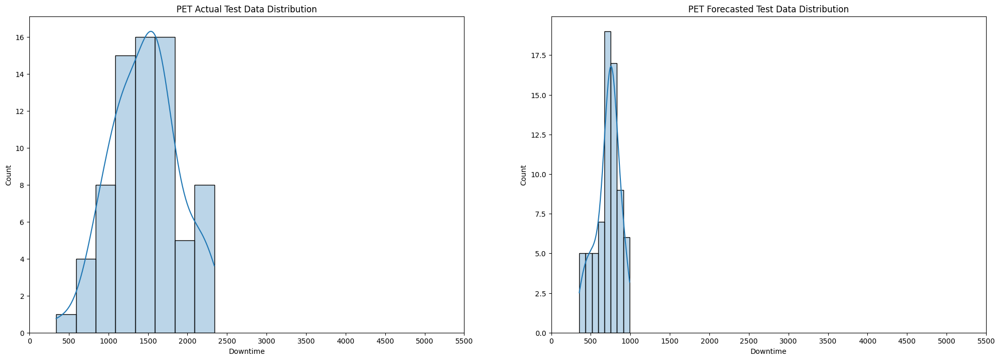

In [ ]:
# normal distribution for PET
pred_pet = pd.read_csv('/content/pred_down_pet_rnn.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(pet.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('PET Actual Test Data Distribution')
axarr[0].set_xticks(np.arange(start=0,stop=6000,step=500))

# plot forecasted test data
sns.histplot(pred_pet['Downtime'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('PET Forecasted Test Data Distribution')
axarr[1].set_xticks(np.arange(start=0,stop=6000,step=500))

plt.show()

Predicting: 9it [00:00, ?it/s]

RMSE = 0.263
MAE = 0.197
MSE = 0.069
SMAPE = 84.06
OPE = 25.507%


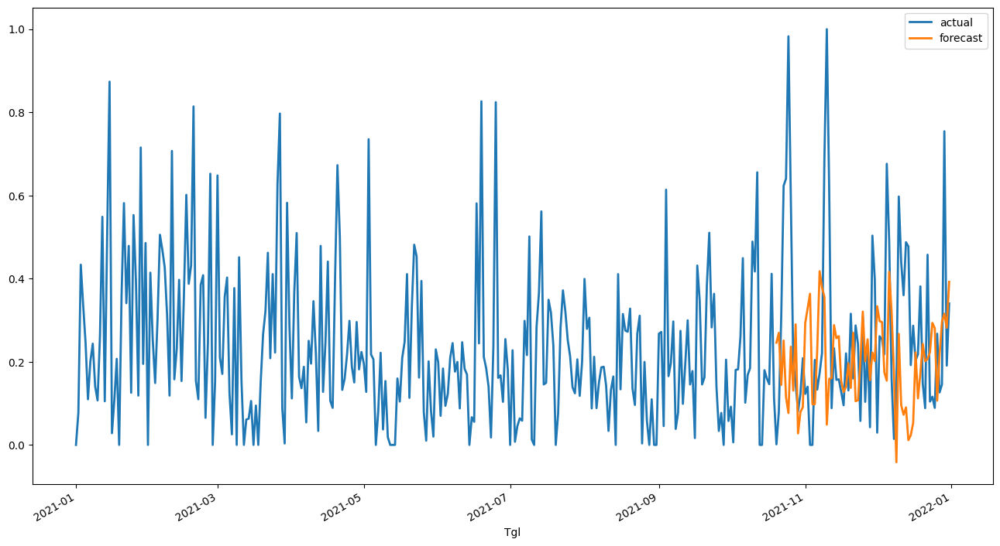

In [ ]:
# prediction for NYL
pred = rnn_nyl.predict(n=73, series=train_nyl)

pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_down_nyl_rnn.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_nyl_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_nyl_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_nyl_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_nyl_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_nyl_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_nyl_scaled, pred)))

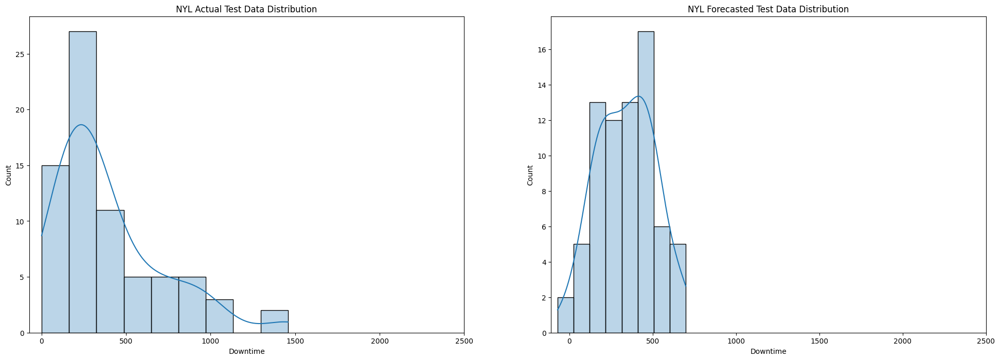

In [ ]:
# normal distribution for NYL
mpl.style.use('default')

pred_nyl = pd.read_csv('/content/pred_down_nyl_rnn.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(nyl.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('NYL Actual Test Data Distribution')
axarr[0].set_xticks(np.arange(start=0,stop=3000,step=500))

# plot forecasted test data
sns.histplot(pred_nyl['Downtime'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('NYL Forecasted Test Data Distribution')
axarr[1].set_xticks(np.arange(start=0,stop=3000,step=500))

plt.show()

Predicting: 9it [00:00, ?it/s]

RMSE = 0.177
MAE = 0.140
MSE = 0.031
SMAPE = 61.38
OPE = 2.075%


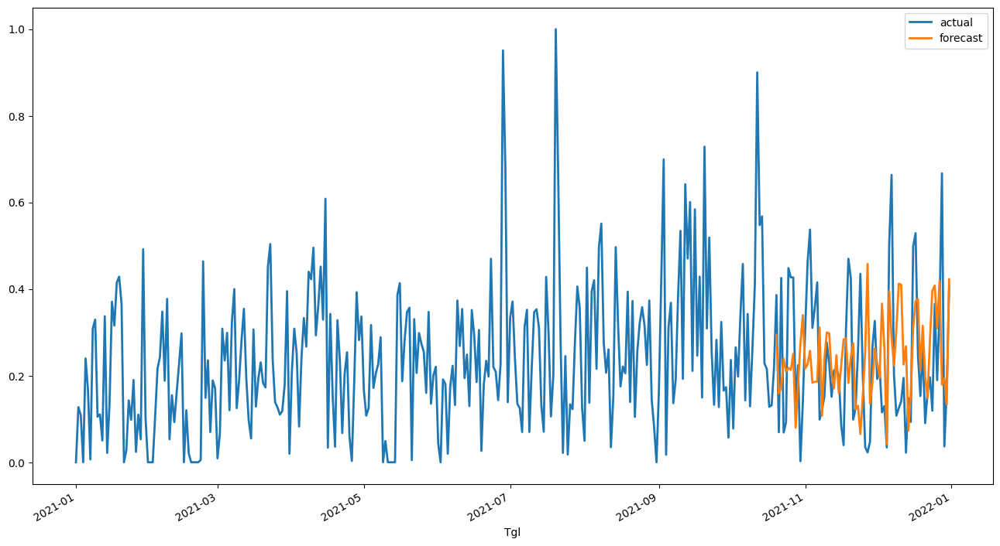

In [ ]:
# prediction for OPP
pred = rnn_opp.predict(n=73, series=train_opp)
pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_down_opp_rnn.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_opp_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_opp_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_opp_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_opp_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_opp_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_opp_scaled, pred)))

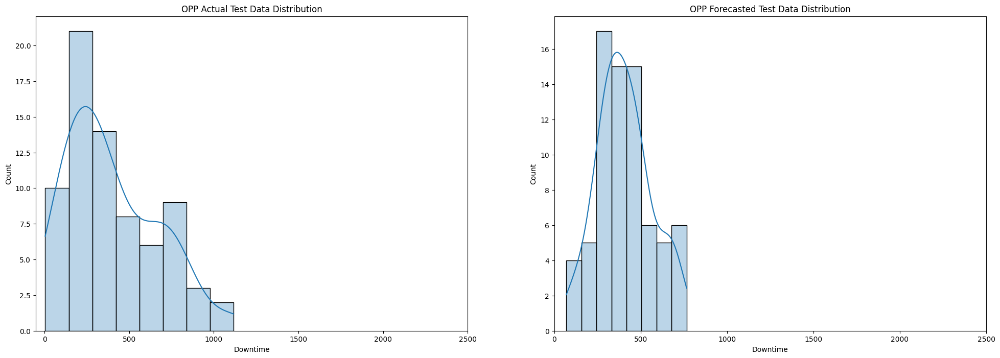

In [ ]:
# normal distribution for OPP

pred_opp = pd.read_csv('/content/pred_down_opp_rnn.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(opp.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('OPP Actual Test Data Distribution')
axarr[0].set_xticks(np.arange(start=0,stop=3000,step=500))

# plot forecasted test data
sns.histplot(pred_opp['Downtime'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('OPP Forecasted Test Data Distribution')
axarr[1].set_xticks(np.arange(start=0,stop=3000,step=500))

plt.show()

### **Forecasting Daily Runtime by Machine With RNN**

In [ ]:
PR01 = down[down['KdMesin']=='PR01'].pivot_table(values='Downtime', index='Tgl', fill_value=0, aggfunc=np.sum)
PR01 = PR01.reindex(idx, fill_value=0).reset_index()
PR02 = down[down['KdMesin']=='PR02'].pivot_table(values='Downtime', index='Tgl', fill_value=0, aggfunc=np.sum)
PR02 = PR02.reindex(idx, fill_value=0).reset_index()
PR03 = down[down['KdMesin']=='PR03'].pivot_table(values='Downtime', index='Tgl', fill_value=0, aggfunc=np.sum)
PR03 = PR03.reindex(idx, fill_value=0).reset_index()
PR05 = down[down['KdMesin']=='PR05'].pivot_table(values='Downtime', index='Tgl', fill_value=0, aggfunc=np.sum)
PR05 = PR05.reindex(idx, fill_value=0).reset_index()
PR06 = down[down['KdMesin']=='PR06'].pivot_table(values='Downtime', index='Tgl', fill_value=0, aggfunc=np.sum)
PR06 = PR06.reindex(idx, fill_value=0).reset_index()
PR07 = down[down['KdMesin']=='PR07'].pivot_table(values='Downtime', index='Tgl', fill_value=0, aggfunc=np.sum)
PR07 = PR07.reindex(idx, fill_value=0).reset_index()

In [ ]:
# defining time series by material
PR01_series = TimeSeries.from_dataframe(PR01, 'index','Downtime')
PR02_series = TimeSeries.from_dataframe(PR02, 'index','Downtime')
PR03_series = TimeSeries.from_dataframe(PR03, 'index','Downtime')
PR05_series = TimeSeries.from_dataframe(PR05, 'index','Downtime')
PR06_series = TimeSeries.from_dataframe(PR06, 'index','Downtime')
PR07_series = TimeSeries.from_dataframe(PR07, 'index','Downtime')

In [ ]:
# check seasonality for PR01
is_seasonal, pr01_periodicity = check_seasonality(PR01_series, max_lag=240)
dict_seas ={
    "PR01 is seasonal?":is_seasonal,
    "pr01_periodicity (days)":f'{pr01_periodicity:.1f}', 
    "pr01_periodicity (~months)": f'{pr01_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

PR01 is seasonal? : True
pr01_periodicity (days) : 4.0
pr01_periodicity (~months) : 0.1


In [ ]:
# check seasonality for PR02
is_seasonal, pr02_periodicity = check_seasonality(PR02_series, max_lag=240)
dict_seas ={
    "PR02 is seasonal?":is_seasonal,
    "pr02_periodicity (days)":f'{pr02_periodicity:.1f}', 
    "pr02_periodicity (~months)": f'{pr02_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

PR02 is seasonal? : True
pr02_periodicity (days) : 3.0
pr02_periodicity (~months) : 0.1


In [ ]:
# check seasonality for PR03
is_seasonal, pr03_periodicity = check_seasonality(PR03_series, max_lag=240)
dict_seas ={
    "PR03 is seasonal?":is_seasonal,
    "pr03_periodicity (days)":f'{pr03_periodicity:.1f}', 
    "pr03_periodicity (~months)": f'{pr03_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

PR03 is seasonal? : True
pr03_periodicity (days) : 5.0
pr03_periodicity (~months) : 0.2


In [ ]:
# check seasonality for PR05
is_seasonal, pr05_periodicity = check_seasonality(PR05_series, max_lag=240)
dict_seas ={
    "PR05 is seasonal?":is_seasonal,
    "pr05_periodicity (days)":f'{pr05_periodicity:.1f}', 
    "pr05_periodicity (~months)": f'{pr05_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

PR05 is seasonal? : True
pr05_periodicity (days) : 4.0
pr05_periodicity (~months) : 0.1


In [ ]:
# check seasonality for PR06
is_seasonal, pr06_periodicity = check_seasonality(PR06_series, max_lag=240)
dict_seas ={
    "PR06 is seasonal?":is_seasonal,
    "pr06_periodicity (days)":f'{pr06_periodicity:.1f}', 
    "pr06_periodicity (~months)": f'{pr06_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

PR06 is seasonal? : True
pr06_periodicity (days) : 6.0
pr06_periodicity (~months) : 0.2


In [ ]:
# check seasonality for PR07
is_seasonal, pr07_periodicity = check_seasonality(PR07_series, max_lag=240)
dict_seas ={
    "PR07 is seasonal?":is_seasonal,
    "pr07_periodicity (days)":f'{pr07_periodicity:.1f}', 
    "pr07_periodicity (~months)": f'{pr07_periodicity/30:.1f}'}
_ = [print(k,":",v) for k,v in dict_seas.items()]

PR07 is seasonal? : True
pr07_periodicity (days) : 4.0
pr07_periodicity (~months) : 0.1


In [ ]:
# data normalization
scaler= Scaler()
series_PR01_scaled = scaler.fit_transform(PR01_series)
series_PR02_scaled = scaler.fit_transform(PR02_series)
series_PR03_scaled = scaler.fit_transform(PR03_series)
series_PR05_scaled = scaler.fit_transform(PR05_series)
series_PR06_scaled = scaler.fit_transform(PR06_series)
series_PR07_scaled = scaler.fit_transform(PR07_series)

In [ ]:
# train test split
train_PR01, val_PR01 = series_PR01_scaled[:-73], series_PR01_scaled[-73:]
train_PR02, val_PR02 = series_PR02_scaled[:-73], series_PR02_scaled[-73:]
train_PR03, val_PR03 = series_PR03_scaled[:-73], series_PR03_scaled[-73:]
train_PR05, val_PR05 = series_PR05_scaled[:-73], series_PR05_scaled[-73:]
train_PR06, val_PR06 = series_PR06_scaled[:-73], series_PR06_scaled[-73:]
train_PR07, val_PR07 = series_PR07_scaled[:-73], series_PR07_scaled[-73:]

In [ ]:
# defining and training the model for PR01
rnn_PR01= RNNModel(
    model="RNN",
    input_chunk_length=pr01_periodicity,
    output_chunk_length=30,
    n_rnn_layers=3,
    batch_size=32,
    n_epochs=300,
    dropout=0.1,
    optimizer_kwargs={"lr": 1e-3},
    log_tensorboard=True,
    random_state=42,
    force_reset=True,
)
rnn_PR01.fit(train_PR01)

[2022-04-04 08:16:19,489] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 268 samples.
[2022-04-04 08:16:19,489] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 268 samples.
[2022-04-04 08:16:19,508] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
[2022-04-04 08:16:19,508] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name      | Type    | Params
--------------------------------------
0 | criterion | MSELoss | 0     
1 | rnn       | RNN     | 3.3 K 
2 | V         | Linear  | 26    
--------------------------------------
3.3 K     Trainable params
0         Non-trainable params
3.3 K     Total params
0.027     Total estimated model param

Training: 0it [00:00, ?it/s]

In [ ]:
# defining and training the model for PR02
rnn_PR02= RNNModel(
    model="RNN",
    input_chunk_length=pr02_periodicity,
    output_chunk_length=30,
    n_rnn_layers=3,
    batch_size=32,
    n_epochs=300,
    dropout=0.1,
    optimizer_kwargs={"lr": 1e-3},
    log_tensorboard=True,
    random_state=42,
    force_reset=True,
)
rnn_PR02.fit(train_PR02)

[2022-04-04 08:18:38,341] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 268 samples.
[2022-04-04 08:18:38,341] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 268 samples.
[2022-04-04 08:18:38,357] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
[2022-04-04 08:18:38,357] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name      | Type    | Params
--------------------------------------
0 | criterion | MSELoss | 0     
1 | rnn       | RNN     | 3.3 K 
2 | V         | Linear  | 26    
--------------------------------------
3.3 K     Trainable params
0         Non-trainable params
3.3 K     Total params
0.027     Total estimated model param

Training: 0it [00:00, ?it/s]

In [ ]:
# defining and training the model for PR03
rnn_PR03= RNNModel(
    model="RNN",
    input_chunk_length=pr03_periodicity,
    output_chunk_length=30,
    n_rnn_layers=3,
    batch_size=32,
    n_epochs=300,
    dropout=0.1,
    optimizer_kwargs={"lr": 1e-3},
    log_tensorboard=True,
    random_state=42,
    force_reset=True,
)
rnn_PR03.fit(train_PR03)

[2022-04-04 08:20:58,702] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 268 samples.
[2022-04-04 08:20:58,702] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 268 samples.
[2022-04-04 08:20:58,724] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
[2022-04-04 08:20:58,724] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name      | Type    | Params
--------------------------------------
0 | criterion | MSELoss | 0     
1 | rnn       | RNN     | 3.3 K 
2 | V         | Linear  | 26    
--------------------------------------
3.3 K     Trainable params
0         Non-trainable params
3.3 K     Total params
0.027     Total estimated model param

Training: 0it [00:00, ?it/s]

In [ ]:
# defining and training the model for PR05
rnn_PR05= RNNModel(
    model="RNN",
    input_chunk_length=pr05_periodicity,
    output_chunk_length=30,
    n_rnn_layers=3,
    batch_size=32,
    n_epochs=300,
    dropout=0.1,
    optimizer_kwargs={"lr": 1e-3},
    log_tensorboard=True,
    random_state=42,
    force_reset=True,
)
rnn_PR05.fit(train_PR05)

[2022-04-04 08:23:06,916] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 268 samples.
[2022-04-04 08:23:06,916] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 268 samples.
[2022-04-04 08:23:06,941] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
[2022-04-04 08:23:06,941] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name      | Type    | Params
--------------------------------------
0 | criterion | MSELoss | 0     
1 | rnn       | RNN     | 3.3 K 
2 | V         | Linear  | 26    
--------------------------------------
3.3 K     Trainable params
0         Non-trainable params
3.3 K     Total params
0.027     Total estimated model param

Training: 0it [00:00, ?it/s]

In [ ]:
# defining and training the model for PR06
rnn_PR06= RNNModel(
    model="RNN",
    input_chunk_length=pr06_periodicity,
    output_chunk_length=30,
    n_rnn_layers=3,
    batch_size=32,
    n_epochs=300,
    dropout=0.1,
    optimizer_kwargs={"lr": 1e-3},
    log_tensorboard=True,
    random_state=42,
    force_reset=True,
)
rnn_PR06.fit(train_PR06)

[2022-04-04 08:25:33,032] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 268 samples.
[2022-04-04 08:25:33,032] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 268 samples.
[2022-04-04 08:25:33,043] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
[2022-04-04 08:25:33,043] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name      | Type    | Params
--------------------------------------
0 | criterion | MSELoss | 0     
1 | rnn       | RNN     | 3.3 K 
2 | V         | Linear  | 26    
--------------------------------------
3.3 K     Trainable params
0         Non-trainable params
3.3 K     Total params
0.027     Total estimated model param

Training: 0it [00:00, ?it/s]

In [ ]:
# defining and training the model for PR07
rnn_PR07= RNNModel(
    model="RNN",
    input_chunk_length=pr07_periodicity,
    output_chunk_length=30,
    n_rnn_layers=3,
    batch_size=32,
    n_epochs=300,
    dropout=0.1,
    optimizer_kwargs={"lr": 1e-3},
    log_tensorboard=True,
    random_state=42,
    force_reset=True,
)
rnn_PR07.fit(train_PR07)

[2022-04-04 08:27:14,701] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 268 samples.
[2022-04-04 08:27:14,701] INFO | darts.models.forecasting.torch_forecasting_model | Train dataset contains 268 samples.
[2022-04-04 08:27:14,717] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
[2022-04-04 08:27:14,717] INFO | darts.models.forecasting.torch_forecasting_model | Time series values are 64-bits; casting model to float64.
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name      | Type    | Params
--------------------------------------
0 | criterion | MSELoss | 0     
1 | rnn       | RNN     | 3.3 K 
2 | V         | Linear  | 26    
--------------------------------------
3.3 K     Trainable params
0         Non-trainable params
3.3 K     Total params
0.027     Total estimated model param

Training: 0it [00:00, ?it/s]

Predicting: 9it [00:00, ?it/s]

RMSE = 0.122
MAE = 0.095
MSE = 0.015
SMAPE = 31.674
OPE = 3.578%


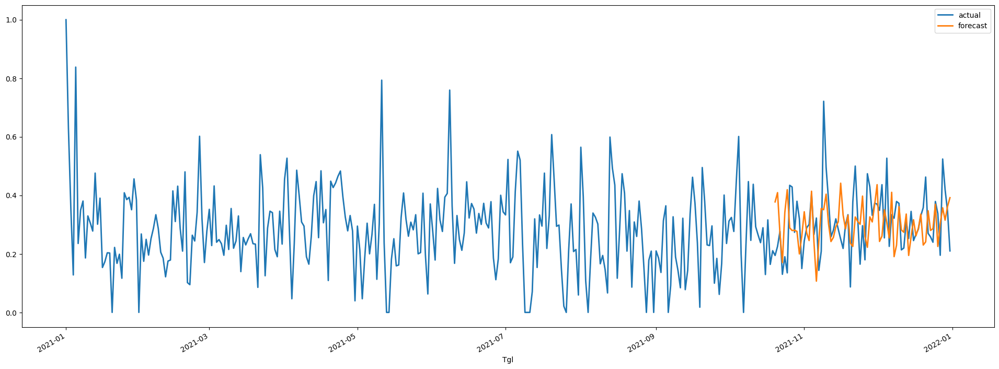

In [ ]:
# prediction for PR01
mpl.style.use('default')
pred = rnn_PR01.predict(n=73, series=train_PR01)

pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_down_PR01_rnn.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(24,8))
series_PR01_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_PR01_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_PR01_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_PR01_scaled, pred)))
print("SMAPE = {:.3f}".format(smape(series_PR01_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_PR01_scaled, pred)))

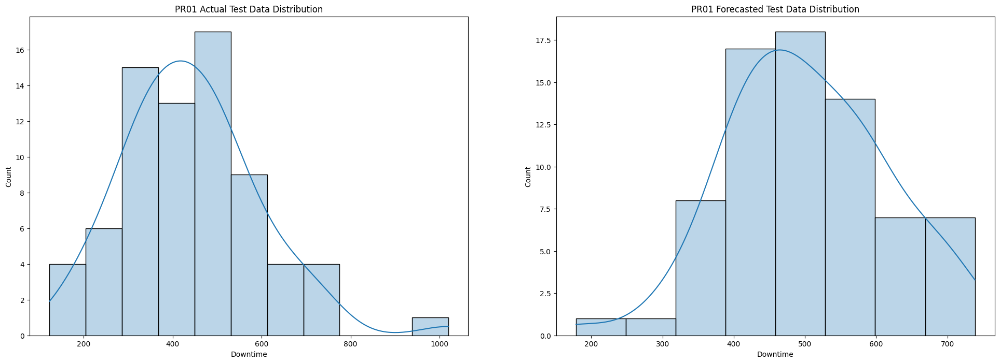

In [ ]:
# normal distribution for PR01
pred_PR01 = pd.read_csv('/content/pred_down_PR01_rnn.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(PR01.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('PR01 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_PR01['Downtime'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('PR01 Forecasted Test Data Distribution')

plt.show()

Predicting: 9it [00:00, ?it/s]

RMSE = 0.142
MAE = 0.110
MSE = 0.020
SMAPE = 25.32
OPE = 13.657%


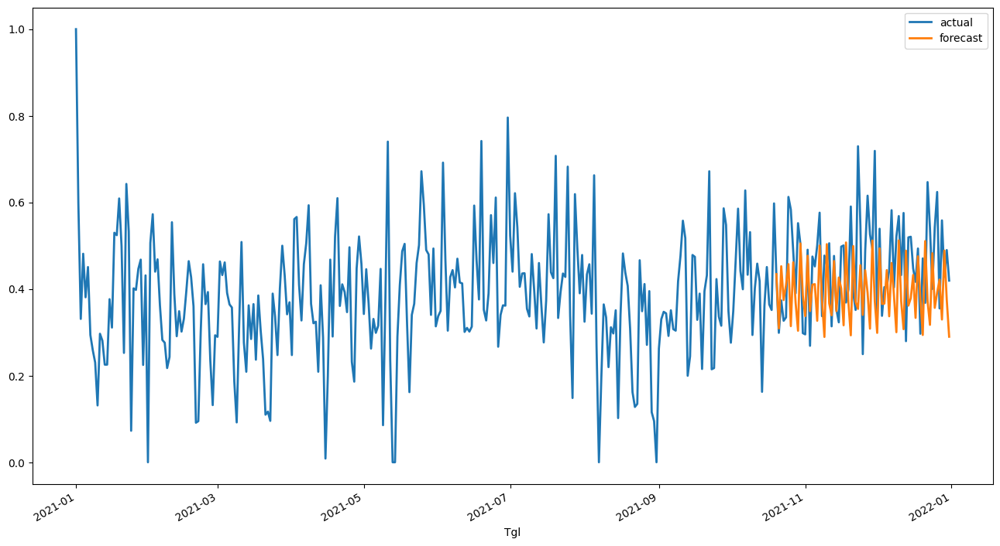

In [ ]:
# prediction for PR02
pred = rnn_PR02.predict(n=73, series=train_PR02)

pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_down_PR02_rnn.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_PR02_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_PR02_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_PR02_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_PR02_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_PR02_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_PR02_scaled, pred)))

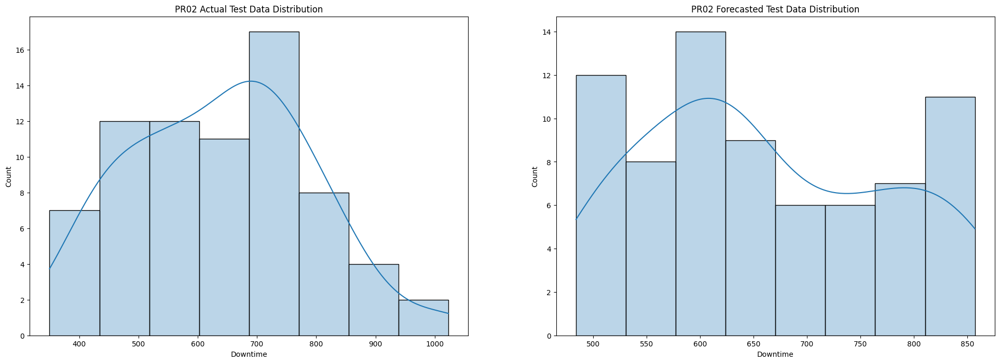

In [ ]:
# normal distribution for PR02

pred_PR02 = pd.read_csv('/content/pred_down_PR02_rnn.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(PR02.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('PR02 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_PR02['Downtime'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('PR02 Forecasted Test Data Distribution')

plt.show()

Predicting: 9it [00:00, ?it/s]

RMSE = 0.132
MAE = 0.104
MSE = 0.017
SMAPE = 31.67
OPE = 0.964%


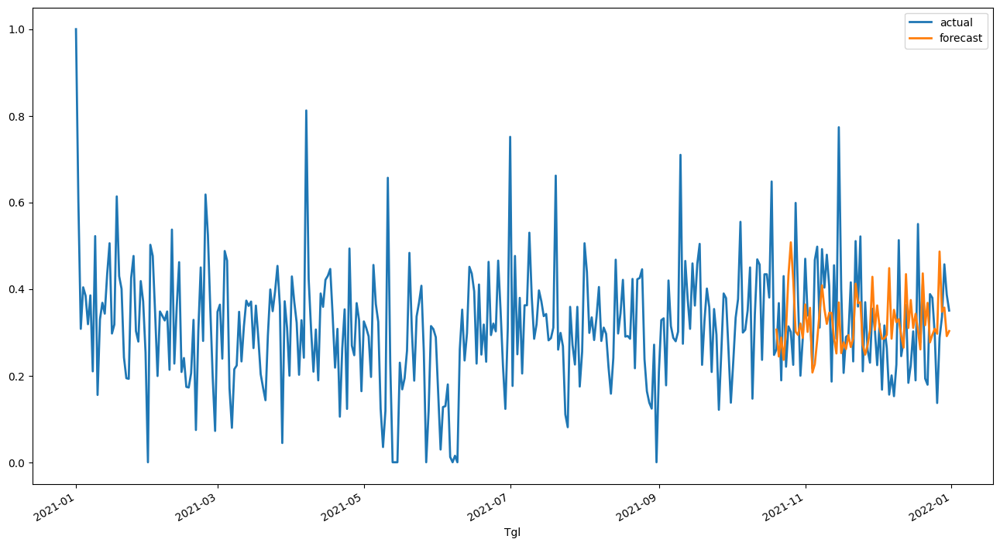

In [ ]:
# prediction for PR03
pred = rnn_PR03.predict(n=73, series=train_PR03)
pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_down_PR03_rnn.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_PR03_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_PR03_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_PR03_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_PR03_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_PR03_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_PR03_scaled, pred)))

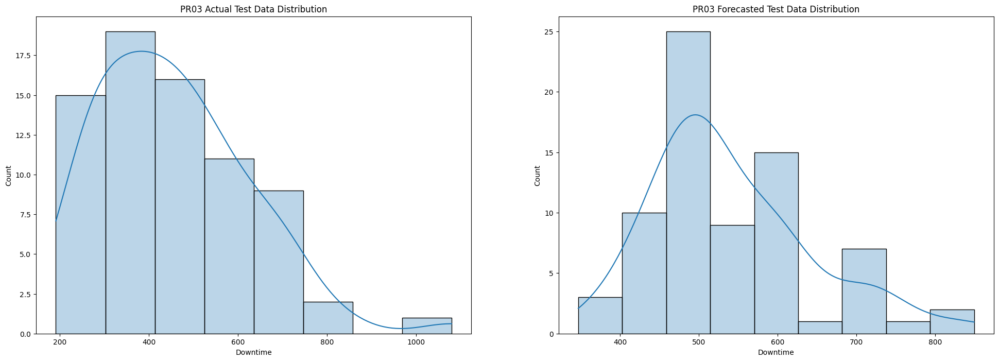

In [ ]:
# normal distribution for PR03

pred_PR03 = pd.read_csv('/content/pred_down_PR03_rnn.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(PR03.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('PR03 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_PR03['Downtime'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('PR03 Forecasted Test Data Distribution')

plt.show()

Predicting: 9it [00:00, ?it/s]

RMSE = 0.120
MAE = 0.089
MSE = 0.014
SMAPE = 40.81
OPE = 16.924%


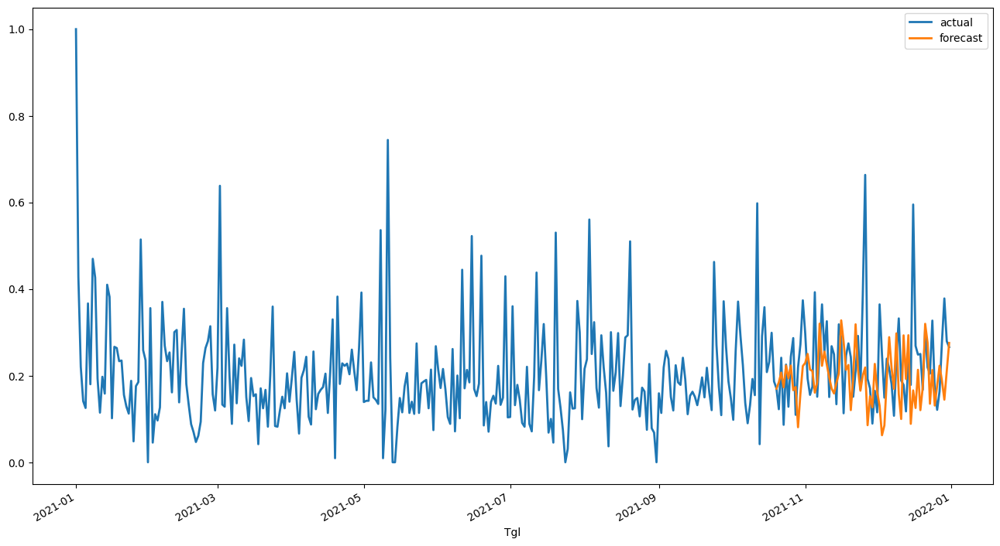

In [ ]:
# prediction for PR05
pred = rnn_PR05.predict(n=73, series=train_PR05)
pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_down_PR05_rnn.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_PR05_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_PR05_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_PR05_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_PR05_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_PR05_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_PR05_scaled, pred)))

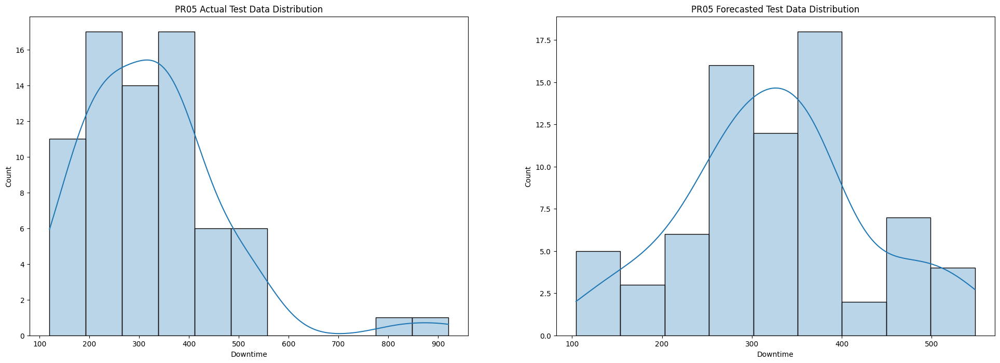

In [ ]:
# normal distribution for PR05

pred_PR05 = pd.read_csv('/content/pred_down_PR05_rnn.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(PR05.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('PR05 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_PR05['Downtime'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('PR05 Forecasted Test Data Distribution')

plt.show()

Predicting: 9it [00:00, ?it/s]

RMSE = 0.170
MAE = 0.140
MSE = 0.029
SMAPE = 61.73
OPE = 9.871%


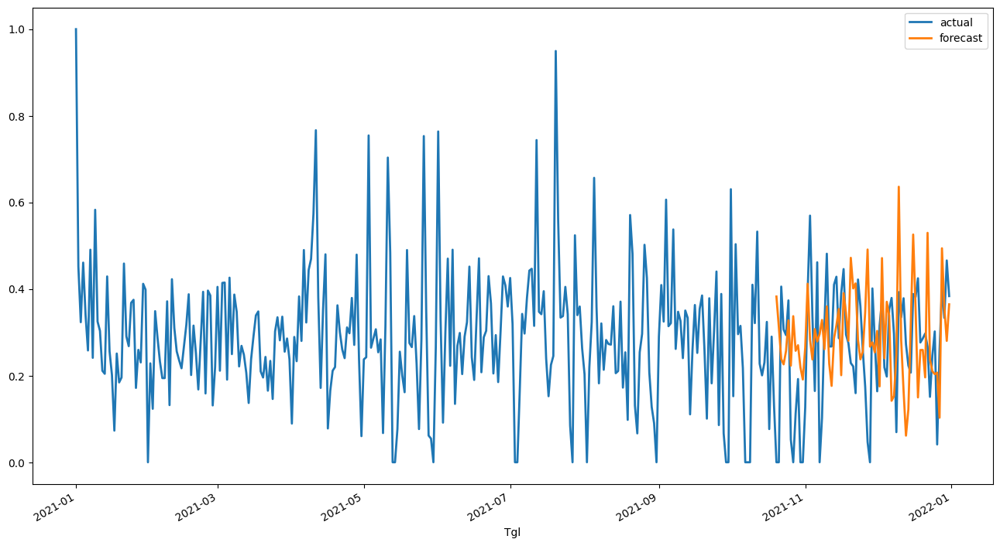

In [ ]:
# prediction for PR06
pred = rnn_PR06.predict(n=73, series=train_PR06)
pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_down_PR06_rnn.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_PR06_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_PR06_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_PR06_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_PR06_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_PR06_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_PR06_scaled, pred)))

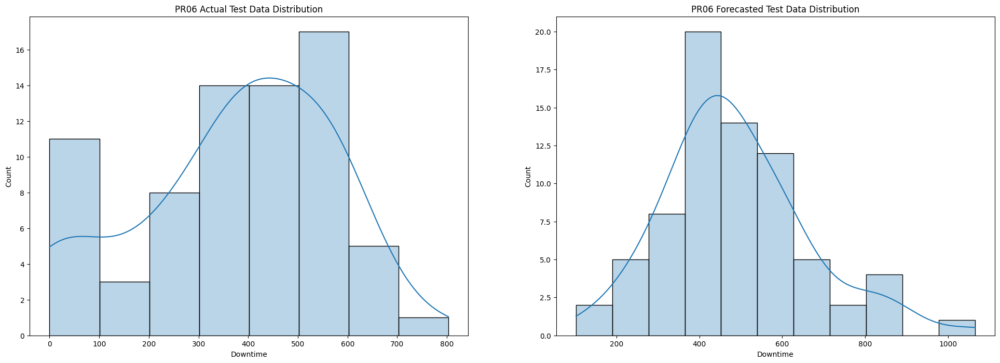

In [ ]:
# normal distribution for PR06

pred_PR06 = pd.read_csv('/content/pred_down_PR06_rnn.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(PR06.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('PR06 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_PR06['Downtime'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('PR06 Forecasted Test Data Distribution')

plt.show()

Predicting: 9it [00:00, ?it/s]

RMSE = 0.165
MAE = 0.125
MSE = 0.027
SMAPE = 51.65
OPE = 12.324%


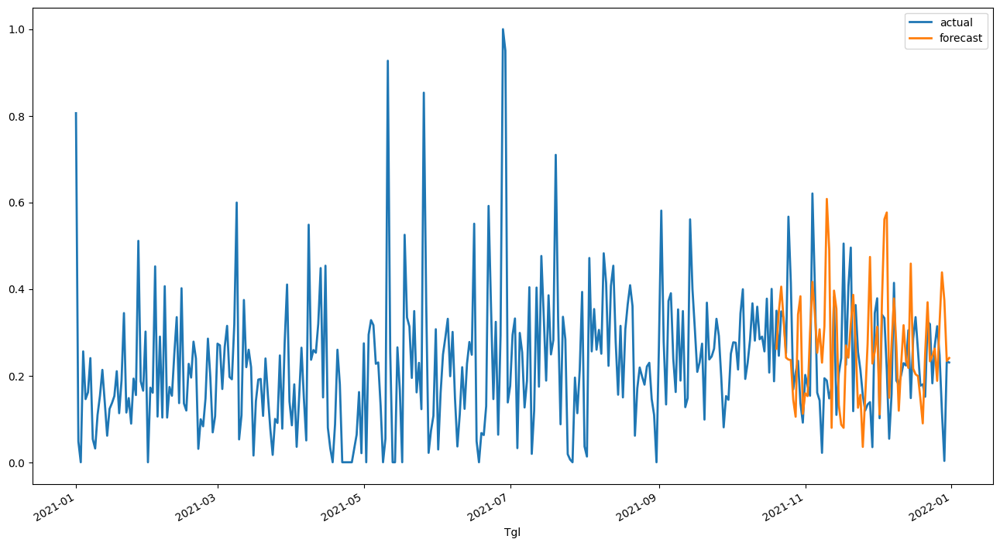

In [ ]:
# prediction for PR07
pred = rnn_PR07.predict(n=73, series=train_PR07)
pred_scaled = scaler.inverse_transform(pred)
pred_scaled.to_csv('/content/pred_down_PR07_rnn.csv')

# plot the actual data and forecasted data
plt.figure(figsize=(16,8))
series_PR07_scaled.plot(label="actual")
pred.plot(label="forecast")
plt.xlabel('Tgl')
plt.legend()

print("RMSE = {:.3f}".format(rmse(series_PR07_scaled, pred)))
print("MAE = {:.3f}".format(mae(series_PR07_scaled, pred)))
print("MSE = {:.3f}".format(mse(series_PR07_scaled, pred)))
print("SMAPE = {:.2f}".format(smape(series_PR07_scaled, pred)))
print("OPE = {:.3f}%".format(ope(series_PR07_scaled, pred)))

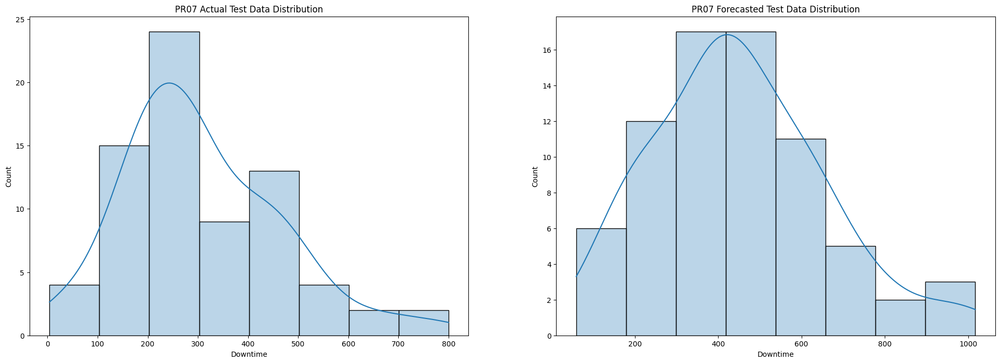

In [ ]:
# normal distribution for PR07

pred_PR07 = pd.read_csv('/content/pred_down_PR07_rnn.csv')

f, axarr = plt.subplots(nrows=1,ncols=2,figsize=(24, 8))

# plot actual test data
sns.histplot(PR07.iloc[-73:,1], ax = axarr[0],kde=True,alpha=0.3)
axarr[0].set_title('PR07 Actual Test Data Distribution')

# plot forecasted test data
sns.histplot(pred_PR07['Downtime'], ax = axarr[1],kde=True,alpha=0.3)
axarr[1].set_title('PR07 Forecasted Test Data Distribution')

plt.show()